## SBMOO  approach for Dealing with Deep Uncertainty in Environmental Problems:


- Solve scenario-based MOOP (i.e. simultaneously consider the selected scenarios and generate the solutions for an SBMOOP)
    [For the time being, we use the previous scenario selected methods in the literature (Particularly use one proposed in Eker & Kwakkel (2018).]
- Use ASF as a posteriori decision-making approach [a more smart way of generating reference point should be considered; e.g. surrogate ASF]  

- Finally, we need to analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)
- The classical lake problem has been used to test the idea.

##### Objectives in Lake problem(4 objectives):
- Max expected economic benefits(Utility)
- Min worst-case average P concentration(Pollution)
- Max average Inertia of control policy(Inertia)
- Max reliability of policy in staying below the lake's critical P threshold(Reliability)

##### Constraints:
- P emissions range between 0.0001 and 0.1(decision variables bounds)

##### Observations:
- Utility and reliability are the most conflicting objectives
- There is no feasible solution with the reliability of higher than 85% (or even 10%) for all scenarios. 

In [1]:
import numpy as np
from scipy.optimize import brentq
import math
from scipy.optimize import minimize
import random

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

import csv
import plotly.express as px
import plotly.graph_objects as go

In [2]:
def lake_problem(decisions,
                 b, #= 0.42,          # decay rate for P in lake (0.42 = irreversible)
                 q, #= 2.0,           # recycling exponent
                 mean, #= 0.02,       # mean of natural inflows
                 stdev, #= 0.001,     # future utility discount rate
                 delta, #= 0.98,      # standard deviation of natural inflows
                 alpha, #= 0.4,       # utility from pollution
                 nsamples = 100    # Monte Carlo sampling of natural inflows
                 ): #**kwargs):   
    #decisions = [kwargs[str(i)] for i in range(100)]
    
    Pcrit = brentq(lambda x: x**q/(1+x**q) - b*x, 0.01, 1.5)
    nvars = len(decisions)
    X = np.zeros((nvars,))
    average_daily_P = np.zeros((nvars,))
    decisions = np.array(decisions)
    reliability = 0.0

    for _ in range(nsamples):
        X[0] = 0.0
        
        natural_inflows = np.random.lognormal(
                math.log(mean**2 / math.sqrt(stdev**2 + mean**2)),
                math.sqrt(math.log(1.0 + stdev**2 / mean**2)),
                size = nvars)
        
        for t in range(1,nvars):
            X[t] = (1-b)*X[t-1] + X[t-1]**q/(1+X[t-1]**q) + decisions[t-1] +\
                    natural_inflows[t-1]
            average_daily_P[t] += X[t]/float(nsamples)
    
        reliability += np.sum(X < Pcrit)/float(nsamples*nvars)
      
    max_P = np.max(average_daily_P)
    utility = np.sum(alpha*decisions*np.power(delta,np.arange(nvars)))#/100
    inertia = np.sum(np.absolute(np.diff(decisions)) < 0.02)/float(nvars-1)
    
    
    return -utility, max_P, -inertia, -reliability  # Negative signs describe the Maximization objectives

In [2]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
s = 1
#Number of objectives 
k = 4
# Number of meta-criteria
mc = s*k

In [4]:
"""
 Utilizing 4 diverse scenarios + 1 ref scenario from 
 
 Eker, S. and Kwakkel, J.H., 2018. Including robustness considerations in the search phase of Many-Objective 
 Robust Decision Making. Environmental Modelling & Software, 105, pp.201-216.
 
 4 selected scenarios + 1 reference scenario:
              b           delta          mean           q             std
 A(#77)  0.19330981   0.953092397    0.017430754    3.049281843    0.002061759
 B(#96)  0.141181536  0.950441986    0.012044268    2.584491318    0.00243013
 C(#130) 0.111640212  0.956457199    0.010126115    2.968733539    0.003692125
 D(#181) 0.272280522  0.931232823    0.03300274     2.971857894    0.004599415
 Ref     0.42         0.98           0.02           2              0.0017
 
+ 4 scenarios from

Bartholomew, E. & Kwakkel, J. H. (2020), ‘On considering robustness in thesearch phase of robust decision making:  
A comparison of many-objective ro-bust decision making, multi-scenario many-objective robust decision making,
and many objective robust optimization’,Environmental Modelling & Soft-warep. 104699.

Used the same algorithm as Eker 2018, but ended up with the following scenarios:

4 selected scenarios + 1 reference scenario:

    b        q      mean      std     delta
1 0.2760   3.0490   0.0039   0.0039   0.9310
2 0.1350   2.0255   0.0407   0.0030   0.9613
3 0.2704   2.4783   0.0169   0.0039   0.9631
4 0.1009   3.6789   0.0187   0.0037   0.9317

Ref the same as the above
"""

b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42, 0.2760, 0.1350, 0.2704, 0.1009] # b = [0.42, 0.1, 0.2, 0.3]
q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2, 3.0490, 2.0255, 2.4783, 3.6789] # q = [2.0, 3, 4, 4.5]
mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02, 0.0039, 0.0407, 0.0169, 0.0187]   # mean = [0.02, 0.01, 0.03, 0.05]
stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017, 0.0039, 0.0030, 0.0039, 0.0037]   # stdev = [0.001, 0.0006, 0.001, 0.005]
delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98, 0.9310, 0.9613, 0.9631, 0.9317]      

## Finding the ideal points (the optimal values for objectives in each scenario) by solving a single-scenario single-objective problem for all objectives and 5 considered scenarios.

In [5]:
# 4 objectives and 9 scenarios
# So the indices must change between 0-8, each demonstrates a scenario

def single_objective_single_scenario(decisions):
    """
    single-objective (obj) single-scenario (scen) model
    """        
    f = []                     
    f = lake_problem(decisions, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
                     
    return f[obj]

In [6]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [7]:
# Solving the single-scenario single objective problems to get the ideal points for each objective in each scenario

ideal_Utility = [] 
ideal_Pollution = [] 
ideal_Inertia = [] 
ideal_Reliability = [] 
scen = 1
ind_temp = 0
extreme_dec = []
extreme_refp = np.zeros((mc,k))

for obj in range(k):
    print('k=',obj)
    
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    """
    
    print('s=', scen)
    ind_temp += 1
        
    sol = minimize(single_objective_single_scenario,
            x0,
            method = "SLSQP",
            bounds = bnds,
            #constraints = cons
            )  
        
    # Decision variables (solutions)
    extreme_dec.append(sol.x)
    
    F = lake_problem(sol.x, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
    #print(' Scenario ',scen+1,': b = ', b[scen], ', q = ', q[scen], ', mean = ', mean[scen], ', stdev = ', stdev[scen], ',delta = ', delta[scen])
    #print('f_{obj+1}',scen+1,' =', F[obj])

    # Store Objective values for scenario S_i
    extreme_refp[ind_temp-1] = np.array([-F[0],F[1],-F[2],-F[3]])
        
    if obj == 0:
        ideal_Utility.append(-F[obj])
    elif obj == 1:
        ideal_Pollution.append(F[obj])
    elif obj == 2:
        ideal_Inertia.append(-F[obj])
    else:
        ideal_Reliability.append(-F[obj])
        

#print('Ideal points for Utility in different scenarios =',ideal_Utility)
#print('Ideal points for Plution in different scenarios =',ideal_Pollution)
#print('Ideal points for Inertia in different scenarios =',ideal_Inertia)
#print('Ideal points for Reliability in different scenarios =',ideal_Reliability)

k= 0
s= 1
k= 1
s= 1
k= 2
s= 1
k= 3
s= 1


In [8]:
# Write ideal points

with open('obective_values_4obj_s2(EkerBarth)_ideal points.csv', 'w', newline='') as f:
    objectives = ['ideal_Utility', 'ideal_Pollution', 'ideal_Inertia', 'ideal_Reliability', 'Scenario'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(s):
        thewriter.writerow({'ideal_Utility' : ideal_Utility[i], 'ideal_Pollution' : ideal_Pollution[i], 'ideal_Inertia' : ideal_Inertia[i], 'ideal_Reliability' : ideal_Reliability[i], 'Scenario' : i
                               })
        
with open('extreme_rf_points(EkerBarth)s2.csv', 'w', newline='') as f:
    objectives = ['extreme_rf_points', 'extreme_rf_points_dec'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(mc):
        thewriter.writerow({'extreme_rf_points' : extreme_refp[i], 'extreme_rf_points_dec' : extreme_dec[i]
                               })    

In [5]:
Lake45_ideals = pd.read_csv('obective_values_4obj_s2(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.802129,0.109598,1.0,1.0,0


In [6]:
# Extreme points (decision space)
import re
extreme_rf_points = pd.read_csv('extreme_rf_points(EkerBarth)s2.csv')
extreme_rfp_dec = np.zeros((mc,100))
for i in range(mc):
    rfpt = re.findall(r"[-+]?\d*\.\d+|\d+", extreme_rf_points['extreme_rf_points_dec'][i])
    for j in range(100):
        extreme_rfp_dec[i][j] = float(rfpt[j])

#extreme_rfp_dec

In [7]:
# Calculate the extreme points in objective space

extreme_rfp = [s * [None] for i in range(mc)]  #np.zeros((mc,mc))

for j in range(mc):
    f_temp = np.zeros((k,))
    F = lake_problem(extreme_rfp_dec[j], b = b[1], q = q[1], mean = mean[1], stdev = stdev[1], delta = delta[1], alpha = 0.4, nsamples = 100)
    for i in range(k):
        if i==1:
            f_temp[i] = F[i]
        else:
            f_temp[i] = -F[i]
                
    extreme_rfp[j][0] = f_temp
                
extreme_rfp

[[array([0.80212866, 7.84271366, 1.        , 0.03      ])],
 [array([8.02128655e-04, 1.10265208e-01, 1.00000000e+00, 1.00000000e+00])],
 [array([8.02128655e-04, 1.09948416e-01, 1.00000000e+00, 1.00000000e+00])],
 [array([8.02128655e-04, 1.10550204e-01, 1.00000000e+00, 1.00000000e+00])]]

In [8]:
#It is needed in the solution process
Lake45_ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_9scen(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.096717,1.0,1.0000,0
1,0.802129,0.110756,1.0,1.0000,1
2,0.907929,0.102940,1.0,1.0000,2
3,0.581198,0.131598,1.0,1.0000,3
4,1.734761,0.057112,1.0,1.0000,4
5,0.579248,0.017281,1.0,1.0000,5
6,1.013628,7.592178,1.0,0.0416,6
7,1.058766,0.069357,1.0,1.0000,7
8,0.585153,0.231929,1.0,1.0000,8


In [9]:
"""
Achievement Scalarizing Function (ASF) approach: transfer the multi-objective problem into a single objective one.
Then the following problem will be solved:

  min_x  max_{i=1,..,k} [w_i(f_i - g_i)] + \epsilon sum_{i=1}^n  w_i(f_i - g_i)
  
   s.t. x \in S(feasible region)
  
  where w_i are the weights and can be set bu the decision maker(DM) (e.g. w_i = 1/(z_i^{ideal} - z_i^{nadir} which is also normalize the objective functions)
  k : number of objective functions
  g_i: aspiration levels to be set by the DM (one for each objective function is needed)

When we have multiple scenarios the above formulation have an additional dimension:

   min_x  max_{i=1,..,k; p=1,...,s} [w_{ip}(f_{ip} - g_{ip})] + \epsilon sum_{i=1}^n [sum_{p=1}^s  w_{ip}(f_{ip} - g_{ip}) ]
  
     s.t. x \in S(feasible region in all scenarios)

"""


def objective(decisions):
    """
    ASF
    """     
    phi = np.zeros((s,k))
    w = np.ones((s,k)) # weight vectors
    eps = 0.0001
    f = [[None] for i in range(s)] 
    
    # Setting weights, the same weight for each objective in all scenarios
    for p in range(s):
        for i in range(k): 
            if i==0:
                w[p,i] = 1/(Lake45_ideals.loc[1,'ideal_Utility'])  #2
            elif i==1:
                w[p,i] = 1/(15-(Lake45_ideals.loc[1,'ideal_Pollution']))
            elif i==2:
                w[p,i] = 1/Lake45_ideals.loc[1,'ideal_Inertia']                
            else:
                w[p,i] = 1/Lake45_ideals.loc[1,'ideal_Reliability']
                       
    for p in range(s):
        f[p] = lake_problem(decisions, b = b[1], q = q[1], mean = mean[1], stdev = stdev[1], delta = delta[1], alpha = 0.4, nsamples = 100)
        phi[p] = w[p]*(f[p] - g[p])
        aug = eps * (phi[p]).sum()  
    
    return phi.max() + aug


In [10]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [13]:
"""
  Setting the goals/ reference points - selected
"""
# number of solution to be generated 
n = 50

ig=[5 * [None] for i in range(n)] 

"""
Selected weights for more diverse solutions
"""      
#extremes
for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

# generating some evenly distributed weights
cc = 0
W = []
for i1 in range(5):#s*k+1):
    for i2 in range(i1+1):
        for i3 in range(i2+1):
            w1 = (4-i1)/4
            w2 = (i1-i2)/4
            w3 = (i2-i3)/4
            w4 = 1 - (w1 + w2 + w3)
            W.append(np.array([w1,w2,w3,w4]))
            #print(w1, w2, w3, w4)
            cc += 1

# generate evenly distributed reference points
ig[4][0] = np.array([ig[0][0][0], ig[3][0][1], ig[0][0][2], ig[1][0][3]])

for i in range(np.shape(W)[0]):
    ig[5+i][0] = ig[4][0]*W[i]

# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS
                     
xlimits4 = np.array([[-Lake45_ideals.loc[0,'ideal_Utility']*10,-0.0005], # Utility 
                    [-5,15], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1*5, -0.04]  # Reliability 
                   ])

sampling4 = LHS(xlimits=xlimits4)

num = n#-40

x4 = sampling4(num)
                     
for i in range(num):
    ig[i][0] = x4[i]#+40
                           
                     
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][0] 
    return g

In [12]:
"""
  Setting the goals/ reference points - selected
"""
# number of solution to be generated 
n = 50

ig=[s * [None] for i in range(n)] 

"""
Selected weights for more diverse solutions
"""      
#extremes
for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

# generating some evenly distributed weights
cc = 0
W = []
for i1 in range(6):#s*k+1):
    for i2 in range(i1+1):
        for i3 in range(i2+1):
            w1 = (5-i1)/5
            w2 = (i1-i2)/5
            w3 = (i2-i3)/5
            w4 = 1 - (w1 + w2 + w3)
            W.append(np.array([w1,w2,w3,w4]))
            #print(w1, w2, w3, w4)
            cc += 1

# generate evenly distributed reference points
ig[4][0] = np.array([ig[0][0][0], ig[3][0][1], ig[0][0][2], ig[1][0][3]])

for i in range(np.shape(W)[0]):
    ig[5+i][0] = ig[4][0]*W[i]

                           
                     
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][0] 
    return g

IndexError: list index out of range

In [11]:
#ig

# Use ASF as a posteriori decision-making approach

In [14]:
"""
Solving the problem
 
""" 
n = 50 # number of solutions to be generated

import time
start_time = time.time()

ait = [[None] for i in range(n)] 
goals = [[None] for i in range(n) ] 
nfe = [] 

Utility = [[None] for i in range (n)] 
Pollution = [[None] for i in range (n)] 
Inertia = [[None] for i in range (n)] 
Reliability = [[None] for i in range (n)] 

# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds) 

for j in range(n):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    
    """
    #tait = [[None] for i in range (5)] 
    
    print(j)
    g = selected_goals(ig, j, s, k)
    
    #print('1.ASF')
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
                options={'disp': True}
               )

    print(sol.message)
    print('iterations', sol.nit)
    print('NFE', sol.nfev)

    # Decision variables (solutions)
    ait[j] = sol.x
    goals[j] = g
    nfe.append(sol.nfev)
                    
    
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    p=1
    F = lake_problem(sol.x, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
    print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
    print('f_1',p+1,' (Utility) =', -F[0])
    print('f_2',p+1,' (max_P) =', F[1])
    print('f_3',p+1,' (inertia) =', -F[2])
    print('f_4',p+1,' (reliability) =', -F[3])
       
    # Store Objective values for scenario S_i
    temp_Utility.append(-F[0])
    temp_Pollution.append(F[1])
    temp_Inertia.append(-F[2])
    temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    Utility[j] = temp_Utility
    Pollution[j] = temp_Pollution
    Inertia[j] = temp_Inertia
    Reliability[j] = temp_Reliability
         
                    
print("--- %s seconds ---" % (time.time() - start_time)) 
print('nfe =', np.sum(nfe))

0
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.990916972496821
            Iterations: 27
            Function evaluations: 3005
            Gradient evaluations: 27
Optimization terminated successfully.
iterations 27
NFE 3005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7364837259359451
f_2 2  (max_P) = 7.682090521167327
f_3 2  (inertia) = 0.5151515151515151
f_4 2  (reliability) = 0.030000000000000075
1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.8127682401304115
            Iterations: 12
            Function evaluations: 1111
            Gradient evaluations: 10
Optimization terminated successfully.
iterations 12
NFE 1111
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6618084536905026
f_2 2  (max_P) = 7.698

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.661200681710088
            Iterations: 1
            Function evaluations: 113
            Gradient evaluations: 1
Optimization terminated successfully.
iterations 1
NFE 113
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008121536267713376
f_2 2  (max_P) = 0.10940847358215211
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.787647786342502
            Iterations: 22
            Function evaluations: 2445
            Gradient evaluations: 22
Optimization terminated successfully.
iterations 22
NFE 2445
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7738780254637696
f_2 2  (max_P) = 7.790351422837905
f_3 2 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 4.535274144470513
            Iterations: 9
            Function evaluations: 959
            Gradient evaluations: 9
Optimization terminated successfully.
iterations 9
NFE 959
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6761045417721194
f_2 2  (max_P) = 7.697205153233343
f_3 2  (inertia) = 0.494949494949495
f_4 2  (reliability) = 0.030000000000000075
33
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 3.802491563517553
            Iterations: 7
            Function evaluations: 745
            Gradient evaluations: 7
Optimization terminated successfully.
iterations 7
NFE 745
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7566468117645553
f_2 2  (max_P) = 7.801844665451046


Optimization terminated successfully.    (Exit mode 0)
            Current function value: 5.684383080176251
            Iterations: 38
            Function evaluations: 4217
            Gradient evaluations: 38
Optimization terminated successfully.
iterations 38
NFE 4217
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.769550765805846
f_2 2  (max_P) = 7.774574977752863
f_3 2  (inertia) = 0.6363636363636364
f_4 2  (reliability) = 0.030000000000000075
49
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.264266283036152
            Iterations: 1
            Function evaluations: 113
            Gradient evaluations: 1
Optimization terminated successfully.
iterations 1
NFE 113
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008240481554055103
f_2 2  (max_P) = 0.10965310

In [15]:
"""
Writing the results into a csv file
"""


# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s2.csv', 'w', newline='') as f:
    meta_objectives = ['U in s2', 
                  'Po  in s2', 
                  'In  in s2', 
                  'Re  in s2' 
                       , 'group', 'decisions', 'goals'
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in range(n):
        thewriter.writerow({'U in s2' : Utility[j][0], 
                  'Po  in s2' : Pollution[j][0], 
                  'In  in s2' : Inertia[j][0], 
                  'Re  in s2' : Reliability[j][0], 
                   'group' : j, 'decisions' : ait[j], 'goals' : goals[j],
                   })

In [16]:
Lake4550_meta_data = pd.read_csv('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s2.csv')
Lake4550_meta_data.describe()

,U in s2,Po in s2,In in s2,Re in s2,group
count,50.000000,50.000000,50.000000,50.000000,50.00000
mean,0.473936,6.063285,0.744040,0.275182,24.50000
std,0.326347,2.976235,0.201583,0.393753,14.57738
min,0.000802,0.109408,0.393939,0.030000,0.00000
25%,0.052880,6.927299,0.578283,0.030000,12.25000
50%,0.646232,7.641413,0.651515,0.030000,24.50000
75%,0.748881,7.768185,1.000000,0.512875,36.75000
max,0.802129,7.842427,1.000000,1.000000,49.00000


In [17]:
# needs new assignment for different # of scenarios
Signed_sol = np.array([Lake4550_meta_data['U in s2']*(-1), Lake4550_meta_data['Po  in s2'], Lake4550_meta_data['In  in s2']*(-1), Lake4550_meta_data['Re  in s2']*(-1)])
#Signed_sol.T

In [18]:
n=50
solutions = np.zeros((n,s*k))
for j in range(n):
    solutions[j] = Signed_sol.T[0] #Lake4550_meta_data.values[j][0:s*k]

#solutions  

In [19]:
# Faster than is_pareto_efficient_simple, but less readable.
def is_pareto_efficient(costs, return_mask = True):
    """
    Find the pareto-efficient points
    :param costs: An (n_points, n_costs) array
    :param return_mask: True to return a mask
    :return: An array of indices of pareto-efficient points.
        If return_mask is True, this will be an (n_points, ) boolean array
        Otherwise it will be a (n_efficient_points, ) integer array of indices.
    """
    is_efficient = np.arange(costs.shape[0])
    n_points = costs.shape[0]
    next_point_index = 0  # Next index in the is_efficient array to search for
    while next_point_index<len(costs):
        nondominated_point_mask = np.any(costs<costs[next_point_index], axis=1)
        nondominated_point_mask[next_point_index] = True
        is_efficient = is_efficient[nondominated_point_mask]  # Remove dominated points
        costs = costs[nondominated_point_mask]
        next_point_index = np.sum(nondominated_point_mask[:next_point_index])+1
    if return_mask:
        is_efficient_mask = np.zeros(n_points, dtype = bool)
        is_efficient_mask[is_efficient] = True
        return is_efficient_mask
    else:
        return is_efficient

In [20]:
is_pareto_efficient(Signed_sol.T)

array([ True,  True,  True,  True,  True, False,  True,  True,  True,
        True, False, False,  True, False,  True,  True,  True,  True,
       False,  True,  True,  True, False, False,  True, False, False,
       False,  True, False,  True, False, False, False, False,  True,
        True,  True,  True,  True,  True,  True,  True,  True, False,
        True,  True,  True,  True,  True])

In [21]:
# Identifyling dominated points
num_dominated_sol = 0
dominated_sol = []

for j in range(n):
    if is_pareto_efficient(Signed_sol.T)[j] == False:
        num_dominated_sol += 1
        dominated_sol.append(j)
           
print('Number of dominated solutions =', num_dominated_sol)  
print('dominated solutions =', dominated_sol)     

Number of dominated solutions = 16
dominated solutions = [5, 10, 11, 13, 18, 22, 23, 25, 26, 27, 29, 31, 32, 33, 34, 44]


In [22]:
# Removing dominated points
temp_non_dominated = Lake4550_meta_data
for j in dominated_sol:
    temp_non_dominated = temp_non_dominated.drop([j], axis=0)
    
non_dominated_sol = temp_non_dominated
#for i in reliable_scenarios.Scenario_num:
#    print(reliable_scenarios.Scenario_num[i-1])
non_dominated_sol

,U in s2,Po in s2,In in s2,Re in s2,group,decisions,goals
0,0.736484,7.682091,0.515152,0.0300,0,[0.1 0.1 0.1 0.1 0...,[[-6.343271 5.6 -0.766 -2.9664 ]]
1,0.661808,7.698814,0.575758,0.0400,1,[0.00458739 0.09979681 0.09953789 0.09959473 0...,[[-1.2690542 -4.4 -0.61 -0.4864 ]]
2,0.049549,4.487863,1.000000,0.7637,2,[0.00317049 0.01465497 0.01347455 0.01293546 0...,[[-2.79131924 -2.8 -0.874 -4.1568 ...
3,0.735637,7.714142,0.646465,0.0300,3,[0.1 0.1 0.09999715 0.1 0...,[[-4.82100596 8.4 -0.898 -3.3632 ...
4,0.000839,0.109705,1.000000,1.0000,4,[0.00011024 0.0001 0.0001 0.00011024 0...,[[-1.94561644 2.4 -0.802 -4.4544 ...
6,0.603187,7.567304,0.626263,0.0300,6,[0.1 0.1 0.1 0.1 0...,[[-4.99014652 2.8 -0.406 -0.784 ...
7,0.038385,1.924409,0.979798,0.9170,7,[0.00639721 0.0236635 0.00637408 0.00084656 0...,[[-0.08507028 1.2 -0.982 -0.0896 ...
8,0.364543,7.466190,0.626263,0.0390,8,[0.0841563 0.09949881 0.09945227 0.00020137 0...,[[-8.20381716 0. -0.49 -1.5776 ...
9,0.747399,7.781349,0.656566,0.0300,9,[1.00000000e-01 1.00000000e-01 1.00000000e-01 ...,[[-5.15928708 -4.8 -0.946 -4.3552 ...
12,0.523158,7.393654,0.646465,0.0377,12,[0.09848409 0.09868799 0.08670948 0.09922746 0...,[[-3.63702204 12.8 -0.454 -0.9824 ...


In [23]:
# Describing all meta-objectives (4 objectives in 4+1 scenarios)
#Each line shows one solution
import plotly.graph_objects as go

df = non_dominated_sol #Lake4550_meta_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color =  df['U in s2'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s2', values = df['U in s2']),
        
            dict(range = [0,10],
                label = 'Pol_s2', values = df['Po  in s2']),
            
            dict(range = [0,1],
                label = 'In_s2', values = df['In  in s2']),
                        
            dict(range = [0,1],
                label = 'Re_s2', values = df['Re  in s2']),
            
            #dict(range = [0,40],
                #constraintrange = [0.8,1],
            #    label = 'Solution', values = df['group'])
     
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

# Analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)

## Randomly generate 995 more scenarios to re-evaluate the solutions in them

In [24]:
gen_scenarios = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\scenarios_991_9(EkerBart)10.10.2020.csv')
b = gen_scenarios.b
q = gen_scenarios.q
mean = gen_scenarios['meann'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
stdev = gen_scenarios['stdev']
delta = gen_scenarios.delta

## Analyze the performances in other 4 scenarios (s1,s2,s3 and s4)

In [25]:
"""
Re-evaluate the solutions in other 4 scenarios s1, s2, s3 and s4
"""
start_time = time.time()

nn = 50 - num_dominated_sol
ss = [0, 2, 3, 4] # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (100)] 
nPollution = [[None] for i in range (100)] 
nInertia = [[None] for i in range (100)] 
nReliability = [[None] for i in range (100)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in ss:
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7711317160684575
f_2 1  (max_P) = 5.687542139675392
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.05060000000000005
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8198627862397434
f_2 3  (max_P) = 9.701721919644415
f_3 3  (inertia) = 0.5151515151515151
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5539041281424594
f_2 4  (max_P) = 4.080878495709478
f_3 4  (inertia) = 0.5151515151515151
f_4 4  (reliability) = 0.06080000000000014
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.4215772647041942
f_2 5  (max_P) = 2.2731229979404315
f_3 5  (inertia) = 0.51515

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8350513247238476
f_2 3  (max_P) = 9.784861152149642
f_3 3  (inertia) = 0.6565656565656566
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.557742374773713
f_2 4  (max_P) = 4.106384924188695
f_3 4  (inertia) = 0.6565656565656566
f_4 4  (reliability) = 0.060800000000000146
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.4865054420759398
f_2 5  (max_P) = 2.2832841793273366
f_3 5  (inertia) = 0.6565656565656566
f_4 5  (reliability) = 0.07
12
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.5397595410497193
f_2 1  (max_P) = 5.530712098813592
f_3 1  (inertia) = 0.6464646464646465
f_

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.09089340851835634
f_2 3  (max_P) = 9.114106337446229
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 0.3347
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0593635636732367
f_2 4  (max_P) = 0.18960741007800233
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.169051555387938
f_2 5  (max_P) = 0.09769660459172397
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
24
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8299882943008967
f_2 1  (max_P) = 5.75430565905582
f_3 1  (inertia) = 0.7777777777777778
f_4 1  (reliability) = 0.050600000000000034
 

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8830252157378166
f_2 3  (max_P) = 9.912648529174765
f_3 3  (inertia) = 0.8484848484848485
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5741081294946893
f_2 4  (max_P) = 4.105900798173175
f_3 4  (inertia) = 0.8484848484848485
f_4 4  (reliability) = 0.060700000000000136
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.644077810254795
f_2 5  (max_P) = 2.283140340428849
f_3 5  (inertia) = 0.8484848484848485
f_4 5  (reliability) = 0.07
40
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.44236276780641787
f_2 1  (max_P) = 5.49751875363476
f_3 1  (inertia) = 0.7171717171717171
f_4

 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5706883583094364
f_2 4  (max_P) = 4.104529446530826
f_3 4  (inertia) = 0.6363636363636364
f_4 4  (reliability) = 0.060800000000000125
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.5186321277517907
f_2 5  (max_P) = 2.2832140142162642
f_3 5  (inertia) = 0.6363636363636364
f_4 5  (reliability) = 0.07
49
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008694974768629492
f_2 1  (max_P) = 0.09550404066479701
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009343008171084289
f_2 3  (max_P) = 0.10297337001498201
f_3 3  (inertia) = 1.0
f_4 3  (reliability) =

In [26]:
nn

34

In [27]:

"""
Writing the results into a csv file
"""
import csv

# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_1scen_re-evaluate_5(20.11.2020)s2.csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 'U in s2', 'U in s3','U in s4', 'U in s5',
                  'Po  in s1', 'Po  in s2', 'Po  in s3','Po  in s4', 'Po  in s5',
                  'In  in s1', 'In  in s2', 'In  in s3', 'In  in s4', 'In  in s5',
                  'Re  in s1', 'Re  in s2', 'Re  in s3', 'Re  in s4', 'Re  in s5', 
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in non_dominated_sol.index:
        thewriter.writerow({'U in s1' : nUtility[j][0], 'U in s2' : Utility[j][0], 'U in s3' : nUtility[j][1],'U in s4' : nUtility[j][2], 'U in s5' : nUtility[j][3],
                  'Po  in s1' : nPollution[j][0], 'Po  in s2' : Pollution[j][0], 'Po  in s3' : nPollution[j][1],'Po  in s4' : nPollution[j][2],'Po  in s5' : nPollution[j][3],
                  'In  in s1' : nInertia[j][0], 'In  in s2' : Inertia[j][0], 'In  in s3' : nInertia[j][1], 'In  in s4' : nInertia[j][2], 'In  in s5' : nInertia[j][3],
                  'Re  in s1' : nReliability[j][0], 'Re  in s2' : Reliability[j][0], 'Re  in s3' : nReliability[j][1], 'Re  in s4' : nReliability[j][2], 'Re  in s5' : nReliability[j][3],
                   
                   })

In [28]:
"""
Re-evaluate the solutions in a wide range of randomly generated scenarios
"""
import time
start_time = time.time()

#nn = non_dominated_sol.shape[0]
ss = 1000 # number of scenarios for re-evaluation

nUtility = [[None] for i in range (nn)] 
nPollution = [[None] for i in range (nn)] 
nInertia = [[None] for i in range (nn)] 
nReliability = [[None] for i in range (nn)] 

for j in range(nn):
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(ss):
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7711317160684575
f_2 1  (max_P) = 5.68719961848333
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.05070000000000006
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7364837259359451
f_2 2  (max_P) = 7.682790365763583
f_3 2  (inertia) = 0.5151515151515151
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8198627862397434
f_2 3  (max_P) = 9.70168847410552
f_3 3  (inertia) = 0.5151515151515151
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5539041281424594
f_2 4  (max_P) = 4.08051887051

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.0150092029227802
f_2 31  (max_P) = 11.05412061530083
f_3 31  (inertia) = 0.5151515151515151
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.3430213930916552
f_2 32  (max_P) = 2.5527111555635975
f_3 32  (inertia) = 0.5151515151515151
f_4 32  (reliability) = 0.09299999999999994
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6283373139865466
f_2 33  (max_P) = 9.912469863606322
f_3 33  (inertia) = 0.5151515151515151
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851

 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6316052566348483
f_2 60  (max_P) = 2.1732409236297703
f_3 60  (inertia) = 0.5151515151515151
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9560520901463275
f_2 61  (max_P) = 4.459119532140663
f_3 61  (inertia) = 0.5151515151515151
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6411262549439951
f_2 62  (max_P) = 4.131195274040953
f_3 62  (inertia) = 0.5151515151515151
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.7807625292542408
f_2 91  (max_P) = 4.433619362560362
f_3 91  (inertia) = 0.5151515151515151
f_4 91  (reliability) = 0.0891999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.3798607881275073
f_2 92  (max_P) = 4.266549311890603
f_3 92  (inertia) = 0.5151515151515151
f_4 92  (reliability) = 0.031400000000000074
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.8422030779040202
f_2 93  (max_P) = 2.697171867795618
f_3 93  (inertia) = 0.5151515151515151
f_4 93  (reliability) = 0.12879999999999991
 Scenario  94 : b =  0.1157164480322906 , q =  2.021

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5999128343134742
f_2 118  (max_P) = 6.095552210622448
f_3 118  (inertia) = 0.5151515151515151
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7574514392077082
f_2 119  (max_P) = 0.45796208976332115
f_3 119  (inertia) = 0.5151515151515151
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7561216223390046
f_2 120  (max_P) = 2.775751523178582
f_3 120  (inertia) = 0.5151515151515151
f_4 120  (reliability) = 0.42590000000000006
 Scenario  121 : b =  0.35729061553985875 , q =  2.657

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.0092719815626126
f_2 146  (max_P) = 4.10787121524783
f_3 146  (inertia) = 0.5151515151515151
f_4 146  (reliability) = 0.1495000000000001
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8130380217045434
f_2 147  (max_P) = 5.306026902487856
f_3 147  (inertia) = 0.5151515151515151
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.6063486122114102
f_2 148  (max_P) = 6.647860105765461
f_3 148  (inertia) = 0.5151515151515151
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.238269424823410

 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.0809715151788322
f_2 173  (max_P) = 0.4191506036990387
f_3 173  (inertia) = 0.5151515151515151
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.7922125418023284
f_2 174  (max_P) = 4.7444507497626285
f_3 174  (inertia) = 0.5151515151515151
f_4 174  (reliability) = 0.02009999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.25037864405704
f_2 175  (max_P) = 0.4044445780426853
f_3 175  (inertia) = 0.5151515151515151
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.2495711402623612

f_2 205  (max_P) = 0.37766869931290203
f_3 205  (inertia) = 0.5151515151515151
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5886563960582087
f_2 206  (max_P) = 2.393117789599384
f_3 206  (inertia) = 0.5151515151515151
f_4 206  (reliability) = 0.24160000000000023
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5750518098800037
f_2 207  (max_P) = 4.1324563404930315
f_3 207  (inertia) = 0.5151515151515151
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6709030542850861
f_2 208  (max_P) = 2.3489867523329546
f_3 208  (inertia

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.1406915895080159
f_2 238  (max_P) = 2.749851875738737
f_3 238  (inertia) = 0.5151515151515151
f_4 238  (reliability) = 0.2618
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5542919240686927
f_2 239  (max_P) = 9.01836848331472
f_3 239  (inertia) = 0.5151515151515151
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.9427934983490762
f_2 240  (max_P) = 4.568173240954372
f_3 240  (inertia) = 0.5151515151515151
f_4 240  (reliability) = 0.07
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 

 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7900413543076347
f_2 264  (max_P) = 5.409337839694601
f_3 264  (inertia) = 0.5151515151515151
f_4 264  (reliability) = 0.06450000000000007
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.335479595676249
f_2 265  (max_P) = 7.101003778799258
f_3 265  (inertia) = 0.5151515151515151
f_4 265  (reliability) = 0.030200000000000077
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.8777950242053545
f_2 266  (max_P) = 4.529758240098137
f_3 266  (inertia) = 0.5151515151515151
f_4 266  (reliability) = 0.03540000000000004
 Scenario  267 : b =  0.224495459132189

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.7248848759326542
f_2 290  (max_P) = 7.487096747165551
f_3 290  (inertia) = 0.5151515151515151
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.8562761488752636
f_2 291  (max_P) = 5.580613707907484
f_3 291  (inertia) = 0.5151515151515151
f_4 291  (reliability) = 0.08009999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5858046616664593
f_2 292  (max_P) = 2.771951101372389
f_3 292  (inertia) = 0.5151515151515151
f_4 292  (reliability) = 0.08169999999999993
 Scenario  293 : b =  0.13831987891019173 , q =  2.45787

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.7758518827795232
f_2 318  (max_P) = 5.075646219050622
f_3 318  (inertia) = 0.5151515151515151
f_4 318  (reliability) = 0.11510000000000019
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.6041885285175392
f_2 319  (max_P) = 7.890383197294865
f_3 319  (inertia) = 0.5151515151515151
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8349282173132193
f_2 320  (max_P) = 2.853684160175276
f_3 320  (inertia) = 0.5151515151515151
f_4 320  (reliability) = 0.1500000000000001
 Scenario  321 : b =  0.201892028254288

 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.80548196951048
f_2 349  (max_P) = 8.90690451316714
f_3 349  (inertia) = 0.5151515151515151
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.8921078054823237
f_2 350  (max_P) = 4.650309214181436
f_3 350  (inertia) = 0.5151515151515151
f_4 350  (reliability) = 0.05000000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.0433970679932256
f_2 351  (max_P) = 0.5721221435799461
f_3 351  (inertia) = 0.5151515151515151
f_4 351  (reliability) = 0.9938000000000007
 Scenario  352 : b =  0.100529767911200

 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.590709893075287
f_2 377  (max_P) = 2.960175076973882
f_3 377  (inertia) = 0.5151515151515151
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.6200826063793541
f_2 378  (max_P) = 4.776333155785154
f_3 378  (inertia) = 0.5151515151515151
f_4 378  (reliability) = 0.08839999999999992
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.9328246042650805
f_2 379  (max_P) = 4.246444347428055
f_3 379  (inertia) = 0.5151515151515151
f_4 379  (reliability) = 0.0846999999999999
 Scenario  380 : b =  0.2312058526740666 

f_3 407  (inertia) = 0.5151515151515151
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.0681778912743551
f_2 408  (max_P) = 6.52336353802341
f_3 408  (inertia) = 0.5151515151515151
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.2404022034870188
f_2 409  (max_P) = 4.625489354234644
f_3 409  (inertia) = 0.5151515151515151
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.0482693090526087
f_2 410  (max_P) = 3.1616896347142474
f_3 410  (inertia) = 0.515151515151

 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.267320115051306
f_2 435  (max_P) = 5.785242577755997
f_3 435  (inertia) = 0.5151515151515151
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7607956502153589
f_2 436  (max_P) = 5.623207108472212
f_3 436  (inertia) = 0.5151515151515151
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.0745403016064627
f_2 437  (max_P) = 7.102706061488304
f_3 437  (inertia) = 0.5151515151515151
f_4 437  (reliability) = 0.022799999999999994
 Scenario  438 : b =  0.16021695257315

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.0361654780613254
f_2 463  (max_P) = 3.916416184257808
f_3 463  (inertia) = 0.5151515151515151
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.0458280318769837
f_2 464  (max_P) = 0.4781071964095585
f_3 464  (inertia) = 0.5151515151515151
f_4 464  (reliability) = 0.9943000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.9068640530861752
f_2 465  (max_P) = 3.6537686796027335
f_3 465  (inertia) = 0.5151515151515151
f_4 465  (reliability) = 0.09039999999999991
 Scenario  466 : b =  0.3385721493440

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.7188124344300468
f_2 492  (max_P) = 10.031202946263587
f_3 492  (inertia) = 0.5151515151515151
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.2554194917910537
f_2 493  (max_P) = 2.83106271322664
f_3 493  (inertia) = 0.5151515151515151
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7430654669504735
f_2 494  (max_P) = 4.191531454940355
f_3 494  (inertia) = 0.5151515151515151
f_4 494  (reliability) = 0.061200000000000136
 Scenario  495 : b =  0.32338546922300704 , q =  3

f_2 524  (max_P) = 7.516388328598871
f_3 524  (inertia) = 0.5151515151515151
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.4163762539807436
f_2 525  (max_P) = 2.714701395485977
f_3 525  (inertia) = 0.5151515151515151
f_4 525  (reliability) = 0.050700000000000044
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.8487708868220587
f_2 526  (max_P) = 6.486452589717304
f_3 526  (inertia) = 0.5151515151515151
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.768253260824169
f_2 527  (max_P) = 0.4396396319176

 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.8630532676487183
f_2 557  (max_P) = 4.1483833123564455
f_3 557  (inertia) = 0.5151515151515151
f_4 557  (reliability) = 0.09199999999999994
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.6966040720830158
f_2 558  (max_P) = 8.949393138550578
f_3 558  (inertia) = 0.5151515151515151
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.6920961932141203
f_2 559  (max_P) = 6.623434014446915
f_3 559  (inertia) = 0.5151515151515151
f_4 559  (reliability) = 0.054500000000000076
 Scenario  560 : b =  0.34175075681130

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.6960374936833618
f_2 588  (max_P) = 0.2926233766062624
f_3 588  (inertia) = 0.5151515151515151
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6196301716533182
f_2 589  (max_P) = 7.333143225051606
f_3 589  (inertia) = 0.5151515151515151
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7405059601209166
f_2 590  (max_P) = 3.77946854880669
f_3 590  (inertia) = 0.5151515151515151
f_4 590  (reliability) = 0.16059999999999997
 Scenario  591 : b =  0.304313824419778 , q

f_1 618  (Utility) = 0.9782129267897085
f_2 618  (max_P) = 7.432706135307697
f_3 618  (inertia) = 0.5151515151515151
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.9686004554564396
f_2 619  (max_P) = 5.118515849479089
f_3 619  (inertia) = 0.5151515151515151
f_4 619  (reliability) = 0.05840000000000014
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.6124772864584299
f_2 620  (max_P) = 7.043536927227205
f_3 620  (inertia) = 0.5151515151515151
f_4 620  (reliability) = 0.025900000000000024
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6821564479470154


 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.7081252432541928
f_2 648  (max_P) = 3.702447890406476
f_3 648  (inertia) = 0.5151515151515151
f_4 648  (reliability) = 0.11920000000000029
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 1.2065574034750925
f_2 649  (max_P) = 4.011548394388275
f_3 649  (inertia) = 0.5151515151515151
f_4 649  (reliability) = 0.07080000000000002
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5923627232864271
f_2 650  (max_P) = 3.0385912776263546
f_3 650  (inertia) = 0.5151515151515151
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , 

 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.7628157724854401
f_2 677  (max_P) = 3.722542283283275
f_3 677  (inertia) = 0.5151515151515151
f_4 677  (reliability) = 0.11550000000000021
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 1.2144676176320266
f_2 678  (max_P) = 0.2826885536643737
f_3 678  (inertia) = 0.5151515151515151
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.0290246426225145
f_2 679  (max_P) = 3.535565667902108
f_3 679  (inertia) = 0.5151515151515151
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.132669021190

f_4 708  (reliability) = 0.07989999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8373399268276093
f_2 709  (max_P) = 3.6329001210433267
f_3 709  (inertia) = 0.5151515151515151
f_4 709  (reliability) = 0.16769999999999996
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7230528130955971
f_2 710  (max_P) = 6.170242498644197
f_3 710  (inertia) = 0.5151515151515151
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6264845876470009
f_2 711  (max_P) = 6.266174715426098
f_3 711  (inertia) = 0.5151515151515151
f_4 711  (reliability) = 0.079899999999

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.555021297491219
f_2 738  (max_P) = 7.1387126886938805
f_3 738  (inertia) = 0.5151515151515151
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.9643840039629831
f_2 739  (max_P) = 3.529230748492567
f_3 739  (inertia) = 0.5151515151515151
f_4 739  (reliability) = 0.16359999999999986
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.9478524109674581
f_2 740  (max_P) = 2.2376289604163806
f_3 740  (inertia) = 0.5151515151515151
f_4 740  (reliability) = 0.11440000000000018
 Scenario  741 : b =  0.2213168516649

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.2537352796171117
f_2 767  (max_P) = 3.1408127293492543
f_3 767  (inertia) = 0.5151515151515151
f_4 767  (reliability) = 0.08259999999999992
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6155868757965762
f_2 768  (max_P) = 6.000531674714631
f_3 768  (inertia) = 0.5151515151515151
f_4 768  (reliability) = 0.06900000000000002
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5990647296012037
f_2 769  (max_P) = 3.5239789583986347
f_3 769  (inertia) = 0.5151515151515151
f_4 769  (reliability) = 0.11000000000000008
 Scenario  770 : b =  0.1849394550958

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 1.0470473776639082
f_2 798  (max_P) = 0.3031671548506711
f_3 798  (inertia) = 0.5151515151515151
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.6320747953202385
f_2 799  (max_P) = 5.517567074075699
f_3 799  (inertia) = 0.5151515151515151
f_4 799  (reliability) = 0.07969999999999995
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.360259624657686
f_2 800  (max_P) = 2.585796509342461
f_3 800  (inertia) = 0.5151515151515151
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.50731

f_3 828  (inertia) = 0.5151515151515151
f_4 828  (reliability) = 0.07839999999999998
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5575888357318888
f_2 829  (max_P) = 4.998717011692622
f_3 829  (inertia) = 0.5151515151515151
f_4 829  (reliability) = 0.030500000000000076
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.8647633580244536
f_2 830  (max_P) = 2.785803280342638
f_3 830  (inertia) = 0.5151515151515151
f_4 830  (reliability) = 0.060900000000000135
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5723262906711144
f_2 831  (max_P) = 2.938489818587607
f_3 831  (inertia) = 0.515151515151515

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.1521868446420467
f_2 859  (max_P) = 5.926242521726405
f_3 859  (inertia) = 0.5151515151515151
f_4 859  (reliability) = 0.060500000000000144
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.5513929368275717
f_2 860  (max_P) = 3.187093638966478
f_3 860  (inertia) = 0.5151515151515151
f_4 860  (reliability) = 0.11940000000000028
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.7206238684766225
f_2 861  (max_P) = 8.295520214188278
f_3 861  (inertia) = 0.5151515151515151
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.150681130171543

 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5965343135361421
f_2 888  (max_P) = 3.0854057393169643
f_3 888  (inertia) = 0.5151515151515151
f_4 888  (reliability) = 0.06970000000000001
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.7366982676790441
f_2 889  (max_P) = 2.7290574659175815
f_3 889  (inertia) = 0.5151515151515151
f_4 889  (reliability) = 0.1615999999999999
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5952768654629222
f_2 890  (max_P) = 2.9439846414222384
f_3 890  (inertia) = 0.5151515151515151
f_4 890  (reliability) = 0.13899999999999998
 Scenario  891 : b =  0.1284308779011

 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.7310567042436343
f_2 918  (max_P) = 4.250282978157858
f_3 918  (inertia) = 0.5151515151515151
f_4 918  (reliability) = 0.050500000000000045
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.823845318416534
f_2 919  (max_P) = 3.284705388716664
f_3 919  (inertia) = 0.5151515151515151
f_4 919  (reliability) = 0.11980000000000024
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.5817769511342206
f_2 920  (max_P) = 2.70530758048005
f_3 920  (inertia) = 0.5151515151515151
f_4 920  (reliability) = 0.0703
 Scenario  921 : b =  0.2124873864783048 , q =  2.24596

f_2 946  (max_P) = 10.760795617484575
f_3 946  (inertia) = 0.5151515151515151
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6600029680848507
f_2 947  (max_P) = 2.6028608740729235
f_3 947  (inertia) = 0.5151515151515151
f_4 947  (reliability) = 0.050500000000000045
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.6292676638740078
f_2 948  (max_P) = 2.8528390352102257
f_3 948  (inertia) = 0.5151515151515151
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.219257594555497
f_2 949  (max_P) = 8.963511307173214
f_3 949  (i

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7158127672143979
f_2 976  (max_P) = 3.4240154380903585
f_3 976  (inertia) = 0.5151515151515151
f_4 976  (reliability) = 0.17319999999999988
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.275941201820836
f_2 977  (max_P) = 6.293834263021852
f_3 977  (inertia) = 0.5151515151515151
f_4 977  (reliability) = 0.03999999999999998
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.7828852945362519
f_2 978  (max_P) = 6.307403386718742
f_3 978  (inertia) = 0.5151515151515151
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365

 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.8110091775294223
f_2 7  (max_P) = 8.193987105030237
f_3 7  (inertia) = 0.5757575757575758
f_4 7  (reliability) = 0.01999999999999999
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.8418185047458722
f_2 8  (max_P) = 4.003081613657174
f_3 8  (inertia) = 0.5757575757575758
f_4 8  (reliability) = 0.06000000000000015
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.4972718057486367
f_2 9  (max_P) = 10.743918171942074
f_3 9  (inertia) = 0.5757575757575758
f_4 9  (reliability) = 0.05050000000000004
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.6057886931344674
f_2 10  (max_P) = 2.847628360153642
f_3 10  (inertia) = 0.5757

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 1.0024467330909757
f_2 38  (max_P) = 3.459102105462261
f_3 38  (inertia) = 0.5757575757575758
f_4 38  (reliability) = 0.11890000000000028
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.49214160953959174
f_2 39  (max_P) = 3.505905011403263
f_3 39  (inertia) = 0.5757575757575758
f_4 39  (reliability) = 0.10040000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.9281775529453979
f_2 40  (max_P) = 0.5445528714797456
f_3 40  (inertia) = 0.5757575757575758
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.2

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.0536218812620357
f_2 67  (max_P) = 0.38336245704577787
f_3 67  (inertia) = 0.5757575757575758
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5217725460363362
f_2 68  (max_P) = 3.050997515323363
f_3 68  (inertia) = 0.5757575757575758
f_4 68  (reliability) = 0.1200000000000003
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.1758646989821648
f_2 69  (max_P) = 0.36620611488025584
f_3 69  (inertia) = 0.5757575757575758
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.0809757865950933
f_2 96  (max_P) = 3.7700359542503965
f_3 96  (inertia) = 0.5757575757575758
f_4 96  (reliability) = 0.1236000000000001
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.0456531488861744
f_2 97  (max_P) = 0.3529484228649325
f_3 97  (inertia) = 0.5757575757575758
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.48881729295447546
f_2 98  (max_P) = 10.675439766264105
f_3 98  (inertia) = 0.5757575757575758
f_4 98  (reliability) = 0.06870000000000004
 Scenario  99 : b =  0.4152119071644803 , q =  3.85797

f_4 127  (reliability) = 0.1291999999999999
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.7851843696059936
f_2 128  (max_P) = 3.586515364204823
f_3 128  (inertia) = 0.5757575757575758
f_4 128  (reliability) = 0.14550000000000005
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.6280193274180709
f_2 129  (max_P) = 4.9558233877466815
f_3 129  (inertia) = 0.5757575757575758
f_4 129  (reliability) = 0.06100000000000013
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.5062110919753723
f_2 130  (max_P) = 3.5721526206566967
f_3 130  (inertia) = 0.5757575757575758
f_4 130  (reliability) = 0.250100000000000

f_2 160  (max_P) = 6.7359635832136355
f_3 160  (inertia) = 0.5757575757575758
f_4 160  (reliability) = 0.07
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 1.0603449398738318
f_2 161  (max_P) = 3.1692885917062132
f_3 161  (inertia) = 0.5757575757575758
f_4 161  (reliability) = 0.14210000000000006
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.899165596715192
f_2 162  (max_P) = 4.067711169707712
f_3 162  (inertia) = 0.5757575757575758
f_4 162  (reliability) = 0.07999999999999996
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.6306404554721189
f_2 163  (max_P) = 2.3327491902301536
f_3 163  (iner

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.8882123835545028
f_2 191  (max_P) = 8.831572465231302
f_3 191  (inertia) = 0.5757575757575758
f_4 191  (reliability) = 0.05000000000000004
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.1646147660241117
f_2 192  (max_P) = 4.3889005798720016
f_3 192  (inertia) = 0.5757575757575758
f_4 192  (reliability) = 0.06000000000000015
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.5615546451631042
f_2 193  (max_P) = 2.974766766223875
f_3 193  (inertia) = 0.5757575757575758
f_4 193  (reliability) = 0.10000000000000007
 Scenario  194 : b =  0.3456357214934

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.0671441665665407
f_2 222  (max_P) = 5.080476417521387
f_3 222  (inertia) = 0.5757575757575758
f_4 222  (reliability) = 0.06000000000000015
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.8833131530781958
f_2 223  (max_P) = 4.687462946052378
f_3 223  (inertia) = 0.5757575757575758
f_4 223  (reliability) = 0.06000000000000015
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.869852405065395
f_2 224  (max_P) = 3.559308835432348
f_3 224  (inertia) = 0.5757575757575758
f_4 224  (reliability) = 0.1681999999999999
 Scenario  225 : b =  0.30713925327951563 ,

 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5147906418410134
f_2 249  (max_P) = 3.239730454614556
f_3 249  (inertia) = 0.5757575757575758
f_4 249  (reliability) = 0.07
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.0979955004994275
f_2 250  (max_P) = 5.030770980009539
f_3 250  (inertia) = 0.5757575757575758
f_4 250  (reliability) = 0.0899999999999999
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.9062637556873473
f_2 251  (max_P) = 4.05227554731227
f_3 251  (inertia) = 0.5757575757575758
f_4 251  (reliability) = 0.0899999999999999
 Scenario  252 : b =  0.4293390514631685 , q =  3.789858

f_2 277  (max_P) = 3.7159156138030296
f_3 277  (inertia) = 0.5757575757575758
f_4 277  (reliability) = 0.14930000000000013
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5104680745196094
f_2 278  (max_P) = 2.651128784410026
f_3 278  (inertia) = 0.5757575757575758
f_4 278  (reliability) = 0.14840000000000012
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6197645845139873
f_2 279  (max_P) = 2.341169258412221
f_3 279  (inertia) = 0.5757575757575758
f_4 279  (reliability) = 0.0776
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 1.0522863090245005
f_2 280  (max_P) = 2.627004715777786
f_3 280  (iner

 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.1823781916344052
f_2 307  (max_P) = 3.9756883442996727
f_3 307  (inertia) = 0.5757575757575758
f_4 307  (reliability) = 0.05000000000000004
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.48618704597495965
f_2 308  (max_P) = 4.435726193976745
f_3 308  (inertia) = 0.5757575757575758
f_4 308  (reliability) = 0.11000000000000008
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.0726391680553966
f_2 309  (max_P) = 3.9642216072641276
f_3 309  (inertia) = 0.5757575757575758
f_4 309  (reliability) = 0.07640000000000004
 Scenario  310 : b =  0.2146064581231

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.868905155484906
f_2 337  (max_P) = 0.2936254131705896
f_3 337  (inertia) = 0.5757575757575758
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.6666359156685858
f_2 338  (max_P) = 3.186904074610569
f_3 338  (inertia) = 0.5757575757575758
f_4 338  (reliability) = 0.12120000000000021
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.5701823092289686
f_2 339  (max_P) = 3.9473297882504763
f_3 339  (inertia) = 0.5757575757575758
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.2135469223007

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6218095280178074
f_2 367  (max_P) = 3.8526338475848765
f_3 367  (inertia) = 0.5757575757575758
f_4 367  (reliability) = 0.07
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.1488645817144052
f_2 368  (max_P) = 8.201638637446191
f_3 368  (inertia) = 0.5757575757575758
f_4 368  (reliability) = 0.05000000000000004
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.6490106163250723
f_2 369  (max_P) = 8.908735276330294
f_3 369  (inertia) = 0.5757575757575758
f_4 369  (reliability) = 0.05000000000000004
 Scenario  370 : b =  0.4420534813319879 , q =  3.9

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.512981505819202
f_2 393  (max_P) = 2.7350818359788254
f_3 393  (inertia) = 0.5757575757575758
f_4 393  (reliability) = 0.11000000000000008
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.4908069736334258
f_2 394  (max_P) = 2.9925157725749743
f_3 394  (inertia) = 0.5757575757575758
f_4 394  (reliability) = 0.15999999999999992
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.8255448006871196
f_2 395  (max_P) = 5.3882443368358635
f_3 395  (inertia) = 0.5757575757575758
f_4 395  (reliability) = 0.05000000000000004
 Scenario  396 : b =  0.4251009081

f_4 423  (reliability) = 0.049900000000000035
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.0012241288926234
f_2 424  (max_P) = 7.667367069101025
f_3 424  (inertia) = 0.5757575757575758
f_4 424  (reliability) = 0.07
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8404429339747781
f_2 425  (max_P) = 0.3367090166425512
f_3 425  (inertia) = 0.5757575757575758
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.9915382508444844
f_2 426  (max_P) = 6.263106753712534
f_3 426  (inertia) = 0.5757575757575758
f_4 426  (reliability) = 0.05000000000000004
 Scenario

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.0865971725444232
f_2 452  (max_P) = 3.137953855781855
f_3 452  (inertia) = 0.5757575757575758
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.5560737262056511
f_2 453  (max_P) = 3.1730856197884947
f_3 453  (inertia) = 0.5757575757575758
f_4 453  (reliability) = 0.1914
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.7867608475739262
f_2 454  (max_P) = 10.40357136161318
f_3 454  (inertia) = 0.5757575757575758
f_4 454  (reliability) = 0.03999999999999998
 Scenario  455 : b =  0.23297174571140264 , q =  3

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5258940284045864
f_2 483  (max_P) = 2.891952439293939
f_3 483  (inertia) = 0.5757575757575758
f_4 483  (reliability) = 0.1199000000000003
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.1411279651935005
f_2 484  (max_P) = 4.630391638299432
f_3 484  (inertia) = 0.5757575757575758
f_4 484  (reliability) = 0.0702
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.6102173853330379
f_2 485  (max_P) = 0.5514180380002759
f_3 485  (inertia) = 0.5757575757575758
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.

f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6142041421272575
f_2 512  (max_P) = 6.5724785219189
f_3 512  (inertia) = 0.5757575757575758
f_4 512  (reliability) = 0.05000000000000004
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.0685132538310003
f_2 513  (max_P) = 5.5040060257464765
f_3 513  (inertia) = 0.5757575757575758
f_4 513  (reliability) = 0.030000000000000075
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5706200587908326
f_2 514  (max_P) = 3.2948240049068764
f_3 514  (inertia) = 0.5757575757575758
f_4 514  (reliability) = 0.1113000000000

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.8467204920883342
f_2 540  (max_P) = 4.409912915897414
f_3 540  (inertia) = 0.5757575757575758
f_4 540  (reliability) = 0.06000000000000015
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.1906084146262235
f_2 541  (max_P) = 4.24530915688158
f_3 541  (inertia) = 0.5757575757575758
f_4 541  (reliability) = 0.05000000000000004
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.7065949236907181
f_2 542  (max_P) = 5.753568152199724
f_3 542  (inertia) = 0.5757575757575758
f_4 542  (reliability) = 0.07030000000000002
 Scenario  543 : b =  0.202245206861755

f_3 572  (inertia) = 0.5757575757575758
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.5675686674185988
f_2 573  (max_P) = 3.0211177723862566
f_3 573  (inertia) = 0.5757575757575758
f_4 573  (reliability) = 0.12899999999999992
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6043255430270924
f_2 574  (max_P) = 2.744535203507864
f_3 574  (inertia) = 0.5757575757575758
f_4 574  (reliability) = 0.16359999999999988
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5133424064861292
f_2 575  (max_P) = 3.307851370550328
f_3 575  (inertia) = 0.5757575757575758


 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.7272366802935191
f_2 602  (max_P) = 5.017424365393406
f_3 602  (inertia) = 0.5757575757575758
f_4 602  (reliability) = 0.1199000000000003
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.7931250372123428
f_2 603  (max_P) = 0.4613419106233852
f_3 603  (inertia) = 0.5757575757575758
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.5719370059708848
f_2 604  (max_P) = 0.39600724818044336
f_3 604  (inertia) = 0.5757575757575758
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.379540867810292

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.6689743088195489
f_2 632  (max_P) = 0.5274060793430484
f_3 632  (inertia) = 0.5757575757575758
f_4 632  (reliability) = 0.9943000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.5937907728976712
f_2 633  (max_P) = 5.5731418649928095
f_3 633  (inertia) = 0.5757575757575758
f_4 633  (reliability) = 0.07
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.1710202976331894
f_2 634  (max_P) = 0.30717481378199507
f_3 634  (inertia) = 0.5757575757575758
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.768

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.844019699012659
f_2 664  (max_P) = 0.3998700233978847
f_3 664  (inertia) = 0.5757575757575758
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.5429903529470944
f_2 665  (max_P) = 0.28356445375224076
f_3 665  (inertia) = 0.5757575757575758
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.5494608963300892
f_2 666  (max_P) = 6.162133205722369
f_3 666  (inertia) = 0.5757575757575758
f_4 666  (reliability) = 0.07999999999999996
 Scenario  667 : b =  0.319853683148

f_1 690  (Utility) = 1.1350038413785457
f_2 690  (max_P) = 7.953114512748659
f_3 690  (inertia) = 0.5757575757575758
f_4 690  (reliability) = 0.03999999999999998
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.7046543682149375
f_2 691  (max_P) = 2.635651885108924
f_3 691  (inertia) = 0.5757575757575758
f_4 691  (reliability) = 0.11790000000000025
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.6238668921261905
f_2 692  (max_P) = 0.3667871420313487
f_3 692  (inertia) = 0.5757575757575758
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.97382169271092

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.6380875857118947
f_2 720  (max_P) = 5.991342469915221
f_3 720  (inertia) = 0.5757575757575758
f_4 720  (reliability) = 0.05000000000000004
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.5184439700303253
f_2 721  (max_P) = 4.53020436150548
f_3 721  (inertia) = 0.5757575757575758
f_4 721  (reliability) = 0.05000000000000004
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.9577907956379342
f_2 722  (max_P) = 2.475275000879875
f_3 722  (inertia) = 0.5757575757575758
f_4 722  (reliability) = 0.2767999999999999
 Scenario  723 : b =  0.3707114026236125 ,

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.7334379802321476
f_2 747  (max_P) = 3.3322259082611674
f_3 747  (inertia) = 0.5757575757575758
f_4 747  (reliability) = 0.05000000000000004
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.1955942690979593
f_2 748  (max_P) = 2.750880269261396
f_3 748  (inertia) = 0.5757575757575758
f_4 748  (reliability) = 0.08029999999999995
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.9939440028569654
f_2 749  (max_P) = 2.632158408462169
f_3 749  (inertia) = 0.5757575757575758
f_4 749  (reliability) = 0.06010000000000015
 Scenario  750 : b =  0.313143289606458

 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.9197178237098625
f_2 778  (max_P) = 5.089767022828209
f_3 778  (inertia) = 0.5757575757575758
f_4 778  (reliability) = 0.06000000000000015
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.6719185714419736
f_2 779  (max_P) = 3.267953786019906
f_3 779  (inertia) = 0.5757575757575758
f_4 779  (reliability) = 0.11700000000000023
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.258349950606215
f_2 780  (max_P) = 5.154836801339541
f_3 780  (inertia) = 0.5757575757575758
f_4 780  (reliability) = 0.05000000000000004
 Scenario  781 : b =  0.2446266397578204 ,

 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.756293834827103
f_2 808  (max_P) = 2.8994876601211876
f_3 808  (inertia) = 0.5757575757575758
f_4 808  (reliability) = 0.09730000000000003
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.7585035649215726
f_2 809  (max_P) = 0.46623011391865504
f_3 809  (inertia) = 0.5757575757575758
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.1052266200149357
f_2 810  (max_P) = 0.3149867974553344
f_3 810  (inertia) = 0.5757575757575758
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.5971059990221602
f_2 837  (max_P) = 0.3312143825193988
f_3 837  (inertia) = 0.5757575757575758
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.9093368872910276
f_2 838  (max_P) = 3.848170995951914
f_3 838  (inertia) = 0.5757575757575758
f_4 838  (reliability) = 0.10020000000000008
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5228907357019644
f_2 839  (max_P) = 3.7332425964428264
f_3 839  (inertia) = 0.5757575757575758
f_4 839  (reliability) = 0.03999999999999998
 Scenario  840 : b =  0.39013622603430

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.9589201382913035
f_2 863  (max_P) = 5.4034573943139526
f_3 863  (inertia) = 0.5757575757575758
f_4 863  (reliability) = 0.07
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.5654073285225503
f_2 864  (max_P) = 4.837729420292258
f_3 864  (inertia) = 0.5757575757575758
f_4 864  (reliability) = 0.07999999999999996
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.7750765105397117
f_2 865  (max_P) = 0.3776868255259546
f_3 865  (inertia) = 0.5757575757575758
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3

 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.9510645595016592
f_2 892  (max_P) = 3.3153868423009136
f_3 892  (inertia) = 0.5757575757575758
f_4 892  (reliability) = 0.07
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.8921673108250083
f_2 893  (max_P) = 9.667877724295074
f_3 893  (inertia) = 0.5757575757575758
f_4 893  (reliability) = 0.07
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.5680027502938416
f_2 894  (max_P) = 4.688592457840663
f_3 894  (inertia) = 0.5757575757575758
f_4 894  (reliability) = 0.1242000000000001
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 ,

f_3 924  (inertia) = 0.5757575757575758
f_4 924  (reliability) = 0.054500000000000076
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.048297508546328
f_2 925  (max_P) = 7.933600626196073
f_3 925  (inertia) = 0.5757575757575758
f_4 925  (reliability) = 0.07
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.9477331619689618
f_2 926  (max_P) = 5.144312582077418
f_3 926  (inertia) = 0.5757575757575758
f_4 926  (reliability) = 0.07999999999999996
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.0589942714791312
f_2 927  (max_P) = 3.471921779063384
f_3 927  (inertia) = 0.5757575757575758
f_4 927  (rel

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.7923243741125968
f_2 954  (max_P) = 8.283913004444337
f_3 954  (inertia) = 0.5757575757575758
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.1807439649931026
f_2 955  (max_P) = 7.091596231290507
f_3 955  (inertia) = 0.5757575757575758
f_4 955  (reliability) = 0.03999999999999998
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.6625796736288281
f_2 956  (max_P) = 10.226487172725836
f_3 956  (inertia) = 0.5757575757575758
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.1679868819374

 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5191803056830704
f_2 981  (max_P) = 6.636750870298864
f_3 981  (inertia) = 0.5757575757575758
f_4 981  (reliability) = 0.05000000000000004
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.5527492375013373
f_2 982  (max_P) = 8.839035679835826
f_3 982  (inertia) = 0.5757575757575758
f_4 982  (reliability) = 0.06000000000000015
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.8613940424632734
f_2 983  (max_P) = 7.158122519005025
f_3 983  (inertia) = 0.5757575757575758
f_4 983  (reliability) = 0.04910000000000003
 Scenario  984 : b =  0.23261856710393

 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.04684661047789744
f_2 10  (max_P) = 0.090691550084628
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.051605007487022465
f_2 11  (max_P) = 0.06586182691700326
f_3 11  (inertia) = 1.0
f_4 11  (reliability) = 1.0000000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.050802377115919915
f_2 12  (max_P) = 0.20304515045850643
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1.0000000000000007
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838

f_1 41  (Utility) = 0.04430407511044534
f_2 41  (max_P) = 7.698680464699181
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.10090000000000007
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.05340757755027534
f_2 42  (max_P) = 0.12665122014461583
f_3 42  (inertia) = 1.0
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.07274927844813116
f_2 43  (max_P) = 0.07931620084848186
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.05637031819155115
f_2 44  (max_P) = 0.16377779843633178
f_3 44  (inert

 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.04502682426146642
f_2 70  (max_P) = 0.0799985086309937
f_3 70  (inertia) = 1.0
f_4 70  (reliability) = 1.0000000000000007
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.04379020822950026
f_2 71  (max_P) = 0.06480523727276373
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.05234537792183475
f_2 72  (max_P) = 0.10164118325216778
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.02398587285570

f_4 101  (reliability) = 1.0000000000000007
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.06996652933730099
f_2 102  (max_P) = 0.09437584814579178
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.06673005520280526
f_2 103  (max_P) = 0.1072651645222743
f_3 103  (inertia) = 1.0
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0531778149644395
f_2 104  (max_P) = 0.11954227391187516
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.39190211907

f_1 132  (Utility) = 0.0724733114987745
f_2 132  (max_P) = 0.05861783240209074
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.05442080813431088
f_2 133  (max_P) = 0.165276215165842
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.04417942456196653
f_2 134  (max_P) = 0.07820835589937242
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.06267799145997949
f_2 135  (max_P) = 6.90262379372572
f_3

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.06747687318717607
f_2 161  (max_P) = 0.11669543652101343
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.06043507348815995
f_2 162  (max_P) = 0.18628874072871038
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.04805359665236907
f_2 163  (max_P) = 0.18325125814036924
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  

 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.044661912862337644
f_2 193  (max_P) = 0.11500887929243442
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.06550961700044139
f_2 194  (max_P) = 0.1238242399488335
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.042842541525945875
f_2 195  (max_P) = 0.10363998637994336
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean = 

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.06776938143502408
f_2 222  (max_P) = 0.24581756665843174
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.05972982753883661
f_2 223  (max_P) = 0.11143178526922358
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.05912894575022037
f_2 224  (max_P) = 0.10696112123605692
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.0

 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.0690925732734553
f_2 250  (max_P) = 0.101421170450455
f_3 250  (inertia) = 1.0
f_4 250  (reliability) = 1.0000000000000007
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.06075003915521392
f_2 251  (max_P) = 0.09061288805054782
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.07060668216722187
f_2 252  (max_P) = 0.07606107224214181
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0

f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.04752706441682374
f_2 279  (max_P) = 0.138270776421504
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.06712975426388944
f_2 280  (max_P) = 0.13700178440375044
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.06382588354384681
f_2 281  (max_P) = 0.11563695060503831
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario

f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.05717607532059266
f_2 311  (max_P) = 0.13304559607709734
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.07610377245284114
f_2 312  (max_P) = 5.422877902486604
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.05760000000000012
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.07352070690111392
f_2 313  (max_P) = 0.1080856290250563
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.35022704339

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.048232316542220086
f_2 340  (max_P) = 0.12002925442940823
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.0753450605757128
f_2 341  (max_P) = 0.19581702796728023
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.04181481300228603
f_2 342  (max_P) = 0.1624061142255741
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.054009850364585194
f_2 372  (max_P) = 0.10008794385957906
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.04366900354007965
f_2 373  (max_P) = 9.389640878851518
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.06630000000000004
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.060977467870499444
f_2 374  (max_P) = 0.056075660418722355
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mea

f_1 401  (Utility) = 0.051787663494189264
f_2 401  (max_P) = 0.09011885674977246
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.06352158686065401
f_2 402  (max_P) = 0.125305012546551
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.04468318011112271
f_2 403  (max_P) = 0.12308771342064252
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.05682730173266253
f_2 404  (max_P) = 0.146834870435549


 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.057889669524196795
f_2 432  (max_P) = 0.10835155666696955
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.04618953119143913
f_2 433  (max_P) = 0.15582311543177765
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.04141981798159397
f_2 434  (max_P) = 0.11553585498712494
f_3 434  (inertia) = 1.0
f_4 434  (reliability) = 1.0000000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =

f_1 463  (Utility) = 0.061908225265261414
f_2 463  (max_P) = 3.567919202336906
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.22140000000000004
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.062290241122828306
f_2 464  (max_P) = 0.06972660634971403
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.056712202353843805
f_2 465  (max_P) = 0.12291423426923055
f_3 465  (inertia) = 1.0
f_4 465  (reliability) = 1.0000000000000007
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.046398268613250596
f_2 466  (max_P) = 0.1040777482659

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0704132163541415
f_2 493  (max_P) = 0.10501874214744407
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.049834389523797235
f_2 494  (max_P) = 0.18001340841337074
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.046703886491492104
f_2 495  (max_P) = 0.09546731451026017
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean = 

f_1 528  (Utility) = 0.042537414120863704
f_2 528  (max_P) = 0.10595624258441314
f_3 528  (inertia) = 1.0
f_4 528  (reliability) = 1.0000000000000007
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.056219991323716925
f_2 529  (max_P) = 3.7030513135382774
f_3 529  (inertia) = 1.0
f_4 529  (reliability) = 0.07999999999999996
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.046282019640629786
f_2 530  (max_P) = 0.18079598394360583
f_3 530  (inertia) = 1.0
f_4 530  (reliability) = 1.0000000000000007
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.045869340877092296
f_2 531  (max_P) = 3.1418963992392

 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.047801087834867625
f_2 558  (max_P) = 8.340300940015315
f_3 558  (inertia) = 1.0
f_4 558  (reliability) = 0.10280000000000004
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.04760141485674684
f_2 559  (max_P) = 0.15163202025140463
f_3 559  (inertia) = 1.0
f_4 559  (reliability) = 1.0000000000000007
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.057098115705790736
f_2 560  (max_P) = 0.1525308948094744
f_3 560  (inertia) = 1.0
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.0

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.05000189214181114
f_2 587  (max_P) = 0.09367082936237763
f_3 587  (inertia) = 1.0
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.04777601614173977
f_2 588  (max_P) = 0.08016476982199877
f_3 588  (inertia) = 1.0
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.04432493278181557
f_2 589  (max_P) = 0.2553507243066194
f_3 589  (inertia) = 1.0
f_4 589  (reliability) = 1.0000000000000007
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.018

f_2 621  (max_P) = 0.10191561636988936
f_3 621  (inertia) = 1.0
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.065837199912675
f_2 622  (max_P) = 0.12823617933040835
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0468944229063771
f_2 623  (max_P) = 0.06869871522329023
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.04183297877108595
f_2 624  (max_P) = 0.13831830528293906
f_3 624  (inertia) = 1.0
f_4 624  (relia

f_2 653  (max_P) = 10.112754123535622
f_3 653  (inertia) = 1.0
f_4 653  (reliability) = 0.02880000000000006
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.04582404022912744
f_2 654  (max_P) = 0.18678104983919605
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.04481130025671695
f_2 655  (max_P) = 0.12232282276823266
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.04901721120973014
f_2 656  (max_P) = 5.241509805435883
f_3 656  (inertia) = 1.0
f_4 656  (relia

f_3 680  (inertia) = 1.0
f_4 680  (reliability) = 0.07719999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.05337460392439324
f_2 681  (max_P) = 0.10359385773790815
f_3 681  (inertia) = 1.0
f_4 681  (reliability) = 1.0000000000000007
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.051036960567734824
f_2 682  (max_P) = 0.06398960625593515
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.04099878504054625
f_2 683  (max_P) = 0.1390686064824524
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenari

f_3 710  (inertia) = 1.0
f_4 710  (reliability) = 0.2385000000000001
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.044640670086843144
f_2 711  (max_P) = 0.10236996757914242
f_3 711  (inertia) = 1.0
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.05570152934104948
f_2 712  (max_P) = 0.1621457887839987
f_3 712  (inertia) = 1.0
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.04101612785142094
f_2 713  (max_P) = 0.21930697026168147
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.041033487849374904
f_2 742  (max_P) = 0.095616319105889
f_3 742  (inertia) = 1.0
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.07316775847407454
f_2 743  (max_P) = 0.1513223820272859
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.043548601475786326
f_2 744  (max_P) = 0.09260893955438938
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.0

 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.05100749103547258
f_2 771  (max_P) = 0.1208491500676416
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.04745299854253519
f_2 772  (max_P) = 0.21081192617914146
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.054111869495762126
f_2 773  (max_P) = 0.15239265783165504
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  

 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.07438378369070071
f_2 800  (max_P) = 0.07901132085925579
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.06759352003663116
f_2 801  (max_P) = 0.18534310679567453
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.04589203216308939
f_2 802  (max_P) = 0.1494080058683556
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  

f_1 829  (Utility) = 0.04140207210474098
f_2 829  (max_P) = 4.591468059356219
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.11520000000000019
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.05498095155452015
f_2 830  (max_P) = 0.12491137318729816
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.042107722604930294
f_2 831  (max_P) = 0.0945859565729188
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.041155491617154205
f_2 832  (max_P) = 0.259101100946942
f

f_2 858  (max_P) = 0.26130246849617067
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.06644797321817363
f_2 859  (max_P) = 0.24793938333651044
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.04110310031659205
f_2 860  (max_P) = 0.11537603682785587
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.04885771767276958
f_2 861  (max_P) = 0.1587285481267451
f_3 861  (inertia) = 1.0
f_4 861  (reliab

 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.04319212025833517
f_2 890  (max_P) = 0.11967224016215369
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.058336637718269316
f_2 891  (max_P) = 8.173233044637009
f_3 891  (inertia) = 1.0
f_4 891  (reliability) = 0.07659999999999995
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.06272686976269344
f_2 892  (max_P) = 0.09552938593105129
f_3 892  (inertia) = 1.0
f_4 892  (reliability) = 1.0000000000000007
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.049258877078708116
f_2 921  (max_P) = 4.669591533535063
f_3 921  (inertia) = 1.0
f_4 921  (reliability) = 0.2916000000000002
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.047135290873582154
f_2 922  (max_P) = 0.17597389901099608
f_3 922  (inertia) = 1.0
f_4 922  (reliability) = 1.0000000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.06181360270727584
f_2 923  (max_P) = 0.09354833321356923
f_3 923  (inertia) = 1.0
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.

 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.04687050175911894
f_2 953  (max_P) = 0.07296180607708452
f_3 953  (inertia) = 1.0
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.05562842259138821
f_2 954  (max_P) = 7.7191628532016
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.10390000000000009
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.07261099541367105
f_2 955  (max_P) = 6.556510749860784
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.09650000000000002
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.0409

 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.05875038223838272
f_2 983  (max_P) = 6.611291144315384
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 0.4328
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.05801073627333716
f_2 984  (max_P) = 0.09409075967600238
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.051696135757477696
f_2 985  (max_P) = 0.19887171858400388
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.0297981836528

 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.7639006563171526
f_2 12  (max_P) = 4.0343309404214045
f_3 12  (inertia) = 0.6464646464646465
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.663794297397853
f_2 13  (max_P) = 0.31468267543623424
f_3 13  (inertia) = 0.6464646464646465
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.0121080674798442
f_2 14  (max_P) = 2.2650207204969797
f_3 14  (inertia) = 0.6464646464646465
f_4 14  (reliability) = 0.08139999999999993
 Scenario  15 : b =  0.3286831483350152 , q =  2.9725025227

 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.8922215090725073
f_2 44  (max_P) = 2.9280408884344213
f_3 44  (inertia) = 0.6464646464646465
f_4 44  (reliability) = 0.10910000000000006
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.8957634834728913
f_2 45  (max_P) = 0.4513333081026631
f_3 45  (inertia) = 0.6464646464646465
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.5654128676929299
f_2 46  (max_P) = 8.629448911721957
f_3 46  (inertia) = 0.6464646464646465
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.074

 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.558029150915985
f_2 75  (max_P) = 10.71211502265149
f_3 75  (inertia) = 0.6464646464646465
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.8904602144841639
f_2 76  (max_P) = 4.612855466152594
f_3 76  (inertia) = 0.6464646464646465
f_4 76  (reliability) = 0.0894999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.558393987882824
f_2 77  (max_P) = 5.609150598462737
f_3 77  (inertia) = 0.6464646464646465
f_4 77  (reliability) = 0.04980000000000003
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149

 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 1.2182275439772972
f_2 102  (max_P) = 0.3508937473710052
f_3 102  (inertia) = 0.6464646464646465
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 1.1394936620066987
f_2 103  (max_P) = 3.7190610887022895
f_3 103  (inertia) = 0.6464646464646465
f_4 103  (reliability) = 0.13379999999999986
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.8181335499419315
f_2 104  (max_P) = 2.9932252497273173
f_3 104  (inertia) = 0.6464646464646465
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.391902119071

f_3 132  (inertia) = 0.6464646464646465
f_4 132  (reliability) = 0.3157000000000001
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.8468279043483804
f_2 133  (max_P) = 6.930889358783786
f_3 133  (inertia) = 0.6464646464646465
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.6178717981898221
f_2 134  (max_P) = 3.2441301806311715
f_3 134  (inertia) = 0.6464646464646465
f_4 134  (reliability) = 0.06660000000000005
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.041769834714674
f_2 135  (max_P) = 7.450524247764112
f_3 135  (inertia) = 0.6464646464646465

f_1 162  (Utility) = 0.9881823156357337
f_2 162  (max_P) = 4.070390723536312
f_3 162  (inertia) = 0.6464646464646465
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.702271812027343
f_2 163  (max_P) = 2.3365789575981424
f_3 163  (inertia) = 0.6464646464646465
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5783994189933148
f_2 164  (max_P) = 6.23407054959414
f_3 164  (inertia) = 0.6464646464646465
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7477190248323284
f_2 165  (max_P

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.9766017835271059
f_2 191  (max_P) = 8.867646162703384
f_3 191  (inertia) = 0.6464646464646465
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.2661922539924224
f_2 192  (max_P) = 4.393640243032507
f_3 192  (inertia) = 0.6464646464646465
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6282063797798414
f_2 193  (max_P) = 2.976954238948941
f_3 193  (inertia) = 0.6464646464646465
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.345635721493440

f_1 222  (Utility) = 1.1647192064166398
f_2 222  (max_P) = 5.081455855294815
f_3 222  (inertia) = 0.6464646464646465
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.9714193669309609
f_2 223  (max_P) = 4.68873462700357
f_3 223  (inertia) = 0.6464646464646465
f_4 223  (reliability) = 0.05270000000000005
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.9571724003038042
f_2 224  (max_P) = 3.5515233259238124
f_3 224  (inertia) = 0.6464646464646465
f_4 224  (reliability) = 0.15930000000000002
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.589121948961552

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.6130423337827879
f_2 254  (max_P) = 4.6519349562273655
f_3 254  (inertia) = 0.6464646464646465
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.5919636443629579
f_2 255  (max_P) = 3.4112977122095733
f_3 255  (inertia) = 0.6464646464646465
f_4 255  (reliability) = 0.12969999999999984
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.1533872280337205
f_2 256  (max_P) = 5.500789267134176
f_3 256  (inertia) = 0.6464646464646465
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.301841574167507

 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.8048215263316508
f_2 283  (max_P) = 4.040317145575747
f_3 283  (inertia) = 0.6464646464646465
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.8623018320269907
f_2 284  (max_P) = 4.8623481258392856
f_3 284  (inertia) = 0.6464646464646465
f_4 284  (reliability) = 0.10040000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6161073084865994
f_2 285  (max_P) = 5.78859019784659
f_3 285  (inertia) = 0.6464646464646465
f_4 285  (reliability) = 0.040599999999999976
 Scenario  286 : b =  0.3915489404641776

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.3687381649814645
f_2 312  (max_P) = 5.914043066930946
f_3 312  (inertia) = 0.6464646464646465
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.3052282756464304
f_2 313  (max_P) = 4.291679246062928
f_3 313  (inertia) = 0.6464646464646465
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.7285292467396384
f_2 314  (max_P) = 3.0494218993046958
f_3 314  (inertia) = 0.6464646464646465
f_4 314  (reliability) = 0.07
 Scenario  315 : b =  0.2983097880928355 , q =  2.06

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.7793792061120133
f_2 343  (max_P) = 4.208027440673461
f_3 343  (inertia) = 0.6464646464646465
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.6777461230253096
f_2 344  (max_P) = 3.8319418609462423
f_3 344  (inertia) = 0.6464646464646465
f_4 344  (reliability) = 0.03939999999999999
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.6830551558738933
f_2 345  (max_P) = 0.32827607395148833
f_3 345  (inertia) = 0.6464646464646465
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.34316347124117

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.8373185325842293
f_2 372  (max_P) = 2.846319997587371
f_3 372  (inertia) = 0.6464646464646465
f_4 372  (reliability) = 0.11700000000000023
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.6069983280297923
f_2 373  (max_P) = 10.045490226632902
f_3 373  (inertia) = 0.6464646464646465
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 1.0011037313529307
f_2 374  (max_P) = 0.27110154832265265
f_3 374  (inertia) = 0.6464646464646465
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.331155398

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.6286631421377228
f_2 403  (max_P) = 3.014036337163937
f_3 403  (inertia) = 0.6464646464646465
f_4 403  (reliability) = 0.11650000000000023
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.9029258986247337
f_2 404  (max_P) = 2.9691794149412423
f_3 404  (inertia) = 0.6464646464646465
f_4 404  (reliability) = 0.16999999999999993
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.66177348745503
f_2 405  (max_P) = 7.592688040534595
f_3 405  (inertia) = 0.6464646464646465
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6612701033893926
f_2 433  (max_P) = 3.835151207565765
f_3 433  (inertia) = 0.6464646464646465
f_4 433  (reliability) = 0.10010000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5598578716329303
f_2 434  (max_P) = 2.3037233324450472
f_3 434  (inertia) = 0.6464646464646465
f_4 434  (reliability) = 0.09800000000000003
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.2402107788901577
f_2 435  (max_P) = 5.805991400253999
f_3 435  (inertia) = 0.6464646464646465
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.20118567103935

 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.8681358403176174
f_2 462  (max_P) = 4.026144630607088
f_3 462  (inertia) = 0.6464646464646465
f_4 462  (reliability) = 0.09970000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.023333629787588
f_2 463  (max_P) = 3.928810623807754
f_3 463  (inertia) = 0.6464646464646465
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.0324774166244401
f_2 464  (max_P) = 0.9798019871232795
f_3 464  (inertia) = 0.6464646464646465
f_4 464  (reliability) = 0.8199000000000006
 Scenario  465 : b =  0.302547931382442

 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.8698161705496632
f_2 489  (max_P) = 9.194378505803757
f_3 489  (inertia) = 0.6464646464646465
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.9138697330655147
f_2 490  (max_P) = 4.739261987537059
f_3 490  (inertia) = 0.6464646464646465
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.9776443225546244
f_2 491  (max_P) = 6.300226057167524
f_3 491  (inertia) = 0.6464646464646465
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.7926161735546935
f_2 521  (max_P) = 3.1188486738941688
f_3 521  (inertia) = 0.6464646464646465
f_4 521  (reliability) = 0.15839999999999993
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 1.0767529875264699
f_2 522  (max_P) = 7.704112537850559
f_3 522  (inertia) = 0.6464646464646465
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.6884433770334587
f_2 523  (max_P) = 2.609385275323181
f_3 523  (inertia) = 0.6464646464646465
f_4 523  (reliability) = 0.06350000000000008
 Scenario  524 : b =  0.1436175580221

 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.7370793748740694
f_2 550  (max_P) = 3.6618098866221525
f_3 550  (inertia) = 0.6464646464646465
f_4 550  (reliability) = 0.03989999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.2166833265243577
f_2 551  (max_P) = 4.172702076108309
f_3 551  (inertia) = 0.6464646464646465
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.8158863975297045
f_2 552  (max_P) = 2.9768354540679796
f_3 552  (inertia) = 0.6464646464646465
f_4 552  (reliability) = 0.20939999999999975
 Scenario  553 : b =  0.1294904137235116

 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.8573589041516912
f_2 580  (max_P) = 5.105759581123764
f_3 580  (inertia) = 0.6464646464646465
f_4 580  (reliability) = 0.05990000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.5605925466716567
f_2 581  (max_P) = 4.164808433305456
f_3 581  (inertia) = 0.6464646464646465
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 1.0371048446594913
f_2 582  (max_P) = 2.698142387194179
f_3 582  (inertia) = 0.6464646464646465
f_4 582  (reliability) = 0.11950000000000029
 Scenario  583 : b =  0.11818869828456105 , q =  2.5

 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.6272947394305414
f_2 609  (max_P) = 3.6616508927427396
f_3 609  (inertia) = 0.6464646464646465
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.8817493694842322
f_2 610  (max_P) = 5.409257606430995
f_3 610  (inertia) = 0.6464646464646465
f_4 610  (reliability) = 0.07879999999999995
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.6552855607203101
f_2 611  (max_P) = 8.357895402662038
f_3 611  (inertia) = 0.6464646464646465
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.2103683148

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.6027499284387325
f_2 637  (max_P) = 7.926938234503779
f_3 637  (inertia) = 0.6464646464646465
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.662277597361885
f_2 638  (max_P) = 0.35580624275477907
f_3 638  (inertia) = 0.6464646464646465
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.6040185150611849
f_2 639  (max_P) = 5.844596839949988
f_3 639  (inertia) = 0.6464646464646465
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.312436932391523

 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.6152286414786283
f_2 666  (max_P) = 6.151557166105543
f_3 666  (inertia) = 0.6464646464646465
f_4 666  (reliability) = 0.07260000000000004
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.9693604310457743
f_2 667  (max_P) = 3.441662034133091
f_3 667  (inertia) = 0.6464646464646465
f_4 667  (reliability) = 0.21939999999999998
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.6508640496968262
f_2 668  (max_P) = 3.4400610360520014
f_3 668  (inertia) = 0.6464646464646465
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.21884460141271

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.8606483206061171
f_2 696  (max_P) = 5.067303378336867
f_3 696  (inertia) = 0.6464646464646465
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.9673094494372114
f_2 697  (max_P) = 9.23419056898416
f_3 697  (inertia) = 0.6464646464646465
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.8706585995345578
f_2 698  (max_P) = 5.39864321588521
f_3 698  (inertia) = 0.6464646464646465
f_4 698  (reliability) = 0.06540000000000007
 Scenario  699 : b =  0.2785317860746720

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.659263795185855
f_2 726  (max_P) = 3.810956593821413
f_3 726  (inertia) = 0.6464646464646465
f_4 726  (reliability) = 0.1500000000000001
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.7051006530808256
f_2 727  (max_P) = 3.294540339583175
f_3 727  (inertia) = 0.6464646464646465
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7554049376013255
f_2 728  (max_P) = 8.408600486505371
f_3 728  (inertia) = 0.6464646464646465
f_4 728  (reliability) = 0.0471
 Scenario  729 : b =  0.11536326942482344 , q =  3.5

f_1 754  (Utility) = 0.669927393551152
f_2 754  (max_P) = 3.0716686626829115
f_3 754  (inertia) = 0.6464646464646465
f_4 754  (reliability) = 0.09990000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5851069879871581
f_2 755  (max_P) = 10.896845181493196
f_3 755  (inertia) = 0.6464646464646465
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.6917150354368521
f_2 756  (max_P) = 10.386240050975315
f_3 756  (inertia) = 0.6464646464646465
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5847083451474

 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.6309564265789197
f_2 786  (max_P) = 2.870013332985766
f_3 786  (inertia) = 0.6464646464646465
f_4 786  (reliability) = 0.18279999999999996
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.7160492294754778
f_2 787  (max_P) = 3.6484577944301506
f_3 787  (inertia) = 0.6464646464646465
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.7732528245716226
f_2 788  (max_P) = 3.756804306436298
f_3 788  (inertia) = 0.6464646464646465
f_4 788  (reliability) = 0.1392
 Scenario  789 : b =  0.13902623612512613 , q =  3.

 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.7039665386880549
f_2 813  (max_P) = 5.027980642704215
f_3 813  (inertia) = 0.6464646464646465
f_4 813  (reliability) = 0.06050000000000015
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.7580000192995674
f_2 814  (max_P) = 0.34343070666098485
f_3 814  (inertia) = 0.6464646464646465
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.636993807206756
f_2 815  (max_P) = 0.3414338036928859
f_3 815  (inertia) = 0.6464646464646465
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.6730343116832721
f_2 842  (max_P) = 4.638819816491583
f_3 842  (inertia) = 0.6464646464646465
f_4 842  (reliability) = 0.0898999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.2579723635172773
f_2 843  (max_P) = 4.616162894836907
f_3 843  (inertia) = 0.6464646464646465
f_4 843  (reliability) = 0.07060000000000001
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 1.0559943099851379
f_2 844  (max_P) = 0.43579599748139386
f_3 844  (inertia) = 0.6464646464646465
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.294424823410696

 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.8800261019746617
f_2 875  (max_P) = 3.822332318718395
f_3 875  (inertia) = 0.6464646464646465
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.7828222461144669
f_2 876  (max_P) = 8.181078204783793
f_3 876  (inertia) = 0.6464646464646465
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5915560975131189
f_2 877  (max_P) = 6.402353169377777
f_3 877  (inertia) = 0.6464646464646465
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.0176928221735833
f_2 904  (max_P) = 4.202489377762191
f_3 904  (inertia) = 0.6464646464646465
f_4 904  (reliability) = 0.1111000000000001
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8326380910782987
f_2 905  (max_P) = 0.42626741232947524
f_3 905  (inertia) = 0.6464646464646465
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9786888926430862
f_2 906  (max_P) = 5.382585128103186
f_3 906  (inertia) = 0.6464646464646465
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9

 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.3228516761328522
f_2 933  (max_P) = 0.3495741183663691
f_3 933  (inertia) = 0.6464646464646465
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.6402902453619904
f_2 934  (max_P) = 2.6956651832673466
f_3 934  (inertia) = 0.6464646464646465
f_4 934  (reliability) = 0.30849999999999994
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.8004738093812367
f_2 935  (max_P) = 5.420451088598011
f_3 935  (inertia) = 0.6464646464646465
f_4 935  (reliability) = 0.07010000000000001
 Scenario  936 : b =  0.3096115035317

f_2 960  (max_P) = 3.3164440891442295
f_3 960  (inertia) = 0.6464646464646465
f_4 960  (reliability) = 0.15230000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.1232083881980006
f_2 961  (max_P) = 5.590533447083348
f_3 961  (inertia) = 0.6464646464646465
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.8357529485806829
f_2 962  (max_P) = 7.672329731823965
f_3 962  (inertia) = 0.6464646464646465
f_4 962  (reliability) = 0.06010000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.59606858865087
f_2 963  (max_P) = 5.243444364294443
f

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.731561317554538
f_2 988  (max_P) = 4.584890591980351
f_3 988  (inertia) = 0.6464646464646465
f_4 988  (reliability) = 0.097
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.9213023218914269
f_2 989  (max_P) = 4.560952201405114
f_3 989  (inertia) = 0.6464646464646465
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.7414256792739422
f_2 990  (max_P) = 7.380486359233905
f_3 990  (inertia) = 0.6464646464646465
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.714

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0008940118560416864
f_2 21  (max_P) = 0.19416817946660253
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.0007497342979057418
f_2 22  (max_P) = 9.435755325835567
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.20050000000000015
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0006886903087198796
f_2 23  (max_P) = 8.310181007782667
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6218000000000001
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0006554786396761915
f_2 52  (max_P) = 0.17783866897907769
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.00089866372007908
f_2 53  (max_P) = 0.1218538316236507
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.0017801383843736227
f_2 54  (max_P) = 0.04933678219808157
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.0250756811301

 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0008253037612058622
f_2 83  (max_P) = 0.07422620352860396
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.0009206572377299573
f_2 84  (max_P) = 0.047851069541324065
f_3 84  (inertia) = 1.0
f_4 84  (reliability) = 1.0000000000000007
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.0006234076862396792
f_2 85  (max_P) = 0.04546875882556887
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.02475277

f_1 112  (Utility) = 0.0006489084097938531
f_2 112  (max_P) = 0.16147255110848668
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.0016008248192481524
f_2 113  (max_P) = 0.12485291417623164
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.0007666607625093778
f_2 114  (max_P) = 0.1751429846769947
f_3 114  (inertia) = 1.0
f_4 114  (reliability) = 1.0000000000000007
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.0007012769653398487
f_2 115  (max_P) = 0.157

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.001207919717769748
f_2 146  (max_P) = 0.08347461878091324
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.0009395945896478527
f_2 147  (max_P) = 4.855780531584084
f_3 147  (inertia) = 1.0
f_4 147  (reliability) = 0.2198
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.0006732937696372322
f_2 148  (max_P) = 0.0844743197731767
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 1.0000000000000007
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.0188597376

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.001553169675010859
f_2 175  (max_P) = 0.03657414126411688
f_3 175  (inertia) = 1.0
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.0013485566302562644
f_2 176  (max_P) = 0.20521067663432632
f_3 176  (inertia) = 1.0
f_4 176  (reliability) = 1.0000000000000007
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.001588054464549053
f_2 177  (max_P) = 0.27694118691379954
f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 1.0000000000000007
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =

 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.0006347070514051382
f_2 207  (max_P) = 0.09417869893501203
f_3 207  (inertia) = 1.0
f_4 207  (reliability) = 1.0000000000000007
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.0007544007551614715
f_2 208  (max_P) = 0.07623988647703894
f_3 208  (inertia) = 1.0
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.0011183497273435433
f_2 209  (max_P) = 0.07798001192837146
f_3 209  (inertia) = 1.0
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mea

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.0006519247222271664
f_2 235  (max_P) = 4.653138313546545
f_3 235  (inertia) = 1.0
f_4 235  (reliability) = 0.14910000000000007
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.001496224222557907
f_2 236  (max_P) = 6.239086128900921
f_3 236  (inertia) = 1.0
f_4 236  (reliability) = 0.5035000000000002
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.000716133436511208
f_2 237  (max_P) = 0.14776573889631367
f_3 237  (inertia) = 1.0
f_4 237  (reliability) = 1.0000000000000007
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  

f_2 262  (max_P) = 0.08468610659799383
f_3 262  (inertia) = 1.0
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.0015855203414662973
f_2 263  (max_P) = 0.0641523513626638
f_3 263  (inertia) = 1.0
f_4 263  (reliability) = 1.0000000000000007
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.0009090586792642103
f_2 264  (max_P) = 0.17963627553703476
f_3 264  (inertia) = 1.0
f_4 264  (reliability) = 1.0000000000000007
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.0016782975914600745
f_2 265  (max_P) = 0.1212464255310635
f_3 265  (inertia) = 1.0
f_4 265  (

 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.001675525935636354
f_2 294  (max_P) = 0.12326060007222427
f_3 294  (inertia) = 1.0
f_4 294  (reliability) = 1.0000000000000007
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.000726589147184958
f_2 295  (max_P) = 0.07847094388264471
f_3 295  (inertia) = 1.0
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.0009052528305052001
f_2 296  (max_P) = 0.05849903396320843
f_3 296  (inertia) = 1.0
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean

f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.0011601216545589303
f_2 326  (max_P) = 0.07286891253963387
f_3 326  (inertia) = 1.0
f_4 326  (reliability) = 1.0000000000000007
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.0006010939761813339
f_2 327  (max_P) = 0.05747932403734348
f_3 327  (inertia) = 1.0
f_4 327  (reliability) = 1.0000000000000007
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.0010148402908337125
f_2 328  (max_P) = 0.11055873552733243
f_3 328  (inertia) = 1.0
f_4 328  (reliability) = 1.0000000000000007
 Scenario  329 : b =  0.15421

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.0011874611588222163
f_2 357  (max_P) = 0.08415544820048684
f_3 357  (inertia) = 1.0
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.0010363094769142915
f_2 358  (max_P) = 0.06399552668214396
f_3 358  (inertia) = 1.0
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.0006580404583276674
f_2 359  (max_P) = 0.07422720180423642
f_3 359  (inertia) = 1.0
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , me

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.0009635053089438159
f_2 389  (max_P) = 9.210569748770718
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.37630000000000013
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0007451231401686991
f_2 390  (max_P) = 9.235284188967126
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3253999999999999
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.0011921281552278692
f_2 391  (max_P) = 0.09016231514569364
f_3 391  (inertia) = 1.0
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.0006524301127831707
f_2 417  (max_P) = 0.10484073829015267
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010977805511829515
f_2 418  (max_P) = 0.12269463017126953
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.0009603230538615636
f_2 419  (max_P) = 0.05313115962020763
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =

 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.0006616600905046394
f_2 445  (max_P) = 4.156578210768984
f_3 445  (inertia) = 1.0
f_4 445  (reliability) = 0.2930000000000004
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.0015982573783211158
f_2 446  (max_P) = 9.572978582396567
f_3 446  (inertia) = 1.0
f_4 446  (reliability) = 0.19700000000000023
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.001659049852672613
f_2 447  (max_P) = 0.12256443574060326
f_3 447  (inertia) = 1.0
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.0006960741954245284
f_2 476  (max_P) = 0.1387924571887622
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.001254139244138392
f_2 477  (max_P) = 0.13414516119560999
f_3 477  (inertia) = 1.0
f_4 477  (reliability) = 1.0000000000000007
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.0008221301687967238
f_2 478  (max_P) = 0.05242871407135783
f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mea

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.0011197454643548964
f_2 505  (max_P) = 0.07622949047882316
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0006271299595642977
f_2 506  (max_P) = 0.12625148602158773
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.0006280673627492641
f_2 507  (max_P) = 0.08460019367570659
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean

 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.0006770796047138761
f_2 535  (max_P) = 8.790259383933043
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.030900000000000073
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.0007916274755382115
f_2 536  (max_P) = 0.07260405410139284
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0006129442312213555
f_2 537  (max_P) = 5.6007303681505975
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6827999999999999
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mea

f_1 565  (Utility) = 0.0010350951382498885
f_2 565  (max_P) = 0.08893872726671671
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0015171687655354251
f_2 566  (max_P) = 9.790498924406169
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.16549999999999987
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.0010844404959270341
f_2 567  (max_P) = 7.299607292460858
f_3 567  (inertia) = 1.0
f_4 567  (reliability) = 0.07709999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.0007570924908241691
f_2 568  (max_P) = 5.4900774987

 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.0016163715172121727
f_2 593  (max_P) = 7.233104423065721
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.38170000000000026
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0010910739639260162
f_2 594  (max_P) = 8.502522441820213
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0008276992583042446
f_2 595  (max_P) = 0.22489313752090562
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9941000000000006
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mea

f_2 625  (max_P) = 5.6850743285327905
f_3 625  (inertia) = 1.0
f_4 625  (reliability) = 0.2694
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.0007149224922213762
f_2 626  (max_P) = 0.026290602324036537
f_3 626  (inertia) = 1.0
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.0007373443162030516
f_2 627  (max_P) = 9.02451644085955
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07799999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.0017619904302975634
f_2 628  (max_P) = 3.5369271474848736
f_3 628  (inertia) = 1.0
f_4 628  (reliability) 

 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.0008229213918480129
f_2 656  (max_P) = 5.220094227643945
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09549999999999999
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.000965637632138377
f_2 657  (max_P) = 6.391687781718772
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10600000000000008
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.0016111620814150943
f_2 658  (max_P) = 8.37618950619734
f_3 658  (inertia) = 1.0
f_4 658  (reliability) = 0.08459999999999995
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean = 

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.0013983673700880335
f_2 685  (max_P) = 6.735225962922763
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.35979999999999984
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0011859126215860883
f_2 686  (max_P) = 4.707953909579832
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0009550621824199797
f_2 687  (max_P) = 7.020341529562631
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.5016000000000002
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mea

f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0008592221218312223
f_2 715  (max_P) = 5.69777073381265
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.15719999999999992
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.0012766543235936104
f_2 716  (max_P) = 0.08086483879612684
f_3 716  (inertia) = 1.0
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.000607621122969209
f_2 717  (max_P) = 3.9497220180776735
f_3 717  (inertia) = 1.0
f_4 717  (reliability) = 0.6345000000000002
 Scenario

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.001667255068525133
f_2 743  (max_P) = 0.12088530437625056
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.0006690173973031823
f_2 744  (max_P) = 0.059950045818393
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0006658447795455887
f_2 745  (max_P) = 6.18334331041443
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.1869
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047

 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.0007771734598867585
f_2 772  (max_P) = 0.17989381777165672
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.0009808105128509285
f_2 773  (max_P) = 0.1216034352925611
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.0009406113126527992
f_2 774  (max_P) = 0.03486519102636987
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , me

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0007328786771205738
f_2 802  (max_P) = 0.11717734129985988
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.0017035779501527607
f_2 803  (max_P) = 0.09931520200042859
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.0012111220476188264
f_2 804  (max_P) = 0.17610817310140156
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean

 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010473558424530178
f_2 834  (max_P) = 4.377264667663196
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.41290000000000027
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.001455747068580582
f_2 835  (max_P) = 5.02564395018004
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.14480000000000007
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.0008325300379424457
f_2 836  (max_P) = 0.07613016857826499
f_3 836  (inertia) = 1.0
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0007931011951802
f_2 866  (max_P) = 0.11131834944099467
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0013408662602201
f_2 867  (max_P) = 0.16146806705734051
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0007399197809983793
f_2 868  (max_P) = 9.62495054232605
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10940000000000008
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.03

 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.0007077394264064872
f_2 894  (max_P) = 0.07573011251696697
f_3 894  (inertia) = 1.0
f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0009930424354601549
f_2 895  (max_P) = 0.13872406538564108
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.0015754496335527383
f_2 896  (max_P) = 0.045620433832994765
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , m

f_1 925  (Utility) = 0.0014297661609911512
f_2 925  (max_P) = 0.08915939079217348
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012696526006858706
f_2 926  (max_P) = 0.164721161053368
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0014469995833566894
f_2 927  (max_P) = 0.11394033335884833
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006864489326286771
f_2 928  (max_P) = 0.1293393462

f_4 954  (reliability) = 0.13859999999999995
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.001645518659789581
f_2 955  (max_P) = 6.533544584057036
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.13119999999999993
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008398772038348626
f_2 956  (max_P) = 9.607962919961015
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15270000000000006
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.0006111596877213882
f_2 957  (max_P) = 5.962082993284636
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4029000000000001
 Scenario  958 : b =  0.34952068

f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0008333403691384719
f_2 988  (max_P) = 0.13628823136956286
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.001096433333521879
f_2 989  (max_P) = 0.22025973869647614
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008465117754903878
f_2 990  (max_P) = 0.2960839934773898
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.33998

 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.00135110737198067
f_2 18  (max_P) = 0.06779892371375441
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008589742226247663
f_2 19  (max_P) = 0.03685984440175866
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0009148219267610678
f_2 20  (max_P) = 0.10140023963393688
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.0490110998

 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0006166269285404035
f_2 49  (max_P) = 0.07937189602500053
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.0011566530961417268
f_2 50  (max_P) = 0.1459628311690928
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.000813901804732499
f_2 51  (max_P) = 0.04493461423970461
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.02620585267406660

f_1 81  (Utility) = 0.0014827234306043684
f_2 81  (max_P) = 0.32369609269613414
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9956000000000006
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.001131572602192677
f_2 82  (max_P) = 0.06728494761673567
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0008146959909577821
f_2 83  (max_P) = 0.07479821071774832
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.000909913223262254
f_2 84  (max_P) = 0.047845522548743025
f_3 84  (i

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.001706431712762303
f_2 111  (max_P) = 6.863506193878654
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22450000000000014
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.0006387789955042373
f_2 112  (max_P) = 0.16182889730826844
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.0015895110979564963
f_2 113  (max_P) = 0.12480396380096129
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , 

f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.0007730870827701562
f_2 141  (max_P) = 0.10000291374968821
f_3 141  (inertia) = 1.0
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.0011734054914961168
f_2 142  (max_P) = 0.1284783876569442
f_3 142  (inertia) = 1.0
f_4 142  (reliability) = 1.0000000000000007
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.0007652450875863643
f_2 143  (max_P) = 0.19051092718846466
f_3 143  (inertia) = 1.0
f_4 143  (reliability) = 1.0000000000000007
 Scena

 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.0015843886366888095
f_2 172  (max_P) = 0.09239155496718511
f_3 172  (inertia) = 1.0
f_4 172  (reliability) = 1.0000000000000007
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.0012979530349186935
f_2 173  (max_P) = 0.11578737497958447
f_3 173  (inertia) = 1.0
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.0009011990412263113
f_2 174  (max_P) = 4.3143993673040555
f_3 174  (inertia) = 1.0
f_4 174  (reliability) = 0.07580000000000003
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.0006304137926641611
f_2 200  (max_P) = 6.6292311392128775
f_3 200  (inertia) = 1.0
f_4 200  (reliability) = 0.10520000000000007
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.001006346137718487
f_2 201  (max_P) = 0.043339024526801904
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.0016422408047712742
f_2 202  (max_P) = 0.09824221566685885
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , m

 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0009878717901109673
f_2 230  (max_P) = 0.13711469805712126
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.0011796025610968663
f_2 231  (max_P) = 0.08591660510596798
f_3 231  (inertia) = 1.0
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.0011417832404509328
f_2 232  (max_P) = 0.0934164272055729
f_3 232  (inertia) = 1.0
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mea

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.0009453273519777044
f_2 260  (max_P) = 0.04368875005681899
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.0009118708628829711
f_2 261  (max_P) = 5.108694894403222
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.10480000000000007
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.0014467778994359053
f_2 262  (max_P) = 0.08453976532452824
f_3 262  (inertia) = 1.0
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0008131090758902528
f_2 290  (max_P) = 0.07525250914585244
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.0009867375450228716
f_2 291  (max_P) = 0.10281975992979203
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.0006377836398851151
f_2 292  (max_P) = 0.09210967552287615
f_3 292  (inertia) = 1.0
f_4 292  (reliability) = 1.0000000000000007
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.0009580569547455873
f_2 320  (max_P) = 0.11781317175850421
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.0007137199267276298
f_2 321  (max_P) = 0.17363572229595006
f_3 321  (inertia) = 1.0
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.001379078321181888
f_2 322  (max_P) = 0.12555033193149429
f_3 322  (inertia) = 1.0
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean 

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.0012448355691593539
f_2 351  (max_P) = 0.09890204803596375
f_3 351  (inertia) = 1.0
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.0006962244984969536
f_2 352  (max_P) = 10.30116506845321
f_3 352  (inertia) = 1.0
f_4 352  (reliability) = 0.07989999999999996
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.0007237392292361428
f_2 353  (max_P) = 0.21485519298104336
f_3 353  (inertia) = 1.0
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , me

f_2 378  (max_P) = 0.12029110888391788
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.0010909350419596971
f_2 379  (max_P) = 0.16278789295971596
f_3 379  (inertia) = 1.0
f_4 379  (reliability) = 1.0000000000000007
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.0006392778094111006
f_2 380  (max_P) = 0.16744820562025098
f_3 380  (inertia) = 1.0
f_4 380  (reliability) = 1.0000000000000007
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.000959131896226181
f_2 381  (max_P) = 5.375835969767651
f_3 381  (inertia) = 1.0
f_4 381  (re

f_2 410  (max_P) = 0.0745080278324258
f_3 410  (inertia) = 1.0
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.0011476907670856136
f_2 411  (max_P) = 0.06359721938795929
f_3 411  (inertia) = 1.0
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.0012397288041007936
f_2 412  (max_P) = 0.06282059523460697
f_3 412  (inertia) = 1.0
f_4 412  (reliability) = 1.0000000000000007
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.0013709880654474526
f_2 413  (max_P) = 0.17262515648138604
f_3 413  (inertia) = 1.0
f_4 41

 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.0010656888388689454
f_2 439  (max_P) = 5.925670245559196
f_3 439  (inertia) = 1.0
f_4 439  (reliability) = 0.26779999999999987
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.000760333095477261
f_2 440  (max_P) = 9.095326248593251
f_3 440  (inertia) = 1.0
f_4 440  (reliability) = 0.17409999999999987
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.0017474827368084535
f_2 441  (max_P) = 10.068783984567172
f_3 441  (inertia) = 1.0
f_4 441  (reliability) = 0.2208000000000001
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean = 

 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.001089579870728143
f_2 467  (max_P) = 0.06497357898292062
f_3 467  (inertia) = 1.0
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.0006120085496799544
f_2 468  (max_P) = 9.812958918883087
f_3 468  (inertia) = 1.0
f_4 468  (reliability) = 0.40120000000000006
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.0010170145868197116
f_2 469  (max_P) = 0.06546354219175607
f_3 469  (inertia) = 1.0
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean 

f_4 499  (reliability) = 1.0000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.000795270223731696
f_2 500  (max_P) = 0.21931909597402754
f_3 500  (inertia) = 1.0
f_4 500  (reliability) = 1.0000000000000007
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.0014228934810512882
f_2 501  (max_P) = 0.1366291059862603
f_3 501  (inertia) = 1.0
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.0014645686440518447
f_2 502  (max_P) = 0.09209300895960962
f_3 502  (inertia) = 1.0
f_4 502  (reliability) = 1.0000000000000007
 Scenario  503 : b =  0.417

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.0010389734704919452
f_2 529  (max_P) = 3.6788098633121504
f_3 529  (inertia) = 1.0
f_4 529  (reliability) = 0.11000000000000008
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.0007333804908981002
f_2 530  (max_P) = 0.14347884277365205
f_3 530  (inertia) = 1.0
f_4 530  (reliability) = 1.0000000000000007
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.0007218400909182168
f_2 531  (max_P) = 3.123287249601456
f_3 531  (inertia) = 1.0
f_4 531  (reliability) = 0.24660000000000015
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.0010682971801895646
f_2 560  (max_P) = 0.12096968844296742
f_3 560  (inertia) = 1.0
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.0009924325059518253
f_2 561  (max_P) = 5.043696913854263
f_3 561  (inertia) = 1.0
f_4 561  (reliability) = 0.10750000000000011
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.0010775165828830315
f_2 562  (max_P) = 0.11370071931234438
f_3 562  (inertia) = 1.0
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean = 

 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.0007547924632243103
f_2 591  (max_P) = 0.05051294016207812
f_3 591  (inertia) = 1.0
f_4 591  (reliability) = 1.0000000000000007
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.0006869215547377692
f_2 592  (max_P) = 0.2965466006990534
f_3 592  (inertia) = 1.0
f_4 592  (reliability) = 0.9968000000000007
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.0016050402103314442
f_2 593  (max_P) = 7.232338954778006
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.37760000000000005
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , me

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.001377048266106728
f_2 622  (max_P) = 0.0939281540275609
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0007506872768520015
f_2 623  (max_P) = 0.032681668854565395
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.0006143092482803721
f_2 624  (max_P) = 0.10609611468233691
f_3 624  (inertia) = 1.0
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , m

 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.0016752411627892465
f_2 652  (max_P) = 0.05026868642246158
f_3 652  (inertia) = 1.0
f_4 652  (reliability) = 1.0000000000000007
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.0009788635571696693
f_2 653  (max_P) = 10.085537765267354
f_3 653  (inertia) = 1.0
f_4 653  (reliability) = 0.030000000000000075
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.000720579305537013
f_2 654  (max_P) = 0.15313937144164838
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean

 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.0008732369216642121
f_2 682  (max_P) = 0.03303198215456418
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.0005933292380319355
f_2 683  (max_P) = 0.10831427720182304
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0006184934212024038
f_2 684  (max_P) = 0.14957300207146976
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean = 

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.0005937609787713759
f_2 713  (max_P) = 0.17763387129792846
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.001130127035690061
f_2 714  (max_P) = 0.06077545671821506
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0008485594270037802
f_2 715  (max_P) = 5.697609973138335
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.1572
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.0340766

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0006556501629043198
f_2 745  (max_P) = 6.183150259574182
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.18500000000000008
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.0011172618551108533
f_2 746  (max_P) = 0.1557486547427063
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009318822556933086
f_2 747  (max_P) = 2.9779394374422052
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.2707
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.0009298448829032662
f_2 774  (max_P) = 0.03479613293883387
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0005907516776894578
f_2 775  (max_P) = 0.1451173153359881
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.0006546030423524267
f_2 776  (max_P) = 0.09362483030739374
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006338322728661863
f_2 805  (max_P) = 0.11522146748002593
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.0007884897333001248
f_2 806  (max_P) = 8.559811025788356
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.04980000000000004
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006519994090009576
f_2 807  (max_P) = 0.04994636574599063
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mea

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0007399458141827136
f_2 833  (max_P) = 6.437111372990422
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12290000000000019
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010364916722681611
f_2 834  (max_P) = 4.378588988214767
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.4169000000000001
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0014445792002086425
f_2 835  (max_P) = 5.025007458271978
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.14380000000000004
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.

f_1 865  (Utility) = 0.000993578651791061
f_2 865  (max_P) = 0.07123790067033664
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0007825539406443444
f_2 866  (max_P) = 0.11121194286189647
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0013297933480756778
f_2 867  (max_P) = 0.16116277948714927
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0007294945951406047
f_2 868  (max_P) = 9.624038918

f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0009822241037178749
f_2 895  (max_P) = 0.1386521234510313
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.0015641637711356561
f_2 896  (max_P) = 0.04544571899520562
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014534073466934197
f_2 897  (max_P) = 6.539761908516129
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.2505
 Scenario  898 : b =  0.10406155398587286

 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.0007575531230532009
f_2 922  (max_P) = 0.14661957083742572
f_3 922  (inertia) = 1.0
f_4 922  (reliability) = 1.0000000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.0012312972271677923
f_2 923  (max_P) = 0.05925895624866438
f_3 923  (inertia) = 1.0
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.0014401983722238945
f_2 924  (max_P) = 8.40795634072458
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.2641999999999999
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  

 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.0014965840049963803
f_2 949  (max_P) = 8.343007427366052
f_3 949  (inertia) = 1.0
f_4 949  (reliability) = 0.15929999999999991
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.0006362962622657723
f_2 950  (max_P) = 0.10061716376539792
f_3 950  (inertia) = 1.0
f_4 950  (reliability) = 1.0000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.0011286847146321861
f_2 951  (max_P) = 0.16283042345682583
f_3 951  (inertia) = 1.0
f_4 951  (reliability) = 1.0000000000000007
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.034883955

f_2 976  (max_P) = 0.09838273738875056
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.0015792928431510665
f_2 977  (max_P) = 5.803789880111726
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.46849999999999997
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.0008888811165889494
f_2 978  (max_P) = 5.820469948416772
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.18720000000000003
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.0016808442636363442
f_2 979  (max_P) = 0.0814784426260536
f_3 979  (inertia) = 1.0
f_4 979  

f_1 8  (Utility) = 0.7302007515998421
f_2 8  (max_P) = 3.9761817862600886
f_3 8  (inertia) = 0.6262626262626263
f_4 8  (reliability) = 0.05040000000000004
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.4788887294966577
f_2 9  (max_P) = 10.569518199075961
f_3 9  (inertia) = 0.6262626262626263
f_4 9  (reliability) = 0.04770000000000001
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.5618075372678547
f_2 10  (max_P) = 2.7973512102299027
f_3 10  (inertia) = 0.6262626262626263
f_4 10  (reliability) = 0.2044
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.6346795148365068
f_2 11  (max_P) = 2.168806258528654
f_3 11  (inertia) = 0.6262626262626263
f_4 11  (reliabilit

 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.5109277730511935
f_2 37  (max_P) = 2.6445055776257327
f_3 37  (inertia) = 0.6262626262626263
f_4 37  (reliability) = 0.07999999999999996
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.8368764428752719
f_2 38  (max_P) = 3.4160242982520184
f_3 38  (inertia) = 0.6262626262626263
f_4 38  (reliability) = 0.1099000000000001
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.47487468184052145
f_2 39  (max_P) = 3.470555849047153
f_3 39  (inertia) = 0.6262626262626263
f_4 39  (reliability) = 0.09169999999999992
 Scenario  40 : b =  0.3749495459132189 , q =  3.3

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.8697349501888009
f_2 67  (max_P) = 0.35925162718761233
f_3 67  (inertia) = 0.6262626262626263
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.4979395752844221
f_2 68  (max_P) = 3.038837674328296
f_3 68  (inertia) = 0.6262626262626263
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.9463059141132597
f_2 69  (max_P) = 0.3634206106040484
f_3 69  (inertia) = 0.6262626262626263
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330

f_3 95  (inertia) = 0.6262626262626263
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.8870962382722625
f_2 96  (max_P) = 3.722465717362171
f_3 96  (inertia) = 0.6262626262626263
f_4 96  (reliability) = 0.11570000000000019
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.8646512609407832
f_2 97  (max_P) = 0.34685530093153083
f_3 97  (inertia) = 0.6262626262626263
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.47226895924777007
f_2 98  (max_P) = 10.49354192605845
f_3 98  (inertia) = 0.6262626262626263
f_4 98  (reliab

 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.6175142676138013
f_2 126  (max_P) = 5.4548978293303305
f_3 126  (inertia) = 0.6262626262626263
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.6577429465253118
f_2 127  (max_P) = 3.9159511340525284
f_3 127  (inertia) = 0.6262626262626263
f_4 127  (reliability) = 0.12150000000000023
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.6911617012460841
f_2 128  (max_P) = 3.5282143843064775
f_3 128  (inertia) = 0.6262626262626263
f_4 128  (reliability) = 0.1673
 Scenario  129 : b =  0.2248486377396569 , q =  3.

f_1 158  (Utility) = 0.5343487987525082
f_2 158  (max_P) = 3.979367293922446
f_3 158  (inertia) = 0.6262626262626263
f_4 158  (reliability) = 0.09810000000000003
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.8513661400322194
f_2 159  (max_P) = 10.15785941716325
f_3 159  (inertia) = 0.6262626262626263
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.6436170720625007
f_2 160  (max_P) = 6.605789477006688
f_3 160  (inertia) = 0.6262626262626263
f_4 160  (reliability) = 0.06000000000000015
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.87401475261357
f_2 16

f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5208021642409378
f_2 190  (max_P) = 3.8264797572115423
f_3 190  (inertia) = 0.6262626262626263
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.7616013682619952
f_2 191  (max_P) = 8.72107772195946
f_3 191  (inertia) = 0.6262626262626263
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.9393647273441841
f_2 192  (max_P) = 4.357891042685188
f_3 192  (inertia) = 0.6262626262626263
f_4 192  (reliability) = 0.0500000000

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.6857238963429522
f_2 219  (max_P) = 3.6156889280726334
f_3 219  (inertia) = 0.6262626262626263
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.825155594950351
f_2 220  (max_P) = 0.37692087629040943
f_3 220  (inertia) = 0.6262626262626263
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.4769798361366374
f_2 221  (max_P) = 2.2790773935099784
f_3 221  (inertia) = 0.6262626262626263
f_4 221  (reliability) = 0.07999999999999996
 Scenario  222 : b =  0.220610494450

 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.4925307206247952
f_2 249  (max_P) = 3.2308724295281395
f_3 249  (inertia) = 0.6262626262626263
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.8978302408684729
f_2 250  (max_P) = 4.925690159102228
f_3 250  (inertia) = 0.6262626262626263
f_4 250  (reliability) = 0.08019999999999995
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.7736845202529397
f_2 251  (max_P) = 4.010777331020553
f_3 251  (inertia) = 0.6262626262626263
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631

f_4 277  (reliability) = 0.17249999999999982
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.4891740755820982
f_2 278  (max_P) = 2.6001249629115013
f_3 278  (inertia) = 0.6262626262626263
f_4 278  (reliability) = 0.16389999999999993
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.5722189722482656
f_2 279  (max_P) = 2.3355248035720635
f_3 279  (inertia) = 0.6262626262626263
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.8688837440242513
f_2 280  (max_P) = 2.6024138042136657
f_3 280  (inertia) = 0.6262626262626263
f_4 280  (reliability) = 0.1277
 Scenario  281 : b 

f_1 308  (Utility) = 0.470204670700866
f_2 308  (max_P) = 4.360039351283315
f_3 308  (inertia) = 0.6262626262626263
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.8818195401927168
f_2 309  (max_P) = 3.9311684465608994
f_3 309  (inertia) = 0.6262626262626263
f_4 309  (reliability) = 0.06960000000000001
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.7416226857446553
f_2 310  (max_P) = 5.1611225121966955
f_3 310  (inertia) = 0.6262626262626263
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.719656735900097
f_2 311  (max_P)

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.7485950867184319
f_2 337  (max_P) = 0.29327221569166095
f_3 337  (inertia) = 0.6262626262626263
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.606709313928787
f_2 338  (max_P) = 3.148864921828998
f_3 338  (inertia) = 0.6262626262626263
f_4 338  (reliability) = 0.11320000000000016
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.5350112437972908
f_2 339  (max_P) = 3.9299545060433476
f_3 339  (inertia) = 0.6262626262626263
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.213546922300

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.5938159181015843
f_2 369  (max_P) = 8.797731052569159
f_3 369  (inertia) = 0.6262626262626263
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.8481051831203263
f_2 370  (max_P) = 0.3324904645608523
f_3 370  (inertia) = 0.6262626262626263
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.7102936127075998
f_2 371  (max_P) = 8.21875519661255
f_3 371  (inertia) = 0.6262626262626263
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.3774217961654894

f_1 395  (Utility) = 0.7190645405776744
f_2 395  (max_P) = 5.301137853168418
f_3 395  (inertia) = 0.6262626262626263
f_4 395  (reliability) = 0.040899999999999985
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.9955001495793164
f_2 396  (max_P) = 0.3080773243809975
f_3 396  (inertia) = 0.6262626262626263
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.4930945953718158
f_2 397  (max_P) = 7.418112094818581
f_3 397  (inertia) = 0.6262626262626263
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.5610781234444

 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.8360852035333076
f_2 424  (max_P) = 7.544819217600974
f_3 424  (inertia) = 0.6262626262626263
f_4 424  (reliability) = 0.06080000000000014
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.7292619308105159
f_2 425  (max_P) = 0.33230944415312924
f_3 425  (inertia) = 0.6262626262626263
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.8298061974170932
f_2 426  (max_P) = 6.127063314572654
f_3 426  (inertia) = 0.6262626262626263
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.260519677093844

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6045926928553234
f_2 451  (max_P) = 5.548971220975816
f_3 451  (inertia) = 0.6262626262626263
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.8906472491849174
f_2 452  (max_P) = 3.128565794135802
f_3 452  (inertia) = 0.6262626262626263
f_4 452  (reliability) = 0.08689999999999992
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.524284106858308
f_2 453  (max_P) = 0.5149375688063329
f_3 453  (inertia) = 0.6262626262626263
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080

f_3 480  (inertia) = 0.6262626262626263
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5420660183965448
f_2 481  (max_P) = 2.373959975263241
f_3 481  (inertia) = 0.6262626262626263
f_4 481  (reliability) = 0.11040000000000008
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7202498766834418
f_2 482  (max_P) = 2.557260276724064
f_3 482  (inertia) = 0.6262626262626263
f_4 482  (reliability) = 0.1121000000000001
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5011250363835684
f_2 483  (max_P) = 2.8570520742720835
f_3 483  (inertia) = 0.6262626262626

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5680837861088327
f_2 512  (max_P) = 6.4319240630576395
f_3 512  (inertia) = 0.6262626262626263
f_4 512  (reliability) = 0.043199999999999995
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.8792033575559041
f_2 513  (max_P) = 5.415465121963937
f_3 513  (inertia) = 0.6262626262626263
f_4 513  (reliability) = 0.024700000000000014
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5353430744440163
f_2 514  (max_P) = 3.277944097853435
f_3 514  (inertia) = 0.6262626262626263
f_4 514  (reliability) = 0.10430000000000007
 Scenario  515 : b =  0.2654641775983

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.5482606413971913
f_2 544  (max_P) = 4.633200328149031
f_3 544  (inertia) = 0.6262626262626263
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.7596227465565
f_2 545  (max_P) = 9.43773654064768
f_3 545  (inertia) = 0.6262626262626263
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.7329281244287417
f_2 546  (max_P) = 5.413762581611769
f_3 546  (inertia) = 0.6262626262626263
f_4 546  (reliability) = 0.02019999999999999
 Scenario  547 : b =  0.1973007063572148

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.48017242388938963
f_2 576  (max_P) = 5.822493793641718
f_3 576  (inertia) = 0.6262626262626263
f_4 576  (reliability) = 0.06930000000000001
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.5741182514710224
f_2 577  (max_P) = 0.3182740029276174
f_3 577  (inertia) = 0.6262626262626263
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.6523141534782105
f_2 578  (max_P) = 4.928629961366582
f_3 578  (inertia) = 0.6262626262626263
f_4 578  (reliability) = 0.07999999999999996
 Scenario  579 : b =  0.1570383451059536 

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5043510401802577
f_2 606  (max_P) = 9.200647213378174
f_3 606  (inertia) = 0.6262626262626263
f_4 606  (reliability) = 0.022599999999999995
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.6798376728872128
f_2 607  (max_P) = 0.32822707287242553
f_3 607  (inertia) = 0.6262626262626263
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.9771685069418252
f_2 608  (max_P) = 4.587915667451176
f_3 608  (inertia) = 0.6262626262626263
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.310671039354

 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.5524685145242677
f_2 638  (max_P) = 0.33973819528667226
f_3 638  (inertia) = 0.6262626262626263
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.5112307445605347
f_2 639  (max_P) = 5.736470995791183
f_3 639  (inertia) = 0.6262626262626263
f_4 639  (reliability) = 0.07989999999999996
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.6277933347380987
f_2 640  (max_P) = 3.524928294088178
f_3 640  (inertia) = 0.6262626262626263
f_4 640  (reliability) = 0.11000000000000008
 Scenario  641 : b =  0.3576437941473

 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.5873696785065162
f_2 670  (max_P) = 10.342599578188933
f_3 670  (inertia) = 0.6262626262626263
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.60501485677817
f_2 671  (max_P) = 5.6878338851054115
f_3 671  (inertia) = 0.6262626262626263
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.6735275531277278
f_2 672  (max_P) = 0.2642306913269484
f_3 672  (inertia) = 0.6262626262626263
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.254868819374369

f_1 700  (Utility) = 0.7045607248802664
f_2 700  (max_P) = 4.585549939161834
f_3 700  (inertia) = 0.6262626262626263
f_4 700  (reliability) = 0.0899999999999999
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.592191360418062
f_2 701  (max_P) = 5.972719356297334
f_3 701  (inertia) = 0.6262626262626263
f_4 701  (reliability) = 0.03999999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.5386838544544784
f_2 702  (max_P) = 0.3095643635352637
f_3 702  (inertia) = 0.6262626262626263
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.5031732088434546
f_2 

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.8853307311026839
f_2 730  (max_P) = 5.654591417478908
f_3 730  (inertia) = 0.6262626262626263
f_4 730  (reliability) = 0.03760000000000002
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.5252417200321022
f_2 731  (max_P) = 3.823446314539881
f_3 731  (inertia) = 0.6262626262626263
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.5695806653687371
f_2 732  (max_P) = 5.886985508709857
f_3 732  (inertia) = 0.6262626262626263
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.250630676084762

f_3 759  (inertia) = 0.6262626262626263
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.8596235561165215
f_2 760  (max_P) = 5.1903894740756655
f_3 760  (inertia) = 0.6262626262626263
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.5810595781506164
f_2 761  (max_P) = 3.597025786171474
f_3 761  (inertia) = 0.6262626262626263
f_4 761  (reliability) = 0.2422000000000001
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.7819466886018084
f_2 762  (max_P) = 3.9418119304251755
f_3 762  (inertia) = 0.6262626262626263


 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.5271673445995401
f_2 793  (max_P) = 6.096331115349483
f_3 793  (inertia) = 0.6262626262626263
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.5127509428346467
f_2 794  (max_P) = 6.157688266765821
f_3 794  (inertia) = 0.6262626262626263
f_4 794  (reliability) = 0.031400000000000074
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.7409950442848177
f_2 795  (max_P) = 6.138666507853591
f_3 795  (inertia) = 0.6262626262626263
f_4 795  (reliability) = 0.05000000000000004
 Scenario  796 : b =  0.300075681130171

 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.6305301766210786
f_2 822  (max_P) = 4.061792728875747
f_3 822  (inertia) = 0.6262626262626263
f_4 822  (reliability) = 0.09940000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.6637667319162239
f_2 823  (max_P) = 9.922934191758744
f_3 823  (inertia) = 0.6262626262626263
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.597091441711776
f_2 824  (max_P) = 6.273398752742508
f_3 824  (inertia) = 0.6262626262626263
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.5167455784737562
f_2 853  (max_P) = 8.766381045957173
f_3 853  (inertia) = 0.6262626262626263
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.6528040611339958
f_2 854  (max_P) = 0.42421714784718584
f_3 854  (inertia) = 0.6262626262626263
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5262027931089955
f_2 855  (max_P) = 6.42235095089784
f_3 855  (inertia) = 0.6262626262626263
f_4 855  (reliability) = 0.03470000000000004
 Scenario  856 : b =  0.2167255297679

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.790379908305398
f_2 882  (max_P) = 2.991587185274614
f_3 882  (inertia) = 0.6262626262626263
f_4 882  (reliability) = 0.174
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.8888683993500728
f_2 883  (max_P) = 2.979387042429025
f_3 883  (inertia) = 0.6262626262626263
f_4 883  (reliability) = 0.07050000000000002
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.5798912487518486
f_2 884  (max_P) = 5.752367280108881
f_3 884  (inertia) = 0.6262626262626263
f_4 884  (reliability) = 0.03999999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344

 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.6819667027016774
f_2 908  (max_P) = 0.4175467456162191
f_3 908  (inertia) = 0.6262626262626263
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.47097668243346374
f_2 909  (max_P) = 5.234730595463922
f_3 909  (inertia) = 0.6262626262626263
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.5434306413050458
f_2 910  (max_P) = 3.693020940335807
f_3 910  (inertia) = 0.6262626262626263
f_4 910  (reliability) = 0.05440000000000007
 Scenario  911 : b =  0.407795156407669

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5049420019749844
f_2 936  (max_P) = 3.5898032318870996
f_3 936  (inertia) = 0.6262626262626263
f_4 936  (reliability) = 0.07180000000000002
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.7473179847155611
f_2 937  (max_P) = 5.346546369786207
f_3 937  (inertia) = 0.6262626262626263
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5106251561505906
f_2 938  (max_P) = 3.5571465905738378
f_3 938  (inertia) = 0.6262626262626263
f_4 938  (reliability) = 0.11050000000000008
 Scenario  939 : b =  0.35623107971

 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.7524517752187481
f_2 964  (max_P) = 0.3930272946808138
f_3 964  (inertia) = 0.6262626262626263
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.8826948707361391
f_2 965  (max_P) = 6.2073969196264915
f_3 965  (inertia) = 0.6262626262626263
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.8424552500121438
f_2 966  (max_P) = 6.24144432789366
f_3 966  (inertia) = 0.6262626262626263
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.284182643794

f_2 993  (max_P) = 6.434978588670041
f_3 993  (inertia) = 0.6262626262626263
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.47071906655966
f_2 994  (max_P) = 1.1213668328234945
f_3 994  (inertia) = 0.6262626262626263
f_4 994  (reliability) = 0.8354000000000004
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.6597389846193246
f_2 995  (max_P) = 8.657764977817367
f_3 995  (inertia) = 0.6262626262626263
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.5806696209173324
f_2 996  (max_P) = 4.233482254565286
f_3 996  (inertia) 

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.05118766890585085
f_2 25  (max_P) = 0.1531085215614485
f_3 25  (inertia) = 0.9797979797979798
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.03471494599049497
f_2 26  (max_P) = 0.21084247822806523
f_3 26  (inertia) = 0.9797979797979798
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.04521930520221882
f_2 27  (max_P) = 0.1284482566541972
f_3 27  (inertia) = 0.9797979797979798
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.049358286482261614
f_2 57  (max_P) = 0.18331267423778277
f_3 57  (inertia) = 0.9797979797979798
f_4 57  (reliability) = 1.0000000000000007
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.05648948681622906
f_2 58  (max_P) = 6.985377555925177
f_3 58  (inertia) = 0.9797979797979798
f_4 58  (reliability) = 0.17449999999999988
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.05564652609281622
f_2 59  (max_P) = 0.07891399440668087
f_3 59  (inertia) = 0.9797979797979798
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  

f_2 88  (max_P) = 0.12087869484390627
f_3 88  (inertia) = 0.9797979797979798
f_4 88  (reliability) = 1.0000000000000007
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.05520759012918033
f_2 89  (max_P) = 0.2645559491032694
f_3 89  (inertia) = 0.9797979797979798
f_4 89  (reliability) = 1.0000000000000007
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.03761812141664567
f_2 90  (max_P) = 0.253645357304803
f_3 90  (inertia) = 0.9797979797979798
f_4 90  (reliability) = 1.0000000000000007
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.04011111007958572
f_2 91  (max_P) = 0.2372814655085642
f_3 91  (inerti

f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.039153793111894666
f_2 120  (max_P) = 0.08132750753328723
f_3 120  (inertia) = 0.9797979797979798
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.05266991339456852
f_2 121  (max_P) = 0.10049685477337283
f_3 121  (inertia) = 0.9797979797979798
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.04234319887823008
f_2 122  (max_P) = 0.06969051092113332
f_3 122  (inertia) = 0.9797979797979798
f_4 122  (reliability) = 1.00000

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.0365177039927873
f_2 150  (max_P) = 0.20069457272074256
f_3 150  (inertia) = 0.9797979797979798
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.06300497522497017
f_2 151  (max_P) = 0.06968987557465456
f_3 151  (inertia) = 0.9797979797979798
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.051561646386816005
f_2 152  (max_P) = 0.06999934050425063
f_3 152  (inertia) = 0.9797979797979798
f_4 152  (reliability) = 1.0000000000000007
 Scenario  153 : b =  0.2216700302

f_3 182  (inertia) = 0.9797979797979798
f_4 182  (reliability) = 0.8404000000000003
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.05276867668952744
f_2 183  (max_P) = 0.13570873077910073
f_3 183  (inertia) = 0.9797979797979798
f_4 183  (reliability) = 1.0000000000000007
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.06093412602633023
f_2 184  (max_P) = 0.12140969800332589
f_3 184  (inertia) = 0.9797979797979798
f_4 184  (reliability) = 1.0000000000000007
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.060734622245473026
f_2 185  (max_P) = 8.576291258991837
f_3 185  (inertia) = 0.9797979797

 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.046312865797299825
f_2 209  (max_P) = 0.1119392227579709
f_3 209  (inertia) = 0.9797979797979798
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.03754718592015019
f_2 210  (max_P) = 0.16181031119809994
f_3 210  (inertia) = 0.9797979797979798
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.038896753874216226
f_2 211  (max_P) = 0.14907594593290768
f_3 211  (inertia) = 0.9797979797979798
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.360469223

 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.040722057159043874
f_2 243  (max_P) = 7.737247591290278
f_3 243  (inertia) = 0.9797979797979798
f_4 243  (reliability) = 0.21059999999999973
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.03271338066995964
f_2 244  (max_P) = 0.2010524361588279
f_3 244  (inertia) = 0.9797979797979798
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.03967931910717658
f_2 245  (max_P) = 6.190591829164476
f_3 245  (inertia) = 0.9797979797979798
f_4 245  (reliability) = 0.35409999999999997
 Scenario  246 : b =  0.176816347

 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.05301730705311388
f_2 274  (max_P) = 0.08407526398385785
f_3 274  (inertia) = 0.9797979797979798
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.03902480522547691
f_2 275  (max_P) = 0.0938372183831411
f_3 275  (inertia) = 0.9797979797979798
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.0334420694978847
f_2 276  (max_P) = 0.08324852019278689
f_3 276  (inertia) = 0.9797979797979798
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.29583753

f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.031342295820081696
f_2 300  (max_P) = 6.68524253133147
f_3 300  (inertia) = 0.9797979797979798
f_4 300  (reliability) = 0.18310000000000007
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.03131085369113742
f_2 301  (max_P) = 0.1351378674493826
f_3 301  (inertia) = 0.9797979797979798
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.031437053117896886
f_2 302  (max_P) = 3.4825484444686934
f_3 302  (inertia) = 0.9797979797979798
f_4 302  (reliability) = 0.6443
 Sce

 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.06195200177100414
f_2 330  (max_P) = 0.14394793463576894
f_3 330  (inertia) = 0.9797979797979798
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.03467537486745544
f_2 331  (max_P) = 0.17182780799188574
f_3 331  (inertia) = 0.9797979797979798
f_4 331  (reliability) = 1.0000000000000007
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.04215947138829666
f_2 332  (max_P) = 0.13957979109053764
f_3 332  (inertia) = 0.9797979797979798
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.159157416750

 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.033099889482313946
f_2 356  (max_P) = 6.166832422054211
f_3 356  (inertia) = 0.9797979797979798
f_4 356  (reliability) = 0.17029999999999992
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.04814649961564127
f_2 357  (max_P) = 0.119774862523288
f_3 357  (inertia) = 0.9797979797979798
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.044079355081633916
f_2 358  (max_P) = 0.09749306758915578
f_3 358  (inertia) = 0.9797979797979798
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025

 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.06314811194660731
f_2 385  (max_P) = 0.07118988686744845
f_3 385  (inertia) = 0.9797979797979798
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.04486713192056445
f_2 386  (max_P) = 0.12897289435655512
f_3 386  (inertia) = 0.9797979797979798
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.03326098866850515
f_2 387  (max_P) = 0.2334022451672772
f_3 387  (inertia) = 0.9797979797979798
f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.238622603430

 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.03957296928785669
f_2 415  (max_P) = 0.1284362386920496
f_3 415  (inertia) = 0.9797979797979798
f_4 415  (reliability) = 1.0000000000000007
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.05179834774363507
f_2 416  (max_P) = 0.15041822098594573
f_3 416  (inertia) = 0.9797979797979798
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.03245562221678124
f_2 417  (max_P) = 0.14911329986934216
f_3 417  (inertia) = 0.9797979797979798
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487

f_1 446  (Utility) = 0.05837963759355784
f_2 446  (max_P) = 9.593135275168244
f_3 446  (inertia) = 0.9797979797979798
f_4 446  (reliability) = 0.15290000000000004
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.059820973700634356
f_2 447  (max_P) = 0.15869908401013574
f_3 447  (inertia) = 0.9797979797979798
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.05357310224869988
f_2 448  (max_P) = 0.16204112893762113
f_3 448  (inertia) = 0.9797979797979798
f_4 448  (reliability) = 1.0000000000000007
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.04150051226

 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.05232730120376405
f_2 473  (max_P) = 0.17952373800836127
f_3 473  (inertia) = 0.9797979797979798
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.054562605158060794
f_2 474  (max_P) = 0.16548432866166754
f_3 474  (inertia) = 0.9797979797979798
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.05899743774145038
f_2 475  (max_P) = 0.19348300918009173
f_3 475  (inertia) = 0.9797979797979798
f_4 475  (reliability) = 1.0000000000000007
 Scenario  476 : b =  0.2728809283

 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.04262210876847684
f_2 504  (max_P) = 5.551688277302851
f_3 504  (inertia) = 0.9797979797979798
f_4 504  (reliability) = 0.1763999999999999
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.04635030844338413
f_2 505  (max_P) = 0.11687031042730545
f_3 505  (inertia) = 0.9797979797979798
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.031596433095752136
f_2 506  (max_P) = 0.17348632404140857
f_3 506  (inertia) = 0.9797979797979798
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.1644550958

 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.044937088345030296
f_2 534  (max_P) = 0.18730347915634338
f_3 534  (inertia) = 0.9797979797979798
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.033278997541849126
f_2 535  (max_P) = 8.805241972439882
f_3 535  (inertia) = 0.9797979797979798
f_4 535  (reliability) = 0.02780000000000006
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.03694463014938418
f_2 536  (max_P) = 0.11130859708200323
f_3 536  (inertia) = 0.9797979797979798
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330

 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.04274736645026691
f_2 563  (max_P) = 0.08506885394671454
f_3 563  (inertia) = 0.9797979797979798
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.0488489894016355
f_2 564  (max_P) = 0.09599829697581158
f_3 564  (inertia) = 0.9797979797979798
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.04404578700971217
f_2 565  (max_P) = 0.12397085125607415
f_3 565  (inertia) = 0.9797979797979798
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.1044147325

 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.05994976987685432
f_2 597  (max_P) = 0.14227989572956218
f_3 597  (inertia) = 0.9797979797979798
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.03567486833433366
f_2 598  (max_P) = 8.01194564534384
f_3 598  (inertia) = 0.9797979797979798
f_4 598  (reliability) = 0.04069999999999998
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.04627548865079623
f_2 599  (max_P) = 0.08730105778272791
f_3 599  (inertia) = 0.9797979797979798
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.28135721

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.043128027803335835
f_2 625  (max_P) = 5.700765292459246
f_3 625  (inertia) = 0.9797979797979798
f_4 625  (reliability) = 0.20989999999999973
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.03451809466468711
f_2 626  (max_P) = 0.058932218894686826
f_3 626  (inertia) = 0.9797979797979798
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.0352387242191361
f_2 627  (max_P) = 9.04166337951022
f_3 627  (inertia) = 0.9797979797979798
f_4 627  (reliability) = 0.06000000000000015
 Scenario  628 : b =  0.2795913218

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.034131791529945006
f_2 655  (max_P) = 0.12439907634808027
f_3 655  (inertia) = 0.9797979797979798
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.037904865051989194
f_2 656  (max_P) = 5.236973057087588
f_3 656  (inertia) = 0.9797979797979798
f_4 656  (reliability) = 0.08029999999999995
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.042098616948817794
f_2 657  (max_P) = 6.409007472748865
f_3 657  (inertia) = 0.9797979797979798
f_4 657  (reliability) = 0.08289999999999993
 Scenario  658 : b =  0.122073

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.04179721422155304
f_2 687  (max_P) = 7.05585907908528
f_3 687  (inertia) = 0.9797979797979798
f_4 687  (reliability) = 0.24260000000000026
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.04431590442508108
f_2 688  (max_P) = 6.248217397298149
f_3 688  (inertia) = 0.9797979797979798
f_4 688  (reliability) = 0.07999999999999995
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.06167720313774369
f_2 689  (max_P) = 5.081589391328754
f_3 689  (inertia) = 0.9797979797979798
f_4 689  (reliability) = 0.13209999999999988
 Scenario  690 : b =  0.1414984863

f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.030923775276767578
f_2 717  (max_P) = 3.994452476543388
f_3 717  (inertia) = 0.9797979797979798
f_4 717  (reliability) = 0.2902000000000001
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.05271924611573557
f_2 718  (max_P) = 0.2599793031601648
f_3 718  (inertia) = 0.9797979797979798
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.035759314786933165
f_2 719  (max_P) = 5.744817560137013
f_3 719  (inertia) = 0.9797979797979798
f_4 719  (reliability) = 0.229600000000000

 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.03851811782197817
f_2 750  (max_P) = 0.10077151539420884
f_3 750  (inertia) = 0.9797979797979798
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.0491872588695244
f_2 751  (max_P) = 0.09538279845846498
f_3 751  (inertia) = 0.9797979797979798
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.03856813061417238
f_2 752  (max_P) = 9.76201598663427
f_3 752  (inertia) = 0.9797979797979798
f_4 752  (reliability) = 0.16389999999999985
 Scenario  753 : b =  0.36894550

 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0491447003780427
f_2 778  (max_P) = 4.181355127264435
f_3 778  (inertia) = 0.9797979797979798
f_4 778  (reliability) = 0.6684999999999999
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.03882036835380253
f_2 779  (max_P) = 0.06744659510583387
f_3 779  (inertia) = 0.9797979797979798
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.06250911605855108
f_2 780  (max_P) = 4.721084072099298
f_3 780  (inertia) = 0.9797979797979798
f_4 780  (reliability) = 0.2000000000000002
 Scenario  781 : b =  0.2446266397578204

 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.04249765286376988
f_2 809  (max_P) = 0.07356528530452243
f_3 809  (inertia) = 0.9797979797979798
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.056546631536708095
f_2 810  (max_P) = 0.06589835083971857
f_3 810  (inertia) = 0.9797979797979798
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.03283525466975504
f_2 811  (max_P) = 0.1693189383804355
f_3 811  (inertia) = 0.9797979797979798
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.26581735

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.03556993390574157
f_2 837  (max_P) = 0.07745837875733319
f_3 837  (inertia) = 0.9797979797979798
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.04872342235692824
f_2 838  (max_P) = 0.20343255530376333
f_3 838  (inertia) = 0.9797979797979798
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0322694889748771
f_2 839  (max_P) = 3.3645316285045626
f_3 839  (inertia) = 0.9797979797979798
f_4 839  (reliability) = 0.10570000000000006
 Scenario  840 : b =  0.3901362260

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.05208545393050057
f_2 867  (max_P) = 0.1982375405831718
f_3 867  (inertia) = 0.9797979797979798
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.035320879566931106
f_2 868  (max_P) = 9.642159321178541
f_3 868  (inertia) = 0.9797979797979798
f_4 868  (reliability) = 0.09279999999999992
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.04546942843712403
f_2 869  (max_P) = 1.657087987693452
f_3 869  (inertia) = 0.9797979797979798
f_4 869  (reliability) = 0.8341000000000004
 Scenario  870 : b =  0.1372603430877

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.05783491422505288
f_2 896  (max_P) = 0.08498273556063773
f_3 896  (inertia) = 0.9797979797979798
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.055153231692326575
f_2 897  (max_P) = 6.553815000690615
f_3 897  (inertia) = 0.9797979797979798
f_4 897  (reliability) = 0.16579999999999995
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.03884579327532182
f_2 898  (max_P) = 9.954593623260553
f_3 898  (inertia) = 0.9797979797979798
f_4 898  (reliability) = 0.1772999999999999
 Scenario  899 : b =  0.261579212

f_1 924  (Utility) = 0.0548294201709338
f_2 924  (max_P) = 8.425139665210118
f_3 924  (inertia) = 0.9797979797979798
f_4 924  (reliability) = 0.20969999999999983
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.05429850077508493
f_2 925  (max_P) = 0.1379445157902918
f_3 925  (inertia) = 0.9797979797979798
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.05027751048927432
f_2 926  (max_P) = 0.20554104073804935
f_3 926  (inertia) = 0.9797979797979798
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.054722366386

f_1 953  (Utility) = 0.03597239575847075
f_2 953  (max_P) = 0.07161117637967944
f_3 953  (inertia) = 0.9797979797979798
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.04391207093554007
f_2 954  (max_P) = 7.711007522425292
f_3 954  (inertia) = 0.9797979797979798
f_4 954  (reliability) = 0.11920000000000024
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.05950145102028388
f_2 955  (max_P) = 6.550930112503875
f_3 955  (inertia) = 0.9797979797979798
f_4 955  (reliability) = 0.11000000000000008
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.03841852199

f_1 982  (Utility) = 0.03360694814814899
f_2 982  (max_P) = 8.283582423887601
f_3 982  (inertia) = 0.9797979797979798
f_4 982  (reliability) = 0.25510000000000005
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.04676654911739783
f_2 983  (max_P) = 6.579422189617035
f_3 983  (inertia) = 0.9797979797979798
f_4 983  (reliability) = 0.4805000000000001
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0460895795507545
f_2 984  (max_P) = 0.09635001431252292
f_3 984  (inertia) = 0.9797979797979798
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0403309218283

 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.5466445294651441
f_2 15  (max_P) = 3.2775357881685165
f_3 15  (inertia) = 0.6262626262626263
f_4 15  (reliability) = 0.17829999999999982
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.34267606191581435
f_2 16  (max_P) = 6.578943328979398
f_3 16  (inertia) = 0.6262626262626263
f_4 16  (reliability) = 0.09990000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.3334986163776548
f_2 17  (max_P) = 0.23974508859149835
f_3 17  (inertia) = 0.6262626262626263
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.847

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.3719841197445698
f_2 47  (max_P) = 7.4350570385949
f_3 47  (inertia) = 0.6262626262626263
f_4 47  (reliability) = 0.0630000000000001
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.3559392559631977
f_2 48  (max_P) = 0.28062062729427717
f_3 48  (inertia) = 0.6262626262626263
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.2975928522233603
f_2 49  (max_P) = 3.5784509595129133
f_3 49  (inertia) = 0.6262626262626263
f_4 49  (reliability) = 0.06070000000000014
 Scenario  50 : b =  0.2753531786074672 , q =  3.93113

 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.4266787193926698
f_2 76  (max_P) = 0.41146177876257145
f_3 76  (inertia) = 0.6262626262626263
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.2927365240324973
f_2 77  (max_P) = 5.415954316764754
f_3 77  (inertia) = 0.6262626262626263
f_4 77  (reliability) = 0.06000000000000015
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.3794132473234975
f_2 78  (max_P) = 0.3161583693358
f_3 78  (inertia) = 0.6262626262626263
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.9790

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.39771225997206955
f_2 104  (max_P) = 0.36112319698134604
f_3 104  (inertia) = 0.6262626262626263
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.2974381952359703
f_2 105  (max_P) = 0.2726368640238345
f_3 105  (inertia) = 0.6262626262626263
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.3950208515615067
f_2 106  (max_P) = 0.294511739217318
f_3 106  (inertia) = 0.6262626262626263
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.581015911194702
f_2 132  (max_P) = 0.22757649939592872
f_3 132  (inertia) = 0.6262626262626263
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.40921652079753634
f_2 133  (max_P) = 6.702319139412137
f_3 133  (inertia) = 0.6262626262626263
f_4 133  (reliability) = 0.05000000000000004
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.3169262781211389
f_2 134  (max_P) = 3.1210409592306356
f_3 134  (inertia) = 0.6262626262626263
f_4 134  (reliability) = 0.12150000000000014
 Scenario  135 : b =  0.14926841574167

f_3 160  (inertia) = 0.6262626262626263
f_4 160  (reliability) = 0.09950000000000006
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.5328797766303849
f_2 161  (max_P) = 0.32150563258132575
f_3 161  (inertia) = 0.6262626262626263
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.4656603880659837
f_2 162  (max_P) = 3.941846195947696
f_3 162  (inertia) = 0.6262626262626263
f_4 162  (reliability) = 0.14100000000000001
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.3510853361037237
f_2 163  (max_P) = 2.2334225271421784
f_3 163  (inertia) = 0.6262626262626

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.46104965485435273
f_2 191  (max_P) = 8.609853042897177
f_3 191  (inertia) = 0.6262626262626263
f_4 191  (reliability) = 0.05000000000000004
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.575754763631585
f_2 192  (max_P) = 4.2356054302419475
f_3 192  (inertia) = 0.6262626262626263
f_4 192  (reliability) = 0.06440000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.3211187176815483
f_2 193  (max_P) = 0.37679251193617797
f_3 193  (inertia) = 0.6262626262626263
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.345635721493

 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.29199463189973646
f_2 221  (max_P) = 2.178676026811412
f_3 221  (inertia) = 0.6262626262626263
f_4 221  (reliability) = 0.20630000000000004
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.5356898626693256
f_2 222  (max_P) = 4.903296489948979
f_3 222  (inertia) = 0.6262626262626263
f_4 222  (reliability) = 0.06000000000000015
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.45898556192044887
f_2 223  (max_P) = 4.521460850544691
f_3 223  (inertia) = 0.6262626262626263
f_4 223  (reliability) = 0.0897999999999999
 Scenario  224 : b =  0.312083753784056

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.46864542077969473
f_2 251  (max_P) = 0.3911236034006852
f_3 251  (inertia) = 0.6262626262626263
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.5630016749397305
f_2 252  (max_P) = 0.2372880187697623
f_3 252  (inertia) = 0.6262626262626263
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.3497261464946903
f_2 253  (max_P) = 7.403810694719172
f_3 253  (inertia) = 0.6262626262626263
f_4 253  (reliability) = 0.058700000000000134
 Scenario  254 : b =  0.241801210

 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.4235410082780949
f_2 277  (max_P) = 0.2954535405596427
f_3 277  (inertia) = 0.6262626262626263
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.29883700376860073
f_2 278  (max_P) = 0.28161155943590066
f_3 278  (inertia) = 0.6262626262626263
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.34638032610401154
f_2 279  (max_P) = 2.2390217143144384
f_3 279  (inertia) = 0.6262626262626263
f_4 279  (reliability) = 0.10060000000000008
 Scenario  280 : b =  0.4137991927

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.30120332776846714
f_2 306  (max_P) = 0.24956651874025174
f_3 306  (inertia) = 0.6262626262626263
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.5830131138564397
f_2 307  (max_P) = 3.8281491226869386
f_3 307  (inertia) = 0.6262626262626263
f_4 307  (reliability) = 0.05000000000000004
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.2882076837068328
f_2 308  (max_P) = 0.3795870383319951
f_3 308  (inertia) = 0.6262626262626263
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.2732341069626

f_2 332  (max_P) = 0.2972022552435311
f_3 332  (inertia) = 0.6262626262626263
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.41082763902031505
f_2 333  (max_P) = 6.6586416129968145
f_3 333  (inertia) = 0.6262626262626263
f_4 333  (reliability) = 0.10020000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.4557233672066354
f_2 334  (max_P) = 8.64342665008382
f_3 334  (inertia) = 0.6262626262626263
f_4 334  (reliability) = 0.06980000000000001
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.6037431325247188
f_2 335  (max_P) = 0.32549656660167003


 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.5623785985694204
f_2 361  (max_P) = 4.1015535793695115
f_3 361  (inertia) = 0.6262626262626263
f_4 361  (reliability) = 0.06010000000000015
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.45370932749204423
f_2 362  (max_P) = 4.598972112586204
f_3 362  (inertia) = 0.6262626262626263
f_4 362  (reliability) = 0.05000000000000004
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.31891528050289675
f_2 363  (max_P) = 4.713944840839883
f_3 363  (inertia) = 0.6262626262626263
f_4 363  (reliability) = 0.030000000000000075
 Scenario  364 : b =  0.1019424823

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.4652372166742213
f_2 391  (max_P) = 0.2990519855808738
f_3 391  (inertia) = 0.6262626262626263
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.3483789543493656
f_2 392  (max_P) = 0.2992866914901643
f_3 392  (inertia) = 0.6262626262626263
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.2999357931259136
f_2 393  (max_P) = 0.3291338582914868
f_3 393  (inertia) = 0.6262626262626263
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.3738900100908

f_3 418  (inertia) = 0.6262626262626263
f_4 418  (reliability) = 0.2375000000000001
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.4004445782507599
f_2 419  (max_P) = 0.2987305468388041
f_3 419  (inertia) = 0.6262626262626263
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.33780701953050896
f_2 420  (max_P) = 6.9512502170855015
f_3 420  (inertia) = 0.6262626262626263
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.3308946125667146
f_2 421  (max_P) = 9.69474518439131
f_3 421  (inertia) = 0.6262626262626263

f_2 447  (max_P) = 0.3520275598713097
f_3 447  (inertia) = 0.6262626262626263
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.5203268732312066
f_2 448  (max_P) = 3.6418945132969185
f_3 448  (inertia) = 0.6262626262626263
f_4 448  (reliability) = 0.09339999999999996
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.3959134958255889
f_2 449  (max_P) = 0.3382542561647893
f_3 449  (inertia) = 0.6262626262626263
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.48930425123710397
f_2 450  (max_P) = 2.3274913025588293
f

 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.5770613009813577
f_2 475  (max_P) = 0.4384379852321553
f_3 475  (inertia) = 0.6262626262626263
f_4 475  (reliability) = 1.0000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.32019630490901557
f_2 476  (max_P) = 0.4386628858361981
f_3 476  (inertia) = 0.6262626262626263
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.4819064516554651
f_2 477  (max_P) = 4.547571074736799
f_3 477  (inertia) = 0.6262626262626263
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.411680121

 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.5219302128384378
f_2 503  (max_P) = 0.26264663044666225
f_3 503  (inertia) = 0.6262626262626263
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.40730137510935094
f_2 504  (max_P) = 5.831356805760041
f_3 504  (inertia) = 0.6262626262626263
f_4 504  (reliability) = 0.04459999999999999
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.4454529563236476
f_2 505  (max_P) = 0.3703143454707308
f_3 505  (inertia) = 0.6262626262626263
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.137966700302

 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.43094152280389403
f_2 534  (max_P) = 0.43552734640640545
f_3 534  (inertia) = 0.6262626262626263
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.3140844654491405
f_2 535  (max_P) = 9.161471537667419
f_3 535  (inertia) = 0.6262626262626263
f_4 535  (reliability) = 0.010099999999999996
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.3501778689910172
f_2 536  (max_P) = 0.36551384225328803
f_3 536  (inertia) = 0.6262626262626263
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978

f_2 561  (max_P) = 5.333477464063306
f_3 561  (inertia) = 0.6262626262626263
f_4 561  (reliability) = 0.023299999999999998
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.4367704477189238
f_2 562  (max_P) = 0.37712654489019776
f_3 562  (inertia) = 0.6262626262626263
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.4085759457333159
f_2 563  (max_P) = 0.25304871279190855
f_3 563  (inertia) = 0.6262626262626263
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.471236215785508
f_2 564  (max_P) = 3.068811504380028


f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.36119159902959974
f_2 595  (max_P) = 7.479537794145892
f_3 595  (inertia) = 0.6262626262626263
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.4076191986321159
f_2 596  (max_P) = 0.29695961982613595
f_3 596  (inertia) = 0.6262626262626263
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.5870478983026518
f_2 597  (max_P) = 4.463993396303918
f_3 597  (inertia) = 0.6262626262626263
f_4 597  (reliability) = 0.17419999

 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.2968214673576334
f_2 624  (max_P) = 0.394967216370191
f_3 624  (inertia) = 0.6262626262626263
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.41245272136944283
f_2 625  (max_P) = 5.977027904582767
f_3 625  (inertia) = 0.6262626262626263
f_4 625  (reliability) = 0.06000000000000015
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.32620905469814243
f_2 626  (max_P) = 0.21592555810770755
f_3 626  (inertia) = 0.6262626262626263
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.11430373360

 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.3312921563677839
f_2 654  (max_P) = 4.762816858097192
f_3 654  (inertia) = 0.6262626262626263
f_4 654  (reliability) = 0.08679999999999992
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.3224205806912339
f_2 655  (max_P) = 3.2125141230922183
f_3 655  (inertia) = 0.6262626262626263
f_4 655  (reliability) = 0.05000000000000004
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.3597417041031442
f_2 656  (max_P) = 5.5098516889157105
f_3 656  (inertia) = 0.6262626262626263
f_4 656  (reliability) = 0.030000000000000075
 Scenario  657 : b =  0.15809788092

f_1 682  (Utility) = 0.37806222182066024
f_2 682  (max_P) = 0.2318031674912008
f_3 682  (inertia) = 0.6262626262626263
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.28979551681901655
f_2 683  (max_P) = 0.3196072701103826
f_3 683  (inertia) = 0.6262626262626263
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.2982133908707302
f_2 684  (max_P) = 0.4262333328110658
f_3 684  (inertia) = 0.6262626262626263
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.519794642960782

f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.35926134189788606
f_2 710  (max_P) = 5.986468711598921
f_3 710  (inertia) = 0.6262626262626263
f_4 710  (reliability) = 0.06000000000000015
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.3209337384931655
f_2 711  (max_P) = 1.7700479571695722
f_3 711  (inertia) = 0.6262626262626263
f_4 711  (reliability) = 0.8384000000000005
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.4211349546559103
f_2 712  (max_P) = 0.6044313709619162
f_3 712  (inertia) = 0.6262626262626263
f_4 712  (reliability) = 0.9315000000000

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.4525099467048838
f_2 739  (max_P) = 0.3382878170210924
f_3 739  (inertia) = 0.6262626262626263
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.4462254645491267
f_2 740  (max_P) = 0.3172527805520116
f_3 740  (inertia) = 0.6262626262626263
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.43202164880177446
f_2 741  (max_P) = 0.35650400981446667
f_3 741  (inertia) = 0.6262626262626263
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.424041372351

f_3 766  (inertia) = 0.6262626262626263
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.5605175093347354
f_2 767  (max_P) = 2.8759775629932887
f_3 767  (inertia) = 0.6262626262626263
f_4 767  (reliability) = 0.3307000000000001
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.3165677561227511
f_2 768  (max_P) = 5.830298854420134
f_3 768  (inertia) = 0.6262626262626263
f_4 768  (reliability) = 0.13330000000000009
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.3099319743152649
f_2 769  (max_P) = 0.33777724930852987
f_3 769  (inertia) = 0.6262626262626

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.44816930539674227
f_2 795  (max_P) = 6.058097981103348
f_3 795  (inertia) = 0.6262626262626263
f_4 795  (reliability) = 0.07
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.36070682619234423
f_2 796  (max_P) = 3.528084687596688
f_3 796  (inertia) = 0.6262626262626263
f_4 796  (reliability) = 0.08489999999999993
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.6168767071146284
f_2 797  (max_P) = 7.112456251520481
f_3 797  (inertia) = 0.6262626262626263
f_4 797  (reliability) = 0.10010000000000008
 Scenario  798 : b =  0.4265136226034309 , q =  4.0698

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.36094902761703157
f_2 824  (max_P) = 6.19001989777282
f_3 824  (inertia) = 0.6262626262626263
f_4 824  (reliability) = 0.09950000000000006
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.38832278267300163
f_2 825  (max_P) = 8.971620481226857
f_3 825  (inertia) = 0.6262626262626263
f_4 825  (reliability) = 0.05060000000000005
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.49309215876289647
f_2 826  (max_P) = 4.584658020046747
f_3 826  (inertia) = 0.6262626262626263
f_4 826  (reliability) = 0.21869999999999998
 Scenario  827 : b =  0.11147830474268

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.49213950853940036
f_2 850  (max_P) = 0.3076561258627098
f_3 850  (inertia) = 0.6262626262626263
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.4673612068534292
f_2 851  (max_P) = 0.407337087803534
f_3 851  (inertia) = 0.6262626262626263
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.49742661212800776
f_2 852  (max_P) = 0.35795225510331796
f_3 852  (inertia) = 0.6262626262626263
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.122780020181

 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.3435394391378969
f_2 879  (max_P) = 0.34664179059575384
f_3 879  (inertia) = 0.6262626262626263
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.33822407612045063
f_2 880  (max_P) = 3.234820452493359
f_3 880  (inertia) = 0.6262626262626263
f_4 880  (reliability) = 0.08979999999999991
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.37120748614105925
f_2 881  (max_P) = 3.079512400573134
f_3 881  (inertia) = 0.6262626262626263
f_4 881  (reliability) = 0.05000000000000004
 Scenario  882 : b =  0.364001009

 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.2886386725007848
f_2 909  (max_P) = 5.106069007125368
f_3 909  (inertia) = 0.6262626262626263
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.3297085973647372
f_2 910  (max_P) = 3.582137632267347
f_3 910  (inertia) = 0.6262626262626263
f_4 910  (reliability) = 0.0862999999999999
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.31855147161713526
f_2 911  (max_P) = 0.272254038670333
f_3 911  (inertia) = 0.6262626262626263
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.1319626639757

f_3 938  (inertia) = 0.6262626262626263
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.5525916135627685
f_2 939  (max_P) = 0.257556550764627
f_3 939  (inertia) = 0.6262626262626263
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.33697646045146507
f_2 940  (max_P) = 3.7892017982107364
f_3 940  (inertia) = 0.6262626262626263
f_4 940  (reliability) = 0.05000000000000004
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.327559680413994
f_2 941  (max_P) = 0.2608640738557061
f_3 941  (inertia) = 0.6262626262626263
f_4 941  

f_1 968  (Utility) = 0.4386269659692316
f_2 968  (max_P) = 0.30559407386472603
f_3 968  (inertia) = 0.6262626262626263
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.3815975617074364
f_2 969  (max_P) = 6.385861173814268
f_3 969  (inertia) = 0.6262626262626263
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.4734182747633797
f_2 970  (max_P) = 0.23411390067318763
f_3 970  (inertia) = 0.6262626262626263
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.33049817447

 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.3513130450466304
f_2 996  (max_P) = 4.114617849279265
f_3 996  (inertia) = 0.6262626262626263
f_4 996  (reliability) = 0.07
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.5918242626005227
f_2 997  (max_P) = 0.33457606063348255
f_3 997  (inertia) = 0.6262626262626263
f_4 997  (reliability) = 1.0000000000000007
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.4721065056800388
f_2 998  (max_P) = 4.684120884863351
f_3 998  (inertia) = 0.6262626262626263
f_4 998  (reliability) = 0.09399999999999996
 Scenario  999 : b =  0.2735872855701312 , q =  2.3

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.9057796170858087
f_2 30  (max_P) = 3.693407336062936
f_3 30  (inertia) = 0.6565656565656566
f_4 30  (reliability) = 0.1458000000000001
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.042774986573188
f_2 31  (max_P) = 11.149552898775466
f_3 31  (inertia) = 0.6565656565656566
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.3996983635962303
f_2 32  (max_P) = 2.570502243769177
f_3 32  (inertia) = 0.6565656565656566
f_4 32  (reliability) = 0.09229999999999994
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9796397217847913
f_2 61  (max_P) = 4.489172852252267
f_3 61  (inertia) = 0.6565656565656566
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6479569827992531
f_2 62  (max_P) = 4.159897383320711
f_3 62  (inertia) = 0.6565656565656566
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.1956464885781946
f_2 63  (max_P) = 3.2423489736224567
f_3 63  (inertia) = 0.6565656565656566
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194

 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.2569763617433756
f_2 88  (max_P) = 2.9646581606515365
f_3 88  (inertia) = 0.6565656565656566
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.2331292995600658
f_2 89  (max_P) = 3.6589127938187307
f_3 89  (inertia) = 0.6565656565656566
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7270217083247269
f_2 90  (max_P) = 5.738056121995792
f_3 90  (inertia) = 0.6565656565656566
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.46342

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6052408182850539
f_2 118  (max_P) = 6.166089372449375
f_3 118  (inertia) = 0.6565656565656566
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7693794459302136
f_2 119  (max_P) = 0.46058132241813293
f_3 119  (inertia) = 0.6565656565656566
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7679841719319439
f_2 120  (max_P) = 3.024239695800405
f_3 120  (inertia) = 0.6565656565656566
f_4 120  (reliability) = 0.4323000000000003
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.6980954590664231
f_2 150  (max_P) = 2.4759869929603853
f_3 150  (inertia) = 0.6565656565656566
f_4 150  (reliability) = 0.06000000000000015
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.4784490914838622
f_2 151  (max_P) = 0.33130595530364193
f_3 151  (inertia) = 0.6565656565656566
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.1222268319442488
f_2 152  (max_P) = 2.566102553149639
f_3 152  (inertia) = 0.6565656565656566
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.97

 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.9719711194878945
f_2 180  (max_P) = 0.30114671018706657
f_3 180  (inertia) = 0.6565656565656566
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.010298168923328
f_2 181  (max_P) = 7.560140749542803
f_3 181  (inertia) = 0.6565656565656566
f_4 181  (reliability) = 0.04960000000000003
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7232801238330833
f_2 182  (max_P) = 4.802877011376085
f_3 182  (inertia) = 0.6565656565656566
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.1234863773

 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6789179894092824
f_2 208  (max_P) = 2.3623945028469193
f_3 208  (inertia) = 0.6565656565656566
f_4 208  (reliability) = 0.32359999999999994
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.9676389581977187
f_2 209  (max_P) = 0.4319407779968854
f_3 209  (inertia) = 0.6565656565656566
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.7251462613341562
f_2 210  (max_P) = 2.613055745721951
f_3 210  (inertia) = 0.6565656565656566
f_4 210  (reliability) = 0.0899999999999999
 Scenario  211 : b =  0.3519929364278507

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.1784285705575723
f_2 238  (max_P) = 2.7662670076448985
f_3 238  (inertia) = 0.6565656565656566
f_4 238  (reliability) = 0.3059
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5581418910931055
f_2 239  (max_P) = 9.092922794012269
f_3 239  (inertia) = 0.6565656565656566
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.9654863193653304
f_2 240  (max_P) = 4.598120985270929
f_3 240  (inertia) = 0.6565656565656566
f_4 240  (reliability) = 0.0703
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839

 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.8963413224666222
f_2 266  (max_P) = 4.559900800695227
f_3 266  (inertia) = 0.6565656565656566
f_4 266  (reliability) = 0.03470000000000005
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 1.120813098626804
f_2 267  (max_P) = 4.837957220590935
f_3 267  (inertia) = 0.6565656565656566
f_4 267  (reliability) = 0.03110000000000008
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.5649766396340425
f_2 268  (max_P) = 4.380007572066718
f_3 268  (inertia) = 0.6565656565656566
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.23191220988900

f_2 292  (max_P) = 2.78336532141206
f_3 292  (inertia) = 0.6565656565656566
f_4 292  (reliability) = 0.08209999999999992
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9096074676127248
f_2 293  (max_P) = 7.93868804078463
f_3 293  (inertia) = 0.6565656565656566
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.3893259876298338
f_2 294  (max_P) = 3.117823513414091
f_3 294  (inertia) = 0.6565656565656566
f_4 294  (reliability) = 0.04990000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.6560791205541678
f_2 295  (max_P) = 0.3649809478264224

 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.9454728250211546
f_2 324  (max_P) = 7.661064271550579
f_3 324  (inertia) = 0.6565656565656566
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 1.1423619631154545
f_2 325  (max_P) = 0.28275547509928095
f_3 325  (inertia) = 0.6565656565656566
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.9998835950605874
f_2 326  (max_P) = 2.68957718860358
f_3 326  (inertia) = 0.6565656565656566
f_4 326  (reliability) = 0.1109000000000001
 Scenario  327 : b =  0.2545156407669021

 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 1.066798775465606
f_2 355  (max_P) = 0.31538421791258753
f_3 355  (inertia) = 0.6565656565656566
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.6105574516584886
f_2 356  (max_P) = 6.740683771949166
f_3 356  (inertia) = 0.6565656565656566
f_4 356  (reliability) = 0.03180000000000007
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 1.0209146769516184
f_2 357  (max_P) = 3.332127249031799
f_3 357  (inertia) = 0.6565656565656566
f_4 357  (reliability) = 0.11780000000000025
 Scenario  358 : b =  0.3806004036326942 

 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.9262203892714039
f_2 386  (max_P) = 0.4160585419288049
f_3 386  (inertia) = 0.6565656565656566
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.6146048810284578
f_2 387  (max_P) = 9.245035101321118
f_3 387  (inertia) = 0.6565656565656566
f_4 387  (reliability) = 0.06000000000000015
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.9292112828079707
f_2 388  (max_P) = 4.705018992185513
f_3 388  (inertia) = 0.6565656565656566
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 ,

 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.1293440351287822
f_2 416  (max_P) = 3.5562163246998515
f_3 416  (inertia) = 0.6565656565656566
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.5944487227494852
f_2 417  (max_P) = 4.928920158152777
f_3 417  (inertia) = 0.6565656565656566
f_4 417  (reliability) = 0.05880000000000013
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.9517087270916315
f_2 418  (max_P) = 4.283409544989868
f_3 418  (inertia) = 0.6565656565656566
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 ,

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.183080327829246
f_2 448  (max_P) = 3.773812715685047
f_3 448  (inertia) = 0.6565656565656566
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8318903069039695
f_2 449  (max_P) = 3.0244944732535606
f_3 449  (inertia) = 0.6565656565656566
f_4 449  (reliability) = 0.10380000000000005
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.0932005220914682
f_2 450  (max_P) = 2.4304453185664556
f_3 450  (inertia) = 0.6565656565656566
f_4 450  (reliability) = 0.0893999999999999
 Scenario  451 : b =  0.20259838546922296

f_2 477  (max_P) = 4.752152402949084
f_3 477  (inertia) = 0.6565656565656566
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7339790876888718
f_2 478  (max_P) = 2.5493985619289528
f_3 478  (inertia) = 0.6565656565656566
f_4 478  (reliability) = 0.14900000000000008
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.0329541232486485
f_2 479  (max_P) = 9.726301519023009
f_3 479  (inertia) = 0.6565656565656566
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 1.001030960011262
f_2 480  (max_P) = 8.561435615135073
f_

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5739505809471633
f_2 507  (max_P) = 6.735927308442285
f_3 507  (inertia) = 0.6565656565656566
f_4 507  (reliability) = 0.07370000000000002
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.130777251681375
f_2 508  (max_P) = 3.2296976057336613
f_3 508  (inertia) = 0.6565656565656566
f_4 508  (reliability) = 0.2247
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 1.1250639766026898
f_2 509  (max_P) = 4.425288327461622
f_3 509  (inertia) = 0.6565656565656566
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4

 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.709275327483002
f_2 536  (max_P) = 4.40070453351892
f_3 536  (inertia) = 0.6565656565656566
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.5611595787039347
f_2 537  (max_P) = 6.844999617570219
f_3 537  (inertia) = 0.6565656565656566
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.8708750448954766
f_2 538  (max_P) = 0.3166781040379612
f_3 538  (inertia) = 0.6565656565656566
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.373536831483350

 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 1.041538023233959
f_2 564  (max_P) = 3.1892542316817094
f_3 564  (inertia) = 0.6565656565656566
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.9029285547497556
f_2 565  (max_P) = 2.4798943837565406
f_3 565  (inertia) = 0.6565656565656566
f_4 565  (reliability) = 0.09089999999999991
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.2709704234892685
f_2 566  (max_P) = 10.587020656892863
f_3 566  (inertia) = 0.6565656565656566
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.8638484910955109
f_2 596  (max_P) = 2.4525268762809342
f_3 596  (inertia) = 0.6565656565656566
f_4 596  (reliability) = 0.3545000000000001
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.3811225977461525
f_2 597  (max_P) = 4.636058318013658
f_3 597  (inertia) = 0.6565656565656566
f_4 597  (reliability) = 0.07170000000000003
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.6761835100509633
f_2 598  (max_P) = 8.701520585257375
f_3 598  (inertia) = 0.6565656565656566
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.436755802219

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.1738093715537328
f_2 622  (max_P) = 5.272698256346853
f_3 622  (inertia) = 0.6565656565656566
f_4 622  (reliability) = 0.060100000000000146
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6844516876576873
f_2 623  (max_P) = 3.093591962084126
f_3 623  (inertia) = 0.6565656565656566
f_4 623  (reliability) = 0.12580000000000002
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5707979195744269
f_2 624  (max_P) = 3.4414452762391954
f_3 624  (inertia) = 0.6565656565656566
f_4 624  (reliability) = 0.09109999999999993
 Scenario  625 : b =  0.18387991927

f_3 650  (inertia) = 0.6565656565656566
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.743675730952053
f_2 651  (max_P) = 5.243811977085939
f_3 651  (inertia) = 0.6565656565656566
f_4 651  (reliability) = 0.06380000000000008
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.3976132965393133
f_2 652  (max_P) = 2.6157618648245906
f_3 652  (inertia) = 0.6565656565656566
f_4 652  (reliability) = 0.07329999999999999
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.867348300569738
f_2 653  (max_P) = 10.897252844686973
f_3 653  (inertia) = 0.6565656565656566
f_

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.0578311555604405
f_2 679  (max_P) = 3.5568361956408463
f_3 679  (inertia) = 0.6565656565656566
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5642091900301357
f_2 680  (max_P) = 8.195196631148232
f_3 680  (inertia) = 0.6565656565656566
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8417368038149731
f_2 681  (max_P) = 5.032491766453385
f_3 681  (inertia) = 0.6565656565656566
f_4 681  (reliability) = 0.04419999999999999
 Scenario  682 : b =  0.409914228

f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6141525932340783
f_2 708  (max_P) = 4.802813400888812
f_3 708  (inertia) = 0.6565656565656566
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8535078220010679
f_2 709  (max_P) = 3.6700351202369244
f_3 709  (inertia) = 0.6565656565656566
f_4 709  (reliability) = 0.16719999999999988
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7333413008650029
f_2 710  (max_P) = 6.231101036834963
f_3 710  (inertia) = 0.6565656565656566
f_4 710  (reliability) = 0.0500000000000

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.7098733299825527
f_2 737  (max_P) = 2.3593396015392814
f_3 737  (inertia) = 0.6565656565656566
f_4 737  (reliability) = 0.11920000000000029
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5588933472583685
f_2 738  (max_P) = 7.236974440050905
f_3 738  (inertia) = 0.6565656565656566
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.9885423988184437
f_2 739  (max_P) = 3.5583077779688397
f_3 739  (inertia) = 0.6565656565656566
f_4 739  (reliability) = 0.1630999999999999
 Scenario  740 : b =  0.44452573158425

 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.574744047913435
f_2 766  (max_P) = 4.068101161041253
f_3 766  (inertia) = 0.6565656565656566
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.3016314062304843
f_2 767  (max_P) = 3.1511250895565976
f_3 767  (inertia) = 0.6565656565656566
f_4 767  (reliability) = 0.08209999999999996
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6214677164955726
f_2 768  (max_P) = 6.07498622296129
f_3 768  (inertia) = 0.6565656565656566
f_4 768  (reliability) = 0.06960000000000001
 Scenario  769 : b =  0.312790110998

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.7371841208374219
f_2 796  (max_P) = 3.6574968698235697
f_3 796  (inertia) = 0.6565656565656566
f_4 796  (reliability) = 0.058400000000000125
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.47160211233125
f_2 797  (max_P) = 7.408408896766272
f_3 797  (inertia) = 0.6565656565656566
f_4 797  (reliability) = 0.06960000000000001
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 1.0772187518760064
f_2 798  (max_P) = 0.30310203881078185
f_3 798  (inertia) = 0.6565656565656566
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.203657921291624

 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.9242364639434716
f_2 827  (max_P) = 10.01570166896889
f_3 827  (inertia) = 0.6565656565656566
f_4 827  (reliability) = 0.04549999999999999
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.2621922844360378
f_2 828  (max_P) = 2.9606115192058455
f_3 828  (inertia) = 0.6565656565656566
f_4 828  (reliability) = 0.07849999999999997
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5615390240794863
f_2 829  (max_P) = 5.038642292166502
f_3 829  (inertia) = 0.6565656565656566
f_4 829  (reliability) = 0.031400000000000074
 Scenario  830 : b =  0.372124117053

f_2 856  (max_P) = 5.139873104002465
f_3 856  (inertia) = 0.6565656565656566
f_4 856  (reliability) = 0.05390000000000008
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8843452292243927
f_2 857  (max_P) = 0.37456523399848746
f_3 857  (inertia) = 0.6565656565656566
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5840247280338835
f_2 858  (max_P) = 5.294067990712863
f_3 858  (inertia) = 0.6565656565656566
f_4 858  (reliability) = 0.05980000000000015
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.1909064279045707
f_2 859  (max_P) = 5.9863418155916195
f_

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7624513307497011
f_2 885  (max_P) = 2.8400969157405984
f_3 885  (inertia) = 0.6565656565656566
f_4 885  (reliability) = 0.0783
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.8136184583171894
f_2 886  (max_P) = 7.657798247269454
f_3 886  (inertia) = 0.6565656565656566
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.6986753709236928
f_2 887  (max_P) = 3.7276991465035074
f_3 887  (inertia) = 0.6565656565656566
f_4 887  (reliability) = 0.20489999999999994
 Scenario  888 : b =  0.3470484359233097 , q =  2.48

 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.6265958374049473
f_2 911  (max_P) = 2.5711478058783293
f_3 911  (inertia) = 0.6565656565656566
f_4 911  (reliability) = 0.14340000000000006
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.9475429653020633
f_2 912  (max_P) = 8.515710616186702
f_3 912  (inertia) = 0.6565656565656566
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.146761427047451
f_2 913  (max_P) = 3.328458808773088
f_3 913  (inertia) = 0.6565656565656566
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647

f_3 942  (inertia) = 0.6565656565656566
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6872514044752084
f_2 943  (max_P) = 0.3425601468848115
f_3 943  (inertia) = 0.6565656565656566
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.1350966311060837
f_2 944  (max_P) = 2.9813914493434917
f_3 944  (inertia) = 0.6565656565656566
f_4 944  (reliability) = 0.08749999999999988
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 1.1123978360659768
f_2 945  (max_P) = 8.705578970182927
f_3 945  (inertia) = 0.6565656565656566
f_4 945  (reli

f_1 970  (Utility) = 1.047749884200585
f_2 970  (max_P) = 0.5073867054553025
f_3 970  (inertia) = 0.6565656565656566
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6576240536486697
f_2 971  (max_P) = 0.3401508717746262
f_3 971  (inertia) = 0.6565656565656566
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5799540696554736
f_2 972  (max_P) = 3.2798496943132824
f_3 972  (inertia) = 0.6565656565656566
f_4 972  (reliability) = 0.1497000000000001
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.60348855820313

f_4 997  (reliability) = 0.1323999999999999
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 1.0440146464165885
f_2 998  (max_P) = 4.862655798613179
f_3 998  (inertia) = 0.6565656565656566
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.1631561876143799
f_2 999  (max_P) = 3.9356683393610523
f_3 999  (inertia) = 0.6565656565656566
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.6132499558343601
f_2 1000  (max_P) = 0.3262285814401554
f_3 1000  (inertia) = 0.6565656565656566
f_4 1000  (reliability) = 1.0000000

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.05051707852139813
f_2 27  (max_P) = 0.11305529517126035
f_3 27  (inertia) = 1.0
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.0425733568852322
f_2 28  (max_P) = 0.08860419847303351
f_3 28  (inertia) = 1.0
f_4 28  (reliability) = 1.0000000000000007
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.061284412294386706
f_2 29  (max_P) = 6.851462112523068
f_3 29  (inertia) = 1.0
f_4 29  (reliability) = 0.058100000000000124
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.0204742684157416

f_1 57  (Utility) = 0.05603430098583455
f_2 57  (max_P) = 0.19320298981236633
f_3 57  (inertia) = 1.0
f_4 57  (reliability) = 1.0000000000000007
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.06580501026315863
f_2 58  (max_P) = 6.996491425389213
f_3 58  (inertia) = 1.0
f_4 58  (reliability) = 0.16629999999999978
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.06463441177558739
f_2 59  (max_P) = 0.06287085598887455
f_3 59  (inertia) = 1.0
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.03648421184930517
f_2 60  (max_P) = 0.20787262715176813
f_3 60  (inertia

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.03318619545705145
f_2 85  (max_P) = 0.06219551513255526
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.0373744062900889
f_2 86  (max_P) = 0.2825697965641574
f_3 86  (inertia) = 1.0
f_4 86  (reliability) = 1.0000000000000007
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.04330532480190684
f_2 87  (max_P) = 0.09587504930081912
f_3 87  (inertia) = 1.0
f_4 87  (reliability) = 1.0000000000000007
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.025398587285570

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.03892258110277579
f_2 114  (max_P) = 0.8920698894516418
f_3 114  (inertia) = 1.0
f_4 114  (reliability) = 0.9339000000000003
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.0363441634032378
f_2 115  (max_P) = 0.2034609767177857
f_3 115  (inertia) = 1.0
f_4 115  (reliability) = 1.0000000000000007
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.04158555699247324
f_2 116  (max_P) = 3.6373752347353685
f_3 116  (inertia) = 1.0
f_4 116  (reliability) = 0.12080000000000016
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.054297552035235216
f_2 142  (max_P) = 0.15298924811785924
f_3 142  (inertia) = 1.0
f_4 142  (reliability) = 1.0000000000000007
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.039276483685508144
f_2 143  (max_P) = 0.21533742872838618
f_3 143  (inertia) = 1.0
f_4 143  (reliability) = 1.0000000000000007
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.05908398256335568
f_2 144  (max_P) = 0.08793786528130779
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.05999811759907049
f_2 176  (max_P) = 0.2316531953428718
f_3 176  (inertia) = 1.0
f_4 176  (reliability) = 1.0000000000000007
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.06810276548203123
f_2 177  (max_P) = 0.32197098485509973
f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 1.0000000000000007
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.0577635659164467
f_2 178  (max_P) = 0.12302666116859758
f_3 178  (inertia) = 1.0
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044

f_2 205  (max_P) = 0.07191312794366173
f_3 205  (inertia) = 1.0
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.0343340235333636
f_2 206  (max_P) = 0.0964861931381081
f_3 206  (inertia) = 1.0
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.03365086161496041
f_2 207  (max_P) = 3.337158493803651
f_3 207  (inertia) = 1.0
f_4 207  (reliability) = 0.559
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.03844375244284971
f_2 208  (max_P) = 0.09191384010009063
f_3 208  (inertia) = 1.0
f_4 208  (reliability) = 1.0000000000000007
 Scena

f_2 235  (max_P) = 4.674053767352437
f_3 235  (inertia) = 1.0
f_4 235  (reliability) = 0.10990000000000012
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.0650201138972595
f_2 236  (max_P) = 6.274068166406832
f_3 236  (inertia) = 1.0
f_4 236  (reliability) = 0.24640000000000015
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.03693552830705979
f_2 237  (max_P) = 0.18045605241587867
f_3 237  (inertia) = 1.0
f_4 237  (reliability) = 1.0000000000000007
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.06156216360681674
f_2 238  (max_P) = 0.05270521176565119
f_3 238  (inertia) = 1.0
f_4 238  (relia

 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.04867071714237993
f_2 266  (max_P) = 4.145330825114937
f_3 266  (inertia) = 1.0
f_4 266  (reliability) = 0.12959999999999988
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.0589556440270311
f_2 267  (max_P) = 4.267603382931508
f_3 267  (inertia) = 1.0
f_4 267  (reliability) = 0.4974
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.03294030069211951
f_2 268  (max_P) = 0.17916579225814042
f_3 268  (inertia) = 1.0
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.0223713420787083

 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.044205669431058775
f_2 296  (max_P) = 0.0759934373480607
f_3 296  (inertia) = 1.0
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.03769846684133437
f_2 297  (max_P) = 0.1745122642120081
f_3 297  (inertia) = 1.0
f_4 297  (reliability) = 1.0000000000000007
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.03710487081240483
f_2 298  (max_P) = 0.13473896491166168
f_3 298  (inertia) = 1.0
f_4 298  (reliability) = 1.0000000000000007
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01

 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.048241445071006535
f_2 328  (max_P) = 0.14115836147274566
f_3 328  (inertia) = 1.0
f_4 328  (reliability) = 1.0000000000000007
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.055068206576582325
f_2 329  (max_P) = 0.18949534602439946
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0734789194536558
f_2 330  (max_P) = 0.13045555649697127
f_3 330  (inertia) = 1.0
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean = 

 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.056500865493950496
f_2 355  (max_P) = 0.0563275532031996
f_3 355  (inertia) = 1.0
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.03515592262529249
f_2 356  (max_P) = 6.174923850904145
f_3 356  (inertia) = 1.0
f_4 356  (reliability) = 0.15999999999999986
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.05440630311336856
f_2 357  (max_P) = 0.10449250181217902
f_3 357  (inertia) = 1.0
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023

f_1 385  (Utility) = 0.07517799868588125
f_2 385  (max_P) = 0.05410981047205142
f_3 385  (inertia) = 1.0
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.050053473329523666
f_2 386  (max_P) = 0.11263130381655094
f_3 386  (inertia) = 1.0
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.03535172107349545
f_2 387  (max_P) = 0.23878862578388055
f_3 387  (inertia) = 1.0
f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.05019162826705597
f_2 388  (max_P) = 0.12951118246441864
f

f_1 416  (Utility) = 0.05934233220034613
f_2 416  (max_P) = 0.1353844662401216
f_3 416  (inertia) = 1.0
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.03437515392074037
f_2 417  (max_P) = 0.13640621086065977
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.05122936527417191
f_2 418  (max_P) = 0.14731860915838732
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.04624739883900089
f_2 419  (max_P) = 0.07300456928141127
f_

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.0684435836341825
f_2 446  (max_P) = 9.608223728730053
f_3 446  (inertia) = 1.0
f_4 446  (reliability) = 0.1462000000000001
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.07046784040404744
f_2 447  (max_P) = 0.14267185102204838
f_3 447  (inertia) = 1.0
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.061772105463850015
f_2 448  (max_P) = 0.14808471361589207
f_3 448  (inertia) = 1.0
f_4 448  (reliability) = 1.0000000000000007
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02

f_3 473  (inertia) = 1.0
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.06313500671380935
f_2 474  (max_P) = 0.14953328721569356
f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.06930998385252304
f_2 475  (max_P) = 0.1779733072089867
f_3 475  (inertia) = 1.0
f_4 475  (reliability) = 1.0000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.03613626389550492
f_2 476  (max_P) = 0.1621585856371056
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenar

 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.06198345706647578
f_2 503  (max_P) = 0.08624121413201512
f_3 503  (inertia) = 1.0
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.047120922955029995
f_2 504  (max_P) = 5.557055128234835
f_3 504  (inertia) = 1.0
f_4 504  (reliability) = 0.16619999999999982
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.05201230787608565
f_2 505  (max_P) = 0.10171678677257211
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.

 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.03757311102463767
f_2 531  (max_P) = 3.1421359637496113
f_3 531  (inertia) = 1.0
f_4 531  (reliability) = 0.17379999999999984
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.03944217293142682
f_2 532  (max_P) = 3.960259379086912
f_3 532  (inertia) = 1.0
f_4 532  (reliability) = 0.09960000000000006
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.03353336708356294
f_2 533  (max_P) = 0.13796661572447746
f_3 533  (inertia) = 1.0
f_4 533  (reliability) = 1.0000000000000007
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.0

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.03949773763964013
f_2 559  (max_P) = 0.14928948243232087
f_3 559  (inertia) = 1.0
f_4 559  (reliability) = 1.0000000000000007
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.05056392791565759
f_2 560  (max_P) = 0.14061402767692788
f_3 560  (inertia) = 1.0
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.04781999698819127
f_2 561  (max_P) = 5.065334247331
f_3 561  (inertia) = 1.0
f_4 561  (reliability) = 0.08439999999999989
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493

 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.03618224044367905
f_2 592  (max_P) = 7.260641359920343
f_3 592  (inertia) = 1.0
f_4 592  (reliability) = 0.3677999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.06904788578580644
f_2 593  (max_P) = 7.259653176612972
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.2708000000000001
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.05098964500040702
f_2 594  (max_P) = 8.532882108596908
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.03999999999999998
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.

 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.035527767160985
f_2 620  (max_P) = 6.545960856746039
f_3 620  (inertia) = 1.0
f_4 620  (reliability) = 0.09770000000000002
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.039003639938503136
f_2 621  (max_P) = 0.08752201334680991
f_3 621  (inertia) = 1.0
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.06135361888662898
f_2 622  (max_P) = 0.12338910081376336
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.

 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.03451996005581057
f_2 650  (max_P) = 0.1735728081401476
f_3 650  (inertia) = 1.0
f_4 650  (reliability) = 1.0000000000000007
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.04152350474651604
f_2 651  (max_P) = 0.2505817478883528
f_3 651  (inertia) = 1.0
f_4 651  (reliability) = 1.0000000000000007
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.07138361174098215
f_2 652  (max_P) = 0.07062692266275544
f_3 652  (inertia) = 1.0
f_4 652  (reliability) = 1.0000000000000007
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.0473965

 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.04613090915713424
f_2 681  (max_P) = 0.0953486828167043
f_3 681  (inertia) = 1.0
f_4 681  (reliability) = 1.0000000000000007
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.04340721997478753
f_2 682  (max_P) = 0.049075687841079914
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.03235164581954944
f_2 683  (max_P) = 0.12603632489358219
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.

 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.04667987151407338
f_2 709  (max_P) = 0.10922808529325989
f_3 709  (inertia) = 1.0
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.041034127039869056
f_2 710  (max_P) = 5.716144927086036
f_3 710  (inertia) = 1.0
f_4 710  (reliability) = 0.2596999999999999
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.03622834417489564
f_2 711  (max_P) = 0.0948943510156399
f_3 711  (inertia) = 1.0
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.03264307109199345
f_2 738  (max_P) = 6.64330485933216
f_3 738  (inertia) = 1.0
f_4 738  (reliability) = 0.11760000000000026
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.052923015023744906
f_2 739  (max_P) = 0.1231505228031725
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.05211190852336585
f_2 740  (max_P) = 0.08094907000809023
f_3 740  (inertia) = 1.0
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.

f_2 770  (max_P) = 0.25122083947875506
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.043373198334279627
f_2 771  (max_P) = 0.11055505153335451
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.03933154670406634
f_2 772  (max_P) = 0.20923067710131585
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.04699977150786494
f_2 773  (max_P) = 0.1418723637901234
f_3 773  (inertia) = 1.0
f_4 773  (rel

 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.07194388058009471
f_2 803  (max_P) = 0.14982508970520528
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.05523624015950097
f_2 804  (max_P) = 0.19815138374665367
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.034028931623709964
f_2 805  (max_P) = 5.01649983058353
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 0.6803999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.047

f_4 833  (reliability) = 0.10030000000000007
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.049419029196203425
f_2 834  (max_P) = 4.396361747820025
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.25739999999999996
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.06365204244923592
f_2 835  (max_P) = 5.045400974193108
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.11710000000000025
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.04146165020179516
f_2 836  (max_P) = 0.09152400321650875
f_3 836  (inertia) = 1.0
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.37530272452

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.05788677775201703
f_2 863  (max_P) = 0.13401845353813616
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.03646078916998424
f_2 864  (max_P) = 0.11972528004768603
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.04786179552178454
f_2 865  (max_P) = 0.0901945850935743
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.04744721621634116
f_2 895  (max_P) = 0.17096956421157158
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.06768126644512026
f_2 896  (max_P) = 0.07076749332159488
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.06395120737382871
f_2 897  (max_P) = 6.564567681478141
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.1558000000000001
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.05727592150139527
f_2 926  (max_P) = 0.19302244586855624
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0633555881980489
f_2 927  (max_P) = 0.13676554202222183
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.03575052472568067
f_2 928  (max_P) = 0.14741667747234852
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.04880105543350197
f_2 954  (max_P) = 7.723994708768988
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.11630000000000022
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.07001821216248358
f_2 955  (max_P) = 6.556679615406075
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.10910000000000009
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0417415586676512
f_2 956  (max_P) = 9.640653976026254
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.12719999999999995
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.01

f_4 983  (reliability) = 0.4277
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.051666762932554164
f_2 984  (max_P) = 0.08285478275022332
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0441703064470448
f_2 985  (max_P) = 0.19543204470085068
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.05418924173691551
f_2 986  (max_P) = 3.4280158910210363
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.33350000000000013
 Scenario  987 : b =  0.3421039354187689 , q = 

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.5600520625622853
f_2 13  (max_P) = 0.3044483539332325
f_3 13  (inertia) = 0.3939393939393939
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.8170671692845228
f_2 14  (max_P) = 2.229527408761288
f_3 14  (inertia) = 0.3939393939393939
f_4 14  (reliability) = 0.08149999999999993
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.9512982472885486
f_2 15  (max_P) = 3.3432116678660293
f_3 15  (inertia) = 0.3939393939393939
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771

 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.5278459278261477
f_2 41  (max_P) = 8.129502176339049
f_3 41  (inertia) = 0.3939393939393939
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.6779196607956673
f_2 42  (max_P) = 3.217211619307938
f_3 42  (inertia) = 0.3939393939393939
f_4 42  (reliability) = 0.15420000000000006
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 1.0218886210675815
f_2 43  (max_P) = 0.2970295809017369
f_3 43  (inertia) = 0.3939393939393939
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.197

f_1 67  (Utility) = 0.9199949271367811
f_2 67  (max_P) = 0.34188187940956993
f_3 67  (inertia) = 0.3939393939393939
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5016172757609575
f_2 68  (max_P) = 3.020553923816591
f_3 68  (inertia) = 0.3939393939393939
f_4 68  (reliability) = 0.12060000000000032
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.0155149527978462
f_2 69  (max_P) = 0.3556302558733623
f_3 69  (inertia) = 0.3939393939393939
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.5394225385195024
f_2 70  (max_

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.941360770650936
f_2 96  (max_P) = 3.718451599154915
f_3 96  (inertia) = 0.3939393939393939
f_4 96  (reliability) = 0.13319999999999987
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.9137712948370134
f_2 97  (max_P) = 0.33580018824080315
f_3 97  (inertia) = 0.3939393939393939
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.47495031533499593
f_2 98  (max_P) = 10.60301582639887
f_3 98  (inertia) = 0.3939393939393939
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.857971

f_3 126  (inertia) = 0.3939393939393939
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.6729220355936988
f_2 127  (max_P) = 3.911410503769736
f_3 127  (inertia) = 0.3939393939393939
f_4 127  (reliability) = 0.14590000000000006
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.7102219703129872
f_2 128  (max_P) = 3.5122811312302424
f_3 128  (inertia) = 0.3939393939393939
f_4 128  (reliability) = 0.17469999999999988
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.5864922260105052
f_2 129  (max_P) = 4.882645904451603
f_3 129  (inertia) = 0.3939393939393939

 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.5919255114403836
f_2 155  (max_P) = 0.5065538111366907
f_3 155  (inertia) = 0.3939393939393939
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.6439714831366359
f_2 156  (max_P) = 4.033621474668267
f_3 156  (inertia) = 0.3939393939393939
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.5248665388025202
f_2 157  (max_P) = 5.689115105213889
f_3 157  (inertia) = 0.3939393939393939
f_4 157  (reliability) = 0.06460000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.31

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 1.0441464275963643
f_2 185  (max_P) = 9.055086306933033
f_3 185  (inertia) = 0.3939393939393939
f_4 185  (reliability) = 0.03999999999999998
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.631168536359599
f_2 186  (max_P) = 3.461386896900645
f_3 186  (inertia) = 0.3939393939393939
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.0017596967609934
f_2 187  (max_P) = 8.797277824534536
f_3 187  (inertia) = 0.3939393939393939
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124

f_1 215  (Utility) = 0.7713132591714243
f_2 215  (max_P) = 4.6810035176023055
f_3 215  (inertia) = 0.3939393939393939
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.0771931363091931
f_2 216  (max_P) = 3.995089983492907
f_3 216  (inertia) = 0.3939393939393939
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.7590886068809725
f_2 217  (max_P) = 2.432874260775209
f_3 217  (inertia) = 0.3939393939393939
f_4 217  (reliability) = 0.1728999999999999
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.7096061122069744
f

f_2 242  (max_P) = 3.32753887791786
f_3 242  (inertia) = 0.3939393939393939
f_4 242  (reliability) = 0.09089999999999991
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.6562795115397548
f_2 243  (max_P) = 8.178795521813445
f_3 243  (inertia) = 0.3939393939393939
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5104726699299622
f_2 244  (max_P) = 3.9767604596934896
f_3 244  (inertia) = 0.3939393939393939
f_4 244  (reliability) = 0.04820000000000001
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.6370111242467316
f_2 245  (max_P) = 6.575304670908123


f_2 273  (max_P) = 0.4141925579919926
f_3 273  (inertia) = 0.3939393939393939
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.8906709028130505
f_2 274  (max_P) = 0.460907198334566
f_3 274  (inertia) = 0.3939393939393939
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6249636272576862
f_2 275  (max_P) = 3.115817957013985
f_3 275  (inertia) = 0.3939393939393939
f_4 275  (reliability) = 0.06650000000000005
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.523553427587117
f_2 276  (max_P) = 0.31891470715463277

 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.5161319960702584
f_2 304  (max_P) = 0.547469222719376
f_3 304  (inertia) = 0.3939393939393939
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.48933450189487426
f_2 305  (max_P) = 3.3239820193674454
f_3 305  (inertia) = 0.3939393939393939
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.49686462711441487
f_2 306  (max_P) = 0.35198676752564195
f_3 306  (inertia) = 0.3939393939393939
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.2711150353

 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.5457657438588426
f_2 331  (max_P) = 5.80937505049494
f_3 331  (inertia) = 0.3939393939393939
f_4 331  (reliability) = 0.04449999999999998
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.6829951265501725
f_2 332  (max_P) = 0.35396983078727823
f_3 332  (inertia) = 0.3939393939393939
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.698111841107329
f_2 333  (max_P) = 6.747500661047104
f_3 333  (inertia) = 0.3939393939393939
f_4 333  (reliability) = 0.06010000000000015
 Scenario  334 : b =  0.12454591321897075 ,

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.7772073179440531
f_2 362  (max_P) = 4.699764555462636
f_3 362  (inertia) = 0.3939393939393939
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.5295162168730091
f_2 363  (max_P) = 4.82470493562018
f_3 363  (inertia) = 0.3939393939393939
f_4 363  (reliability) = 0.029200000000000066
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.7176997059796315
f_2 364  (max_P) = 10.827106410223633
f_3 364  (inertia) = 0.3939393939393939
f_4 364  (reliability) = 0.040099999999999976
 Scenario  365 : b =  0.443466195761

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5836092576479454
f_2 392  (max_P) = 2.671433174025494
f_3 392  (inertia) = 0.3939393939393939
f_4 392  (reliability) = 0.11350000000000016
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.4945226083138673
f_2 393  (max_P) = 2.698922122156488
f_3 393  (inertia) = 0.3939393939393939
f_4 393  (reliability) = 0.11030000000000009
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.4765660219680832
f_2 394  (max_P) = 2.9225025560872644
f_3 394  (inertia) = 0.3939393939393939
f_4 394  (reliability) = 0.21179999999999988
 Scenario  395 : b =  0.20471745711

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.6790407514393324
f_2 419  (max_P) = 3.290823844952273
f_3 419  (inertia) = 0.3939393939393939
f_4 419  (reliability) = 0.16019999999999987
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.5642224592274643
f_2 420  (max_P) = 7.04082098373597
f_3 420  (inertia) = 0.3939393939393939
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.5515347859506492
f_2 421  (max_P) = 9.857832804699322
f_3 421  (inertia) = 0.3939393939393939
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.9968468312731442
f_2 446  (max_P) = 10.126231850648935
f_3 446  (inertia) = 0.3939393939393939
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.025749948230548
f_2 447  (max_P) = 2.058945363270862
f_3 447  (inertia) = 0.3939393939393939
f_4 447  (reliability) = 0.6067000000000001
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.9015718670192349
f_2 448  (max_P) = 3.719098264844548
f_3 448  (inertia) = 0.3939393939393939
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193

 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.0092175667289502
f_2 475  (max_P) = 3.8291092986863977
f_3 475  (inertia) = 0.3939393939393939
f_4 475  (reliability) = 0.09890000000000004
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.5318729685146788
f_2 476  (max_P) = 4.090368128697647
f_3 476  (inertia) = 0.3939393939393939
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.8295978109616131
f_2 477  (max_P) = 4.655814481560868
f_3 477  (inertia) = 0.3939393939393939
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210

f_3 501  (inertia) = 0.3939393939393939
f_4 501  (reliability) = 0.07270000000000004
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.9380935921406159
f_2 502  (max_P) = 3.228421681467154
f_3 502  (inertia) = 0.3939393939393939
f_4 502  (reliability) = 0.08019999999999995
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.9045912163469297
f_2 503  (max_P) = 0.31635585796121474
f_3 503  (inertia) = 0.3939393939393939
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.6916322154727349
f_2 504  (max_P) = 5.940525780208793
f_3 504  (inertia) = 0.393939393939

f_1 529  (Utility) = 0.7259870456589613
f_2 529  (max_P) = 4.024308109093013
f_3 529  (inertia) = 0.3939393939393939
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.559676094590748
f_2 530  (max_P) = 6.325404643267175
f_3 530  (inertia) = 0.3939393939393939
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.5529967781729912
f_2 531  (max_P) = 3.4478812197948394
f_3 531  (inertia) = 0.3939393939393939
f_4 531  (reliability) = 0.03979999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.5803502251818137

 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.584429958024868
f_2 558  (max_P) = 8.820740052567588
f_3 558  (inertia) = 0.3939393939393939
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.5811614393289736
f_2 559  (max_P) = 6.526431940252205
f_3 559  (inertia) = 0.3939393939393939
f_4 559  (reliability) = 0.053900000000000094
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.7411453479728163
f_2 560  (max_P) = 3.2312921178682874
f_3 560  (inertia) = 0.3939393939393939
f_4 560  (reliability) = 0.18069999999999986
 Scenario  561 : b =  0.197653884964682

 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.4746821115558984
f_2 586  (max_P) = 4.944957128925508
f_3 586  (inertia) = 0.3939393939393939
f_4 586  (reliability) = 0.10640000000000005
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.6207417523814799
f_2 587  (max_P) = 0.3832903604844699
f_3 587  (inertia) = 0.3939393939393939
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.5840193087079966
f_2 588  (max_P) = 0.28791872824996045
f_3 588  (inertia) = 0.3939393939393939
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864

 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.5415199874279412
f_2 614  (max_P) = 6.057594174006677
f_3 614  (inertia) = 0.3939393939393939
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.8129754537393366
f_2 615  (max_P) = 9.808717175809457
f_3 615  (inertia) = 0.3939393939393939
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.507383169982942
f_2 616  (max_P) = 3.253926741615337
f_3 616  (inertia) = 0.3939393939393939
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.130903128153380

 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.779441520181154
f_2 646  (max_P) = 8.4288020126702
f_3 646  (inertia) = 0.3939393939393939
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.5308602950177572
f_2 647  (max_P) = 2.6814607558475427
f_3 647  (inertia) = 0.3939393939393939
f_4 647  (reliability) = 0.16199999999999984
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.5927706939521583
f_2 648  (max_P) = 3.6673659014444855
f_3 648  (inertia) = 0.3939393939393939
f_4 648  (reliability) = 0.13329999999999984
 Scenario  649 : b =  0.271468213925327

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.0715479827266066
f_2 674  (max_P) = 10.776368242518053
f_3 674  (inertia) = 0.3939393939393939
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.9718043920378117
f_2 675  (max_P) = 3.463804564915488
f_3 675  (inertia) = 0.3939393939393939
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.47792099653950165
f_2 676  (max_P) = 4.77667824644423
f_3 676  (inertia) = 0.3939393939393939
f_4 676  (reliability) = 0.10680000000000006
 Scenario  677 : b =  0.304667003027

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.4980441476535377
f_2 705  (max_P) = 0.41860405149877916
f_3 705  (inertia) = 0.3939393939393939
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.0673508413379802
f_2 706  (max_P) = 4.2647098754466635
f_3 706  (inertia) = 0.3939393939393939
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.6316511549190243
f_2 707  (max_P) = 4.01407729118615
f_3 707  (inertia) = 0.3939393939393939
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.5873213687208846
f_2 737  (max_P) = 2.3231769296670923
f_3 737  (inertia) = 0.3939393939393939
f_4 737  (reliability) = 0.13019999999999984
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.4801053139927628
f_2 738  (max_P) = 7.029396422359948
f_3 738  (inertia) = 0.3939393939393939
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.7749862299402864
f_2 739  (max_P) = 0.5817365260049956
f_3 739  (inertia) = 0.3939393939393939
f_4 739  (reliability) = 0.9511000000000007
 Scenario  740 : b =  0.44452573158425

f_2 766  (max_P) = 3.9990246763914086
f_3 766  (inertia) = 0.3939393939393939
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.9776549668274453
f_2 767  (max_P) = 3.112335693395355
f_3 767  (inertia) = 0.3939393939393939
f_4 767  (reliability) = 0.08189999999999995
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.5251958744970626
f_2 768  (max_P) = 5.910637242466262
f_3 768  (inertia) = 0.3939393939393939
f_4 768  (reliability) = 0.06940000000000002
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.512972150453854
f_2 769  (max_P) = 3.4904972580820637


 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.7669526631400446
f_2 795  (max_P) = 6.157674281925339
f_3 795  (inertia) = 0.3939393939393939
f_4 795  (reliability) = 0.05020000000000004
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6061993073319537
f_2 796  (max_P) = 3.6037217031763715
f_3 796  (inertia) = 0.3939393939393939
f_4 796  (reliability) = 0.05840000000000012
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.0857672838933787
f_2 797  (max_P) = 7.21244583085386
f_3 797  (inertia) = 0.3939393939393939
f_4 797  (reliability) = 0.06910000000000001
 Scenario  798 : b =  0.4265136226034309 

f_2 823  (max_P) = 9.987903735628972
f_3 823  (inertia) = 0.3939393939393939
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.6066430306246904
f_2 824  (max_P) = 6.267314636806554
f_3 824  (inertia) = 0.3939393939393939
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.6568029903800068
f_2 825  (max_P) = 9.11362628556121
f_3 825  (inertia) = 0.3939393939393939
f_4 825  (reliability) = 0.040299999999999975
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.8504791299769353
f_2 826  (max_P) = 4.681041902166705
f_3

 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.8585864569967999
f_2 852  (max_P) = 4.050319656906422
f_3 852  (inertia) = 0.3939393939393939
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.521271643839011
f_2 853  (max_P) = 8.790997611345185
f_3 853  (inertia) = 0.3939393939393939
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.6674582501497868
f_2 854  (max_P) = 0.4075605977757701
f_3 854  (inertia) = 0.3939393939393939
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345

f_2 884  (max_P) = 5.7509180894011065
f_3 884  (inertia) = 0.3939393939393939
f_4 884  (reliability) = 0.03999999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6235497097121018
f_2 885  (max_P) = 2.8001901739913326
f_3 885  (inertia) = 0.3939393939393939
f_4 885  (reliability) = 0.07809999999999999
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.6583786564576237
f_2 886  (max_P) = 7.4407855815449055
f_3 886  (inertia) = 0.3939393939393939
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5795413560153765
f_2 887  (max_P) = 0.44973942134703915

f_2 914  (max_P) = 0.3404895874282382
f_3 914  (inertia) = 0.3939393939393939
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6129268559104531
f_2 915  (max_P) = 3.1416816281008613
f_3 915  (inertia) = 0.3939393939393939
f_4 915  (reliability) = 0.07969999999999997
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5164501770051432
f_2 916  (max_P) = 3.842333424134273
f_3 916  (inertia) = 0.3939393939393939
f_4 916  (reliability) = 0.11000000000000008
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.5931942258327344
f_2 917  (max_P) = 3.249243166162497
f_3 

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.5715793570889246
f_2 943  (max_P) = 0.33570097507365115
f_3 943  (inertia) = 0.3939393939393939
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.8705760161512844
f_2 944  (max_P) = 2.9418460937505193
f_3 944  (inertia) = 0.3939393939393939
f_4 944  (reliability) = 0.08729999999999989
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.8558667352394785
f_2 945  (max_P) = 8.496636273840906
f_3 945  (inertia) = 0.3939393939393939
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.1008829465186

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.4803797813155767
f_2 974  (max_P) = 3.9112433437424863
f_3 974  (inertia) = 0.3939393939393939
f_4 974  (reliability) = 0.10460000000000004
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.6636882015827047
f_2 975  (max_P) = 0.41822580586491914
f_3 975  (inertia) = 0.3939393939393939
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.5983260873633625
f_2 976  (max_P) = 0.5471263949945944
f_3 976  (inertia) = 0.3939393939393939
f_4 976  (reliability) = 0.9853000000000007
 Scenario  977 : b =  0.17716952573

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.562475475938397
f_2 3  (max_P) = 9.277663430059606
f_3 3  (inertia) = 0.6464646464646465
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.42817073527270616
f_2 4  (max_P) = 3.98411280527162
f_3 4  (inertia) = 0.6464646464646465
f_4 4  (reliability) = 0.06790000000000002
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.8024612724437501
f_2 5  (max_P) = 2.1823974209095325
f_3 5  (inertia) = 0.6464646464646465
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.4272317385052311
f_2 6  (max_P) = 3.8159739119713865
f_3 6  (inertia) = 0.6464646464646465
f_4 6  (reliability) = 0.1002000

f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.45459711644614786
f_2 37  (max_P) = 2.5753079328303166
f_3 37  (inertia) = 0.6464646464646465
f_4 37  (reliability) = 0.0899999999999999
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.6873638260562915
f_2 38  (max_P) = 3.3658314912470195
f_3 38  (inertia) = 0.6464646464646465
f_4 38  (reliability) = 0.12550000000000006
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.42696388958975223
f_2 39  (max_P) = 3.4079322903972162
f_3 39  (inertia) = 0.6464646464646465
f_4 39  (reliability) = 0.09990000000000007
 Scenario  40 : b =

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.7097020949456287
f_2 67  (max_P) = 0.3370854035427935
f_3 67  (inertia) = 0.6464646464646465
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.44470338242871726
f_2 68  (max_P) = 2.9800773163700818
f_3 68  (inertia) = 0.6464646464646465
f_4 68  (reliability) = 0.12190000000000024
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.7612339838647859
f_2 69  (max_P) = 0.3548519806816886
f_3 69  (inertia) = 0.6464646464646465
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.033

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.4249455205798546
f_2 98  (max_P) = 10.276220543643861
f_3 98  (inertia) = 0.6464646464646465
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.4346006253188977
f_2 99  (max_P) = 0.41053164639969425
f_3 99  (inertia) = 0.6464646464646465
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.5217362841374462
f_2 100  (max_P) = 8.841046902859889
f_3 100  (inertia) = 0.6464646464646465
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q 

 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.5862728259076869
f_2 128  (max_P) = 3.403042094026568
f_3 128  (inertia) = 0.6464646464646465
f_4 128  (reliability) = 0.20070000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.504964010535951
f_2 129  (max_P) = 4.808024559196188
f_3 129  (inertia) = 0.6464646464646465
f_4 129  (reliability) = 0.06000000000000015
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.4354425504580866
f_2 130  (max_P) = 0.45458345517206844
f_3 130  (inertia) = 0.6464646464646465
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , 

 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.47227532009177114
f_2 158  (max_P) = 3.924814251072263
f_3 158  (inertia) = 0.6464646464646465
f_4 158  (reliability) = 0.09980000000000008
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.6972323091077486
f_2 159  (max_P) = 9.920925743313425
f_3 159  (inertia) = 0.6464646464646465
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.5523989170654885
f_2 160  (max_P) = 6.491910189084486
f_3 160  (inertia) = 0.6464646464646465
f_4 160  (reliability) = 0.06110000000000014
 Scenario  161 : b =  0.34916750756811304 , 

 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.7342233661287338
f_2 188  (max_P) = 3.5066705233593543
f_3 188  (inertia) = 0.6464646464646465
f_4 188  (reliability) = 0.07849999999999999
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.5965319668796278
f_2 189  (max_P) = 0.32050818675338494
f_3 189  (inertia) = 0.6464646464646465
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.4620751705375162
f_2 190  (max_P) = 3.7389824985632867
f_3 190  (inertia) = 0.6464646464646465
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.1256054

f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.5824242065630603
f_2 219  (max_P) = 3.5286095037544807
f_3 219  (inertia) = 0.6464646464646465
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.6793596468009645
f_2 220  (max_P) = 0.34850624081350196
f_3 220  (inertia) = 0.6464646464646465
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.42859235600259116
f_2 221  (max_P) = 2.1999806457771287
f_3 221  (inertia) = 0.6464646464646465
f_4 221  (reliability) = 0.0874999

 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.46639162940084167
f_2 248  (max_P) = 6.36256035258934
f_3 248  (inertia) = 0.6464646464646465
f_4 248  (reliability) = 0.050200000000000036
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.4405632827486819
f_2 249  (max_P) = 3.1494286397430225
f_3 249  (inertia) = 0.6464646464646465
f_4 249  (reliability) = 0.06980000000000001
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.7286911256652463
f_2 250  (max_P) = 4.873998592017859
f_3 250  (inertia) = 0.6464646464646465
f_4 250  (reliability) = 0.0850999999999999
 Scenario  251 : b =  0.2704086781029263

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.5004528292274802
f_2 279  (max_P) = 2.2556591185608172
f_3 279  (inertia) = 0.6464646464646465
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.7091252258639167
f_2 280  (max_P) = 2.5572283603206265
f_3 280  (inertia) = 0.6464646464646465
f_4 280  (reliability) = 0.1473000000000001
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.6756904856105427
f_2 281  (max_P) = 5.812868774574681
f_3 281  (inertia) = 0.6464646464646465
f_4 281  (reliability) = 0.06990000000000002
 Scenario  282 : b =  0.16162966700302725 , q =  3.

f_3 305  (inertia) = 0.6464646464646465
f_4 305  (reliability) = 0.06080000000000013
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.44121184780523387
f_2 306  (max_P) = 0.347595632888131
f_3 306  (inertia) = 0.6464646464646465
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.7639139032361036
f_2 307  (max_P) = 3.8548492301088646
f_3 307  (inertia) = 0.6464646464646465
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.4233444188570732
f_2 308  (max_P) = 4.309371339807579
f_3 308  (inertia) = 0.6464646464646465

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.5689940930790377
f_2 332  (max_P) = 0.35339094080029515
f_3 332  (inertia) = 0.6464646464646465
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.5786278444271382
f_2 333  (max_P) = 6.621217175992146
f_3 333  (inertia) = 0.6464646464646465
f_4 333  (reliability) = 0.06740000000000003
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.6296911690508515
f_2 334  (max_P) = 8.522355287186196
f_3 334  (inertia) = 0.6464646464646465
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.41026740665993

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.6274503353905394
f_2 362  (max_P) = 4.627118262797173
f_3 362  (inertia) = 0.6464646464646465
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.46494379042399475
f_2 363  (max_P) = 4.7438378011518765
f_3 363  (inertia) = 0.6464646464646465
f_4 363  (reliability) = 0.029800000000000073
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.5909617354994812
f_2 364  (max_P) = 10.507367662225489
f_3 364  (inertia) = 0.6464646464646465
f_4 364  (reliability) = 0.04870000000000002
 Scenario  365 : b =  0.4434661957

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.6402182372051
f_2 391  (max_P) = 0.39695971590756446
f_3 391  (inertia) = 0.6464646464646465
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5029801657962479
f_2 392  (max_P) = 2.624865606552985
f_3 392  (inertia) = 0.6464646464646465
f_4 392  (reliability) = 0.11630000000000024
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.4394865667118969
f_2 393  (max_P) = 2.653910179870486
f_3 393  (inertia) = 0.6464646464646465
f_4 393  (reliability) = 0.10890000000000014
 Scenario  394 : b =  0.373890010090817

 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.6113718713109286
f_2 418  (max_P) = 4.1567911915869065
f_3 418  (inertia) = 0.6464646464646465
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.5664570995904403
f_2 419  (max_P) = 3.252752531577472
f_3 419  (inertia) = 0.6464646464646465
f_4 419  (reliability) = 0.16269999999999996
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.48952714650102847
f_2 420  (max_P) = 6.942537036113951
f_3 420  (inertia) = 0.6464646464646465
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.1118314833501513

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.7513546382229492
f_2 446  (max_P) = 9.823895918943283
f_3 446  (inertia) = 0.6464646464646465
f_4 446  (reliability) = 0.03560000000000004
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.766613335219358
f_2 447  (max_P) = 0.5366338095187871
f_3 447  (inertia) = 0.6464646464646465
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.6994655308767262
f_2 448  (max_P) = 3.6612712306680204
f_3 448  (inertia) = 0.6464646464646465
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193

f_3 475  (inertia) = 0.6464646464646465
f_4 475  (reliability) = 0.10000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.4666338220722329
f_2 476  (max_P) = 4.034690097956143
f_3 476  (inertia) = 0.6464646464646465
f_4 476  (reliability) = 0.09059999999999992
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.6584411906987444
f_2 477  (max_P) = 4.576461654144735
f_3 477  (inertia) = 0.6464646464646465
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.5169137809565548
f_2 478  (max_P) = 1.221624263324289
f_3 478  (inertia) = 0.6464646464646

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.6182179248735845
f_2 505  (max_P) = 4.537463207848361
f_3 505  (inertia) = 0.6464646464646465
f_4 505  (reliability) = 0.12060000000000029
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.4364995442481551
f_2 506  (max_P) = 7.59218769393922
f_3 506  (inertia) = 0.6464646464646465
f_4 506  (reliability) = 0.06010000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.43692377703347074
f_2 507  (max_P) = 6.429186160966622
f_3 507  (inertia) = 0.6464646464646465
f_4 507  (reliability) = 0.07929999999999995
 Scenario  508 : b =  0.3438698284561049

 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.4816466622565222
f_2 531  (max_P) = 3.38706202575626
f_3 531  (inertia) = 0.6464646464646465
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.5007323605603158
f_2 532  (max_P) = 4.224637040417795
f_3 532  (inertia) = 0.6464646464646465
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.43862897338648027
f_2 533  (max_P) = 3.668275019348793
f_3 533  (inertia) = 0.6464646464646465
f_4 533  (reliability) = 0.050700000000000044
 Scenario  534 : b =  0.300782038345106

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.501292382605023
f_2 559  (max_P) = 6.429273655477657
f_3 559  (inertia) = 0.6464646464646465
f_4 559  (reliability) = 0.06000000000000015
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.6055100893171007
f_2 560  (max_P) = 2.887927329108817
f_3 560  (inertia) = 0.6464646464646465
f_4 560  (reliability) = 0.28340000000000015
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.5808994528365617
f_2 561  (max_P) = 5.3585964072166865
f_3 561  (inertia) = 0.6464646464646465
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 

 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.42474472568905575
f_2 586  (max_P) = 4.884048537062442
f_3 586  (inertia) = 0.6464646464646465
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5282082260065236
f_2 587  (max_P) = 0.37789986661088143
f_3 587  (inertia) = 0.6464646464646465
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.5032625945651942
f_2 588  (max_P) = 0.2861548436990584
f_3 588  (inertia) = 0.6464646464646465
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.151387487386

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.6487170757804253
f_2 615  (max_P) = 9.51402493424454
f_3 615  (inertia) = 0.6464646464646465
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.4489221571572217
f_2 616  (max_P) = 3.195948579294751
f_3 616  (inertia) = 0.6464646464646465
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.6884459342469197
f_2 617  (max_P) = 7.964469384522758
f_3 617  (inertia) = 0.6464646464646465
f_4 617  (reliability) = 0.029900000000000076
 Scenario  618 : b =  0.151034308779

 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.42534767646293425
f_2 643  (max_P) = 7.447047448046085
f_3 643  (inertia) = 0.6464646464646465
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.7005877357464118
f_2 644  (max_P) = 4.7652714312250986
f_3 644  (inertia) = 0.6464646464646465
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.5503523425978804
f_2 645  (max_P) = 3.72454468185526
f_3 645  (inertia) = 0.6464646464646465
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676

 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.511596805152626
f_2 670  (max_P) = 10.098474059005346
f_3 670  (inertia) = 0.6464646464646465
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.5244898643151831
f_2 671  (max_P) = 5.614932545680819
f_3 671  (inertia) = 0.6464646464646465
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.5737689010667412
f_2 672  (max_P) = 0.2600424968904738
f_3 672  (inertia) = 0.6464646464646465
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.254868819374369

 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.4772944781227064
f_2 699  (max_P) = 3.9514120534462953
f_3 699  (inertia) = 0.6464646464646465
f_4 699  (reliability) = 0.07999999999999996
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.595729522555491
f_2 700  (max_P) = 4.521294450276416
f_3 700  (inertia) = 0.6464646464646465
f_4 700  (reliability) = 0.09479999999999997
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.5151288849580734
f_2 701  (max_P) = 5.891158760482031
f_3 701  (inertia) = 0.6464646464646465
f_4 701  (reliability) = 0.043899999999999995
 Scenario  702 : b =  0.4303985872855

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.5329333471338105
f_2 728  (max_P) = 8.063719950049716
f_3 728  (inertia) = 0.6464646464646465
f_4 728  (reliability) = 0.04990000000000004
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.6101058192371425
f_2 729  (max_P) = 9.067065185808424
f_3 729  (inertia) = 0.6464646464646465
f_4 729  (reliability) = 0.05000000000000004
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.7202551155979076
f_2 730  (max_P) = 5.561536437273651
f_3 730  (inertia) = 0.6464646464646465
f_4 730  (reliability) = 0.03999999999999998
 Scenario  731 : b =  0.2933652875

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.5537720891843575
f_2 758  (max_P) = 5.352318947415041
f_3 758  (inertia) = 0.6464646464646465
f_4 758  (reliability) = 0.07
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.438843058065157
f_2 759  (max_P) = 0.4275485481638526
f_3 759  (inertia) = 0.6464646464646465
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.7028434259606369
f_2 760  (max_P) = 5.103767468573532
f_3 760  (inertia) = 0.6464646464646465
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664

 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.46931482108468553
f_2 786  (max_P) = 0.42552260915578005
f_3 786  (inertia) = 0.6464646464646465
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.5133566066337888
f_2 787  (max_P) = 3.5328456624261695
f_3 787  (inertia) = 0.6464646464646465
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.5416623337182241
f_2 788  (max_P) = 3.505805558017785
f_3 788  (inertia) = 0.6464646464646465
f_4 788  (reliability) = 0.21860000000000024
 Scenario  789 : b =  0.139026236125

 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.7853608336580015
f_2 816  (max_P) = 6.498466856079153
f_3 816  (inertia) = 0.6464646464646465
f_4 816  (reliability) = 0.06050000000000014
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.7700153779082698
f_2 817  (max_P) = 2.932935573156982
f_3 817  (inertia) = 0.6464646464646465
f_4 817  (reliability) = 0.15809999999999996
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.4318866455483108
f_2 818  (max_P) = 6.456485284033024
f_3 818  (inertia) = 0.6464646464646465
f_4 818  (reliability) = 0.030000000000000075
 Scenario  819 : b =  0.1178355196

f_2 843  (max_P) = 4.492230901495575
f_3 843  (inertia) = 0.6464646464646465
f_4 843  (reliability) = 0.07999999999999996
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.6700074458542494
f_2 844  (max_P) = 0.3851316543995362
f_3 844  (inertia) = 0.6464646464646465
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.4845060198281411
f_2 845  (max_P) = 3.691216047648729
f_3 845  (inertia) = 0.6464646464646465
f_4 845  (reliability) = 0.09980000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.4523099231248556
f_2 846  (max_P) = 0.3724327376242436
f

f_1 871  (Utility) = 0.45947679130674185
f_2 871  (max_P) = 3.7450570272046764
f_3 871  (inertia) = 0.6464646464646465
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.43126513182639054
f_2 872  (max_P) = 5.2331319492548936
f_3 872  (inertia) = 0.6464646464646465
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.5272735503073673
f_2 873  (max_P) = 6.597109758533408
f_3 873  (inertia) = 0.6464646464646465
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.50241628

f_1 900  (Utility) = 0.49356674435846315
f_2 900  (max_P) = 9.716444275234922
f_3 900  (inertia) = 0.6464646464646465
f_4 900  (reliability) = 0.03999999999999998
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.47882139501562265
f_2 901  (max_P) = 3.7047909753535806
f_3 901  (inertia) = 0.6464646464646465
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.6720624296878391
f_2 902  (max_P) = 9.0491128871006
f_3 902  (inertia) = 0.6464646464646465
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.42514650407710153


 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.7925455817814487
f_2 930  (max_P) = 7.065030556737745
f_3 930  (inertia) = 0.6464646464646465
f_4 930  (reliability) = 0.040099999999999976
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.6234585365752294
f_2 931  (max_P) = 2.8882507680064635
f_3 931  (inertia) = 0.6464646464646465
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.7000261652262647
f_2 932  (max_P) = 6.715239897615356
f_3 932  (inertia) = 0.6464646464646465
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543

f_1 960  (Utility) = 0.5043955644044597
f_2 960  (max_P) = 0.5863276444379428
f_3 960  (inertia) = 0.6464646464646465
f_4 960  (reliability) = 0.9922000000000006
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.6983470614601379
f_2 961  (max_P) = 5.4197079883996055
f_3 961  (inertia) = 0.6464646464646465
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.5715548269398018
f_2 962  (max_P) = 7.338674721533425
f_3 962  (inertia) = 0.6464646464646465
f_4 962  (reliability) = 0.06210000000000011
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.4504967515815

 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.5297736350549356
f_2 991  (max_P) = 0.37246783732011846
f_3 991  (inertia) = 0.6464646464646465
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.7954573344061258
f_2 992  (max_P) = 2.225054341714305
f_3 992  (inertia) = 0.6464646464646465
f_4 992  (reliability) = 0.10030000000000008
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.47754827759376833
f_2 993  (max_P) = 6.334147206748541
f_3 993  (inertia) = 0.6464646464646465
f_4 993  (reliability) = 0.07030000000000002
 Scenario  994 : b =  0.32197275479

 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.0007255768448247645
f_2 22  (max_P) = 9.436471908018824
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.2000000000000001
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.000666052982462196
f_2 23  (max_P) = 8.360774716788404
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6260000000000001
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007307826412509644
f_2 24  (max_P) = 0.1174145129061957
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.0295156407669021

f_2 51  (max_P) = 0.045336572106734155
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0006336789307891962
f_2 52  (max_P) = 0.17850150732679254
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0008708767614958338
f_2 53  (max_P) = 0.12167292113636752
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.0017318470140371945
f_2 54  (max_P) = 0.04941142971097112
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.

f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0007992927384918422
f_2 83  (max_P) = 0.07512133951140236
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.0008923415772464708
f_2 84  (max_P) = 0.047795220887716934
f_3 84  (inertia) = 1.0
f_4 84  (reliability) = 1.0000000000000007
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.0006024251702897817
f_2 85  (max_P) = 0.04545560652473099
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.0016710162336821275
f_2 111  (max_P) = 6.864407271563169
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22350000000000006
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.000627275411469788
f_2 112  (max_P) = 0.16101522669690183
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.0015566310836736036
f_2 113  (max_P) = 0.1247435438837411
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , m

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005970636355699257
f_2 138  (max_P) = 0.04046623595211558
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.000985420331300396
f_2 139  (max_P) = 0.04519118454381585
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008866481350045221
f_2 140  (max_P) = 0.030439562900934546
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , m

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007893120339664214
f_2 168  (max_P) = 0.16600380914820032
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0008573882392145615
f_2 169  (max_P) = 1.4998331216498562
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9216000000000005
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0006088005015524554
f_2 170  (max_P) = 0.1219671804951067
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006371799739534749
f_2 197  (max_P) = 0.15895830902632074
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.0006120378588902109
f_2 198  (max_P) = 0.061015544031908335
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.0015872534522178119
f_2 199  (max_P) = 0.13858360825539973
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , m

f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24490000000000015
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0009178136393742667
f_2 228  (max_P) = 0.20304859904151187
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.0005883323819795381
f_2 229  (max_P) = 3.106701857249427
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2890000000000003
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0009685152746365956
f_2 230  (max_P) = 0.13722418034782113
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Sc

 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0014021017415841797
f_2 256  (max_P) = 0.08344320341974648
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0008240805409364055
f_2 257  (max_P) = 0.12053163333604504
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014703075415611467
f_2 258  (max_P) = 0.19367227388904562
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean 

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006611559618032589
f_2 285  (max_P) = 0.22975388704882155
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013750495997827807
f_2 286  (max_P) = 0.09582237833902618
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.000669910608966737
f_2 287  (max_P) = 0.11293121615970889
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , me

 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.001635045987719484
f_2 313  (max_P) = 0.072284775986588
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0008031952034817645
f_2 314  (max_P) = 0.08321397240719171
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0015076817514102683
f_2 315  (max_P) = 0.11591417950026509
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean

f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.0006028762185668028
f_2 342  (max_P) = 0.12954490208757724
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008699652589451932
f_2 343  (max_P) = 3.805584235823732
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.1812
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007380584106820412
f_2 344  (max_P) = 3.4403951868699063
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22539999999999996
 Scenario  345 : b =

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.0013449055246278806
f_2 370  (max_P) = 0.08200668741897785
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010294888647792845
f_2 371  (max_P) = 0.09327972907476108
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.000947846610663811
f_2 372  (max_P) = 0.06726656563559284
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , 

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007340727229669094
f_2 398  (max_P) = 0.16067775952245061
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012520684371980656
f_2 399  (max_P) = 0.1669256360798461
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0006243622826895439
f_2 400  (max_P) = 7.2716949297157685
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.0905999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean

f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010420128013337551
f_2 431  (max_P) = 0.09421792539722938
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0010732095387727119
f_2 432  (max_P) = 0.06708652645956646
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.0007172674029853257
f_2 433  (max_P) = 0.12475462955507534
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009707387374654316
f_2 459  (max_P) = 0.14307193119251108
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.001241662538447713
f_2 460  (max_P) = 0.13012010814135502
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.0005983952466002186
f_2 461  (max_P) = 0.06846065511880689
f_3 461  (inertia) = 1.0
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean

f_1 489  (Utility) = 0.0009923330239280817
f_2 489  (max_P) = 8.568793543777204
f_3 489  (inertia) = 1.0
f_4 489  (reliability) = 0.13039999999999993
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.0010535196572178404
f_2 490  (max_P) = 0.20614410542775644
f_3 490  (inertia) = 1.0
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.0011438085584135874
f_2 491  (max_P) = 4.289543184960298
f_3 491  (inertia) = 1.0
f_4 491  (reliability) = 0.8336999999999998
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.0007900714038979032
f_2 492  (max_P) = 9.361409303

 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.0007635791364475825
f_2 518  (max_P) = 0.175428271687682
f_3 518  (inertia) = 1.0
f_4 518  (reliability) = 1.0000000000000007
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.0006442961590994399
f_2 519  (max_P) = 0.0837198863403699
f_3 519  (inertia) = 1.0
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.000881954785472466
f_2 520  (max_P) = 0.1483224708797491
f_3 520  (inertia) = 1.0
f_4 520  (reliability) = 1.0000000000000007
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  

f_1 551  (Utility) = 0.0014981932154511622
f_2 551  (max_P) = 0.18483962660377237
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0009188200921945252
f_2 552  (max_P) = 0.060641302962832946
f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.001093563641803568
f_2 553  (max_P) = 8.02200104598434
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.22489999999999996
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.0007931227505399019
f_2 554  (max_P) = 4.597237825371

f_1 583  (Utility) = 0.0008990699874197558
f_2 583  (max_P) = 8.659910364463475
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.13469999999999988
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.0016823387074196383
f_2 584  (max_P) = 0.13727741337011118
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.0012129722979794032
f_2 585  (max_P) = 0.13473170369537035
f_3 585  (inertia) = 1.0
f_4 585  (reliability) = 1.0000000000000007
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.0005811051931647622
f_2 586  (max_P) = 0.07729006

 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.001676662242089644
f_2 613  (max_P) = 0.12618731759473958
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006892791488205759
f_2 614  (max_P) = 0.1249060836123428
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.0011854083484731785
f_2 615  (max_P) = 0.17755157298286528
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean 

 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0007488918213154794
f_2 641  (max_P) = 0.062167112843007376
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006904521840404126
f_2 642  (max_P) = 0.05561068963981449
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.0005823679034526436
f_2 643  (max_P) = 7.146167190822688
f_3 643  (inertia) = 1.0
f_4 643  (reliability) = 0.11900000000000029
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , 

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.0009521306673245745
f_2 672  (max_P) = 0.030766368987351186
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0012433865272464754
f_2 673  (max_P) = 0.06975380141999396
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.001708265102863145
f_2 674  (max_P) = 10.201727788852962
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12849999999999995
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =

 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.0006326855010925766
f_2 703  (max_P) = 0.1270061017932004
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.0008645333058274979
f_2 704  (max_P) = 0.1692471818481315
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.0006181401386345175
f_2 705  (max_P) = 0.10175123442436464
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0

 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.0007066730523760038
f_2 733  (max_P) = 0.21871072495473046
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.0011363842853201866
f_2 734  (max_P) = 0.0985030136886366
f_3 734  (inertia) = 1.0
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.0006065085151956461
f_2 735  (max_P) = 0.028301640991146456
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , 

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.0011838207998481566
f_2 763  (max_P) = 0.08063086587979364
f_3 763  (inertia) = 1.0
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.0014818220864216936
f_2 764  (max_P) = 0.03535698986779091
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016542589714365562
f_2 765  (max_P) = 0.14177820902050206
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.001096329278670947
f_2 795  (max_P) = 0.259005596667342
f_3 795  (inertia) = 1.0
f_4 795  (reliability) = 1.0000000000000007
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.0008000703653625299
f_2 796  (max_P) = 0.12690670272118765
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.0017378230040505018
f_2 797  (max_P) = 0.1455745995506957
f_3 797  (inertia) = 1.0
f_4 797  (reliability) = 1.0000000000000007
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.

 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.0014634693301806086
f_2 828  (max_P) = 0.10465721921324876
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0005926665241095645
f_2 829  (max_P) = 4.571469150613749
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.16559999999999986
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0009785944559683726
f_2 830  (max_P) = 0.09048411217020286
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean

f_1 860  (Utility) = 0.0005853352519253764
f_2 860  (max_P) = 0.08141850845939815
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.0007923578268377615
f_2 861  (max_P) = 0.11965715593311321
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.0007242864796361706
f_2 862  (max_P) = 6.67585956738849
f_3 862  (inertia) = 1.0
f_4 862  (reliability) = 0.7300999999999996
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0012503237511362732
f_2 863  (max_P) = 0.103521903

 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0006391975202829089
f_2 888  (max_P) = 0.10207345144067337
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.0008127092942059775
f_2 889  (max_P) = 0.05697105187431708
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.0006376831980388328
f_2 890  (max_P) = 0.08711989541470441
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean 

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.0007773474212717702
f_2 917  (max_P) = 0.058480212891258085
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0008055539815847952
f_2 918  (max_P) = 0.21274519488599686
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0009249016861959525
f_2 919  (max_P) = 0.05191950236963994
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean 

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.0009352035630815755
f_2 946  (max_P) = 10.012838119799293
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.29340000000000016
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.0007166357722871127
f_2 947  (max_P) = 0.17240394383265803
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 1.0000000000000007
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.0006788924445859463
f_2 948  (max_P) = 0.1472310636618378
f_3 948  (inertia) = 1.0
f_4 948  (reliability) = 1.0000000000000007
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , me

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0007862883167306208
f_2 976  (max_P) = 0.0983674782656989
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.001546635999988898
f_2 977  (max_P) = 5.803925680664783
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.4675000000000002
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.0008717900414013848
f_2 978  (max_P) = 5.820868335531308
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.18660000000000007
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =

 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.4993486489883317
f_2 6  (max_P) = 3.8401087503547324
f_3 6  (inertia) = 0.5959595959595959
f_4 6  (reliability) = 0.09980000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.736724521602523
f_2 7  (max_P) = 8.007884671922186
f_3 7  (inertia) = 0.5959595959595959
f_4 7  (reliability) = 0.018799999999999994
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.7576563872914744
f_2 8  (max_P) = 3.934125213206382
f_3 8  (inertia) = 0.5959595959595959
f_4 8  (reliability) = 0.05030000000000004
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.5031654514885926
f_2 9  (max_P) = 10.43830954124747
f_3 9  (inertia) = 0.5959595959595959
f_4 9  (reliability) = 0.0476
 Scenario  10 : b =  0.378834

 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.536365702969479
f_2 37  (max_P) = 2.6154718808815107
f_3 37  (inertia) = 0.5959595959595959
f_4 37  (reliability) = 0.08009999999999995
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.8621749372794885
f_2 38  (max_P) = 3.3952442616016305
f_3 38  (inertia) = 0.5959595959595959
f_4 38  (reliability) = 0.11060000000000009
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.4989883519262009
f_2 39  (max_P) = 3.4413950533342743
f_3 39  (inertia) = 0.5959595959595959
f_4 39  (reliability) = 0.09309999999999996
 Scenario  40 : b =  0.3749495459132189 , q =  3.3

f_1 66  (Utility) = 0.9880753535411526
f_2 66  (max_P) = 7.66590732074445
f_3 66  (inertia) = 0.5959595959595959
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.8940180505993643
f_2 67  (max_P) = 0.39176346450736527
f_3 67  (inertia) = 0.5959595959595959
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5229365210936935
f_2 68  (max_P) = 3.014405461451873
f_3 68  (inertia) = 0.5959595959595959
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.9676333131225519
f_2 69  (max_P) 

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.8891016960441444
f_2 97  (max_P) = 0.3542534202655611
f_3 97  (inertia) = 0.5959595959595959
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.49627465817120786
f_2 98  (max_P) = 10.35301197410529
f_3 98  (inertia) = 0.5959595959595959
f_4 98  (reliability) = 0.05990000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.5092767355732579
f_2 99  (max_P) = 0.4655184804142076
f_3 99  (inertia) = 0.5959595959595959
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.18

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.6855756974255796
f_2 127  (max_P) = 3.8894864316890465
f_3 127  (inertia) = 0.5959595959595959
f_4 127  (reliability) = 0.12140000000000023
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.7189372448591588
f_2 128  (max_P) = 3.507793608411312
f_3 128  (inertia) = 0.5959595959595959
f_4 128  (reliability) = 0.13989999999999994
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.6054450887850721
f_2 129  (max_P) = 4.85551857403819
f_3 129  (inertia) = 0.5959595959595959
f_4 129  (reliability) = 0.05680000000000011
 Scenario  130 : b =  0.3113773965691221

f_4 155  (reliability) = 0.23770000000000008
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.6591780360133804
f_2 156  (max_P) = 4.019348477553112
f_3 156  (inertia) = 0.5959595959595959
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.5459015745946503
f_2 157  (max_P) = 5.6479075534150525
f_3 157  (inertia) = 0.5959595959595959
f_4 157  (reliability) = 0.06380000000000009
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.5604819154777797
f_2 158  (max_P) = 3.9512638592977534
f_3 158  (inertia) = 0.5959595959595959
f_4 158  (reliability) = 0.09780000000000004
 Sce

 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.9290243810380908
f_2 188  (max_P) = 3.549767252754381
f_3 188  (inertia) = 0.5959595959595959
f_4 188  (reliability) = 0.07
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.7333876622599484
f_2 189  (max_P) = 0.335721602750901
f_3 189  (inertia) = 0.5959595959595959
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5465487084091031
f_2 190  (max_P) = 3.7881764380551806
f_3 190  (inertia) = 0.5959595959595959
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  

 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.7615666430716316
f_2 217  (max_P) = 2.4321700831151953
f_3 217  (inertia) = 0.5959595959595959
f_4 217  (reliability) = 0.14130000000000004
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.7183922719867936
f_2 218  (max_P) = 4.47262227579903
f_3 218  (inertia) = 0.5959595959595959
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.7135226516729035
f_2 219  (max_P) = 3.576534260449674
f_3 219  (inertia) = 0.5959595959595959
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5317150142683851
f_2 244  (max_P) = 3.965588884969582
f_3 244  (inertia) = 0.5959595959595959
f_4 244  (reliability) = 0.04770000000000002
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.6527650710335331
f_2 245  (max_P) = 6.5433322990086085
f_3 245  (inertia) = 0.5959595959595959
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.9352582893300476
f_2 246  (max_P) = 6.274950652517553
f_3 246  (inertia) = 0.5959595959595959
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079

f_1 273  (Utility) = 0.8281020957016629
f_2 273  (max_P) = 0.4799691058474051
f_3 273  (inertia) = 0.5959595959595959
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.8707170565031811
f_2 274  (max_P) = 3.174174564236201
f_3 274  (inertia) = 0.5959595959595959
f_4 274  (reliability) = 0.20020000000000002
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6416039982712645
f_2 275  (max_P) = 3.108858281581744
f_3 275  (inertia) = 0.5959595959595959
f_4 275  (reliability) = 0.06620000000000005
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.5446116473660

f_1 301  (Utility) = 0.5067375481872353
f_2 301  (max_P) = 2.334163271859645
f_3 301  (inertia) = 0.5959595959595959
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.5089934196048493
f_2 302  (max_P) = 4.0684756980786
f_3 302  (inertia) = 0.5959595959595959
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.5618440203372115
f_2 303  (max_P) = 3.8015804674694276
f_3 303  (inertia) = 0.5959595959595959
f_4 303  (reliability) = 0.15899999999999992
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.537305081060907

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.7081851072724399
f_2 333  (max_P) = 6.717029728402948
f_3 333  (inertia) = 0.5959595959595959
f_4 333  (reliability) = 0.06020000000000015
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.7802449312475422
f_2 334  (max_P) = 8.694968467178725
f_3 334  (inertia) = 0.5959595959595959
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.0011351603054286
f_2 335  (max_P) = 2.653774420426119
f_3 335  (inertia) = 0.5959595959595959
f_4 335  (reliability) = 0.1816999999999999
 Scenario  336 : b =  0.4201564076690212 

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.7770718117937447
f_2 362  (max_P) = 4.684394661674649
f_3 362  (inertia) = 0.5959595959595959
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.5504622020109152
f_2 363  (max_P) = 4.805042327007237
f_3 363  (inertia) = 0.5959595959595959
f_4 363  (reliability) = 0.02950000000000007
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.7255387714102681
f_2 364  (max_P) = 10.62327280541657
f_3 364  (inertia) = 0.5959595959595959
f_4 364  (reliability) = 0.04009999999999998
 Scenario  365 : b =  0.44346619576185

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.5805025125083426
f_2 390  (max_P) = 9.635866743849599
f_3 390  (inertia) = 0.5959595959595959
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.7951632152313326
f_2 391  (max_P) = 0.4468745564015421
f_3 391  (inertia) = 0.5959595959595959
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6027037285669008
f_2 392  (max_P) = 2.659670104749859
f_3 392  (inertia) = 0.5959595959595959
f_4 392  (reliability) = 0.10210000000000008
 Scenario  393 : b =  0.3851917255297

f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.5719100027655001
f_2 421  (max_P) = 9.73933169648677
f_3 421  (inertia) = 0.5959595959595959
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.8120031129575077
f_2 422  (max_P) = 5.477583647367758
f_3 422  (inertia) = 0.5959595959595959
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.0218609546933017
f_2 423  (max_P) = 6.053106138783773
f_3 423  (inertia) = 0.5959595959595959
f_4 423  (reliability) = 0.0399999999999

f_1 449  (Utility) = 0.6835882972116725
f_2 449  (max_P) = 2.9723577516196715
f_3 449  (inertia) = 0.5959595959595959
f_4 449  (reliability) = 0.10510000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.8324014168375369
f_2 450  (max_P) = 2.3894146215510603
f_3 450  (inertia) = 0.5959595959595959
f_4 450  (reliability) = 0.08969999999999989
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6320785726741405
f_2 451  (max_P) = 5.506799904836313
f_3 451  (inertia) = 0.5959595959595959
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.914203376415624

f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.8210290510967819
f_2 477  (max_P) = 4.63137464721056
f_3 477  (inertia) = 0.5959595959595959
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.6219895279775278
f_2 478  (max_P) = 2.472028473399552
f_3 478  (inertia) = 0.5959595959595959
f_4 478  (reliability) = 0.15190000000000006
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.7998113357554332
f_2 479  (max_P) = 9.3938022371801
f_3 479  (inertia) = 0.5959595959595959
f_4 479  (reliability) = 0.03999999999999

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5124129535824595
f_2 507  (max_P) = 6.523218642730459
f_3 507  (inertia) = 0.5959595959595959
f_4 507  (reliability) = 0.07440000000000004
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.8522810006073401
f_2 508  (max_P) = 0.6086204372097468
f_3 508  (inertia) = 0.5959595959595959
f_4 508  (reliability) = 0.9147000000000006
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.8492796204708241
f_2 509  (max_P) = 4.3267585374805435
f_3 509  (inertia) = 0.5959595959595959
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.39331483350

 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.6058386463919144
f_2 536  (max_P) = 4.278521600436016
f_3 536  (inertia) = 0.5959595959595959
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.503111702307282
f_2 537  (max_P) = 6.619550709108718
f_3 537  (inertia) = 0.5959595959595959
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.7071267030885432
f_2 538  (max_P) = 0.3146589042121341
f_3 538  (inertia) = 0.5959595959595959
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335

 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.8045111703223856
f_2 564  (max_P) = 3.131868927456097
f_3 564  (inertia) = 0.5959595959595959
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.726094104148048
f_2 565  (max_P) = 2.4367833168610304
f_3 565  (inertia) = 0.5959595959595959
f_4 565  (reliability) = 0.09319999999999995
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.9237424714347248
f_2 566  (max_P) = 10.176800154326036
f_3 566  (inertia) = 0.5959595959595959
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.

 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.6333616166233331
f_2 590  (max_P) = 3.7184590632151986
f_3 590  (inertia) = 0.5959595959595959
f_4 590  (reliability) = 0.16359999999999986
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.5915935420604332
f_2 591  (max_P) = 3.5402146504948604
f_3 591  (inertia) = 0.5959595959595959
f_4 591  (reliability) = 0.16009999999999994
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5534322986074641
f_2 592  (max_P) = 7.63585279029688
f_3 592  (inertia) = 0.5959595959595959
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.1443239152371

f_1 618  (Utility) = 0.7834427093860469
f_2 618  (max_P) = 7.30141015290306
f_3 618  (inertia) = 0.5959595959595959
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.777704476186805
f_2 619  (max_P) = 5.0267035270704845
f_3 619  (inertia) = 0.5959595959595959
f_4 619  (reliability) = 0.058800000000000144
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5439688442850985
f_2 620  (max_P) = 6.913287171286177
f_3 620  (inertia) = 0.5959595959595959
f_4 620  (reliability) = 0.025600000000000026
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.5934812442107344


 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.6113999301429424
f_2 648  (max_P) = 3.650260337813475
f_3 648  (inertia) = 0.5959595959595959
f_4 648  (reliability) = 0.11940000000000028
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.913345315982425
f_2 649  (max_P) = 3.9550824847143695
f_3 649  (inertia) = 0.5959595959595959
f_4 649  (reliability) = 0.071
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5292656882513965
f_2 650  (max_P) = 2.9970348819679193
f_3 650  (inertia) = 0.5959595959595959
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.9134712

 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6895836642943377
f_2 681  (max_P) = 4.896105799968648
f_3 681  (inertia) = 0.5959595959595959
f_4 681  (reliability) = 0.04489999999999999
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.6536739281567929
f_2 682  (max_P) = 0.3413027932861213
f_3 682  (inertia) = 0.5959595959595959
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.49708584224071173
f_2 683  (max_P) = 0.4945357181667391
f_3 683  (inertia) = 0.5959595959595959
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090

 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.6478090351968182
f_2 707  (max_P) = 3.9993878662279214
f_3 707  (inertia) = 0.5959595959595959
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.5410939066865917
f_2 708  (max_P) = 4.66093171203417
f_3 708  (inertia) = 0.5959595959595959
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.6967059196273439
f_2 709  (max_P) = 3.5760829805673695
f_3 709  (inertia) = 0.5959595959595959
f_4 709  (reliability) = 0.1697999999999999
 Scenario  710 : b =  0.18352674066599395 

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.60623269034918
f_2 737  (max_P) = 2.3174274187404276
f_3 737  (inertia) = 0.5959595959595959
f_4 737  (reliability) = 0.11930000000000028
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.501454683011281
f_2 738  (max_P) = 7.005895568041237
f_3 738  (inertia) = 0.5959595959595959
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.775179662232785
f_2 739  (max_P) = 3.4695387332382333
f_3 739  (inertia) = 0.5959595959595959
f_4 739  (reliability) = 0.1663
 Scenario  740 : b =  0.4445257315842584 , q =  2.3998

f_1 765  (Utility) = 0.9900639877087163
f_2 765  (max_P) = 4.092440528426408
f_3 765  (inertia) = 0.5959595959595959
f_4 765  (reliability) = 0.07030000000000002
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.5129870923830987
f_2 766  (max_P) = 3.9908210480372666
f_3 766  (inertia) = 0.5959595959595959
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.9388556737742645
f_2 767  (max_P) = 3.1083235213167493
f_3 767  (inertia) = 0.5959595959595959
f_4 767  (reliability) = 0.08179999999999994
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.5462249601

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6240660667482147
f_2 796  (max_P) = 3.5955481479737577
f_3 796  (inertia) = 0.5959595959595959
f_4 796  (reliability) = 0.05850000000000012
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.0197528693255558
f_2 797  (max_P) = 7.1720754124718935
f_3 797  (inertia) = 0.5959595959595959
f_4 797  (reliability) = 0.06980000000000001
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.8238445238335457
f_2 798  (max_P) = 0.30277292327950206
f_3 798  (inertia) = 0.5959595959595959
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.2036579212916

f_3 825  (inertia) = 0.5959595959595959
f_4 825  (reliability) = 0.040099999999999976
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.8381998050355517
f_2 826  (max_P) = 4.6521876198001255
f_3 826  (inertia) = 0.5959595959595959
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.7385191423709234
f_2 827  (max_P) = 9.662464730045212
f_3 827  (inertia) = 0.5959595959595959
f_4 827  (reliability) = 0.04680000000000001
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.9193835623186124
f_2 828  (max_P) = 2.914406144862905
f_3 828  (inertia) = 0.59595959595959

f_1 856  (Utility) = 0.5039440873495242
f_2 856  (max_P) = 5.0059350799150995
f_3 856  (inertia) = 0.5959595959595959
f_4 856  (reliability) = 0.05420000000000008
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.7151388657912653
f_2 857  (max_P) = 0.37318113790442475
f_3 857  (inertia) = 0.5959595959595959
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5196779864501101
f_2 858  (max_P) = 5.1676598520700345
f_3 858  (inertia) = 0.5959595959595959
f_4 858  (reliability) = 0.05980000000000015
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.883429708196021

 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.9124887610017149
f_2 883  (max_P) = 2.9462630085082013
f_3 883  (inertia) = 0.5959595959595959
f_4 883  (reliability) = 0.07060000000000001
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6070222408995777
f_2 884  (max_P) = 5.7093048200469045
f_3 884  (inertia) = 0.5959595959595959
f_4 884  (reliability) = 0.03999999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6402890355762356
f_2 885  (max_P) = 2.798871789614858
f_3 885  (inertia) = 0.5959595959595959
f_4 885  (reliability) = 0.07939999999999996
 Scenario  886 : b =  0.1471493440968718

f_4 910  (reliability) = 0.05410000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.5498062747647732
f_2 911  (max_P) = 2.4922700528817843
f_3 911  (inertia) = 0.5959595959595959
f_4 911  (reliability) = 0.1462000000000001
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.7519481004136238
f_2 912  (max_P) = 8.245029881050467
f_3 912  (inertia) = 0.5959595959595959
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.8606387456669466
f_2 913  (max_P) = 3.266303770820078
f_3 913  (inertia) = 0.5959595959595959
f_4 913  (reliability) = 0.0600000000

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.9272574898695797
f_2 939  (max_P) = 2.963564795651303
f_3 939  (inertia) = 0.5959595959595959
f_4 939  (reliability) = 0.2042999999999999
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.5826890187046603
f_2 940  (max_P) = 3.8687637719105448
f_3 940  (inertia) = 0.5959595959595959
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.5659682233606224
f_2 941  (max_P) = 0.5452677767557715
f_3 941  (inertia) = 0.5959595959595959
f_4 941  (reliability) = 0.9926000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.6972200106499008
f_2 967  (max_P) = 3.895978607005161
f_3 967  (inertia) = 0.5959595959595959
f_4 967  (reliability) = 0.08559999999999991
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.7531377781864778
f_2 968  (max_P) = 0.4608353347887606
f_3 968  (inertia) = 0.5959595959595959
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.6596406943593977
f_2 969  (max_P) = 6.447277971738133
f_3 969  (inertia) = 0.5959595959595959
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320

f_4 992  (reliability) = 0.09940000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.5677036187956687
f_2 993  (max_P) = 6.4054069241536045
f_3 993  (inertia) = 0.5959595959595959
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.4946597477679301
f_2 994  (max_P) = 3.4069804103173813
f_3 994  (inertia) = 0.5959595959595959
f_4 994  (reliability) = 0.1650999999999999
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.6875741230377405
f_2 995  (max_P) = 8.603338166687609
f_3 995  (inertia) = 0.5959595959595959
f_4 995  (reliability) = 0.03999999999999998
 Scenar

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.053093378528372585
f_2 23  (max_P) = 8.639647363667285
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.27680000000000005
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.05747575101301285
f_2 24  (max_P) = 0.1443333646124702
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.09105151919578106
f_2 25  (max_P) = 0.17340582104656238
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.03443995963673058

f_2 54  (max_P) = 0.07478293722968143
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.11826102824316169
f_2 55  (max_P) = 4.912861762203648
f_3 55  (inertia) = 1.0
f_4 55  (reliability) = 0.12620000000000003
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.05805166106594871
f_2 56  (max_P) = 0.13755528537327497
f_3 56  (inertia) = 1.0
f_4 56  (reliability) = 1.0000000000000007
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.08689958399583428
f_2 57  (max_P) = 0.23267586839238408
f_3 57  (inertia) = 1.0
f_4 57  (reliability) = 1.000

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.04868451715750766
f_2 85  (max_P) = 0.07083877667682283
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.055648316286127236
f_2 86  (max_P) = 0.3442939452601389
f_3 86  (inertia) = 1.0
f_4 86  (reliability) = 1.0000000000000007
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.06555956538901807
f_2 87  (max_P) = 0.11322426447151578
f_3 87  (inertia) = 1.0
f_4 87  (reliability) = 1.0000000000000007
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.0253985872855

 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.0539318222992158
f_2 115  (max_P) = 0.24466407455520392
f_3 115  (inertia) = 1.0
f_4 115  (reliability) = 1.0000000000000007
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.062681523833137
f_2 116  (max_P) = 3.657822934941667
f_3 116  (inertia) = 1.0
f_4 116  (reliability) = 0.11260000000000014
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.06130804099341568
f_2 117  (max_P) = 0.21034685908317047
f_3 117  (inertia) = 1.0
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.058822076878752357
f_2 143  (max_P) = 0.23132821017611577
f_3 143  (inertia) = 1.0
f_4 143  (reliability) = 1.0000000000000007
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.09201228201089667
f_2 144  (max_P) = 0.0978134433144687
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.055077764091728244
f_2 145  (max_P) = 0.2810003436294476
f_3 145  (inertia) = 1.0
f_4 145  (reliability) = 1.0000000000000007
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.022

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.049131083611301266
f_2 170  (max_P) = 0.15706603131768934
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.05577209434487852
f_2 171  (max_P) = 0.12897929870492048
f_3 171  (inertia) = 1.0
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.10754192194285121
f_2 172  (max_P) = 0.13614736129889599
f_3 172  (inertia) = 1.0
f_4 172  (reliability) = 1.0000000000000007
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.0489

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.10957545346476368
f_2 199  (max_P) = 0.18195222344625253
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.04984947517757543
f_2 200  (max_P) = 6.6795769602529
f_3 200  (inertia) = 1.0
f_4 200  (reliability) = 0.07570000000000003
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.07397370566929885
f_2 201  (max_P) = 0.07504252086563261
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.06964953023124758
f_2 228  (max_P) = 0.2584766385440733
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.04769342814307497
f_2 229  (max_P) = 3.142706404983178
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.17529999999999987
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.07284517569988315
f_2 230  (max_P) = 0.17453604389096278
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0

 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.10287268474000455
f_2 258  (max_P) = 0.24613793809330908
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.05031756979180225
f_2 259  (max_P) = 0.10130951907776826
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.07022800341700665
f_2 260  (max_P) = 0.08240171124866937
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.05275774912600275
f_2 285  (max_P) = 5.346670288832887
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 0.30230000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0973465916881831
f_2 286  (max_P) = 0.1223159748477568
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.053357351988621175
f_2 287  (max_P) = 0.13775679737812857
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.1179243314060233
f_2 312  (max_P) = 5.4470370443490905
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.060400000000000134
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.11229167355544077
f_2 313  (max_P) = 0.11070671421458803
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.062268349422630744
f_2 314  (max_P) = 0.1176063466892021
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0603762415717314
f_2 340  (max_P) = 0.1301591846949573
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.11626552764425889
f_2 341  (max_P) = 0.2047936415231487
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.04871614759216378
f_2 342  (max_P) = 0.16496333917292821
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.0451

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.05923811357235244
f_2 367  (max_P) = 0.18501713058745933
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.10739922891892585
f_2 368  (max_P) = 7.6722999728963845
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 0.39339999999999997
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.06170883466869982
f_2 369  (max_P) = 8.386696740221561
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.15520000000000006
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  

 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.07780413935611041
f_2 395  (max_P) = 0.19782059655462508
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.1172559049323506
f_2 396  (max_P) = 0.0691098345679126
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.04961864833305068
f_2 397  (max_P) = 7.03254979547145
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.04790000000000002
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.0

 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.11843000215260514
f_2 423  (max_P) = 5.747717991931294
f_3 423  (inertia) = 1.0
f_4 423  (reliability) = 0.15560000000000002
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.09387873653095263
f_2 424  (max_P) = 0.2434977433243543
f_3 424  (inertia) = 1.0
f_4 424  (reliability) = 1.0000000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.07916588237580362
f_2 425  (max_P) = 0.08438495574332387
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.01195

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0630474596247341
f_2 451  (max_P) = 5.200658075332842
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.2503000000000002
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.1016969839042533
f_2 452  (max_P) = 0.13997977237285786
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.05328166703963451
f_2 453  (max_P) = 0.07043701092092437
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.0

f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.08509267124318938
f_2 479  (max_P) = 9.048714328975949
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.2105999999999999
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.08264257680614796
f_2 480  (max_P) = 7.931851612940069
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 0.42260000000000014
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.05540237532471918
f_2 481  (max_P) = 0.05678591354945756
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.04900266644115148
f_2 507  (max_P) = 0.13931543423282672
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0925541288949086
f_2 508  (max_P) = 0.10008034297374803
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.09212018465764352
f_2 509  (max_P) = 0.11328861402239622
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  

 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.07702366921663813
f_2 534  (max_P) = 0.18441453440610472
f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.052316708279612954
f_2 535  (max_P) = 8.84971291797075
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.030000000000000075
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.059849332774489755
f_2 536  (max_P) = 0.11019539470678247
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean = 

 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.07827965827215165
f_2 562  (max_P) = 0.1484044702004616
f_3 562  (inertia) = 1.0
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.07222475117235115
f_2 563  (max_P) = 0.07830966213688001
f_3 563  (inertia) = 1.0
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.08575016767394097
f_2 564  (max_P) = 0.09384703300248738
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.0

 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.05366222522750366
f_2 592  (max_P) = 7.287359917012777
f_3 592  (inertia) = 1.0
f_4 592  (reliability) = 0.26339999999999986
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.10869567467169222
f_2 593  (max_P) = 7.285408609433127
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.22809999999999994
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0784393901208419
f_2 594  (max_P) = 8.560673167382044
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.03999999999999998
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0

 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.08202882638959774
f_2 619  (max_P) = 0.17585543794984512
f_3 619  (inertia) = 1.0
f_4 619  (reliability) = 1.0000000000000007
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.05257309266643448
f_2 620  (max_P) = 6.571679631906443
f_3 620  (inertia) = 1.0
f_4 620  (reliability) = 0.09159999999999993
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.05836648132159682
f_2 621  (max_P) = 0.09666155709675203
f_3 621  (inertia) = 1.0
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01

f_4 645  (reliability) = 0.1497000000000001
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.08220330827791074
f_2 646  (max_P) = 8.01537159660506
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.19930000000000012
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.05347127806362615
f_2 647  (max_P) = 0.13681215837738603
f_3 647  (inertia) = 1.0
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.060521522452454624
f_2 648  (max_P) = 0.15777594794110747
f_3 648  (inertia) = 1.0
f_4 648  (reliability) = 1.0000000000000007
 Scenario  649 : b =  0.2714682139

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.11642957828541273
f_2 674  (max_P) = 10.261080289104479
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.10030000000000006
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.10475068446228021
f_2 675  (max_P) = 0.1248141299302761
f_3 675  (inertia) = 1.0
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.04754217773410399
f_2 676  (max_P) = 0.11747386658329342
f_3 676  (inertia) = 1.0
f_4 676  (reliability) = 1.0000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0

 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.06624716895388547
f_2 704  (max_P) = 0.21174711454875708
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.049783307826849796
f_2 705  (max_P) = 0.1273718153946112
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.11593863088972105
f_2 706  (max_P) = 3.9667866508453753
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.2821
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.0416649848637739

 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.08317554573902337
f_2 734  (max_P) = 0.12794868000861218
f_3 734  (inertia) = 1.0
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.04897066608284922
f_2 735  (max_P) = 0.053005985935690315
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.11480700820924128
f_2 736  (max_P) = 9.660702403618583
f_3 736  (inertia) = 1.0
f_4 736  (reliability) = 0.03999999999999998
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean = 

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.11338014039094699
f_2 765  (max_P) = 0.1819580893183431
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.04906679172035953
f_2 766  (max_P) = 3.6907625429414637
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.08339999999999992
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.10543630915905763
f_2 767  (max_P) = 0.18422062753370305
f_3 767  (inertia) = 1.0
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean = 

f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.16709999999999983
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.08074209182005408
f_2 795  (max_P) = 5.800985293481278
f_3 795  (inertia) = 1.0
f_4 795  (reliability) = 0.4761000000000001
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.06206374798128446
f_2 796  (max_P) = 0.17819846665342862
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.11809247176681298
f_2 797  (max_P) = 0.20726350406195163
f_3 797  (inertia) = 1.0
f_4 797  (reliability) = 1.0000000000000007
 Scenario  7

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.06790719490417131
f_2 825  (max_P) = 8.670393925311568
f_3 825  (inertia) = 1.0
f_4 825  (reliability) = 0.17539999999999994
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.09052570548559025
f_2 826  (max_P) = 0.19071303672712664
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.07671562850481041
f_2 827  (max_P) = 9.324990595479756
f_3 827  (inertia) = 1.0
f_4 827  (reliability) = 0.19900000000000015
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.0

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.049816369736063064
f_2 858  (max_P) = 0.30713087440665093
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.09710817717259691
f_2 859  (max_P) = 0.2792302931791952
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.04748194398848798
f_2 860  (max_P) = 0.1117893277155381
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.01

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.05900627295891309
f_2 887  (max_P) = 0.06718375703766712
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.05124534555573087
f_2 888  (max_P) = 0.14092343641247562
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.06289012151016699
f_2 889  (max_P) = 0.08377285709707623
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.

f_3 916  (inertia) = 1.0
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.06057010144928473
f_2 917  (max_P) = 0.09222130540329439
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.062422665919451954
f_2 918  (max_P) = 0.693895401888185
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 0.9624000000000006
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.07009865598386578
f_2 919  (max_P) = 0.08320095088392866
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  92

f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.14720000000000008
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.05652628785585991
f_2 947  (max_P) = 1.8407486864781744
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 0.7150000000000003
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.053970554396780265
f_2 948  (max_P) = 0.19271450931207554
f_3 948  (inertia) = 1.0
f_4 948  (reliability) = 1.0000000000000007
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.10260931604421031
f_2 949  (max_P) = 8.401007170922998
f_3 949  (inertia) = 1.0
f_4 949  (reliability) = 0.1109000000000001
 Scenario  950 : b =  0

f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.10725687156305562
f_2 977  (max_P) = 5.853043819399355
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.2275
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.06671338812197666
f_2 978  (max_P) = 5.864765120647924
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.13869999999999996
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.11291139883317307
f_2 979  (max_P) = 0.10905581160561838
f_3 979  (inertia) = 1.0
f_4 979  (reliability) = 1.0000000000000007
 Scenario  980 : b =  

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017653372045057557
f_2 5  (max_P) = 0.055557165490574524
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005849197559332437
f_2 6  (max_P) = 0.015852256851671367
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010281162452912367
f_2 7  (max_P) = 7.590461806775885
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.041299999999999976
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001074231293097245
f_2 8  (max_P) = 0.06844002968769626
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007622810992496625
f_2 35  (max_P) = 5.7500157350152925
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08549999999999991
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.000883077469995813
f_2 36  (max_P) = 0.2166201901918903
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0006446585682230233
f_2 37  (max_P) = 0.13197818803392136
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.001402352986777541
f_2 67  (max_P) = 0.03373161923608815
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.0006226072223962177
f_2 68  (max_P) = 0.13563111203839034
f_3 68  (inertia) = 1.0
f_4 68  (reliability) = 1.0000000000000007
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.0015987385156740629
f_2 69  (max_P) = 0.09848967388410018
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.0128859737

 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0006006217299382894
f_2 99  (max_P) = 0.11665496144164011
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.0008084125026176065
f_2 100  (max_P) = 8.603075757781703
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.2875
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.0008503172794873615
f_2 101  (max_P) = 0.2167610742811146
f_3 101  (inertia) = 1.0
f_4 101  (reliability) = 1.0000000000000007
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.026488395560

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009202795061318523
f_2 127  (max_P) = 0.08714210731775085
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.0009898339234237423
f_2 128  (max_P) = 0.14171551659648662
f_3 128  (inertia) = 1.0
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.0007651526801836852
f_2 129  (max_P) = 0.13354439555711836
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean = 

f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.000867320756733101
f_2 156  (max_P) = 0.12534406085948363
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.0006605834523438454
f_2 157  (max_P) = 0.13030761848345043
f_3 157  (inertia) = 1.0
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.0006853658184799266
f_2 158  (max_P) = 0.05220439352027935
f_3 158  (inertia) = 1.0
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0010208711239554835
f_2 189  (max_P) = 0.03738118509227668
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0006616722482841946
f_2 190  (max_P) = 0.14520805658441294
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.001144528064994272
f_2 191  (max_P) = 8.254760565158309
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.24160000000000023
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , m

 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.0005877979959090778
f_2 221  (max_P) = 0.08023846029099602
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0014238599767255056
f_2 222  (max_P) = 0.19600686820946223
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.0011370583040579522
f_2 223  (max_P) = 0.07499719637803472
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.0011721413415546015
f_2 251  (max_P) = 0.052023158204707
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0015301709305357229
f_2 252  (max_P) = 0.04527189440464942
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0007644328624646173
f_2 253  (max_P) = 0.2312570695353523
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , me

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0009829120119156211
f_2 284  (max_P) = 0.10188117802146426
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006600403543135682
f_2 285  (max_P) = 0.2269415972929017
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013793115862337924
f_2 286  (max_P) = 0.09588097260913996
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.0017424784374511333
f_2 312  (max_P) = 5.402702646250608
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07440000000000002
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.0016417373916080063
f_2 313  (max_P) = 0.07247966567638374
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0008028534900709789
f_2 314  (max_P) = 0.0830843205777282
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean 

f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008700633582212255
f_2 343  (max_P) = 3.8051623172121976
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18069999999999997
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007373307745612964
f_2 344  (max_P) = 3.4400734979443555
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.2234
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007441039474304885
f_2 345  (max_P) = 0.09041093327476525
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : 

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009485037320671677
f_2 372  (max_P) = 0.06731686236911019
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006488319117445513
f_2 373  (max_P) = 9.364082333290622
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09790000000000001
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0011800179246331793
f_2 374  (max_P) = 0.02518001760526247
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , 

f_2 400  (max_P) = 7.271177447706285
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09149999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.000879322548244276
f_2 401  (max_P) = 0.06129019179861919
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.001269460704047998
f_2 402  (max_P) = 0.08881917428370695
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006755809911857937
f_2 403  (max_P) = 0.09034363564268325
f_3 403  (inertia) = 1.0
f_4 403  (reli

 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010433985329254593
f_2 431  (max_P) = 0.09397598336267353
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0010748471520287202
f_2 432  (max_P) = 0.06730563770416184
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.0007164270157403341
f_2 433  (max_P) = 0.1249699089160166
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , me

f_1 462  (Utility) = 0.0009909961396916524
f_2 462  (max_P) = 0.06752841333613942
f_3 462  (inertia) = 1.0
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.0012124601003470929
f_2 463  (max_P) = 3.548643603342342
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.39089999999999997
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.001225870304524426
f_2 464  (max_P) = 0.039018424871688405
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.001035791404109452
f_2 465  (max_P) = 0.089208802

f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.17459999999999987
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0015228468723148688
f_2 493  (max_P) = 0.06859647467747669
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.0008205714813955991
f_2 494  (max_P) = 0.14781722167680061
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.0007306742727696589
f_2 495  (max_P) = 0.06236595010238231
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.0008878130018339746
f_2 521  (max_P) = 0.0773051815868835
f_3 521  (inertia) = 1.0
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.001291332427026201
f_2 522  (max_P) = 0.09271459806337179
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.0007509966664726273
f_2 523  (max_P) = 0.12727103644258073
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean

 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.0015035925446021587
f_2 551  (max_P) = 0.18599857168942968
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0009192637005912651
f_2 552  (max_P) = 0.06058117767014954
f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.001095368052851259
f_2 553  (max_P) = 8.022310238937349
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.22499999999999995
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean = 

f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.0005925985552110046
f_2 581  (max_P) = 0.16560518190451393
f_3 581  (inertia) = 1.0
f_4 581  (reliability) = 1.0000000000000007
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.0012326712828466208
f_2 582  (max_P) = 0.07986107946747092
f_3 582  (inertia) = 1.0
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.0008993717274141225
f_2 583  (max_P) = 8.659094062091976
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.13359999999999986


 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.001009931645368036
f_2 610  (max_P) = 0.12945560695060268
f_3 610  (inertia) = 1.0
f_4 610  (reliability) = 1.0000000000000007
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.0007088779349238786
f_2 611  (max_P) = 7.749203936199416
f_3 611  (inertia) = 1.0
f_4 611  (reliability) = 0.13049999999999995
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.0015449918175873528
f_2 612  (max_P) = 0.9261480401874297
f_3 612  (inertia) = 1.0
f_4 612  (reliability) = 0.9341000000000006
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , me

f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006894747196424811
f_2 642  (max_P) = 0.05574904131031493
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.0005809498678869682
f_2 643  (max_P) = 7.146670301496589
f_3 643  (inertia) = 1.0
f_4 643  (reliability) = 0.11840000000000027
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.0013690459338320561
f_2 644  (max_P) = 0.14036104671341362
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.288

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.0009528197813522319
f_2 672  (max_P) = 0.030503989323651684
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.001246468897104322
f_2 673  (max_P) = 0.06990466300281396
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.001715657086322833
f_2 674  (max_P) = 10.200561249268011
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12889999999999996
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean = 

f_3 701  (inertia) = 1.0
f_4 701  (reliability) = 0.23180000000000003
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.0006930345796610176
f_2 702  (max_P) = 0.06722543977897402
f_3 702  (inertia) = 1.0
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.0006314483061048136
f_2 703  (max_P) = 0.12691345653237532
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.0008645941527604486
f_2 704  (max_P) = 0.16963285508153372
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scena

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.0006051715124760239
f_2 735  (max_P) = 0.028335136422570635
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.0016866127088766864
f_2 736  (max_P) = 9.598522664563838
f_3 736  (inertia) = 1.0
f_4 736  (reliability) = 0.049900000000000035
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.0007665961796991855
f_2 737  (max_P) = 0.09988170720303707
f_3 737  (inertia) = 1.0
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , me

 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.001487068660816292
f_2 764  (max_P) = 0.03593109733596428
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016611336590026135
f_2 765  (max_P) = 0.14177223676039924
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0006065496108650451
f_2 766  (max_P) = 3.6532925397264044
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10370000000000008
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , m

f_2 794  (max_P) = 5.769625921644104
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.2997999999999999
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.0010981564962190319
f_2 795  (max_P) = 0.25930005732603284
f_3 795  (inertia) = 1.0
f_4 795  (reliability) = 1.0000000000000007
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.0007997090973053175
f_2 796  (max_P) = 0.12626940042097387
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.0017454993161538123
f_2 797  (max_P) = 0.14512667489829256
f_3 797  (inertia) = 1.0
f_4 797  (re

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.0008004930195816557
f_2 824  (max_P) = 0.11942045099455587
f_3 824  (inertia) = 1.0
f_4 824  (reliability) = 1.0000000000000007
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.0008906768966854027
f_2 825  (max_P) = 8.612359352908415
f_3 825  (inertia) = 1.0
f_4 825  (reliability) = 0.2658
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.0012623097428260735
f_2 826  (max_P) = 0.14876220032760173
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.0334308

f_1 851  (Utility) = 0.0011674590714290931
f_2 851  (max_P) = 0.1468641429776373
f_3 851  (inertia) = 1.0
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.0012784968695840877
f_2 852  (max_P) = 0.05229002338492236
f_3 852  (inertia) = 1.0
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.0006546565739080079
f_2 853  (max_P) = 0.17239042029355667
f_3 853  (inertia) = 1.0
f_4 853  (reliability) = 1.0000000000000007
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.0009102132383856773
f_2 854  (max_P) = 0.10677

 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.0008339243082773868
f_2 881  (max_P) = 2.842798442356803
f_3 881  (inertia) = 1.0
f_4 881  (reliability) = 0.6240000000000001
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.001210801567912663
f_2 882  (max_P) = 0.0904349829006292
f_3 882  (inertia) = 1.0
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.0014503974764538382
f_2 883  (max_P) = 0.13958433397516884
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean

 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.0005780027710882367
f_2 909  (max_P) = 4.823911002199428
f_3 909  (inertia) = 1.0
f_4 909  (reliability) = 0.13179999999999986
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.0007014800304016913
f_2 910  (max_P) = 0.0925810915346777
f_3 910  (inertia) = 1.0
f_4 910  (reliability) = 1.0000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.0006671687406476513
f_2 911  (max_P) = 0.048769621284890735
f_3 911  (inertia) = 1.0
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , me

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.0014894109950042813
f_2 939  (max_P) = 0.03571905758251689
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.0007241316508495
f_2 940  (max_P) = 3.54320433810375
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.2975000000000001
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.0006948278087188811
f_2 941  (max_P) = 0.04183472302632051
f_3 941  (inertia) = 1.0
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.022411705

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.0007039294652079454
f_2 971  (max_P) = 0.034909106760994416
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.0006125928886392036
f_2 972  (max_P) = 0.11991675205789147
f_3 972  (inertia) = 1.0
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.0006400254390360509
f_2 973  (max_P) = 0.22284565049558908
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 1.0000000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 ,

 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.0013390032161122113
f_2 999  (max_P) = 0.05575538200866242
f_3 999  (inertia) = 1.0
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.0006514669751246889
f_2 1000  (max_P) = 0.07118763858122458
f_3 1000  (inertia) = 1.0
f_4 1000  (reliability) = 1.0000000000000007
17
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8128109543465063
f_2 1  (max_P) = 5.7355614714272285
f_3 1  (inertia) = 0.6868686868686869
f_4 1  (reliability) = 0.05060000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.9435770436303721
f_2 30  (max_P) = 3.689348590788842
f_3 30  (inertia) = 0.6868686868686869
f_4 30  (reliability) = 0.14590000000000009
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.090159047641048
f_2 31  (max_P) = 11.190339376747641
f_3 31  (inertia) = 0.6868686868686869
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.4697491328182266
f_2 32  (max_P) = 2.5692022030154775
f_3 32  (inertia) = 0.6868686868686869
f_4 32  (reliability) = 0.09309999999999996
 Scenario  33 : b =  0.11289101917255298 , q =  2.7656

f_3 58  (inertia) = 0.6868686868686869
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.307449302947416
f_2 59  (max_P) = 0.31731766818508406
f_3 59  (inertia) = 0.6868686868686869
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6569738569412523
f_2 60  (max_P) = 2.1775563948213184
f_3 60  (inertia) = 0.6868686868686869
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 1.022651264348621
f_2 61  (max_P) = 4.486079309953178
f_3 61  (inertia) = 0.6868686868686869
f_4 61  (reliabi

f_4 91  (reliability) = 0.08879999999999988
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.5127388846612375
f_2 92  (max_P) = 4.291127102139845
f_3 92  (inertia) = 0.6868686868686869
f_4 92  (reliability) = 0.031000000000000076
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.8930812121698393
f_2 93  (max_P) = 2.7091749963786955
f_3 93  (inertia) = 0.6868686868686869
f_4 93  (reliability) = 0.1286999999999999
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.9324664505219582
f_2 94  (max_P) = 9.626815925087422
f_3 94  (inertia) = 0.6868686868686869
f_4 94  (reliability) = 0.009999999999999995
 Scen

 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7959274212985117
f_2 120  (max_P) = 3.2020741906676458
f_3 120  (inertia) = 0.6868686868686869
f_4 120  (reliability) = 0.29419999999999996
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.2106048586702027
f_2 121  (max_P) = 2.9971938979226964
f_3 121  (inertia) = 0.6868686868686869
f_4 121  (reliability) = 0.0897999999999999
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.8894016770894689
f_2 122  (max_P) = 0.2691349969842341
f_3 122  (inertia) = 0.6868686868686869
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969

 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8600783935164654
f_2 147  (max_P) = 5.3416633511189255
f_3 147  (inertia) = 0.6868686868686869
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.6290657016145148
f_2 148  (max_P) = 6.734850200584766
f_3 148  (inertia) = 0.6868686868686869
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 1.1103311112245247
f_2 149  (max_P) = 4.65408031847788
f_3 149  (inertia) = 0.6868686868686869
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.1980010692488288
f_2 176  (max_P) = 4.5970734129913815
f_3 176  (inertia) = 0.6868686868686869
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.3896239559275323
f_2 177  (max_P) = 5.924976475125037
f_3 177  (inertia) = 0.6868686868686869
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 1.1454500703227262
f_2 178  (max_P) = 2.9197145030770044
f_3 178  (inertia) = 0.6868686868686869
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.337865792129162

f_2 203  (max_P) = 2.703652395852784
f_3 203  (inertia) = 0.6868686868686869
f_4 203  (reliability) = 0.08489999999999995
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.8995880388078056
f_2 204  (max_P) = 2.8494211743341116
f_3 204  (inertia) = 0.6868686868686869
f_4 204  (reliability) = 0.23249999999999998
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 1.1571024546542297
f_2 205  (max_P) = 0.38209073093838214
f_3 205  (inertia) = 0.6868686868686869
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6095805084475698
f_2 206  (max_P) = 2.417405120932905
f_3 206  (inertia) 

f_1 233  (Utility) = 0.9644061733374755
f_2 233  (max_P) = 2.6584240384341955
f_3 233  (inertia) = 0.6868686868686869
f_4 233  (reliability) = 0.19970000000000013
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.743431209534575
f_2 234  (max_P) = 3.0956351682334953
f_3 234  (inertia) = 0.6868686868686869
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.6100309843549647
f_2 235  (max_P) = 5.14480848920107
f_3 235  (inertia) = 0.6868686868686869
f_4 235  (reliability) = 0.02740000000000005
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.31657627564922

f_1 262  (Utility) = 1.2859792173538587
f_2 262  (max_P) = 3.9400121202384963
f_3 262  (inertia) = 0.6868686868686869
f_4 262  (reliability) = 0.1398
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.3876146112514396
f_2 263  (max_P) = 2.668919834151143
f_3 263  (inertia) = 0.6868686868686869
f_4 263  (reliability) = 0.11000000000000008
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.8341165013636642
f_2 264  (max_P) = 5.4453070116682225
f_3 264  (inertia) = 0.6868686868686869
f_4 264  (reliability) = 0.06500000000000009
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.4609561563705873
f_2 265  (

 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.6064449492180457
f_2 292  (max_P) = 2.7820715405952825
f_3 292  (inertia) = 0.6868686868686869
f_4 292  (reliability) = 0.08209999999999992
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9476771712139044
f_2 293  (max_P) = 7.949845789067796
f_3 293  (inertia) = 0.6868686868686869
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.4587715577599363
f_2 294  (max_P) = 3.1178668009752584
f_3 294  (inertia) = 0.6868686868686869
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.422628657

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.2315823353118156
f_2 322  (max_P) = 3.0104421074069565
f_3 322  (inertia) = 0.6868686868686869
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.36387883735682
f_2 323  (max_P) = 3.844661964002426
f_3 323  (inertia) = 0.6868686868686869
f_4 323  (reliability) = 0.16539999999999994
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.9860836368292843
f_2 324  (max_P) = 7.6674107575425205
f_3 324  (inertia) = 0.6868686868686869
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.441700302724

 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.6828398924969928
f_2 353  (max_P) = 5.534506630653906
f_3 353  (inertia) = 0.6868686868686869
f_4 353  (reliability) = 0.07
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.9740532940096087
f_2 354  (max_P) = 9.691443026074396
f_3 354  (inertia) = 0.6868686868686869
f_4 354  (reliability) = 0.029900000000000076
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 1.115821952602757
f_2 355  (max_P) = 0.31587441986638126
f_3 355  (inertia) = 0.6868686868686869
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119

 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.70472811579719
f_2 383  (max_P) = 7.028293894118323
f_3 383  (inertia) = 0.6868686868686869
f_4 383  (reliability) = 0.06830000000000003
 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 1.0783647344127403
f_2 384  (max_P) = 0.3608870238452188
f_3 384  (inertia) = 0.6868686868686869
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 1.5578410638546303
f_2 385  (max_P) = 2.388964940274844
f_3 385  (inertia) = 0.6868686868686869
f_4 385  (reliability) = 0.2503000000000001
 Scenario  386 : b =  0.4035570131180626 ,

 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 1.0430822243250144
f_2 411  (max_P) = 2.8719383321292473
f_3 411  (inertia) = 0.6868686868686869
f_4 411  (reliability) = 0.15959999999999994
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 1.1185853537754593
f_2 412  (max_P) = 2.474078057901652
f_3 412  (inertia) = 0.6868686868686869
f_4 412  (reliability) = 0.1365999999999999
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 1.2250611742578716
f_2 413  (max_P) = 4.743270331153614
f_3 413  (inertia) = 0.6868686868686869
f_4 413  (reliability) = 0.07999999999999996
 Scenario  414 : b =  0.404616548940

f_3 438  (inertia) = 0.6868686868686869
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.9751359805814137
f_2 439  (max_P) = 6.481618381428966
f_3 439  (inertia) = 0.6868686868686869
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.7149557835743857
f_2 440  (max_P) = 9.87396559534304
f_3 440  (inertia) = 0.6868686868686869
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 1.5243978692985831
f_2 441  (max_P) = 10.913520217734474
f_3 441  (inertia) = 0.686868686868686

 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.9718944323027228
f_2 470  (max_P) = 3.0024283502861353
f_3 470  (inertia) = 0.6868686868686869
f_4 470  (reliability) = 0.10000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 1.0680695960437963
f_2 471  (max_P) = 2.7477417023757056
f_3 471  (inertia) = 0.6868686868686869
f_4 471  (reliability) = 0.18640000000000015
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.6285879358827244
f_2 472  (max_P) = 0.3280816184812441
f_3 472  (inertia) = 0.6868686868686869
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.128077699293642

 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.3002250463201772
f_2 502  (max_P) = 3.2719671857729407
f_3 502  (inertia) = 0.6868686868686869
f_4 502  (reliability) = 0.08019999999999994
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.2448058604168908
f_2 503  (max_P) = 0.3227263196771848
f_3 503  (inertia) = 0.6868686868686869
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.8977200923308304
f_2 504  (max_P) = 6.0662839248270695
f_3 504  (inertia) = 0.6868686868686869
f_4 504  (reliability) = 0.03899999999999999
 Scenario  505 : b =  0.2372098890

f_2 531  (max_P) = 3.505240800850351
f_3 531  (inertia) = 0.6868686868686869
f_4 531  (reliability) = 0.039899999999999984
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.7229681388115455
f_2 532  (max_P) = 4.368049736018884
f_3 532  (inertia) = 0.6868686868686869
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5920705617206119
f_2 533  (max_P) = 3.785361441945284
f_3 533  (inertia) = 0.6868686868686869
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9676025907551993
f_2 534  (max_P) = 3.779828141625774
f

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.7242158781987136
f_2 559  (max_P) = 6.711755595897039
f_3 559  (inertia) = 0.6868686868686869
f_4 559  (reliability) = 0.053200000000000074
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.9773078946387492
f_2 560  (max_P) = 3.3076388250801467
f_3 560  (inertia) = 0.6868686868686869
f_4 560  (reliability) = 0.14140000000000005
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.9138277636570923
f_2 561  (max_P) = 5.558098573909974
f_3 561  (inertia) = 0.6868686868686869
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.281004036326942

f_2 587  (max_P) = 0.42969140345230916
f_3 587  (inertia) = 0.6868686868686869
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.7286151487790207
f_2 588  (max_P) = 0.29265922014161133
f_3 588  (inertia) = 0.6868686868686869
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6437284953656456
f_2 589  (max_P) = 7.433580024975985
f_3 589  (inertia) = 0.6868686868686869
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7783904433419105
f_2 590  (max_P) = 3.815410755546424
f_3

f_2 616  (max_P) = 3.307470356008043
f_3 616  (inertia) = 0.6868686868686869
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.2074324168338317
f_2 617  (max_P) = 8.428716306998703
f_3 617  (inertia) = 0.6868686868686869
f_4 617  (reliability) = 0.029700000000000074
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 1.0479958422482156
f_2 618  (max_P) = 7.534688555017952
f_3 618  (inertia) = 0.6868686868686869
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 1.0369978006770924
f_2 619  (max_P) = 5.151789121751095


 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.8382051939442217
f_2 645  (max_P) = 3.8420373749484784
f_3 645  (inertia) = 0.6868686868686869
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 1.039423940221923
f_2 646  (max_P) = 8.656920547798295
f_3 646  (inertia) = 0.6868686868686869
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6477493839573271
f_2 647  (max_P) = 2.720252247761255
f_3 647  (inertia) = 0.6868686868686869
f_4 647  (reliability) = 0.13379999999999986
 Scenario  648 : b =  0.3039606458123

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.356118649034193
f_2 675  (max_P) = 3.5118091978833084
f_3 675  (inertia) = 0.6868686868686869
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.5695165592555604
f_2 676  (max_P) = 4.878242456935642
f_3 676  (inertia) = 0.6868686868686869
f_4 676  (reliability) = 0.09920000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.8034539126171958
f_2 677  (max_P) = 3.739932395300184
f_3 677  (inertia) = 0.6868686868686869
f_4 677  (reliability) = 0.11510000000000019
 Scenario  678 : b =  0.44770433905146

 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.668056969864119
f_2 702  (max_P) = 0.3116954919111377
f_3 702  (inertia) = 0.6868686868686869
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.612292969136556
f_2 703  (max_P) = 4.340533570032573
f_3 703  (inertia) = 0.6868686868686869
f_4 703  (reliability) = 0.07999999999999996
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.8196989076552711
f_2 704  (max_P) = 4.843887528774363
f_3 704  (inertia) = 0.6868686868686869
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q

f_2 730  (max_P) = 5.756237936162933
f_3 730  (inertia) = 0.6868686868686869
f_4 730  (reliability) = 0.03770000000000002
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.64673967577202
f_2 731  (max_P) = 3.8603957802295694
f_3 731  (inertia) = 0.6868686868686869
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.7180175193299488
f_2 732  (max_P) = 6.033495905227013
f_3 732  (inertia) = 0.6868686868686869
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.6795013549866192
f_2 733  (max_P) = 4.387403105233653
f_3

f_4 759  (reliability) = 0.24070000000000039
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.2498279053888204
f_2 760  (max_P) = 5.275857140465713
f_3 760  (inertia) = 0.6868686868686869
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.7369203130843431
f_2 761  (max_P) = 3.6617619500032177
f_3 761  (inertia) = 0.6868686868686869
f_4 761  (reliability) = 0.15250000000000005
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 1.0968106063055028
f_2 762  (max_P) = 3.9708358162234774
f_3 762  (inertia) = 0.6868686868686869
f_4 762  (reliability) = 0.07
 Scenari

f_1 787  (Utility) = 0.7513885467022415
f_2 787  (max_P) = 3.653872407965307
f_3 787  (inertia) = 0.6868686868686869
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.8173409044246888
f_2 788  (max_P) = 3.7682243319174535
f_3 788  (inertia) = 0.6868686868686869
f_4 788  (reliability) = 0.13970000000000002
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.9225710127039273
f_2 789  (max_P) = 8.058766183932354
f_3 789  (inertia) = 0.6868686868686869
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.716789856901408

 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.6616805767917763
f_2 815  (max_P) = 0.3430479557791532
f_3 815  (inertia) = 0.6868686868686869
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.5058138385226136
f_2 816  (max_P) = 6.765860475649965
f_3 816  (inertia) = 0.6868686868686869
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.4565923832248535
f_2 817  (max_P) = 3.01958903386328
f_3 817  (inertia) = 0.6868686868686869
f_4 817  (reliability) = 0.12989999999999982
 Scenario  818 : b =  0.1619828456104944

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.7023617373662279
f_2 842  (max_P) = 4.652665607039144
f_3 842  (inertia) = 0.6868686868686869
f_4 842  (reliability) = 0.0898999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.4038272786270547
f_2 843  (max_P) = 4.624261664496177
f_3 843  (inertia) = 0.6868686868686869
f_4 843  (reliability) = 0.0708
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 1.1541699579460216
f_2 844  (max_P) = 0.44323679623233087
f_3 844  (inertia) = 0.6868686868686869
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.44

f_3 872  (inertia) = 0.6868686868686869
f_4 872  (reliability) = 0.049900000000000035
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7834302649895214
f_2 873  (max_P) = 6.870560906012914
f_3 873  (inertia) = 0.6868686868686869
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.7267235887780402
f_2 874  (max_P) = 10.433481037112529
f_3 874  (inertia) = 0.6868686868686869
f_4 874  (reliability) = 0.03150000000000008
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.9425570488085206
f_2 875  (max_P) = 3.827345181687379
f_3 875  (inertia) = 0.6868686868686

 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.1600480108983073
f_2 902  (max_P) = 9.576061540100957
f_3 902  (inertia) = 0.6868686868686869
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5655924981827395
f_2 903  (max_P) = 6.145298523813337
f_3 903  (inertia) = 0.6868686868686869
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.107603534091724
f_2 904  (max_P) = 4.212362383073296
f_3 904  (inertia) = 0.6868686868686869
f_4 904  (reliability) = 0.11050000000000008
 Scenario  905 : b =  0.4402875882946519 , 

f_2 930  (max_P) = 7.37014922185071
f_3 930  (inertia) = 0.6868686868686869
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.0250175948750169
f_2 931  (max_P) = 2.9825261563826104
f_3 931  (inertia) = 0.6868686868686869
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.2414771031868612
f_2 932  (max_P) = 6.994498177872219
f_3 932  (inertia) = 0.6868686868686869
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.4853496404318705
f_2 933  (max_P) = 0.3498006945029304

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.236512647383941
f_2 961  (max_P) = 5.607497995450855
f_3 961  (inertia) = 0.6868686868686869
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.8903189482838035
f_2 962  (max_P) = 7.755580627148236
f_3 962  (inertia) = 0.6868686868686869
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.6159457626367973
f_2 963  (max_P) = 5.255057557485138
f_3 963  (inertia) = 0.6868686868686869
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.31526236125126

f_2 986  (max_P) = 3.8067614700642034
f_3 986  (inertia) = 0.6868686868686869
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.8049751568864112
f_2 987  (max_P) = 3.2054339830462113
f_3 987  (inertia) = 0.6868686868686869
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7691901084029761
f_2 988  (max_P) = 4.596352711366132
f_3 988  (inertia) = 0.6868686868686869
f_4 988  (reliability) = 0.09680000000000002
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.9916410262445268
f_2 989  (max_P) = 4.568244943372702
f_3 989  (inerti

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.543969357828668
f_2 19  (max_P) = 0.27113199681267064
f_3 19  (inertia) = 0.5454545454545454
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.5675299490350256
f_2 20  (max_P) = 4.093997130576493
f_3 20  (inertia) = 0.5454545454545454
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.5542766479889999
f_2 21  (max_P) = 4.341733061446839
f_3 21  (inertia) = 0.5454545454545454
f_4 21  (reliability) = 0.08859999999999993
 Scenario  22 : b =  0.11077194752774976 , q =  4.18087

f_3 73  (inertia) = 0.5454545454545454
f_4 73  (reliability) = 0.07020000000000001
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.6223517465689856
f_2 74  (max_P) = 0.30528713197534457
f_3 74  (inertia) = 0.5454545454545454
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.42881551234091025
f_2 75  (max_P) = 10.542393099598426
f_3 75  (inertia) = 0.5454545454545454
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.6197958782581163
f_2 76  (max_P) = 4.527106625004582
f_3 76  (inertia) = 0.5454545454545454
f_4 76  

f_2 103  (max_P) = 3.302537787268315
f_3 103  (inertia) = 0.5454545454545454
f_4 103  (reliability) = 0.29020000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.5780870528325996
f_2 104  (max_P) = 2.9363873176432707
f_3 104  (inertia) = 0.5454545454545454
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.435723593741354
f_2 105  (max_P) = 0.44864756700954883
f_3 105  (inertia) = 0.5454545454545454
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.5742329521058562
f_2 106  (max_P) = 0.3687824404169784

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.7081156921312232
f_2 135  (max_P) = 7.319213174276874
f_3 135  (inertia) = 0.5454545454545454
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.6203050899245104
f_2 136  (max_P) = 0.3246224914438144
f_3 136  (inertia) = 0.5454545454545454
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.6387637414172905
f_2 137  (max_P) = 6.000632248074672
f_3 137  (inertia) = 0.5454545454545454
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822

f_2 164  (max_P) = 6.114588050657183
f_3 164  (inertia) = 0.5454545454545454
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.5377113807878231
f_2 165  (max_P) = 3.3089255969049773
f_3 165  (inertia) = 0.5454545454545454
f_4 165  (reliability) = 0.1922000000000001
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.7684728690192643
f_2 166  (max_P) = 5.36930696831175
f_3 166  (inertia) = 0.5454545454545454
f_4 166  (reliability) = 0.024800000000000006
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.45960128339526435
f_2 167  (max_P) = 4.774413512265324
f_

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.7484342352568345
f_2 194  (max_P) = 0.4144431157884462
f_3 194  (inertia) = 0.5454545454545454
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.44705465685196016
f_2 195  (max_P) = 2.3010318151071125
f_3 195  (inertia) = 0.5454545454545454
f_4 195  (reliability) = 0.15030000000000002
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.5458433899497906
f_2 196  (max_P) = 3.1671330159131372
f_3 196  (inertia) = 0.5454545454545454
f_4 196  (reliability) = 0.08009999999999995
 Scenario  197 : b =  0.2266145307

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.6668585513249917
f_2 223  (max_P) = 4.589477632299743
f_3 223  (inertia) = 0.5454545454545454
f_4 223  (reliability) = 0.05280000000000006
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.6585451788085712
f_2 224  (max_P) = 0.478008963928713
f_3 224  (inertia) = 0.5454545454545454
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.44682125296618264
f_2 225  (max_P) = 0.5761627580776295
f_3 225  (inertia) = 0.5454545454545454
f_4 225  (reliability) = 0.9704000000000007
 Scenario  226 : b =  0.33609989909182

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.8225478752301442
f_2 252  (max_P) = 0.29693386674516936
f_3 252  (inertia) = 0.5454545454545454
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.509792293980563
f_2 253  (max_P) = 7.518954765027445
f_3 253  (inertia) = 0.5454545454545454
f_4 253  (reliability) = 0.04449999999999999
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.4606010757128826
f_2 254  (max_P) = 4.567657906730291
f_3 254  (inertia) = 0.5454545454545454
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902

f_2 283  (max_P) = 3.9440962393703343
f_3 283  (inertia) = 0.5454545454545454
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.6035234297166602
f_2 284  (max_P) = 4.781085668366819
f_3 284  (inertia) = 0.5454545454545454
f_4 284  (reliability) = 0.10100000000000008
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.46236317483116446
f_2 285  (max_P) = 5.67266134377355
f_3 285  (inertia) = 0.5454545454545454
f_4 285  (reliability) = 0.04109999999999999
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.7635585919771923
f_2 286  (max_P) = 0.4191105885854652

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.8159380515074571
f_2 315  (max_P) = 3.4423169802917077
f_3 315  (inertia) = 0.5454545454545454
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.47354954323245185
f_2 316  (max_P) = 9.212385174169368
f_3 316  (inertia) = 0.5454545454545454
f_4 316  (reliability) = 0.03570000000000003
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.5828820610466662
f_2 317  (max_P) = 3.5149581122048668
f_3 317  (inertia) = 0.5454545454545454
f_4 317  (reliability) = 0.10030000000000007
 Scenario  318 : b =  0.21566599

f_3 342  (inertia) = 0.5454545454545454
f_4 342  (reliability) = 0.07969999999999995
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.5558436798676507
f_2 343  (max_P) = 4.113061681076245
f_3 343  (inertia) = 0.5454545454545454
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.49769102693700495
f_2 344  (max_P) = 3.742197305073408
f_3 344  (inertia) = 0.5454545454545454
f_4 344  (reliability) = 0.03959999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.5007278536403734
f_2 345  (max_P) = 0.32443680089680826
f_3 345  (inertia) = 0.54545454545454

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.589123259649345
f_2 372  (max_P) = 2.7958779551815027
f_3 372  (inertia) = 0.5454545454545454
f_4 372  (reliability) = 0.12700000000000009
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.45712412140378184
f_2 373  (max_P) = 9.895031891961066
f_3 373  (inertia) = 0.5454545454545454
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.6842247661446594
f_2 374  (max_P) = 0.2679301073613806
f_3 374  (inertia) = 0.5454545454545454
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.4695747662613805
f_2 403  (max_P) = 2.962820386378331
f_3 403  (inertia) = 0.5454545454545454
f_4 403  (reliability) = 0.12320000000000016
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.6270148625777702
f_2 404  (max_P) = 0.49328272854032135
f_3 404  (inertia) = 0.5454545454545454
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.4885508945189805
f_2 405  (max_P) = 7.455090942167563
f_3 405  (inertia) = 0.5454545454545454
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.38766397578203

f_1 432  (Utility) = 0.6415056204319687
f_2 432  (max_P) = 4.21364749564351
f_3 432  (inertia) = 0.5454545454545454
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.4882627285381998
f_2 433  (max_P) = 3.7671991357837786
f_3 433  (inertia) = 0.5454545454545454
f_4 433  (reliability) = 0.10030000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.42987811440650064
f_2 434  (max_P) = 2.2447139524943887
f_3 434  (inertia) = 0.5454545454545454
f_4 434  (reliability) = 0.09780000000000003
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.82637522760332

 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.43245347026190983
f_2 461  (max_P) = 0.5045839878382304
f_3 461  (inertia) = 0.5454545454545454
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.6068910542235958
f_2 462  (max_P) = 3.952574185681681
f_3 462  (inertia) = 0.5454545454545454
f_4 462  (reliability) = 0.09940000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.6972701569989894
f_2 463  (max_P) = 3.843103681663606
f_3 463  (inertia) = 0.5454545454545454
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.42086276488395

 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.8206479911828657
f_2 488  (max_P) = 5.231909775418206
f_3 488  (inertia) = 0.5454545454545454
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.6078613688234862
f_2 489  (max_P) = 9.069232026748578
f_3 489  (inertia) = 0.5454545454545454
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.6333605190300703
f_2 490  (max_P) = 4.646534281771252
f_3 490  (inertia) = 0.5454545454545454
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.3307

f_2 518  (max_P) = 4.036301783058825
f_3 518  (inertia) = 0.5454545454545454
f_4 518  (reliability) = 0.09559999999999999
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.45443541534030535
f_2 519  (max_P) = 0.4939254682482764
f_3 519  (inertia) = 0.5454545454545454
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.5610106088900325
f_2 520  (max_P) = 3.7958805712035044
f_3 520  (inertia) = 0.5454545454545454
f_4 520  (reliability) = 0.07
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.5634343238113173
f_2 521  (max_P) = 0.47897800774788685
f_3 521  (ine

f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.6437187998115028
f_2 546  (max_P) = 5.3956296205960115
f_3 546  (inertia) = 0.5454545454545454
f_4 546  (reliability) = 0.01999999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.5638407114688989
f_2 547  (max_P) = 5.624295505334377
f_3 547  (inertia) = 0.5454545454545454
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.8021414676107032
f_2 548  (max_P) = 0.35445368279290923
f_3 548  (inertia) = 0.5454545454545454
f_4 548  (reliability) = 1.00000000

f_1 574  (Utility) = 0.4955913858959229
f_2 574  (max_P) = 0.4405821788165773
f_3 574  (inertia) = 0.5454545454545454
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.4395001954416111
f_2 575  (max_P) = 3.2308811701562314
f_3 575  (inertia) = 0.5454545454545454
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.4305186122192907
f_2 576  (max_P) = 5.831254841834394
f_3 576  (inertia) = 0.5454545454545454
f_4 576  (reliability) = 0.06970000000000001
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.5066223394118735
f_2

f_4 602  (reliability) = 0.11850000000000027
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.6112863656088333
f_2 603  (max_P) = 0.40261466114589045
f_3 603  (inertia) = 0.5454545454545454
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.47570242781434235
f_2 604  (max_P) = 0.37477233603789384
f_3 604  (inertia) = 0.5454545454545454
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.5169371242829983
f_2 605  (max_P) = 2.827014233342293
f_3 605  (inertia) = 0.5454545454545454
f_4 605  (reliability) = 0.1391
 Scena

f_2 634  (max_P) = 0.3042362383839108
f_3 634  (inertia) = 0.5454545454545454
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.6999466347649324
f_2 635  (max_P) = 9.423238087450285
f_3 635  (inertia) = 0.5454545454545454
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.4379359034626051
f_2 636  (max_P) = 5.482546944070625
f_3 636  (inertia) = 0.5454545454545454
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.4546782995414496
f_2 637  (max_P) = 7.793522447110392

f_1 665  (Utility) = 0.45786394859190144
f_2 665  (max_P) = 0.2802502046524574
f_3 665  (inertia) = 0.5454545454545454
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.4618580888660605
f_2 666  (max_P) = 6.0470246242520815
f_3 666  (inertia) = 0.5454545454545454
f_4 666  (reliability) = 0.07210000000000001
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.665656268224966
f_2 667  (max_P) = 0.416757483155792
f_3 667  (inertia) = 0.5454545454545454
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.4823037744973387

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.5481127795525543
f_2 695  (max_P) = 2.213847002610902
f_3 695  (inertia) = 0.5454545454545454
f_4 695  (reliability) = 0.1200000000000003
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.6025693063147585
f_2 696  (max_P) = 4.957483499375895
f_3 696  (inertia) = 0.5454545454545454
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.6644589180957065
f_2 697  (max_P) = 9.106501820321176
f_3 697  (inertia) = 0.5454545454545454
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065

f_2 726  (max_P) = 0.4875081489677895
f_3 726  (inertia) = 0.5454545454545454
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.5133348318100406
f_2 727  (max_P) = 3.2158431080983854
f_3 727  (inertia) = 0.5454545454545454
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.5421106846936573
f_2 728  (max_P) = 8.276216311246415
f_3 728  (inertia) = 0.5454545454545454
f_4 728  (reliability) = 0.047500000000000014
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.6365896753718562
f_2 729  (max_P) = 9.340568632481

 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.505680559036643
f_2 756  (max_P) = 10.22739933961511
f_3 756  (inertia) = 0.5454545454545454
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.4442725619949712
f_2 757  (max_P) = 6.418297138663887
f_3 757  (inertia) = 0.5454545454545454
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.5667051452425251
f_2 758  (max_P) = 5.404972178555949
f_3 758  (inertia) = 0.5454545454545454
f_4 758  (reliability) = 0.06980000000000001
 Scenario  759 : b =  0.3406912209889001 

f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.4708908430587011
f_2 786  (max_P) = 0.43211785430173627
f_3 786  (inertia) = 0.5454545454545454
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.5195954272561081
f_2 787  (max_P) = 3.56403316930802
f_3 787  (inertia) = 0.5454545454545454
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.5523326577849105
f_2 788  (max_P) = 1.0100454829280572
f_3 788  (inertia) = 0.5454545454545454
f_4 788  (reliability) = 0.8618000000000002
 Scenario

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.5507891739588532
f_2 819  (max_P) = 9.090319144457805
f_3 819  (inertia) = 0.5454545454545454
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.5302150101663251
f_2 820  (max_P) = 4.693636071425895
f_3 820  (inertia) = 0.5454545454545454
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.5031895721863051
f_2 821  (max_P) = 2.447006355202577
f_3 821  (inertia) = 0.5454545454545454
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.27676589303733

 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.4335371523124652
f_2 849  (max_P) = 2.7942826907750264
f_3 849  (inertia) = 0.5454545454545454
f_4 849  (reliability) = 0.06460000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.7157929378938593
f_2 850  (max_P) = 2.538167731786086
f_3 850  (inertia) = 0.5454545454545454
f_4 850  (reliability) = 0.10010000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.6791590523634371
f_2 851  (max_P) = 3.691492364462241
f_3 851  (inertia) = 0.5454545454545454
f_4 851  (reliability) = 0.11730000000000024
 Scenario  852 : b =  0.267583249243188

 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.5010339867809522
f_2 879  (max_P) = 4.064280940125538
f_3 879  (inertia) = 0.5454545454545454
f_4 879  (reliability) = 0.11470000000000019
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.4935128689550506
f_2 880  (max_P) = 3.2798332923349136
f_3 880  (inertia) = 0.5454545454545454
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.540267176825527
f_2 881  (max_P) = 3.1280005222876226
f_3 881  (inertia) = 0.5454545454545454
f_4 881  (reliability) = 0.03999999999999998
 Scenario  882 : b =  0.36400100908

 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.5983193349892643
f_2 908  (max_P) = 0.39916867396860406
f_3 908  (inertia) = 0.5454545454545454
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.42318077761262674
f_2 909  (max_P) = 5.18749418520233
f_3 909  (inertia) = 0.5454545454545454
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.481466642914582
f_2 910  (max_P) = 3.6336207699664453
f_3 910  (inertia) = 0.5454545454545454
f_4 910  (reliability) = 0.05470000000000008
 Scenario  911 : b =  0.407795156407669

 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.5679434259544004
f_2 935  (max_P) = 5.319443846331188
f_3 935  (inertia) = 0.5454545454545454
f_4 935  (reliability) = 0.0704
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.45035268953899027
f_2 936  (max_P) = 3.5359155790307564
f_3 936  (inertia) = 0.5454545454545454
f_4 936  (reliability) = 0.07180000000000002
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.6567944481111182
f_2 937  (max_P) = 5.33177746921599
f_3 937  (inertia) = 0.5454545454545454
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.756312777867122
f_2 961  (max_P) = 5.477086077036597
f_3 961  (inertia) = 0.5454545454545454
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.5882219692266121
f_2 962  (max_P) = 7.556108797821119
f_3 962  (inertia) = 0.5454545454545454
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.4508285215835668
f_2 963  (max_P) = 5.135007918603342
f_3 963  (inertia) = 0.5454545454545454
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.31526236125126

f_1 993  (Utility) = 0.4798027502249949
f_2 993  (max_P) = 6.447471583067244
f_3 993  (inertia) = 0.5454545454545454
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.42297536033233757
f_2 994  (max_P) = 0.4940739909310058
f_3 994  (inertia) = 0.5454545454545454
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.5789518963600782
f_2 995  (max_P) = 8.676652002635944
f_3 995  (inertia) = 0.5454545454545454
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.5120398059485445
f_2 996  (max

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.06414614875998592
f_2 24  (max_P) = 0.15834881684559624
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.09763364167665843
f_2 25  (max_P) = 0.18943312557229475
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.06182865762802446
f_2 26  (max_P) = 0.24999768662595206
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036

f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.05724918712362852
f_2 52  (max_P) = 0.25824221738860786
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.07352207236513447
f_2 53  (max_P) = 0.1668771674810968
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.12310816631887736
f_2 54  (max_P) = 0.08796231502665419
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.190

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.10800598616856359
f_2 81  (max_P) = 6.9413471005617575
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.24820000000000011
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.08831989089258034
f_2 82  (max_P) = 0.10335630710567675
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0688063754549949
f_2 83  (max_P) = 0.11619184762789675
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 ,

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.061618437375284815
f_2 109  (max_P) = 0.17177359340800916
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0691722113119446
f_2 110  (max_P) = 0.22780929669821096
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.11987861081143403
f_2 111  (max_P) = 6.920435259651677
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.13329999999999995
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean = 

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.05454574873725587
f_2 138  (max_P) = 0.09076854250766381
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.08079254136745873
f_2 139  (max_P) = 0.09426209475685676
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.07454208894861367
f_2 140  (max_P) = 0.06865977105927455
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean = 

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0707292790202032
f_2 165  (max_P) = 0.1305353803243574
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.10440410974551952
f_2 166  (max_P) = 5.051802344029262
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.07959999999999995
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.05881511883732273
f_2 167  (max_P) = 0.2640198247422919
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.0480

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.10157045370628717
f_2 194  (max_P) = 0.13571221851808896
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.056888201462714394
f_2 195  (max_P) = 0.1132449067530331
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.07195704556007579
f_2 196  (max_P) = 0.14630860399670556
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  

f_2 221  (max_P) = 0.12867564808542092
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.10617652182976191
f_2 222  (max_P) = 4.674338312373162
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 0.4004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.08986816043907242
f_2 223  (max_P) = 0.13705658149755476
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.08865949011937878
f_2 224  (max_P) = 0.11886745297941025
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.000

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.09192411473557074
f_2 251  (max_P) = 0.10625818022850882
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.11197857642072194
f_2 252  (max_P) = 0.08194319061368072
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.06649347298590412
f_2 253  (max_P) = 7.111660931156106
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 0.28669999999999995
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =

 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.055453138511872065
f_2 278  (max_P) = 0.09664715706132404
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.06577183251217082
f_2 279  (max_P) = 0.16127553918646484
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.1048713112386091
f_2 280  (max_P) = 0.14739324049718303
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  

 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.053126926430353966
f_2 308  (max_P) = 0.13793158040504774
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.10665869938807876
f_2 309  (max_P) = 0.09870185827111591
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.08764816758688516
f_2 310  (max_P) = 0.21619139377316998
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.07013065633828194
f_2 338  (max_P) = 0.10952226277698203
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.061119549725161586
f_2 339  (max_P) = 0.22242615685127018
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.06713154114298575
f_2 340  (max_P) = 0.14376385944870473
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.053602551147347466
f_2 365  (max_P) = 0.17060556356355552
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.07731526273074701
f_2 366  (max_P) = 0.2924513524283281
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.06596276740507004
f_2 367  (max_P) = 0.19844233932611804
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.05569316723276124
f_2 393  (max_P) = 0.10490284669215304
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.05357058784760362
f_2 394  (max_P) = 0.1521433709362614
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.08466575032609895
f_2 395  (max_P) = 0.208181465326622
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.09350264236158601
f_2 422  (max_P) = 5.174743370303369
f_3 422  (inertia) = 1.0
f_4 422  (reliability) = 0.22249999999999998
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.12374120227836137
f_2 423  (max_P) = 5.752956417484224
f_3 423  (inertia) = 1.0
f_4 423  (reliability) = 0.14489999999999995
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.10036907741755355
f_2 424  (max_P) = 0.25193975608209673
f_3 424  (inertia) = 1.0
f_4 424  (reliability) = 1.0000000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.023784

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.08114991738009468
f_2 454  (max_P) = 9.819137399077363
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.1388
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.054711613262105496
f_2 455  (max_P) = 0.23454851703468216
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.1144113700648051
f_2 456  (max_P) = 0.20265529078453168
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.0448940464

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.08482192618965365
f_2 482  (max_P) = 0.15169857914491885
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.05692410136554716
f_2 483  (max_P) = 0.08818319644757266
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.11264473022907076
f_2 484  (max_P) = 0.2761332454945634
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.0532529629790729
f_2 511  (max_P) = 0.1562284114568235
f_3 511  (inertia) = 1.0
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.06525229287293977
f_2 512  (max_P) = 6.100895076666348
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.1523000000000001
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.10629668412355371
f_2 513  (max_P) = 5.057746822276523
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.09369999999999996
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.04017

f_2 539  (max_P) = 0.16369979347124386
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.08657741927268421
f_2 540  (max_P) = 0.17408409286281018
f_3 540  (inertia) = 1.0
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.1169430599175
f_2 541  (max_P) = 0.17746765372842455
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0738192302970107
f_2 542  (max_P) = 0.2638868585408764
f_3 542  (inertia) = 1.0
f_4 542  (reliabili

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.05920029112793923
f_2 569  (max_P) = 1.758689115240023
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 0.9469000000000004
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.06823908400862456
f_2 570  (max_P) = 8.005573750778963
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 0.45260000000000006
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.07686067182662065
f_2 571  (max_P) = 0.20201968488251473
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.07891451145570624
f_2 596  (max_P) = 0.13388836372986276
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.11708671589395432
f_2 597  (max_P) = 0.15814205655426242
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0638753168918261
f_2 598  (max_P) = 8.058931516002882
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.041999999999999996
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean = 

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.12216950322014884
f_2 628  (max_P) = 3.579613703313822
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.1265
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.06351766404542682
f_2 629  (max_P) = 0.06615082563352925
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.053158381689113424
f_2 630  (max_P) = 7.322861429862588
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.1463000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.03827447023

f_2 656  (max_P) = 5.2713518758633935
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.07789999999999996
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.07770911210746723
f_2 657  (max_P) = 6.449666904107809
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.07889999999999997
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.11427366860766612
f_2 658  (max_P) = 8.437922513714582
f_3 658  (inertia) = 1.0
f_4 658  (reliability) = 0.0695
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.1098950070913321
f_2 659  (max_P) = 4.664930392177679
f_3 659  (inertia) = 1.0
f_4 659  (reliability) = 0.117

f_1 684  (Utility) = 0.05531687516815928
f_2 684  (max_P) = 0.19696906936049732
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.10279922875218635
f_2 685  (max_P) = 6.790608166580613
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.19260000000000022
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.09084029996878072
f_2 686  (max_P) = 4.758061490072311
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.05000000000000004
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.07705485551409776
f_2 687  (max_P) = 7.094575704259362

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.06405562253143857
f_2 719  (max_P) = 5.784088306273812
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.17599999999999985
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.06748010413556502
f_2 720  (max_P) = 5.548586664676135
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.1739999999999999
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.05621434151687895
f_2 721  (max_P) = 4.155439667007031
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.23060000000000017
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.027780

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.07628381635424789
f_2 747  (max_P) = 3.017597305960878
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.15949999999999992
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.11737499706392834
f_2 748  (max_P) = 0.12030928439551485
f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.09972503188194115
f_2 749  (max_P) = 0.1342796582459472
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.01

f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.07615677357351208
f_2 774  (max_P) = 0.07449064405343934
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.05328456212316422
f_2 775  (max_P) = 0.19246679435875802
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.05791027692562393
f_2 776  (max_P) = 0.129124833151977
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.29760343087

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.06264041359628718
f_2 802  (max_P) = 0.16294172880558774
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.11913222907700054
f_2 803  (max_P) = 2.2076467525428938
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 0.7902000000000002
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.09229091957525284
f_2 804  (max_P) = 0.22433183435613505
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.0

f_4 829  (reliability) = 0.11310000000000016
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.08036771558162714
f_2 830  (max_P) = 0.1445959197517153
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.05552151378384485
f_2 831  (max_P) = 0.1026907142212645
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.05376292047628965
f_2 832  (max_P) = 0.6470540827315523
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 0.9778000000000007
 Scenario  833 : b =  0.1595105953582

 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.0805088398635069
f_2 857  (max_P) = 0.11987744392704244
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.0561443071087738
f_2 858  (max_P) = 0.31571954497211907
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.10348132396062303
f_2 859  (max_P) = 0.28762856180749213
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.027

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.07089428012551142
f_2 885  (max_P) = 0.18132933493914655
f_3 885  (inertia) = 1.0
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.07497018658845468
f_2 886  (max_P) = 7.065373600816182
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.05060000000000005
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0657242675954891
f_2 887  (max_P) = 0.08393868170319099
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.0316

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.08537296570867342
f_2 912  (max_P) = 7.895034349686073
f_3 912  (inertia) = 1.0
f_4 912  (reliability) = 0.16129999999999986
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.1002611911290548
f_2 913  (max_P) = 0.10818391246351566
f_3 913  (inertia) = 1.0
f_4 913  (reliability) = 1.0000000000000007
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.05889176311062518
f_2 914  (max_P) = 0.1308437383537342
f_3 914  (inertia) = 1.0
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.10976716741276704
f_2 939  (max_P) = 0.0788212845592532
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.06374073705859122
f_2 940  (max_P) = 3.5857396008228895
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.16169999999999987
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.061702358003533464
f_2 941  (max_P) = 0.08430574784411775
f_3 941  (inertia) = 1.0
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.022411705

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.07334489878523504
f_2 969  (max_P) = 6.131129048657172
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.08069999999999995
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.09293962275165504
f_2 970  (max_P) = 0.07229921312652504
f_3 970  (inertia) = 1.0
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.06233893832224475
f_2 971  (max_P) = 0.07598837142873212
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean = 

 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.11810139869767192
f_2 997  (max_P) = 0.1134836145913026
f_3 997  (inertia) = 1.0
f_4 997  (reliability) = 1.0000000000000007
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.09266054061574223
f_2 998  (max_P) = 0.24818268278038283
f_3 998  (inertia) = 1.0
f_4 998  (reliability) = 1.0000000000000007
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.10146011816920267
f_2 999  (max_P) = 0.11408243751150027
f_3 999  (inertia) = 1.0
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.9113261479599273
f_2 27  (max_P) = 2.7666837385636454
f_3 27  (inertia) = 0.5858585858585859
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.7576423082413658
f_2 28  (max_P) = 2.1962803984763077
f_3 28  (inertia) = 0.5858585858585859
f_4 28  (reliability) = 0.08939999999999991
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.1138552346384782
f_2 29  (max_P) = 7.439623651283124
f_3 29  (inertia) = 0.5858585858585859
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.84283

f_1 56  (Utility) = 0.6837024329407171
f_2 56  (max_P) = 6.2607865089847445
f_3 56  (inertia) = 0.5858585858585859
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 1.0159082366447354
f_2 57  (max_P) = 10.109685322514014
f_3 57  (inertia) = 0.5858585858585859
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.1970479790679875
f_2 58  (max_P) = 7.567999447601728
f_3 58  (inertia) = 0.5858585858585859
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.1756023860978204
f_2 59  (max

f_4 84  (reliability) = 0.040399999999999985
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5717877093274223
f_2 85  (max_P) = 2.415183671933384
f_3 85  (inertia) = 0.5858585858585859
f_4 85  (reliability) = 0.15330000000000002
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.6551752313526135
f_2 86  (max_P) = 9.4219530622666
f_3 86  (inertia) = 0.5858585858585859
f_4 86  (reliability) = 0.05510000000000009
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.771955189514861
f_2 87  (max_P) = 5.237182015055308
f_3 87  (inertia) = 0.5858585858585859
f_4 87  (reliability) = 0.06000000000000015
 Scenario 

f_2 114  (max_P) = 2.9536106579329746
f_3 114  (inertia) = 0.5858585858585859
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6347201171400425
f_2 115  (max_P) = 6.683790829216211
f_3 115  (inertia) = 0.5858585858585859
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.7382802038104386
f_2 116  (max_P) = 4.027893675091185
f_3 116  (inertia) = 0.5858585858585859
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.7221414723681093
f_2 117  (max_P) = 4.5055930417011

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.692818880823275
f_2 143  (max_P) = 4.471628705536113
f_3 143  (inertia) = 0.5858585858585859
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.0729835409742166
f_2 144  (max_P) = 3.2938391667390787
f_3 144  (inertia) = 0.5858585858585859
f_4 144  (reliability) = 0.12040000000000031
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6483834701624948
f_2 145  (max_P) = 5.3304314261147265
f_3 145  (inertia) = 0.5858585858585859
f_4 145  (reliability) = 0.06970000000000001
 Scenario  146 : b =  0.26970232088799195 

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.5771661642771259
f_2 170  (max_P) = 4.021269374069598
f_3 170  (inertia) = 0.5858585858585859
f_4 170  (reliability) = 0.10000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6566476874197119
f_2 171  (max_P) = 0.4114764186105911
f_3 171  (inertia) = 0.5858585858585859
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.2435949008031917
f_2 172  (max_P) = 4.938067415890172
f_3 172  (inertia) = 0.5858585858585859
f_4 172  (reliability) = 0.07
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8693163880995852
f_2 201  (max_P) = 2.962645653840273
f_3 201  (inertia) = 0.5858585858585859
f_4 201  (reliability) = 0.07859999999999999
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.2785702105446846
f_2 202  (max_P) = 3.6650393182281973
f_3 202  (inertia) = 0.5858585858585859
f_4 202  (reliability) = 0.11200000000000011
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.9484233939295774
f_2 203  (max_P) = 2.7026565983110205
f_3 203  (inertia) = 0.5858585858585859
f_4 203  (reliability) = 0.08549999999999992
 Scenario  204 : b =  0.395433905146

f_4 228  (reliability) = 0.06860000000000002
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5598366786606909
f_2 229  (max_P) = 3.4746514526604124
f_3 229  (inertia) = 0.5858585858585859
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.8563504247179127
f_2 230  (max_P) = 4.318915165843918
f_3 230  (inertia) = 0.5858585858585859
f_4 230  (reliability) = 0.10000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.9872917421606097
f_2 231  (max_P) = 3.089372131970684
f_3 231  (inertia) = 0.5858585858585859
f_4 231  (reliability) = 0.101600000

 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.1927044574829537
f_2 258  (max_P) = 4.748874710866568
f_3 258  (inertia) = 0.5858585858585859
f_4 258  (reliability) = 0.06030000000000014
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5914362752527914
f_2 259  (max_P) = 2.7075836489739857
f_3 259  (inertia) = 0.5858585858585859
f_4 259  (reliability) = 0.14070000000000005
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.8261721180798026
f_2 260  (max_P) = 4.112880165573685
f_3 260  (inertia) = 0.5858585858585859
f_4 260  (reliability) = 0.06830000000000003
 Scenario  261 : b =  0.199419778002018

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.8660416771277957
f_2 284  (max_P) = 4.8789798395015485
f_3 284  (inertia) = 0.5858585858585859
f_4 284  (reliability) = 0.10070000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6206908784014908
f_2 285  (max_P) = 5.807008895605865
f_3 285  (inertia) = 0.5858585858585859
f_4 285  (reliability) = 0.04119999999999997
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.1320337089272607
f_2 286  (max_P) = 2.7934031896178935
f_3 286  (inertia) = 0.5858585858585859
f_4 286  (reliability) = 0.2794
 Scenario  287 : b =  0.4413471241170535 , q =  3.

 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.9140172726528285
f_2 311  (max_P) = 3.022814780432142
f_3 311  (inertia) = 0.5858585858585859
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.3556319170258178
f_2 312  (max_P) = 5.932322367531303
f_3 312  (inertia) = 0.5858585858585859
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.2950341239977967
f_2 313  (max_P) = 4.297322865520852
f_3 313  (inertia) = 0.5858585858585859
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.505

 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6421920965227196
f_2 339  (max_P) = 3.952770560029339
f_3 339  (inertia) = 0.5858585858585859
f_4 339  (reliability) = 0.05990000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.711167541270622
f_2 340  (max_P) = 5.201520618736696
f_3 340  (inertia) = 0.5858585858585859
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.3378298172071512
f_2 341  (max_P) = 3.9906962446720464
f_3 341  (inertia) = 0.5858585858585859
f_4 341  (reliability) = 0.09770000000000004
 Scenario  342 : b =  0.413092835519677 , q =  2.4603

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7268554398453964
f_2 369  (max_P) = 8.971074160213645
f_3 369  (inertia) = 0.5858585858585859
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.112576457499036
f_2 370  (max_P) = 0.33661017625888306
f_3 370  (inertia) = 0.5858585858585859
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.8998280814321225
f_2 371  (max_P) = 8.379303113763196
f_3 371  (inertia) = 0.5858585858585859
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.377421796165489

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.3484627455336404
f_2 396  (max_P) = 0.31252342767515795
f_3 396  (inertia) = 0.5858585858585859
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5830337405119569
f_2 397  (max_P) = 7.5980994597781555
f_3 397  (inertia) = 0.5858585858585859
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6794882815331796
f_2 398  (max_P) = 3.960241821625229
f_3 398  (inertia) = 0.5858585858585859
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.928615255074828
f_2 425  (max_P) = 0.33962695581212304
f_3 425  (inertia) = 0.5858585858585859
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.0838643579289444
f_2 426  (max_P) = 6.282640479036459
f_3 426  (inertia) = 0.5858585858585859
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5676265699988562
f_2 427  (max_P) = 4.289794129297173
f_3 427  (inertia) = 0.5858585858585859
f_4 427  (reliability) = 0.07
 Scenario  428 : b =  0.3551715438950556 , q =  3.90842

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.1798375597725324
f_2 452  (max_P) = 3.141446510777521
f_3 452  (inertia) = 0.5858585858585859
f_4 452  (reliability) = 0.08669999999999992
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6269550609891104
f_2 453  (max_P) = 3.1784279781828855
f_3 453  (inertia) = 0.5858585858585859
f_4 453  (reliability) = 0.17689999999999986
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.8726136019827612
f_2 454  (max_P) = 10.388690443633104
f_3 454  (inertia) = 0.5858585858585859
f_4 454  (reliability) = 0.031400000000000074
 Scenario  455 : b =  0.2329717457

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.9956191084043184
f_2 479  (max_P) = 9.629948796983825
f_3 479  (inertia) = 0.5858585858585859
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.9680059626543306
f_2 480  (max_P) = 8.512987417099868
f_3 480  (inertia) = 0.5858585858585859
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.6522484972883649
f_2 481  (max_P) = 2.4122358438964433
f_3 481  (inertia) = 0.5858585858585859
f_4 481  (reliability) = 0.11030000000000008
 Scenario  482 : b =  0.4194500504540

 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5748496760325859
f_2 506  (max_P) = 7.968512576469197
f_3 506  (inertia) = 0.5858585858585859
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5756199214484825
f_2 507  (max_P) = 6.7013204303457545
f_3 507  (inertia) = 0.5858585858585859
f_4 507  (reliability) = 0.07510000000000004
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.079004428363685
f_2 508  (max_P) = 3.2099781161059258
f_3 508  (inertia) = 0.5858585858585859
f_4 508  (reliability) = 0.21710000000000002
 Scenario  509 : b =  0.24851160443995

 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6154129211228893
f_2 535  (max_P) = 9.459715383360447
f_3 535  (inertia) = 0.5858585858585859
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.7049530958625345
f_2 536  (max_P) = 4.390289549180965
f_3 536  (inertia) = 0.5858585858585859
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.5631507691047357
f_2 537  (max_P) = 6.815492317836024
f_3 537  (inertia) = 0.5858585858585859
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.420509586276

f_3 562  (inertia) = 0.5858585858585859
f_4 562  (reliability) = 0.1198000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.849210216139714
f_2 563  (max_P) = 0.335431668362244
f_3 563  (inertia) = 0.5858585858585859
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 1.0030091820038622
f_2 564  (max_P) = 3.185314404228283
f_3 564  (inertia) = 0.5858585858585859
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.8817987562026249
f_2 565  (max_P) = 2.478061489420718
f_3 565  (inertia) = 0.5858585858585859
f_4 565  (reliabi

f_3 589  (inertia) = 0.5858585858585859
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7444262147761467
f_2 590  (max_P) = 3.8072720874307744
f_3 590  (inertia) = 0.5858585858585859
f_4 590  (reliability) = 0.1604999999999999
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6847634875160397
f_2 591  (max_P) = 3.6258578064254654
f_3 591  (inertia) = 0.5858585858585859
f_4 591  (reliability) = 0.15889999999999993
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.6315013583865134
f_2 592  (max_P) = 7.84825367264308
f_3 592  (inertia) = 0.585858585858585

f_2 623  (max_P) = 3.0866259543033125
f_3 623  (inertia) = 0.5858585858585859
f_4 623  (reliability) = 0.12599999999999997
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5725503622398861
f_2 624  (max_P) = 3.4368049314623073
f_3 624  (inertia) = 0.5858585858585859
f_4 624  (reliability) = 0.09109999999999992
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.8587547443749186
f_2 625  (max_P) = 6.205731675218066
f_3 625  (inertia) = 0.5858585858585859
f_4 625  (reliability) = 0.04990000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6455123003132209
f_2 626  (max_P) = 0.26716254714239

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.7370621409026656
f_2 651  (max_P) = 5.234507146141708
f_3 651  (inertia) = 0.5858585858585859
f_4 651  (reliability) = 0.0627000000000001
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.2983707737094896
f_2 652  (max_P) = 2.6131091513390525
f_3 652  (inertia) = 0.5858585858585859
f_4 652  (reliability) = 0.07420000000000003
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.8499982304999226
f_2 653  (max_P) = 10.732381899271338
f_3 653  (inertia) = 0.5858585858585859
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601

f_2 679  (max_P) = 3.550020248667042
f_3 679  (inertia) = 0.5858585858585859
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5661273244648946
f_2 680  (max_P) = 8.148684405403355
f_3 680  (inertia) = 0.5858585858585859
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8269217082852911
f_2 681  (max_P) = 5.020252916645763
f_3 681  (inertia) = 0.5858585858585859
f_4 681  (reliability) = 0.045
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.7739452754091162
f_2 682  (max_P) = 0.3484233540722578
f_3 682  (ine

 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7653885946649766
f_2 707  (max_P) = 4.066016583771567
f_3 707  (inertia) = 0.5858585858585859
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6145413155073721
f_2 708  (max_P) = 4.791001332894625
f_3 708  (inertia) = 0.5858585858585859
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8375472641829524
f_2 709  (max_P) = 3.6588830440601843
f_3 709  (inertia) = 0.5858585858585859
f_4 709  (reliability) = 0.16819999999999993
 Scenario  710 : b =  0.18352674066599395

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5752345597846757
f_2 735  (max_P) = 2.405025836320191
f_3 735  (inertia) = 0.5858585858585859
f_4 735  (reliability) = 0.18800000000000017
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.3221472546206254
f_2 736  (max_P) = 10.25826632201582
f_3 736  (inertia) = 0.5858585858585859
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.705513921625077
f_2 737  (max_P) = 2.3559643816757556
f_3 737  (inertia) = 0.5858585858585859
f_4 737  (reliability) = 0.1198000000000003
 Scenario  738 : b =  0.1559788092835519

 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.1999590152286181
f_2 764  (max_P) = 2.6291270956147472
f_3 764  (inertia) = 0.5858585858585859
f_4 764  (reliability) = 0.34220000000000006
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.306777435959694
f_2 765  (max_P) = 4.162013812723219
f_3 765  (inertia) = 0.5858585858585859
f_4 765  (reliability) = 0.07
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.5763920819185336
f_2 766  (max_P) = 4.062634004762267
f_3 766  (inertia) = 0.5858585858585859
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.9436386227282016
f_2 792  (max_P) = 4.414462788618506
f_3 792  (inertia) = 0.5858585858585859
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.6310439934881049
f_2 793  (max_P) = 6.244474687755808
f_3 793  (inertia) = 0.5858585858585859
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.6106471593862622
f_2 794  (max_P) = 6.316624579519203
f_3 794  (inertia) = 0.5858585858585859
f_4 794  (reliability) = 0.03130000000000007
 Scenario  795 : b =  0.179994954591321

f_3 821  (inertia) = 0.5858585858585859
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.7806470733878151
f_2 822  (max_P) = 4.101017573290463
f_3 822  (inertia) = 0.5858585858585859
f_4 822  (reliability) = 0.09950000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.8299324759485069
f_2 823  (max_P) = 10.057462992144698
f_3 823  (inertia) = 0.5858585858585859
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.7316261194680069
f_2 824  (max_P) = 6.4237909468314935
f_3 824  (inertia) = 0.585858585858585

 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.5702680409165403
f_2 849  (max_P) = 2.8615876338475608
f_3 849  (inertia) = 0.5858585858585859
f_4 849  (reliability) = 0.06640000000000004
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.0541111539800467
f_2 850  (max_P) = 2.5987746135177794
f_3 850  (inertia) = 0.5858585858585859
f_4 850  (reliability) = 0.10020000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.9935255156980011
f_2 851  (max_P) = 3.756820905710302
f_3 851  (inertia) = 0.5858585858585859
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5959276165492614
f_2 877  (max_P) = 6.426584128125732
f_3 877  (inertia) = 0.5858585858585859
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.662598949987907
f_2 878  (max_P) = 7.073627625307728
f_3 878  (inertia) = 0.5858585858585859
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.6885011312412536
f_2 879  (max_P) = 4.144025359332534
f_3 879  (inertia) = 0.5858585858585859
f_4 879  (reliability) = 0.10970000000000008
 Scenario  880 : b =  0.32091321897073

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.0180868900080273
f_2 904  (max_P) = 4.209837221099095
f_3 904  (inertia) = 0.5858585858585859
f_4 904  (reliability) = 0.11050000000000008
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8367800791537948
f_2 905  (max_P) = 0.45495970994563156
f_3 905  (inertia) = 0.5858585858585859
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9801069754992244
f_2 906  (max_P) = 5.398607324997419
f_3 906  (inertia) = 0.5858585858585859
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.

f_2 935  (max_P) = 5.436197610708479
f_3 935  (inertia) = 0.5858585858585859
f_4 935  (reliability) = 0.07010000000000001
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5996495385361735
f_2 936  (max_P) = 3.6054727355342115
f_3 936  (inertia) = 0.5858585858585859
f_4 936  (reliability) = 0.07189999999999999
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.9561703349438072
f_2 937  (max_P) = 5.463666852595169
f_3 937  (inertia) = 0.5858585858585859
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.6076497722488543
f_2 938  (max_P) = 3.587403680378190

f_2 963  (max_P) = 5.251699027857873
f_3 963  (inertia) = 0.5858585858585859
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.9640316669812609
f_2 964  (max_P) = 0.45266258477182286
f_3 964  (inertia) = 0.5858585858585859
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 1.167211376624456
f_2 965  (max_P) = 6.372407851831802
f_3 965  (inertia) = 0.5858585858585859
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.103697043046802
f_2 966  (max_P) = 6.395183716243602


 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.7538227168311362
f_2 991  (max_P) = 3.159599843207628
f_3 991  (inertia) = 0.5858585858585859
f_4 991  (reliability) = 0.3176000000000001
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 1.352039212283991
f_2 992  (max_P) = 2.3097220834404943
f_3 992  (inertia) = 0.5858585858585859
f_4 992  (reliability) = 0.09890000000000004
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.6512782666035405
f_2 993  (max_P) = 6.584406453199489
f_3 993  (inertia) = 0.5858585858585859
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.06

 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.08876837801351249
f_2 20  (max_P) = 0.18540234652719637
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.08586469449526653
f_2 21  (max_P) = 0.24218408782387468
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.0725251748116691
f_2 22  (max_P) = 9.532319252184882
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.14270000000000008
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 ,

f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.08629296586009233
f_2 53  (max_P) = 0.15627991174149336
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.1666677537683528
f_2 54  (max_P) = 0.07818761689248623
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.1675027950871227
f_2 55  (max_P) = 4.927009312198558
f_3 55  (inertia) = 1.0
f_4 55  (reliability) = 0.11680000000000024
 Scenario  56 : b =  0.176463

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.06072628421819318
f_2 85  (max_P) = 0.07440088858175029
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.07043115032271247
f_2 86  (max_P) = 8.850509510531168
f_3 86  (inertia) = 1.0
f_4 86  (reliability) = 0.5021000000000002
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.08468682372707134
f_2 87  (max_P) = 0.12706439264910716
f_3 87  (inertia) = 1.0
f_4 87  (reliability) = 1.0000000000000007
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.025398587285570

f_3 116  (inertia) = 1.0
f_4 116  (reliability) = 0.10520000000000009
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.07850924150681086
f_2 117  (max_P) = 0.2199977188225399
f_3 117  (inertia) = 1.0
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.06465580257102786
f_2 118  (max_P) = 0.23255743052037448
f_3 118  (inertia) = 1.0
f_4 118  (reliability) = 1.0000000000000007
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.08329742617966637
f_2 119  (max_P) = 0.07537785531470018
f_3 119  (inertia) = 1.0
f_4 119  (reliability) = 1.0000000000000007
 Scenar

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.11460594284784764
f_2 146  (max_P) = 0.12546631784449738
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.09005724217367805
f_2 147  (max_P) = 4.912589988474014
f_3 147  (inertia) = 1.0
f_4 147  (reliability) = 0.13269999999999985
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.06540172189820977
f_2 148  (max_P) = 6.185853030714301
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 0.5565000000000001
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.018

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.14603365541910068
f_2 175  (max_P) = 0.06433563685808309
f_3 175  (inertia) = 1.0
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.12741947958456595
f_2 176  (max_P) = 0.25630892356781404
f_3 176  (inertia) = 1.0
f_4 176  (reliability) = 1.0000000000000007
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.14920549562734967
f_2 177  (max_P) = 5.454682093366554
f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 0.6655999999999997
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03

 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.10771819107351926
f_2 203  (max_P) = 0.11664636610490126
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.09434794464935968
f_2 204  (max_P) = 0.14715611220607178
f_3 204  (inertia) = 1.0
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.12282163819926287
f_2 205  (max_P) = 0.08326188679595191
f_3 205  (inertia) = 1.0
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0

 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.10956961001632691
f_2 232  (max_P) = 0.12868952729509167
f_3 232  (inertia) = 1.0
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.10143350697389486
f_2 233  (max_P) = 0.07838942263550068
f_3 233  (inertia) = 1.0
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.07751643646218179
f_2 234  (max_P) = 0.11920336600398593
f_3 234  (inertia) = 1.0
f_4 234  (reliability) = 1.0000000000000007
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.09157421652551444
f_2 260  (max_P) = 0.09099846184325992
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.08849672921448541
f_2 261  (max_P) = 5.167009527243096
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.07979999999999995
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.13737378311920906
f_2 262  (max_P) = 0.1250017303199687
f_3 262  (inertia) = 1.0
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.0

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.09254702971703718
f_2 289  (max_P) = 0.3084649591165655
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.07937995270702887
f_2 290  (max_P) = 0.15232501985046307
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.09537713244362837
f_2 291  (max_P) = 0.1626805201500089
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.08552498390234957
f_2 318  (max_P) = 0.10705759277263274
f_3 318  (inertia) = 1.0
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.06515121116307343
f_2 319  (max_P) = 7.419254748294041
f_3 319  (inertia) = 1.0
f_4 319  (reliability) = 0.09069999999999992
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.09274393144874221
f_2 320  (max_P) = 0.14876014723309497
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.0

 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.06421622274445822
f_2 348  (max_P) = 0.11579532599248449
f_3 348  (inertia) = 1.0
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.08913304462323558
f_2 349  (max_P) = 8.38855139453801
f_3 349  (inertia) = 1.0
f_4 349  (reliability) = 0.11660000000000023
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.09982522990561697
f_2 350  (max_P) = 0.2236182786007285
f_3 350  (inertia) = 1.0
f_4 350  (reliability) = 1.0000000000000007
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.09062050954329078
f_2 376  (max_P) = 4.481254260464425
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.08089999999999996
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.06359154995317294
f_2 377  (max_P) = 0.07524237363512369
f_3 377  (inertia) = 1.0
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.06699808851274978
f_2 378  (max_P) = 0.17156567811793896
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.0

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.06307224358882782
f_2 406  (max_P) = 0.12788234596297038
f_3 406  (inertia) = 1.0
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.09948673477188971
f_2 407  (max_P) = 7.851319747721847
f_3 407  (inertia) = 1.0
f_4 407  (reliability) = 0.11460000000000019
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.12216534694910094
f_2 408  (max_P) = 0.25794418032963046
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0

 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.059826950762498644
f_2 434  (max_P) = 0.11556632141306553
f_3 434  (inertia) = 1.0
f_4 434  (reliability) = 1.0000000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.14828747433061315
f_2 435  (max_P) = 5.385729243812871
f_3 435  (inertia) = 1.0
f_4 435  (reliability) = 0.2444000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.08370152351869233
f_2 436  (max_P) = 5.225104649348713
f_3 436  (inertia) = 1.0
f_4 436  (reliability) = 0.11170000000000012
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012

f_2 462  (max_P) = 0.1100315108869303
f_3 462  (inertia) = 1.0
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.11804701194931042
f_2 463  (max_P) = 3.592416462720452
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.19450000000000028
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.11928755670325387
f_2 464  (max_P) = 0.06659642415857521
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.10166718086439436
f_2 465  (max_P) = 0.13011422595891312
f_3 465  (inertia) = 1.0
f_4 465  (relia

 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.11189690585928928
f_2 491  (max_P) = 5.856291440513285
f_3 491  (inertia) = 1.0
f_4 491  (reliability) = 0.2516000000000001
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.07865307803894488
f_2 492  (max_P) = 9.457698210872667
f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.12330000000000015
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.1467036892223061
f_2 493  (max_P) = 0.10992786330758281
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.1253391814544684
f_2 522  (max_P) = 0.1967442719999982
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.07500592181665774
f_2 523  (max_P) = 0.18364718220924856
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.13618017050525816
f_2 524  (max_P) = 7.037963753141972
f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.10470000000000007
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.

f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.10719966002998842
f_2 553  (max_P) = 8.106630826489381
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.14920000000000008
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.07894228177835474
f_2 554  (max_P) = 4.649903771935058
f_3 554  (inertia) = 1.0
f_4 554  (reliability) = 0.13209999999999983
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.126025940670351
f_2 555  (max_P) = 0.7409753030149522
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 0.9823000000000004
 Scenario  5

 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.11991658091732173
f_2 582  (max_P) = 0.11094003838714546
f_3 582  (inertia) = 1.0
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.08895035713586433
f_2 583  (max_P) = 8.753584117067348
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.09099999999999991
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.16206206315921456
f_2 584  (max_P) = 0.1847682630563766
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0

 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.1487452915036222
f_2 612  (max_P) = 4.6757897214298785
f_3 612  (inertia) = 1.0
f_4 612  (reliability) = 0.17329999999999984
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.16153398301563807
f_2 613  (max_P) = 0.1906795773885619
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.06906220044650915
f_2 614  (max_P) = 0.19887557937122893
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.1325160600810167
f_2 644  (max_P) = 4.192811049195544
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 0.7953
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.08769116799669197
f_2 645  (max_P) = 3.505393693153827
f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.14
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.10970407137847815
f_2 646  (max_P) = 8.044727593940673
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.1870000000000002
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0

 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.12119249276140202
f_2 673  (max_P) = 0.12390262134858493
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.1644739684861235
f_2 674  (max_P) = 10.30578415847564
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.09349999999999994
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.1453687872665623
f_2 675  (max_P) = 0.13244575207865436
f_3 675  (inertia) = 1.0
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.0170

 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.06363917704033493
f_2 703  (max_P) = 0.17502161272828884
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.08569451823901578
f_2 704  (max_P) = 0.22260848353209745
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.06224024426197948
f_2 705  (max_P) = 0.13009510111047956
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.047

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.1391982765830191
f_2 730  (max_P) = 5.3103883629026045
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.12070000000000017
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.06726274936511738
f_2 731  (max_P) = 0.17450601880601993
f_3 731  (inertia) = 1.0
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.07480926063085871
f_2 732  (max_P) = 0.3505963633546649
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.0

 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.1332731628884439
f_2 760  (max_P) = 0.2862253680310331
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.07682202356780655
f_2 761  (max_P) = 0.14556488816607493
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.11607966029748774
f_2 762  (max_P) = 0.1676739989687852
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.0256

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.107070739255261
f_2 792  (max_P) = 4.023175598071448
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.11180000000000011
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.06758305925286907
f_2 793  (max_P) = 3.621811400152866
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 0.8374
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.06520116242907813
f_2 794  (max_P) = 5.83582674863775
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.15340000000000006
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , 

f_1 819  (Utility) = 0.08510393438052695
f_2 819  (max_P) = 8.671276931024785
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.0898999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.08064578865025172
f_2 820  (max_P) = 0.1844669593348751
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.07487470307405102
f_2 821  (max_P) = 0.231587187156427
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.08577952591558091
f_2 822  (max_P) = 0.19116594328990952
f_3 8

f_1 854  (Utility) = 0.0899640073922102
f_2 854  (max_P) = 0.1336496550877579
f_3 854  (inertia) = 1.0
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.06742253160266476
f_2 855  (max_P) = 6.098632667321744
f_3 855  (inertia) = 1.0
f_4 855  (reliability) = 0.10140000000000007
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.05986917971834477
f_2 856  (max_P) = 0.18652151325470764
f_3 856  (inertia) = 1.0
f_4 856  (reliability) = 1.0000000000000007
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.09664021647367517
f_2 857  (max_P) = 0.11012245427134423
f_

f_2 887  (max_P) = 0.07331140792326263
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.06426477460139321
f_2 888  (max_P) = 0.14989431653767435
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.08079726817816978
f_2 889  (max_P) = 0.08681973263006287
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.06411933506238941
f_2 890  (max_P) = 0.11961278193810176
f_3 890  (inertia) = 1.0
f_4 890  (reli

 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.08011988641627885
f_2 918  (max_P) = 3.925564909585381
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 0.44200000000000017
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0913819632943203
f_2 919  (max_P) = 0.08719755737874203
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.06256121839058951
f_2 920  (max_P) = 0.10991349841078012
f_3 920  (inertia) = 1.0
f_4 920  (reliability) = 1.0000000000000007
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.0184

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.09235091338395619
f_2 946  (max_P) = 10.135314589625224
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.1318
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.07167317175560944
f_2 947  (max_P) = 2.3134874595560464
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 0.3975000000000001
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.06806916545593755
f_2 948  (max_P) = 0.21149730204511769
f_3 948  (inertia) = 1.0
f_4 948  (reliability) = 1.0000000000000007
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev 

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.07829443622040771
f_2 976  (max_P) = 0.1337669639287648
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.14943649765870398
f_2 977  (max_P) = 5.869037646753961
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.20889999999999997
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.08637910882936876
f_2 978  (max_P) = 5.882894761019939
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.1310999999999999
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0

f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.05550150389795149
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.01531192045747604
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.590211632234381
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.04139999999999998
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001058766041456494
f_2 8  (max_P) = 0.06881304244958891
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenar

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0006693508832872909
f_2 33  (max_P) = 9.24831790076998
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08219999999999995
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06883552629076678
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.750224842168243
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0852999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.047558022199

f_1 62  (Utility) = 0.0006847709054040304
f_2 62  (max_P) = 0.08801605343768554
f_3 62  (inertia) = 1.0
f_4 62  (reliability) = 1.0000000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.0013592790161131216
f_2 63  (max_P) = 0.035246141357173244
f_3 63  (inertia) = 1.0
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.0006924430600256082
f_2 64  (max_P) = 0.20438506470075044
f_3 64  (inertia) = 1.0
f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0006092024768980205
f_2 65  (max_P) = 0.02881726066074123
f_3 65 

f_2 92  (max_P) = 3.8694472128744595
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.19770000000000013
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0009367381089103474
f_2 93  (max_P) = 0.11673038106997853
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0009818646079531462
f_2 94  (max_P) = 8.839620514712765
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.040499999999999974
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.0005803856727065338
f_2 95  (max_P) = 5.349424260386436
f_3 95  (inertia) = 1.0
f_4 95  (reliability) = 0.

 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008670181145651964
f_2 125  (max_P) = 0.13027842646564058
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0008293092981183816
f_2 126  (max_P) = 0.19185218473081114
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009080464228100307
f_2 127  (max_P) = 0.08652281032100902
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =

 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.0007624730566439505
f_2 154  (max_P) = 0.09927240163556657
f_3 154  (inertia) = 1.0
f_4 154  (reliability) = 1.0000000000000007
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.0007653539492639627
f_2 155  (max_P) = 0.12092448037623546
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.0008561769338334048
f_2 156  (max_P) = 0.12525977058622895
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , me

f_1 187  (Utility) = 0.0015439627772779276
f_2 187  (max_P) = 8.311570603777055
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.2149999999999999
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.0014695386865024483
f_2 188  (max_P) = 0.10428590661300782
f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0010065356755303958
f_2 189  (max_P) = 0.03715661140721061
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0006545904892052759
f_2 190  (max_P) = 0.14498

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0012730064945034004
f_2 220  (max_P) = 0.028010855383635257
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.0005820813927716326
f_2 221  (max_P) = 0.08057623330164523
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0014008284093832905
f_2 222  (max_P) = 0.19564095824411787
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mea

 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.000674415562176315
f_2 247  (max_P) = 6.0928496539745165
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5347000000000002
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.0006643594704777559
f_2 248  (max_P) = 0.3030564711892009
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.0006073483262204899
f_2 249  (max_P) = 0.1125494065565961
f_3 249  (inertia) = 1.0
f_4 249  (reliability) = 1.0000000000000007
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0

 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.0009970063910066233
f_2 277  (max_P) = 0.042057683114245854
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.0006018516828753067
f_2 278  (max_P) = 0.05551985494106308
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.000744925728157341
f_2 279  (max_P) = 0.10440699851972404
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , me

f_1 307  (Utility) = 0.0015822005133582404
f_2 307  (max_P) = 0.13233045499535215
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0005712303852945477
f_2 308  (max_P) = 0.08377119505064125
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0014093924914001519
f_2 309  (max_P) = 0.04348249586415588
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0010835509842255994
f_2 310  (max_P) = 0.1566604881

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0016634027929402688
f_2 335  (max_P) = 0.11522449233796957
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0012622045472729514
f_2 336  (max_P) = 0.09899484350689652
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.001098815670870453
f_2 337  (max_P) = 0.0376401523451879
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean 

f_2 364  (max_P) = 10.25373540376503
f_3 364  (inertia) = 1.0
f_4 364  (reliability) = 0.1875000000000001
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.000577441443804886
f_2 365  (max_P) = 0.11329797223562144
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0009181059062906655
f_2 366  (max_P) = 0.22127884125569647
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007476812930902364
f_2 367  (max_P) = 0.13780472145232806
f_3 367  (inertia) = 1.0
f_4 367  (r

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.0007511532436438562
f_2 392  (max_P) = 0.03852371935685641
f_3 392  (inertia) = 1.0
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006050461389768298
f_2 393  (max_P) = 0.06205450708121405
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0005770232384811838
f_2 394  (max_P) = 0.10997812545785761
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , 

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.05264397266024021
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.000718403547891204
f_2 420  (max_P) = 6.626641741796279
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0897999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0006972474498409202
f_2 421  (max_P) = 9.322173903393802
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05020000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.0

f_1 448  (Utility) = 0.0013432329079832064
f_2 448  (max_P) = 0.12035594659075634
f_3 448  (inertia) = 1.0
f_4 448  (reliability) = 1.0000000000000007
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.0009040792976814197
f_2 449  (max_P) = 0.07491189195267961
f_3 449  (inertia) = 1.0
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012290108071903913
f_2 450  (max_P) = 0.10999936777329182
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008047755331864291
f_2 451  (max_P) = 5.156661912

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.0007861140316701685
f_2 478  (max_P) = 0.05218380600456198
f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.0011530514180984877
f_2 479  (max_P) = 8.982914569568003
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.38070000000000004
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011130254272584358
f_2 480  (max_P) = 0.2745003817755376
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.000599590114960094
f_2 507  (max_P) = 0.08501893137053518
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0012766421945835955
f_2 508  (max_P) = 0.07132970429858529
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.001269388391570346
f_2 509  (max_P) = 0.07080011739602622
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mea

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.0010659892021466426
f_2 540  (max_P) = 0.10697165471498095
f_3 540  (inertia) = 1.0
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.0015952870906447976
f_2 541  (max_P) = 0.0963674820187446
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0008642839332581135
f_2 542  (max_P) = 0.1988022114202956
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mea

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.0007235620008498073
f_2 568  (max_P) = 5.492030266556033
f_3 568  (inertia) = 1.0
f_4 568  (reliability) = 0.5017000000000001
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0006524574228737969
f_2 569  (max_P) = 0.24535640271198575
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0007808245304991554
f_2 570  (max_P) = 0.285315858305659
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean 

 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0015979253129249113
f_2 597  (max_P) = 0.1018575400119663
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0007177637054448027
f_2 598  (max_P) = 7.995766462185097
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.0558000000000001
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.0010699968617952531
f_2 599  (max_P) = 0.055181217670844045
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mea

 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.000704575812536547
f_2 627  (max_P) = 9.02448648079957
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07809999999999996
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.0016919567742111395
f_2 628  (max_P) = 3.5370773664725617
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.1965000000000002
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.000712684141753768
f_2 629  (max_P) = 0.02965345906870796
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =

f_1 654  (Utility) = 0.0006984586154743547
f_2 654  (max_P) = 0.15209723034717965
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0006715927160488146
f_2 655  (max_P) = 0.07595741160785147
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.000786875221600215
f_2 656  (max_P) = 5.220106530072671
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.0958
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0009242405242689757
f_2 657  (max_P) = 6.392253329398261
f_3 6

f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.001341249503479744
f_2 685  (max_P) = 6.736043984340406
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.35530000000000006
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0011364445989354478
f_2 686  (max_P) = 4.708029050773449
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0009140576055037025
f_2 687  (max_P) = 7.021633089771088
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.49840000000000034
 Sce

f_4 715  (reliability) = 0.1575999999999999
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.0012239064118853653
f_2 716  (max_P) = 0.08019491380178853
f_3 716  (inertia) = 1.0
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.0005799632607430343
f_2 717  (max_P) = 3.972171483167627
f_3 717  (inertia) = 1.0
f_4 717  (reliability) = 0.6211
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.0013101735060832296
f_2 718  (max_P) = 0.21830710501282885
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q

 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.000638915801781573
f_2 744  (max_P) = 0.05993582280281192
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0006358682813384018
f_2 745  (max_P) = 6.183775199033744
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.18650000000000003
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.15509638529616593
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean 

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.000900144029943155
f_2 774  (max_P) = 0.03497412431472336
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0005732860623894447
f_2 775  (max_P) = 0.14495971692933785
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.0006348587348496536
f_2 776  (max_P) = 0.09341113029062281
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean

 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.0016356082246032364
f_2 803  (max_P) = 0.10024536546286149
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.0011607406789296644
f_2 804  (max_P) = 0.17623129925804776
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006148320739342933
f_2 805  (max_P) = 0.11518828040092607
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean 

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0007171249573200814
f_2 833  (max_P) = 6.437283122572748
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.1228000000000002
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010029430094654576
f_2 834  (max_P) = 4.3788245627113564
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.41470000000000007
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0013965787447051425
f_2 835  (max_P) = 5.025198406232277
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.14560000000000015
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0

 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.0005782796473361649
f_2 860  (max_P) = 0.08147216900325033
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.00078232891791533
f_2 861  (max_P) = 0.11930243643673596
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.0007152152526444024
f_2 862  (max_P) = 6.656409574875595
f_3 862  (inertia) = 1.0
f_4 862  (reliability) = 0.7339999999999998
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  

 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.0008023972308964008
f_2 889  (max_P) = 0.05667710155987937
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.0006298575806844778
f_2 890  (max_P) = 0.08700503726356808
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.0010740313735675675
f_2 891  (max_P) = 8.148455827867355
f_3 891  (inertia) = 1.0
f_4 891  (reliability) = 0.09980000000000007
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean 

 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.0006399379824672972
f_2 916  (max_P) = 0.09695841228044638
f_3 916  (inertia) = 1.0
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.000767528247177148
f_2 917  (max_P) = 0.05829436981751594
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0007953413169081056
f_2 918  (max_P) = 0.2128170603764257
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0007307720267139738
f_2 943  (max_P) = 0.09128313450333675
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0012821289766981546
f_2 944  (max_P) = 0.10776022351197152
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.0012533218240009093
f_2 945  (max_P) = 8.015483671337682
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.18079999999999993
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean 

f_1 973  (Utility) = 0.0006333502675118865
f_2 973  (max_P) = 0.22574690712093895
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 1.0000000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.0005829329138821039
f_2 974  (max_P) = 0.10256299404831218
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.0008914043838012969
f_2 975  (max_P) = 0.030289760779323573
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0007763441215541996
f_2 976  (max_P) = 0.09843

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009263694638662332
f_2 3  (max_P) = 0.10426028733334522
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005939591626158708
f_2 4  (max_P) = 0.13157166636266818
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017643344701619755
f_2 5  (max_P) = 0.05549545800042496
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005919721265413202
f_2 6  (max_P) = 0.016172610858348452
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.00132484697835084
f_2 38  (max_P) = 0.06507902923201332
f_3 38  (inertia) = 1.0
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0005914061342653479
f_2 39  (max_P) = 0.036579155891169335
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0012101539238514485
f_2 40  (max_P) = 0.05512466805304273
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.0014049734339511
f_2 67  (max_P) = 0.033707177234153
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.0006296752062400379
f_2 68  (max_P) = 0.1354034077917931
f_3 68  (inertia) = 1.0
f_4 68  (reliability) = 1.0000000000000007
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.0015994665779589762
f_2 69  (max_P) = 0.09892652640084751
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.001448134741330975
f_2 96  (max_P) = 0.11981416136596476
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.0013924420507797639
f_2 97  (max_P) = 0.056524124861696966
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005871526539385003
f_2 98  (max_P) = 0.15553193140173324
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508

 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.0006094975621168115
f_2 130  (max_P) = 0.08702903095238354
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.0013267554629077093
f_2 131  (max_P) = 0.052155180769380846
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0016020743054881428
f_2 132  (max_P) = 0.027867756538344352
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =

 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0008979881689018031
f_2 160  (max_P) = 0.11039541190149087
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0014155609694147633
f_2 161  (max_P) = 0.08548085549880602
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.001165916627545953
f_2 162  (max_P) = 0.15632215096797952
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.045

f_1 194  (Utility) = 0.0013441435614759021
f_2 194  (max_P) = 0.09233176085181359
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0006345564423649035
f_2 195  (max_P) = 0.0729343500433901
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0008533714241072432
f_2 196  (max_P) = 0.09668153324807209
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006430264493178062
f_2 197  (max_P) = 0.15918890

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.0011215711176447577
f_2 224  (max_P) = 0.07236905390062416
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.000634064992079476
f_2 225  (max_P) = 0.10204284318344127
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0015005541152185806
f_2 226  (max_P) = 0.13103054154741253
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , me

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0015315798701355284
f_2 252  (max_P) = 0.045293111982900945
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.000771281725698664
f_2 253  (max_P) = 0.22888600527552133
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0006633163486356479
f_2 254  (max_P) = 0.13234429009195375
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , m

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.0007606666296408812
f_2 279  (max_P) = 0.10471191538203335
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0014028717963947145
f_2 280  (max_P) = 0.10627311127377585
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.001284012425588518
f_2 281  (max_P) = 0.0790679908820611
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mea

 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0005837929776408919
f_2 308  (max_P) = 0.0837047251532436
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0014349570718998413
f_2 309  (max_P) = 0.04353441122770336
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0011046578044241328
f_2 310  (max_P) = 0.15679259653314695
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =

f_2 336  (max_P) = 0.09882590972654884
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.001120144213670491
f_2 337  (max_P) = 0.036762673958621046
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.0008255968359967689
f_2 338  (max_P) = 0.06400345792469025
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.0006935544811698062
f_2 339  (max_P) = 0.15194253932499474
f_3 339  (inertia) = 1.0
f_4 33

f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007634699460053627
f_2 367  (max_P) = 0.1378221436256492
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0015561668658264137
f_2 368  (max_P) = 0.17700131114987055
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.0008010167907284211
f_2 369  (max_P) = 8.33158331046243
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.2153999999999999
 Scenario  370 : b =  0.442053

 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.0006215436178039273
f_2 397  (max_P) = 6.979165608326931
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007402536026055848
f_2 398  (max_P) = 0.1607872882914518
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012591319376316378
f_2 399  (max_P) = 0.16689927750603287
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , me

f_1 429  (Utility) = 0.0006638530047572115
f_2 429  (max_P) = 0.29439723688597236
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.0006410137032204466
f_2 430  (max_P) = 0.10071976076567632
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010488831940177463
f_2 431  (max_P) = 0.09389917561181575
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.001080121343242537
f_2 432  (max_P) = 0.0669104

 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015364463067939105
f_2 457  (max_P) = 5.029426420669232
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.26949999999999996
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.0013986842587600926
f_2 458  (max_P) = 0.07764708985814267
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009774962512500867
f_2 459  (max_P) = 0.14280276893875302
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean 

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0015243273335377315
f_2 493  (max_P) = 0.06894575849806217
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.0008272315851943593
f_2 494  (max_P) = 0.14771925389738016
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.0007376109721448614
f_2 495  (max_P) = 0.06231945340255299
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , me

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.001294934316674415
f_2 522  (max_P) = 0.09260890015336107
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.0007578829154769312
f_2 523  (max_P) = 0.12743059737115361
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.0014113100193145123
f_2 524  (max_P) = 6.95907860579842
f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.22410000000000002
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean

f_2 553  (max_P) = 8.021549499109705
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.2245
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.0007994784908463631
f_2 554  (max_P) = 4.597902999904925
f_3 554  (inertia) = 1.0
f_4 554  (reliability) = 0.19930000000000012
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.0013023039813096382
f_2 555  (max_P) = 0.14032986842939324
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 1.0000000000000007
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.0015661823383195396
f_2 556  (max_P) = 0.5379010610920277
f_3 556  (inertia) = 1.0
f_4 556  (reliability) 

 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.0016892798315930335
f_2 584  (max_P) = 0.1372485023725971
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.0012200144120847179
f_2 585  (max_P) = 0.13475504116993786
f_3 585  (inertia) = 1.0
f_4 585  (reliability) = 1.0000000000000007
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.0005867306146717559
f_2 586  (max_P) = 0.07723508803785117
f_3 586  (inertia) = 1.0
f_4 586  (reliability) = 1.0000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean

 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006953128583390072
f_2 614  (max_P) = 0.12469298589564909
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.0011924315745314687
f_2 615  (max_P) = 0.1770470181038605
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.0006390132238085208
f_2 616  (max_P) = 0.07706875547435092
f_3 616  (inertia) = 1.0
f_4 616  (reliability) = 1.0000000000000007
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , me

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.0013719683050858814
f_2 644  (max_P) = 0.14034073664757732
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.0008922933536817899
f_2 645  (max_P) = 3.4608842002305336
f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.20929999999999976
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.0011273109789914754
f_2 646  (max_P) = 7.960235809061575
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.2959000000000003
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mea

 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.00082234554412009
f_2 671  (max_P) = 0.2027778519849588
f_3 671  (inertia) = 1.0
f_4 671  (reliability) = 1.0000000000000007
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.0009588543640454524
f_2 672  (max_P) = 0.031278769191667166
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0012504458154902873
f_2 673  (max_P) = 0.07034353395083465
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =

f_1 701  (Utility) = 0.0007979457811637888
f_2 701  (max_P) = 5.580416283238119
f_3 701  (inertia) = 1.0
f_4 701  (reliability) = 0.23440000000000016
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.0007000442992266444
f_2 702  (max_P) = 0.06708818359462869
f_3 702  (inertia) = 1.0
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.0006385150080490256
f_2 703  (max_P) = 0.12688278143605064
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.0008710723003012094
f_2 704  (max_P) = 0.1697470815238

 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.0006764333316262672
f_2 731  (max_P) = 0.1333917570022887
f_3 731  (inertia) = 1.0
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.0007558078788522191
f_2 732  (max_P) = 0.23002964449538765
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.0007127654158971588
f_2 733  (max_P) = 0.22210682384883312
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mea

f_1 759  (Utility) = 0.0006168557080304915
f_2 759  (max_P) = 0.08799311827217779
f_3 759  (inertia) = 1.0
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.0013800967877972761
f_2 760  (max_P) = 0.1547431590071037
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0007770593959538064
f_2 761  (max_P) = 0.10802982476639408
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.0011956201375621033
f_2 762  (max_P) = 0.1177660231

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.0007544305477015764
f_2 790  (max_P) = 7.671901178635321
f_3 790  (inertia) = 1.0
f_4 790  (reliability) = 0.11770000000000023
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.0010313998108945296
f_2 791  (max_P) = 0.13175936308485406
f_3 791  (inertia) = 1.0
f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.0010991201573076275
f_2 792  (max_P) = 3.9706396119682044
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.2016000000000001
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.041422805

f_1 817  (Utility) = 0.0016339102126373252
f_2 817  (max_P) = 0.07939698164347415
f_3 817  (inertia) = 1.0
f_4 817  (reliability) = 1.0000000000000007
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.0006018659602807641
f_2 818  (max_P) = 6.1352408818306525
f_3 818  (inertia) = 1.0
f_4 818  (reliability) = 0.4612
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0008647994828996343
f_2 819  (max_P) = 8.578022147904507
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.1532000000000001
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0008175136594623378
f_2 820  (max_P) = 0.11924401428460284
f_

 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.0006465785980583602
f_2 846  (max_P) = 0.08480260841356717
f_3 846  (inertia) = 1.0
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.0007851395296515925
f_2 847  (max_P) = 0.11898715734943872
f_3 847  (inertia) = 1.0
f_4 847  (reliability) = 1.0000000000000007
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.0006982627307693727
f_2 848  (max_P) = 0.04210713415794275
f_3 848  (inertia) = 1.0
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 ,

f_1 874  (Utility) = 0.0007655854133749264
f_2 874  (max_P) = 9.597443499324086
f_3 874  (inertia) = 1.0
f_4 874  (reliability) = 0.29800000000000004
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.0010132420559990235
f_2 875  (max_P) = 0.10339665407342394
f_3 875  (inertia) = 1.0
f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.0008811028755287613
f_2 876  (max_P) = 7.566358837697177
f_3 876  (inertia) = 1.0
f_4 876  (reliability) = 0.07449999999999996
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.0006370249039858457
f_2 877  (max_P) = 5.893900246

f_2 907  (max_P) = 0.09187567544042449
f_3 907  (inertia) = 1.0
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.0009763813895104349
f_2 908  (max_P) = 0.07147883334154966
f_3 908  (inertia) = 1.0
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.0005850484118780787
f_2 909  (max_P) = 4.8240790633682264
f_3 909  (inertia) = 1.0
f_4 909  (reliability) = 0.13189999999999985
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.0007084757582140148
f_2 910  (max_P) = 0.09276316645925224
f_3 910  (inertia) = 1.0
f_4 910  (

 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.0011173000135254968
f_2 937  (max_P) = 0.060706961149577326
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0006512022842055351
f_2 938  (max_P) = 0.13845324681755397
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.0014912148567254515
f_2 939  (max_P) = 0.03581275457520891
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.0009503052320981663
f_2 967  (max_P) = 0.12745917047617125
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.0010695257178281192
f_2 968  (max_P) = 0.0936873763903703
f_3 968  (inertia) = 1.0
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.000874695039153063
f_2 969  (max_P) = 6.076794015431021
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.09950000000000005
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mea

 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.001644749153973554
f_2 997  (max_P) = 0.06098156793430514
f_3 997  (inertia) = 1.0
f_4 997  (reliability) = 1.0000000000000007
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.0011892577884143499
f_2 998  (max_P) = 0.18425925548802308
f_3 998  (inertia) = 1.0
f_4 998  (reliability) = 1.0000000000000007
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.0013421925543366593
f_2 999  (max_P) = 0.05571383010674275
f_3 999  (inertia) = 1.0
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean

 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.8097673625601527
f_2 28  (max_P) = 2.1985667283567722
f_3 28  (inertia) = 0.7777777777777778
f_4 28  (reliability) = 0.08969999999999989
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.275362081858325
f_2 29  (max_P) = 7.50570867572819
f_3 29  (inertia) = 0.7777777777777778
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.9690636253666105
f_2 30  (max_P) = 3.6949453136479873
f_3 30  (inertia) = 0.7777777777777778
f_4 30  (reliability) = 0.14570000000000013
 Scenario  31 : b =  0.1001765893037336 , q =  2.27371

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.391160462978274
f_2 58  (max_P) = 7.637106229874309
f_3 58  (inertia) = 0.7777777777777778
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.3610941562626337
f_2 59  (max_P) = 0.3170870839448746
f_3 59  (inertia) = 0.7777777777777778
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6661012775215598
f_2 60  (max_P) = 2.1778827273220784
f_3 60  (inertia) = 0.7777777777777778
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.03960

 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.3729895180967526
f_2 88  (max_P) = 2.9649102508621605
f_3 88  (inertia) = 0.7777777777777778
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.3454994363084711
f_2 89  (max_P) = 3.6590470496465985
f_3 89  (inertia) = 0.7777777777777778
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7658324198416049
f_2 90  (max_P) = 5.7441288410090685
f_3 90  (inertia) = 0.7777777777777778
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.4634

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6296174676839035
f_2 118  (max_P) = 6.1768094691425866
f_3 118  (inertia) = 0.7777777777777778
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.8137075325563344
f_2 119  (max_P) = 2.9941827047769425
f_3 119  (inertia) = 0.7777777777777778
f_4 119  (reliability) = 0.5370000000000001
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.8121271880753029
f_2 120  (max_P) = 3.2103884548639403
f_3 120  (inertia) = 0.7777777777777778
f_4 120  (reliability) = 0.29520000000000024
 Scenario  121 : b =  0.35729061553985875 , q =  2.65

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7332695910233543
f_2 150  (max_P) = 2.476945175844645
f_3 150  (inertia) = 0.7777777777777778
f_4 150  (reliability) = 0.060200000000000156
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.6282019838334236
f_2 151  (max_P) = 0.3320734570505574
f_3 151  (inertia) = 0.7777777777777778
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.2177007638902002
f_2 152  (max_P) = 2.5663380683348613
f_3 152  (inertia) = 0.7777777777777778
f_4 152  (reliability) = 0.0699
 Scenario  153 : b =  0.22167003027245208 , q =  3.

f_1 178  (Utility) = 1.1858329291981413
f_2 178  (max_P) = 2.9205212593010086
f_3 178  (inertia) = 0.7777777777777778
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.9856739981158134
f_2 179  (max_P) = 3.344197375483972
f_3 179  (inertia) = 0.7777777777777778
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 1.0449124932983154
f_2 180  (max_P) = 0.3025194871880126
f_3 180  (inertia) = 0.7777777777777778
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.0889224620

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6167334220666701
f_2 206  (max_P) = 2.4198529845385064
f_3 206  (inertia) = 0.7777777777777778
f_4 206  (reliability) = 0.24160000000000031
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.6012154412326433
f_2 207  (max_P) = 4.164157325164695
f_3 207  (inertia) = 0.7777777777777778
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.7117466850929278
f_2 208  (max_P) = 2.3750578600845316
f_3 208  (inertia) = 0.7777777777777778
f_4 208  (reliability) = 0.27370000000000005
 Scenario  209 : b =  0.3816599394550959 , q =  3.87058

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.7567476560531663
f_2 234  (max_P) = 3.096041119549156
f_3 234  (inertia) = 0.7777777777777778
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.6172015369065068
f_2 235  (max_P) = 5.15976552822143
f_3 235  (inertia) = 0.7777777777777778
f_4 235  (reliability) = 0.027300000000000036
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.3709949364223721
f_2 236  (max_P) = 6.880848249336419
f_3 236  (inertia) = 0.7777777777777778
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882946

f_1 263  (Utility) = 1.4481380270905917
f_2 263  (max_P) = 2.6700050272554074
f_3 263  (inertia) = 0.7777777777777778
f_4 263  (reliability) = 0.11030000000000009
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.8525606048666745
f_2 264  (max_P) = 5.462206094631218
f_3 264  (inertia) = 0.7777777777777778
f_4 264  (reliability) = 0.06440000000000008
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.5279194278612112
f_2 265  (max_P) = 7.231804060121002
f_3 265  (inertia) = 0.7777777777777778
f_4 265  (reliability) = 0.030100000000000078
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.95826796528098

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9734435243312529
f_2 293  (max_P) = 7.98723854373596
f_3 293  (inertia) = 0.7777777777777778
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.5255411853501373
f_2 294  (max_P) = 3.117994046430524
f_3 294  (inertia) = 0.7777777777777778
f_4 294  (reliability) = 0.049900000000000035
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.6861886054436314
f_2 295  (max_P) = 0.36689110832422994
f_3 295  (inertia) = 0.7777777777777778
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772

 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6838997910711084
f_2 321  (max_P) = 5.612120228096725
f_3 321  (inertia) = 0.7777777777777778
f_4 321  (reliability) = 0.07020000000000001
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.2788983546010446
f_2 322  (max_P) = 3.0111632309702197
f_3 322  (inertia) = 0.7777777777777778
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.4223469594100906
f_2 323  (max_P) = 3.8511364065016327
f_3 323  (inertia) = 0.7777777777777778
f_4 323  (reliability) = 0.1635999999999999
 Scenario  324 : b =  0.14503027245206

f_2 348  (max_P) = 0.42504099653506044
f_3 348  (inertia) = 0.7777777777777778
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.8710487613228195
f_2 349  (max_P) = 9.060921353245682
f_3 349  (inertia) = 0.7777777777777778
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.9756468730148358
f_2 350  (max_P) = 4.686112167768564
f_3 350  (inertia) = 0.7777777777777778
f_4 350  (reliability) = 0.05010000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.1613595889996238
f_2 351  (max_P) = 2.63354547232274

f_4 378  (reliability) = 0.08959999999999989
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 1.0252787676933033
f_2 379  (max_P) = 4.273478252791921
f_3 379  (inertia) = 0.7777777777777778
f_4 379  (reliability) = 0.08419999999999993
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.6148677905468797
f_2 380  (max_P) = 4.899588364633009
f_3 380  (inertia) = 0.7777777777777778
f_4 380  (reliability) = 0.06510000000000006
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.9074094802866738
f_2 381  (max_P) = 5.908159223898801
f_3 381  (inertia) = 0.7777777777777778
f_4 381  (reliability) = 0.0399999999999

f_1 406  (Utility) = 0.6139390515226758
f_2 406  (max_P) = 2.8387150060819932
f_3 406  (inertia) = 0.7777777777777778
f_4 406  (reliability) = 0.13189999999999988
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.972345208869625
f_2 407  (max_P) = 8.496195428249704
f_3 407  (inertia) = 0.7777777777777778
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.192090847286338
f_2 408  (max_P) = 6.625196909107429
f_3 408  (inertia) = 0.7777777777777778
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.407650570146471

 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.4416183644339353
f_2 435  (max_P) = 5.842614587583244
f_3 435  (inertia) = 0.7777777777777778
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.8176835479955358
f_2 436  (max_P) = 5.674315083223759
f_3 436  (inertia) = 0.7777777777777778
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.1999936869208367
f_2 437  (max_P) = 7.23790359347656
f_3 437  (inertia) = 0.7777777777777778
f_4 437  (reliability) = 0.0234
 Scenario  438 : b =  0.16021695257315846 , q =  2.8

f_1 461  (Utility) = 0.5868595180390976
f_2 461  (max_P) = 3.912721455334057
f_3 461  (inertia) = 0.7777777777777778
f_4 461  (reliability) = 0.14500000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.952951282655135
f_2 462  (max_P) = 4.041170883382204
f_3 462  (inertia) = 0.7777777777777778
f_4 462  (reliability) = 0.09920000000000005
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.1524066710526844
f_2 463  (max_P) = 3.934857098823491
f_3 463  (inertia) = 0.7777777777777778
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.1643707491334363

f_2 488  (max_P) = 5.366054355311745
f_3 488  (inertia) = 0.7777777777777778
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.9550715394801307
f_2 489  (max_P) = 9.36021675058636
f_3 489  (inertia) = 0.7777777777777778
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 1.0109803055107665
f_2 490  (max_P) = 4.753969917326051
f_3 490  (inertia) = 0.7777777777777778
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 1.0929626824454979
f_2 491  (max_P) = 6.354799098010849
f_3 491  (inerti

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5928680646067532
f_2 516  (max_P) = 0.43571802109495017
f_3 516  (inertia) = 0.7777777777777778
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 1.030125319827089
f_2 517  (max_P) = 4.091998968879973
f_3 517  (inertia) = 0.7777777777777778
f_4 517  (reliability) = 0.049700000000000036
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.7431610076932097
f_2 518  (max_P) = 4.118630310839211
f_3 518  (inertia) = 0.7777777777777778
f_4 518  (reliability) = 0.09619999999999998
 Scenario  519 : b =  0.3156155398587

f_2 546  (max_P) = 5.561764212776891
f_3 546  (inertia) = 0.7777777777777778
f_4 546  (reliability) = 0.01999999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.8595176645356449
f_2 547  (max_P) = 5.777338131150468
f_3 547  (inertia) = 0.7777777777777778
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.3870880191835693
f_2 548  (max_P) = 2.9103376453566487
f_3 548  (inertia) = 0.7777777777777778
f_4 548  (reliability) = 0.3555999999999999
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.4792140810387184
f_2 549  (max_P) = 4.446733834720794


 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5830587825524756
f_2 576  (max_P) = 5.988774993302267
f_3 576  (inertia) = 0.7777777777777778
f_4 576  (reliability) = 0.06950000000000002
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.7378544377725835
f_2 577  (max_P) = 0.32432507078506484
f_3 577  (inertia) = 0.7777777777777778
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.878287318405808
f_2 578  (max_P) = 5.023737155753732
f_3 578  (inertia) = 0.7777777777777778
f_4 578  (reliability) = 0.08009999999999995
 Scenario  579 : b =  0.1570383451059536 ,

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.7595212914503064
f_2 605  (max_P) = 2.8817909495574683
f_3 605  (inertia) = 0.7777777777777778
f_4 605  (reliability) = 0.12040000000000028
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.6214455984476056
f_2 606  (max_P) = 9.527056034453176
f_3 606  (inertia) = 0.7777777777777778
f_4 606  (reliability) = 0.022300000000000004
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.930179671629751
f_2 607  (max_P) = 0.3324571056198388
f_3 607  (inertia) = 0.7777777777777778
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.2354439959636730

f_1 633  (Utility) = 0.7014290547237179
f_2 633  (max_P) = 5.603032714964261
f_3 633  (inertia) = 0.7777777777777778
f_4 633  (reliability) = 0.06660000000000006
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.4860156368667468
f_2 634  (max_P) = 0.30797660177872177
f_3 634  (inertia) = 0.7777777777777778
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.158361907759845
f_2 635  (max_P) = 9.738751031572104
f_3 635  (inertia) = 0.7777777777777778
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.597673216833556

f_1 664  (Utility) = 1.0313433380397314
f_2 664  (max_P) = 0.42635869036157614
f_3 664  (inertia) = 0.7777777777777778
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.6374997623415689
f_2 665  (max_P) = 0.2851756309782145
f_3 665  (inertia) = 0.7777777777777778
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.6455739710605384
f_2 666  (max_P) = 6.214642147442014
f_3 666  (inertia) = 0.7777777777777778
f_4 666  (reliability) = 0.07220000000000006
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 1.08224688264397

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.8257449218403793
f_2 695  (max_P) = 2.281087008057542
f_3 695  (inertia) = 0.7777777777777778
f_4 695  (reliability) = 0.11000000000000008
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.9435146771836085
f_2 696  (max_P) = 5.08936095410148
f_3 696  (inertia) = 0.7777777777777778
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.0795968022332907
f_2 697  (max_P) = 9.403679820404035
f_3 697  (inertia) = 0.7777777777777778
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065

f_1 721  (Utility) = 0.6070588847680888
f_2 721  (max_P) = 4.5466366257081425
f_3 721  (inertia) = 0.7777777777777778
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 1.1873920876031516
f_2 722  (max_P) = 2.496191191816414
f_3 722  (inertia) = 0.7777777777777778
f_4 722  (reliability) = 0.20749999999999985
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.8764673336344565
f_2 723  (max_P) = 0.36213729394361194
f_3 723  (inertia) = 0.7777777777777778
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.6502025669914

 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.237534704800495
f_2 749  (max_P) = 2.6403493735613166
f_3 749  (inertia) = 0.7777777777777778
f_4 749  (reliability) = 0.05150000000000005
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.792845366007165
f_2 750  (max_P) = 3.526607730009662
f_3 750  (inertia) = 0.7777777777777778
f_4 750  (reliability) = 0.11370000000000016
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 1.136301163579949
f_2 751  (max_P) = 4.2938888536729385
f_3 751  (inertia) = 0.7777777777777778
f_4 751  (reliability) = 0.10550000000000008
 Scenario  752 : b =  0.10759334006054

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.490578481694575
f_2 781  (max_P) = 4.662867980866488
f_3 781  (inertia) = 0.7777777777777778
f_4 781  (reliability) = 0.0896999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.7198330297264072
f_2 782  (max_P) = 2.8509315732730283
f_3 782  (inertia) = 0.7777777777777778
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.509060750731215
f_2 783  (max_P) = 8.291973292299065
f_3 783  (inertia) = 0.7777777777777778
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6281603745844186
f_2 811  (max_P) = 3.0956859562888233
f_3 811  (inertia) = 0.7777777777777778
f_4 811  (reliability) = 0.11940000000000027
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.580551351652697
f_2 812  (max_P) = 4.236415544361603
f_3 812  (inertia) = 0.7777777777777778
f_4 812  (reliability) = 0.06400000000000008
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.7505761980053164
f_2 813  (max_P) = 5.050037627726684
f_3 813  (inertia) = 0.7777777777777778
f_4 813  (reliability) = 0.060800000000000146
 Scenario  814 : b =  0.4392280524722

 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.1719581352648107
f_2 841  (max_P) = 0.329632713315413
f_3 841  (inertia) = 0.7777777777777778
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.7135974245979924
f_2 842  (max_P) = 4.663635070428076
f_3 842  (inertia) = 0.7777777777777778
f_4 842  (reliability) = 0.0895999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.4657629914377672
f_2 843  (max_P) = 4.62870956046667
f_3 843  (inertia) = 0.7777777777777778
f_4 843  (reliability) = 0.07120000000000001
 Scenario  844 : b =  0.4258072653884965 

 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6984483815991062
f_2 868  (max_P) = 10.492022422052008
f_3 868  (inertia) = 0.7777777777777778
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 1.012158215470596
f_2 869  (max_P) = 3.187861478242635
f_3 869  (inertia) = 0.7777777777777778
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 1.1689129338521218
f_2 870  (max_P) = 8.285721402016945
f_3 870  (inertia) = 0.7777777777777778
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.2859485368314

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.343571130097232
f_2 897  (max_P) = 7.195372119129096
f_3 897  (inertia) = 0.7777777777777778
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.8027639764765766
f_2 898  (max_P) = 10.841791545672324
f_3 898  (inertia) = 0.7777777777777778
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.7715255927097959
f_2 899  (max_P) = 4.288596525600771
f_3 899  (inertia) = 0.7777777777777778
f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3.

f_1 929  (Utility) = 0.8516982799270776
f_2 929  (max_P) = 8.817812511036273
f_3 929  (inertia) = 0.7777777777777778
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.6021576740090402
f_2 930  (max_P) = 7.397304671291695
f_3 930  (inertia) = 0.7777777777777778
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.0562522491852329
f_2 931  (max_P) = 2.9824603257986158
f_3 931  (inertia) = 0.7777777777777778
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.289607528414

f_4 960  (reliability) = 0.15270000000000006
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.2842340309970834
f_2 961  (max_P) = 5.624804428283794
f_3 961  (inertia) = 0.7777777777777778
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.9122725431959835
f_2 962  (max_P) = 7.789015635448195
f_3 962  (inertia) = 0.7777777777777778
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.6233499522914847
f_2 963  (max_P) = 5.265391454731604
f_3 963  (inertia) = 0.7777777777777778
f_4 963  (reliability) = 0.0500000000

f_2 988  (max_P) = 4.605501713974982
f_3 988  (inertia) = 0.7777777777777778
f_4 988  (reliability) = 0.0964
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 1.0204727108364517
f_2 989  (max_P) = 4.571581464833383
f_3 989  (inertia) = 0.7777777777777778
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.7958727660741691
f_2 990  (max_P) = 7.470272054872129
f_3 990  (inertia) = 0.7777777777777778
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.8050858509329757
f_2 991  (max_P) = 3.2345120573992836
f_3 991  (i

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.7753078057212769
f_2 21  (max_P) = 4.426586273423311
f_3 21  (inertia) = 0.5656565656565656
f_4 21  (reliability) = 0.0885999999999999
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.6637788757943327
f_2 22  (max_P) = 10.077238904282734
f_3 22  (inertia) = 0.5656565656565656
f_4 22  (reliability) = 0.04179999999999999
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.6151631403067769
f_2 23  (max_P) = 9.20875994171582
f_3 23  (inertia) = 0.5656565656565656
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.237386478

 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.9763647428996722
f_2 50  (max_P) = 4.114176811601543
f_3 50  (inertia) = 0.5656565656565656
f_4 50  (reliability) = 0.09039999999999991
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.7221363466696373
f_2 51  (max_P) = 0.39877079430344137
f_3 51  (inertia) = 0.5656565656565656
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.5883187485899475
f_2 52  (max_P) = 7.0660722286215405
f_3 52  (inertia) = 0.5656565656565656
f_4 52  (reliability) = 0.05840000000000014
 Scenario  53 : b =  0.4183905146316852 , q =  2.7479818

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.2035380539560951
f_2 81  (max_P) = 7.495677262894834
f_3 81  (inertia) = 0.5656565656565656
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.9583896530176922
f_2 82  (max_P) = 0.3223225362870494
f_3 82  (inertia) = 0.5656565656565656
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7227506165412863
f_2 83  (max_P) = 0.41005970552485355
f_3 83  (inertia) = 0.5656565656565656
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.0618062

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.3539100017330934
f_2 111  (max_P) = 7.45903883267611
f_3 111  (inertia) = 0.5656565656565656
f_4 111  (reliability) = 0.03810000000000001
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.5829739434813291
f_2 112  (max_P) = 9.373192643991677
f_3 112  (inertia) = 0.5656565656565656
f_4 112  (reliability) = 0.04740000000000002
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.2757815253186005
f_2 113  (max_P) = 3.3549776994263136
f_3 113  (inertia) = 0.5656565656565656
f_4 113  (reliability) = 0.08049999999999995
 Scenario  114 : b =  0.35658425832

f_3 143  (inertia) = 0.5656565656565656
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.08522064090979
f_2 144  (max_P) = 3.2948919056068644
f_3 144  (inertia) = 0.5656565656565656
f_4 144  (reliability) = 0.1208000000000003
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6390717371617113
f_2 145  (max_P) = 5.328934472864251
f_3 145  (inertia) = 0.5656565656565656
f_4 145  (reliability) = 0.0699
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.0050691349295413
f_2 146  (max_P) = 4.138212490451585
f_3 146  (inertia) = 0.5656565656565656
f_4 146  (reliab

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.7888624858444616
f_2 174  (max_P) = 4.768829778997042
f_3 174  (inertia) = 0.5656565656565656
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.2436881275588945
f_2 175  (max_P) = 0.3777657894262772
f_3 175  (inertia) = 0.5656565656565656
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.1037049699391117
f_2 176  (max_P) = 4.593314422843981
f_3 176  (inertia) = 0.5656565656565656
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.193062563067608

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8673035229647675
f_2 201  (max_P) = 2.9608067360621297
f_3 201  (inertia) = 0.5656565656565656
f_4 201  (reliability) = 0.07909999999999998
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.311134509968072
f_2 202  (max_P) = 3.6664229790125913
f_3 202  (inertia) = 0.5656565656565656
f_4 202  (reliability) = 0.11210000000000013
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.951162376776161
f_2 203  (max_P) = 2.701556908493493
f_3 203  (inertia) = 0.5656565656565656
f_4 203  (reliability) = 0.08439999999999993
 Scenario  204 : b =  0.39543390514631

 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.9927407126000235
f_2 231  (max_P) = 3.088801851688061
f_3 231  (inertia) = 0.5656565656565656
f_4 231  (reliability) = 0.10250000000000009
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.9657176514083842
f_2 232  (max_P) = 3.3374108705923704
f_3 232  (inertia) = 0.5656565656565656
f_4 232  (reliability) = 0.14
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.901377876544969
f_2 233  (max_P) = 2.6407833643838727
f_3 233  (inertia) = 0.5656565656565656
f_4 233  (reliability) = 0.2229
 Scenario  234 : b =  0.3481079717457114 , q =  2.63698284561049

 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.2161382075443627
f_2 258  (max_P) = 4.748301111527837
f_3 258  (inertia) = 0.5656565656565656
f_4 258  (reliability) = 0.060100000000000146
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5817537943178379
f_2 259  (max_P) = 2.708689375861009
f_3 259  (inertia) = 0.5656565656565656
f_4 259  (reliability) = 0.14130000000000006
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.8220220467688598
f_2 260  (max_P) = 4.1122452727923395
f_3 260  (inertia) = 0.5656565656565656
f_4 260  (reliability) = 0.06860000000000002
 Scenario  261 : b =  0.19941977800201

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.618342475857732
f_2 287  (max_P) = 2.474245514213381
f_3 287  (inertia) = 0.5656565656565656
f_4 287  (reliability) = 0.29320000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5769220516174248
f_2 288  (max_P) = 8.404645356642096
f_3 288  (inertia) = 0.5656565656565656
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.8299241448306401
f_2 289  (max_P) = 5.490326256731913
f_3 289  (inertia) = 0.5656565656565656
f_4 289  (reliability) = 0.06970000000000001
 Scenario  290 : b =  0.145383451059535

 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6309067538717205
f_2 316  (max_P) = 9.326524868710417
f_3 316  (inertia) = 0.5656565656565656
f_4 316  (reliability) = 0.03630000000000002
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.8267463710242144
f_2 317  (max_P) = 3.5758606560329493
f_3 317  (inertia) = 0.5656565656565656
f_4 317  (reliability) = 0.10080000000000008
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.7725098152989082
f_2 318  (max_P) = 5.1196841728139715
f_3 318  (inertia) = 0.5656565656565656
f_4 318  (reliability) = 0.11400000000000017
 Scenario  319 : b =  0.142558022

f_4 342  (reliability) = 0.07989999999999996
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.7781249127358311
f_2 343  (max_P) = 4.207400496848122
f_3 343  (inertia) = 0.5656565656565656
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.673856842205475
f_2 344  (max_P) = 3.8301671714861
f_3 344  (inertia) = 0.5656565656565656
f_4 344  (reliability) = 0.039499999999999987
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.6792791299763614
f_2 345  (max_P) = 0.3286270370101441
f_3 345  (inertia) = 0.5656565656565656
f_4 345  (reliability) = 1.00000000000000

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.1283058300283908
f_2 370  (max_P) = 0.33467831645053836
f_3 370  (inertia) = 0.5656565656565656
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.8995231434046513
f_2 371  (max_P) = 8.371750867622808
f_3 371  (inertia) = 0.5656565656565656
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.837969017441251
f_2 372  (max_P) = 2.848756586315122
f_3 372  (inertia) = 0.5656565656565656
f_4 372  (reliability) = 0.11840000000000026
 Scenario  373 : b =  0.109359233097

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 1.0622517289112205
f_2 399  (max_P) = 3.0777038577915143
f_3 399  (inertia) = 0.5656565656565656
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.5805385590964982
f_2 400  (max_P) = 7.897039673010041
f_3 400  (inertia) = 0.5656565656565656
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.785252527464663
f_2 401  (max_P) = 0.32620069358348464
f_3 401  (inertia) = 0.5656565656565656
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.44911705348133

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.9300663868416539
f_2 425  (max_P) = 0.33685821247144293
f_3 425  (inertia) = 0.5656565656565656
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.097039586324007
f_2 426  (max_P) = 6.277615638584576
f_3 426  (inertia) = 0.5656565656565656
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.557971155342261
f_2 427  (max_P) = 4.289484234678147
f_3 427  (inertia) = 0.5656565656565656
f_4 427  (reliability) = 0.07
 Scenario  428 : b =  0.3551715438950556 , q =  3.908425

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5594729531964957
f_2 455  (max_P) = 4.872034038197437
f_3 455  (inertia) = 0.5656565656565656
f_4 455  (reliability) = 0.07
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.2844651225259678
f_2 456  (max_P) = 7.56785423578846
f_3 456  (inertia) = 0.5656565656565656
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.2570294029249565
f_2 457  (max_P) = 5.503649842688891
f_3 457  (inertia) = 0.5656565656565656
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , 

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.7429431253622127
f_2 487  (max_P) = 0.36310667608516434
f_3 487  (inertia) = 0.5656565656565656
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.2503280056620407
f_2 488  (max_P) = 5.3446256418678
f_3 488  (inertia) = 0.5656565656565656
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.8716501020804518
f_2 489  (max_P) = 9.208533071903688
f_3 489  (inertia) = 0.5656565656565656
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5640255655962251
f_2 516  (max_P) = 0.394477326567583
f_3 516  (inertia) = 0.5656565656565656
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.9330274807810456
f_2 517  (max_P) = 4.0832004126612
f_3 517  (inertia) = 0.5656565656565656
f_4 517  (reliability) = 0.04980000000000004
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.6943431077098868
f_2 518  (max_P) = 4.1117036868774175
f_3 518  (inertia) = 0.5656565656565656
f_4 518  (reliability) = 0.096
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059

 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.9796005678757269
f_2 545  (max_P) = 9.591574735858021
f_3 545  (inertia) = 0.5656565656565656
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.9360058819498885
f_2 546  (max_P) = 5.534619484773047
f_3 546  (inertia) = 0.5656565656565656
f_4 546  (reliability) = 0.01999999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.7925037095706922
f_2 547  (max_P) = 5.754406094488142
f_3 547  (inertia) = 0.5656565656565656
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 1.155343820629855
f_2 572  (max_P) = 0.32210006274255354
f_3 572  (inertia) = 0.5656565656565656
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.6299593017848814
f_2 573  (max_P) = 3.0236241340998666
f_3 573  (inertia) = 0.5656565656565656
f_4 573  (reliability) = 0.11970000000000026
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6701101209264989
f_2 574  (max_P) = 2.747008181740714
f_3 574  (inertia) = 0.5656565656565656
f_4 574  (reliability) = 0.15370000000000006
 Scenario  575 : b =  0.313496468213

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.9400042447725416
f_2 599  (max_P) = 0.35249445328569395
f_3 599  (inertia) = 0.5656565656565656
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7403609473573401
f_2 600  (max_P) = 3.873199264795439
f_3 600  (inertia) = 0.5656565656565656
f_4 600  (reliability) = 0.05930000000000014
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.848646746168684
f_2 601  (max_P) = 3.255335907644515
f_3 601  (inertia) = 0.5656565656565656
f_4 601  (reliability) = 0.07090000000000002
 Scenario  602 : b =  0.22025731584258326

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.8561882469723032
f_2 625  (max_P) = 6.201210771034035
f_3 625  (inertia) = 0.5656565656565656
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6361669596314214
f_2 626  (max_P) = 0.2668572992293995
f_3 626  (inertia) = 0.5656565656565656
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.6539849314830285
f_2 627  (max_P) = 9.665727581724031
f_3 627  (inertia) = 0.5656565656565656
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.7295734906152807
f_2 651  (max_P) = 5.231972781207084
f_3 651  (inertia) = 0.5656565656565656
f_4 651  (reliability) = 0.06450000000000006
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.3331600309048925
f_2 652  (max_P) = 2.611419795825995
f_3 652  (inertia) = 0.5656565656565656
f_4 652  (reliability) = 0.0741
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.8469875908903517
f_2 653  (max_P) = 10.77030117581195
f_3 653  (inertia) = 0.5656565656565656
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910

f_1 678  (Utility) = 1.2082363622347574
f_2 678  (max_P) = 0.28174165175479804
f_3 678  (inertia) = 0.5656565656565656
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.024674960925941
f_2 679  (max_P) = 3.5514787450299345
f_3 679  (inertia) = 0.5656565656565656
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5564771285966693
f_2 680  (max_P) = 8.143244846725523
f_3 680  (inertia) = 0.5656565656565656
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8228059322

 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7588003253897092
f_2 707  (max_P) = 4.064934511256702
f_3 707  (inertia) = 0.5656565656565656
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6049344654871843
f_2 708  (max_P) = 4.789321940344189
f_3 708  (inertia) = 0.5656565656565656
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8339285114122351
f_2 709  (max_P) = 3.6583754906158954
f_3 709  (inertia) = 0.5656565656565656
f_4 709  (reliability) = 0.1665999999999999
 Scenario  710 : b =  0.18352674066599395 

 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.978519798022362
f_2 734  (max_P) = 3.177393538735101
f_3 734  (inertia) = 0.5656565656565656
f_4 734  (reliability) = 0.14660000000000012
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5655590429851796
f_2 735  (max_P) = 2.399932829342474
f_3 735  (inertia) = 0.5656565656565656
f_4 735  (reliability) = 0.20409999999999995
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.3596645179362319
f_2 736  (max_P) = 10.259898524958318
f_3 736  (inertia) = 0.5656565656565656
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.013059482684604
f_2 763  (max_P) = 1.135244340274054
f_3 763  (inertia) = 0.5656565656565656
f_4 763  (reliability) = 0.8426000000000005
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.2241303660427167
f_2 764  (max_P) = 0.43386696245859535
f_3 764  (inertia) = 0.5656565656565656
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.3425242924260643
f_2 765  (max_P) = 4.161217757931383
f_3 765  (inertia) = 0.5656565656565656
f_4 765  (reliability) = 0.07
 Scenario  766 : b =  0.2689959636730576 , q =  2.064328

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.682021578030782
f_2 790  (max_P) = 8.301176944889749
f_3 790  (inertia) = 0.5656565656565656
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.8958346925734894
f_2 791  (max_P) = 4.065890267221242
f_3 791  (inertia) = 0.5656565656565656
f_4 791  (reliability) = 0.0689
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.9460606657503151
f_2 792  (max_P) = 4.412131412169013
f_3 792  (inertia) = 0.5656565656565656
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.01690211907164

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.5568499099427899
f_2 818  (max_P) = 6.724206914619801
f_3 818  (inertia) = 0.5656565656565656
f_4 818  (reliability) = 0.029800000000000073
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.7690389333307349
f_2 819  (max_P) = 9.215505368784049
f_3 819  (inertia) = 0.5656565656565656
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.7320848617683944
f_2 820  (max_P) = 4.798137133782884
f_3 820  (inertia) = 0.5656565656565656
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.40320383451

 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.7065058747438808
f_2 847  (max_P) = 2.734583908756934
f_3 847  (inertia) = 0.5656565656565656
f_4 847  (reliability) = 0.05010000000000004
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.636649330786799
f_2 848  (max_P) = 1.5754447649338468
f_3 848  (inertia) = 0.5656565656565656
f_4 848  (reliability) = 0.7387000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.5606044368050819
f_2 849  (max_P) = 2.86122702444935
f_3 849  (inertia) = 0.5656565656565656
f_4 849  (reliability) = 0.06540000000000007
 Scenario  850 : b =  0.39508072653884

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5862519185468283
f_2 877  (max_P) = 6.421205748820316
f_3 877  (inertia) = 0.5656565656565656
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.653477110846021
f_2 878  (max_P) = 7.071355530489008
f_3 878  (inertia) = 0.5656565656565656
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.6798259366042659
f_2 879  (max_P) = 4.1448826111963
f_3 879  (inertia) = 0.5656565656565656
f_4 879  (reliability) = 0.11000000000000008
 Scenario  880 : b =  0.3209132189707366

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.0258497111517888
f_2 904  (max_P) = 4.209932644276318
f_3 904  (inertia) = 0.5656565656565656
f_4 904  (reliability) = 0.1110000000000001
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8331247613578641
f_2 905  (max_P) = 0.3841417973018081
f_3 905  (inertia) = 0.5656565656565656
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9850370753719558
f_2 906  (max_P) = 5.396494319779633
f_3 906  (inertia) = 0.5656565656565656
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.93

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.9542475684506674
f_2 931  (max_P) = 2.978147819718383
f_3 931  (inertia) = 0.5656565656565656
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.1409726886315705
f_2 932  (max_P) = 6.970904531350018
f_3 932  (inertia) = 0.5656565656565656
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.348196718739151
f_2 933  (max_P) = 0.3482162873129863
f_3 933  (inertia) = 0.5656565656565656
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.40214429868819

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8420461172638316
f_2 959  (max_P) = 7.078285270089989
f_3 959  (inertia) = 0.5656565656565656
f_4 959  (reliability) = 0.06990000000000002
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6949132470559894
f_2 960  (max_P) = 3.324810962203728
f_3 960  (inertia) = 0.5656565656565656
f_4 960  (reliability) = 0.15210000000000004
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.1367226313089784
f_2 961  (max_P) = 5.603164804001294
f_3 961  (inertia) = 0.5656565656565656
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.1422048435923

f_4 985  (reliability) = 0.07690000000000002
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.9861309499956801
f_2 986  (max_P) = 3.800839982073427
f_3 986  (inertia) = 0.5656565656565656
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7608274416287737
f_2 987  (max_P) = 3.2008871141569584
f_3 987  (inertia) = 0.5656565656565656
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7289481943664615
f_2 988  (max_P) = 4.5937890780819135
f_3 988  (inertia) = 0.5656565656565656
f_4 988  (reliability) = 0.09720000000000002
 Scenario  

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.6768914379653955
f_2 16  (max_P) = 6.859742023003473
f_3 16  (inertia) = 0.6161616161616161
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.6527149318431235
f_2 17  (max_P) = 0.30359025109813637
f_3 17  (inertia) = 0.6161616161616161
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.1541264919142835
f_2 18  (max_P) = 0.3619255886570643
f_3 18  (inertia) = 0.6161616161616161
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.755555581423401
f_2 47  (max_P) = 7.753294191229456
f_3 47  (inertia) = 0.6161616161616161
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.7122184606618848
f_2 48  (max_P) = 0.35104295281806686
f_3 48  (inertia) = 0.6161616161616161
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.560283975162812
f_2 49  (max_P) = 3.7216581203938355
f_3 49  (inertia) = 0.6161616161616161
f_4 49  (reliability) = 0.04940000000000003
 Scenario  50 : b =  0.2753531786074672 , q =  3.9311

 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.5476776961503912
f_2 75  (max_P) = 10.890941646294133
f_3 75  (inertia) = 0.6161616161616161
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.9080085062256449
f_2 76  (max_P) = 4.629231942478292
f_3 76  (inertia) = 0.6161616161616161
f_4 76  (reliability) = 0.0898999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.5480513236196562
f_2 77  (max_P) = 5.630798728828091
f_3 77  (inertia) = 0.6161616161616161
f_4 77  (reliability) = 0.04990000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4

 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.7670194615888866
f_2 101  (max_P) = 4.0695443504976545
f_3 101  (inertia) = 0.6161616161616161
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 1.2963828661193355
f_2 102  (max_P) = 0.34429655540094223
f_3 102  (inertia) = 0.6161616161616161
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 1.2006164684005014
f_2 103  (max_P) = 3.73663919465967
f_3 103  (inertia) = 0.6161616161616161
f_4 103  (reliability) = 0.13229999999999986
 Scenario  104 : b =  0.36329465186680

 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.5587249769044604
f_2 130  (max_P) = 3.60296969069414
f_3 130  (inertia) = 0.6161616161616161
f_4 130  (reliability) = 0.2455000000000003
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 1.1510368189160163
f_2 131  (max_P) = 0.36366866786845753
f_3 131  (inertia) = 0.6161616161616161
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.3719081485923896
f_2 132  (max_P) = 0.3917103592377251
f_3 132  (inertia) = 0.6161616161616161
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , 

 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 1.0208156531242232
f_2 162  (max_P) = 4.074303006450258
f_3 162  (inertia) = 0.6161616161616161
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.6992371655195864
f_2 163  (max_P) = 2.336552983314895
f_3 163  (inertia) = 0.6161616161616161
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5686141282810439
f_2 164  (max_P) = 6.276437860914588
f_3 164  (inertia) = 0.6161616161616161
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.1650561240398851
f_2 194  (max_P) = 0.44384522085755546
f_3 194  (inertia) = 0.6161616161616161
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.5801152801049368
f_2 195  (max_P) = 2.357015407313195
f_3 195  (inertia) = 0.6161616161616161
f_4 195  (reliability) = 0.12829999999999991
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.7641220626326314
f_2 196  (max_P) = 3.2317726205631425
f_3 196  (inertia) = 0.6161616161616161
f_4 196  (reliability) = 0.08009999999999996
 Scenario  197 : b =  0.22661453077

f_3 221  (inertia) = 0.6161616161616161
f_4 221  (reliability) = 0.08009999999999995
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.231144039432203
f_2 222  (max_P) = 5.093707284597439
f_3 222  (inertia) = 0.6161616161616161
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 1.001269602653425
f_2 223  (max_P) = 4.6997876404780765
f_3 223  (inertia) = 0.6161616161616161
f_4 223  (reliability) = 0.05260000000000006
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.9847194533975988
f_2 224  (max_P) = 3.5699951082166277
f_3 224  (inertia) = 0.6161616161616161
f

 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.568211822416371
f_2 249  (max_P) = 3.244629832765469
f_3 249  (inertia) = 0.6161616161616161
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.2703216232431318
f_2 250  (max_P) = 5.048196227827533
f_3 250  (inertia) = 0.6161616161616161
f_4 250  (reliability) = 0.08009999999999995
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 1.0295865748465671
f_2 251  (max_P) = 4.060716087131638
f_3 251  (inertia) = 0.6161616161616161
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.429339051463168

f_2 275  (max_P) = 3.1629487145111406
f_3 275  (inertia) = 0.6161616161616161
f_4 275  (reliability) = 0.06600000000000004
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.606399828327501
f_2 276  (max_P) = 0.32759315273099016
f_3 276  (inertia) = 0.6161616161616161
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.8990732720315567
f_2 277  (max_P) = 3.7257470437224485
f_3 277  (inertia) = 0.6161616161616161
f_4 277  (reliability) = 0.13899999999999998
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5634283230259816
f_2 278  (max_P) = 2.65617579931775

 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6311805569352501
f_2 303  (max_P) = 3.9048721987960735
f_3 303  (inertia) = 0.6161616161616161
f_4 303  (reliability) = 0.1614999999999999
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.5960474799893445
f_2 304  (max_P) = 3.2022317703828453
f_3 304  (inertia) = 0.6161616161616161
f_4 304  (reliability) = 0.1928000000000002
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5591139091925237
f_2 305  (max_P) = 3.3696195453737903
f_3 305  (inertia) = 0.6161616161616161
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.37000504540

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 1.1179910059441738
f_2 336  (max_P) = 2.5974234352571273
f_3 336  (inertia) = 0.6161616161616161
f_4 336  (reliability) = 0.1600999999999999
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.9835564566703948
f_2 337  (max_P) = 0.293430503694509
f_3 337  (inertia) = 0.6161616161616161
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7410041098661284
f_2 338  (max_P) = 3.1923509059729347
f_3 338  (inertia) = 0.6161616161616161
f_4 338  (reliability) = 0.11360000000000016
 Scenario  339 : b =  0.2817103935418

 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.8932073574332824
f_2 364  (max_P) = 11.149715711741333
f_3 364  (inertia) = 0.6161616161616161
f_4 364  (reliability) = 0.04019999999999997
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.542134130511416
f_2 365  (max_P) = 2.2106189115087336
f_3 365  (inertia) = 0.6161616161616161
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.8331448292450852
f_2 366  (max_P) = 6.339545743019029
f_3 366  (inertia) = 0.6161616161616161
f_4 366  (reliability) = 0.06160000000000012
 Scenario  367 : b =  0.2884207870837537 , q =  2.8211

f_4 393  (reliability) = 0.10040000000000009
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.541768569899856
f_2 394  (max_P) = 2.9958881818249448
f_3 394  (inertia) = 0.6161616161616161
f_4 394  (reliability) = 0.15570000000000003
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.9305630947263835
f_2 395  (max_P) = 5.407030614828601
f_3 395  (inertia) = 0.6161616161616161
f_4 395  (reliability) = 0.040799999999999975
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.4737247678734164
f_2 396  (max_P) = 0.3109063326664499
f_3 396  (inertia) = 0.6161616161616161
f_4 396  (reliability) = 1.00000000

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 1.05146570349792
f_2 422  (max_P) = 5.651172602491942
f_3 422  (inertia) = 0.6161616161616161
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.4903170520647002
f_2 423  (max_P) = 6.242464065655825
f_3 423  (inertia) = 0.6161616161616161
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.147961685126966
f_2 424  (max_P) = 7.776167223255335
f_3 424  (inertia) = 0.6161616161616161
f_4 424  (reliability) = 0.06090000000000014
 Scenario  425 : b =  0.4109737638748738 , q

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8213777974009163
f_2 449  (max_P) = 3.022948766725435
f_3 449  (inertia) = 0.6161616161616161
f_4 449  (reliability) = 0.10340000000000009
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.090780875316273
f_2 450  (max_P) = 2.4292370096251634
f_3 450  (inertia) = 0.6161616161616161
f_4 450  (reliability) = 0.0897999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7376193984614138
f_2 451  (max_P) = 5.643819340119161
f_3 451  (inertia) = 0.6161616161616161
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 

f_2 477  (max_P) = 4.74483228533223
f_3 477  (inertia) = 0.6161616161616161
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7217832753689508
f_2 478  (max_P) = 2.548583154257822
f_3 478  (inertia) = 0.6161616161616161
f_4 478  (reliability) = 0.1519000000000001
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.028325229678647
f_2 479  (max_P) = 9.81040554032057
f_3 479  (inertia) = 0.6161616161616161
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.9953008127221453
f_2 480  (max_P) = 8.612693234385267
f_3 48

 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.8531874940561428
f_2 504  (max_P) = 6.0731703791050915
f_3 504  (inertia) = 0.6161616161616161
f_4 504  (reliability) = 0.03869999999999999
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.9619293526210417
f_2 505  (max_P) = 4.698338414083433
f_3 505  (inertia) = 0.6161616161616161
f_4 505  (reliability) = 0.10890000000000008
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5606750905971187
f_2 506  (max_P) = 8.05495361729895
f_3 506  (inertia) = 0.6161616161616161
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.164455095862764

 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.6872985007056256
f_2 532  (max_P) = 4.364411723693612
f_3 532  (inertia) = 0.6161616161616161
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5646166056548907
f_2 533  (max_P) = 3.7833200759052827
f_3 533  (inertia) = 0.6161616161616161
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.920183119027245
f_2 534  (max_P) = 3.7790377226762977
f_3 534  (inertia) = 0.6161616161616161
f_4 534  (reliability) = 0.09189999999999993
 Scenario  535 : b =  0.11748234106962

 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.9368960879784249
f_2 562  (max_P) = 4.013007111892506
f_3 562  (inertia) = 0.6161616161616161
f_4 562  (reliability) = 0.11970000000000029
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.8567667717827544
f_2 563  (max_P) = 0.3325599387584803
f_3 563  (inertia) = 0.6161616161616161
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 1.0372138832712687
f_2 564  (max_P) = 3.186607944273921
f_3 564  (inertia) = 0.6161616161616161
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.4805

 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6128788349696866
f_2 589  (max_P) = 7.4446121299292844
f_3 589  (inertia) = 0.6161616161616161
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7396466069356584
f_2 590  (max_P) = 3.819568777375641
f_3 590  (inertia) = 0.6161616161616161
f_4 590  (reliability) = 0.17079999999999984
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6751870357927913
f_2 591  (max_P) = 3.635782348883993
f_3 591  (inertia) = 0.6161616161616161
f_4 591  (reliability) = 0.1610999999999999
 Scenario  592 : b =  0.14043895055499495

 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.1525798325095291
f_2 617  (max_P) = 8.448431580668453
f_3 617  (inertia) = 0.6161616161616161
f_4 617  (reliability) = 0.02970000000000007
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.9976805106148023
f_2 618  (max_P) = 7.54458783239502
f_3 618  (inertia) = 0.6161616161616161
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.9870530217675875
f_2 619  (max_P) = 5.155969383116495
f_3 619  (inertia) = 0.6161616161616161
f_4 619  (reliability) = 0.05880000000000013
 Scenario  620 : b =  0.155625630676084

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7964201039142216
f_2 645  (max_P) = 3.839437924654011
f_3 645  (inertia) = 0.6161616161616161
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9893967383969527
f_2 646  (max_P) = 8.678519572193158
f_3 646  (inertia) = 0.6161616161616161
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.616643471447667
f_2 647  (max_P) = 2.7210876578469443
f_3 647  (inertia) = 0.6161616161616161
f_4 647  (reliability) = 0.13339999999999985
 Scenario  648 : b =  0.3039606458123

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.2982793271016684
f_2 675  (max_P) = 3.5111515349741858
f_3 675  (inertia) = 0.6161616161616161
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.5436013490806685
f_2 676  (max_P) = 4.8832805215648
f_3 676  (inertia) = 0.6161616161616161
f_4 676  (reliability) = 0.09950000000000006
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.7634010172538861
f_2 677  (max_P) = 3.740287867987403
f_3 677  (inertia) = 0.6161616161616161
f_4 677  (reliability) = 0.11610000000000022
 Scenario  678 : b =  0.447704339051463

f_1 704  (Utility) = 0.7788243577231575
f_2 704  (max_P) = 4.846651937680242
f_3 704  (inertia) = 0.6161616161616161
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5710400132490977
f_2 705  (max_P) = 0.4560874163153369
f_3 705  (inertia) = 0.6161616161616161
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.4551319964329454
f_2 706  (max_P) = 4.325982853115329
f_3 706  (inertia) = 0.6161616161616161
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7626812869104101
f_2

 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 1.0024712088270604
f_2 734  (max_P) = 3.1805107988794026
f_3 734  (inertia) = 0.6161616161616161
f_4 734  (reliability) = 0.1496000000000001
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5610667546319843
f_2 735  (max_P) = 2.4142394283938677
f_3 735  (inertia) = 0.6161616161616161
f_4 735  (reliability) = 0.21929999999999988
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.4391793582011256
f_2 736  (max_P) = 10.453784401689923
f_3 736  (inertia) = 0.6161616161616161
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.44417255297

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.0410659910587283
f_2 763  (max_P) = 0.48244364896768305
f_3 763  (inertia) = 0.6161616161616161
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.2813799534171124
f_2 764  (max_P) = 0.39387520307571533
f_3 764  (inertia) = 0.6161616161616161
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.4190912267082672
f_2 765  (max_P) = 4.164535852016389
f_3 765  (inertia) = 0.6161616161616161
f_4 765  (reliability) = 0.07010000000000001
 Scenario  766 : b =  0.26899596367305

 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.5973777209503446
f_2 794  (max_P) = 6.331908132500965
f_3 794  (inertia) = 0.6161616161616161
f_4 794  (reliability) = 0.03130000000000007
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.9697946536148723
f_2 795  (max_P) = 6.303254826508734
f_3 795  (inertia) = 0.6161616161616161
f_4 795  (reliability) = 0.050200000000000036
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.7250275404586707
f_2 796  (max_P) = 3.6547199987410264
f_3 796  (inertia) = 0.6161616161616161
f_4 796  (reliability) = 0.05840000000000013
 Scenario  797 : b =  0.1503279515640767

 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.9160912527512437
f_2 827  (max_P) = 10.097984874843675
f_3 827  (inertia) = 0.6161616161616161
f_4 827  (reliability) = 0.04469999999999999
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.266671827338128
f_2 828  (max_P) = 2.9590018340802557
f_3 828  (inertia) = 0.6161616161616161
f_4 828  (reliability) = 0.07749999999999996
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5491752874021127
f_2 829  (max_P) = 5.032420184450085
f_3 829  (inertia) = 0.6161616161616161
f_4 829  (reliability) = 0.030900000000000073
 Scenario  830 : b =  0.372124117053

 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.6171172934727375
f_2 855  (max_P) = 6.6000799236066445
f_3 855  (inertia) = 0.6161616161616161
f_4 855  (reliability) = 0.034300000000000046
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5499271748200424
f_2 856  (max_P) = 5.133530688093994
f_3 856  (inertia) = 0.6161616161616161
f_4 856  (reliability) = 0.054100000000000086
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8750970635065792
f_2 857  (max_P) = 0.36672194328902674
f_3 857  (inertia) = 0.6161616161616161
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.214959636730

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 1.0607201938201751
f_2 882  (max_P) = 3.0454537767448904
f_3 882  (inertia) = 0.6161616161616161
f_4 882  (reliability) = 0.14120000000000005
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.2522512257597986
f_2 883  (max_P) = 2.98722114805194
f_3 883  (inertia) = 0.6161616161616161
f_4 883  (reliability) = 0.07060000000000001
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6986305707735835
f_2 884  (max_P) = 5.8716120728855525
f_3 884  (inertia) = 0.6161616161616161
f_4 884  (reliability) = 0.03979999999999998
 Scenario  885 : b =  0.3820131180625

 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.1464295430082363
f_2 913  (max_P) = 3.3258387208117997
f_3 913  (inertia) = 0.6161616161616161
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.6036647570528036
f_2 914  (max_P) = 0.34817051827995454
f_3 914  (inertia) = 0.6161616161616161
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.7349332137819229
f_2 915  (max_P) = 3.187629023088773
f_3 915  (inertia) = 0.6161616161616161
f_4 915  (reliability) = 0.07959999999999996
 Scenario  916 : b =  0.2870080726538

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6474566160620103
f_2 942  (max_P) = 4.539069830864664
f_3 942  (inertia) = 0.6161616161616161
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6746207803735197
f_2 943  (max_P) = 0.34155109245585247
f_3 943  (inertia) = 0.6161616161616161
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.1343011686003135
f_2 944  (max_P) = 2.9808867483699095
f_3 944  (inertia) = 0.6161616161616161
f_4 944  (reliability) = 0.08779999999999992
 Scenario  945 : b =  0.12772452068617554 , q =  2.717

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6448588135357157
f_2 971  (max_P) = 0.33601897453096774
f_3 971  (inertia) = 0.6161616161616161
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5674089213496726
f_2 972  (max_P) = 3.27839915239839
f_3 972  (inertia) = 0.6161616161616161
f_4 972  (reliability) = 0.15060000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5907852087021598
f_2 973  (max_P) = 3.1943868678927387
f_3 973  (inertia) = 0.6161616161616161
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.28241675075

 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.1634836322249344
f_2 999  (max_P) = 3.9308948897664386
f_3 999  (inertia) = 0.6161616161616161
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.6005048056562939
f_2 1000  (max_P) = 0.3247519547791629
f_3 1000  (inertia) = 0.6161616161616161
f_4 1000  (reliability) = 1.0000000000000007
27
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7852966098968271
f_2 1  (max_P) = 5.708824192704733
f_3 1  (inertia) = 0.5252525252525253
f_4 1  (reliability) = 0.05060000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev 

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.9345503843707531
f_2 27  (max_P) = 2.763667064676672
f_3 27  (inertia) = 0.5252525252525253
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.7676775254590346
f_2 28  (max_P) = 2.1940603356028547
f_3 28  (inertia) = 0.5252525252525253
f_4 28  (reliability) = 0.0897999999999999
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.1605356261473811
f_2 29  (max_P) = 7.429114087065287
f_3 29  (inertia) = 0.5252525252525253
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355

 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6406117090439928
f_2 60  (max_P) = 2.176080968739487
f_3 60  (inertia) = 0.5252525252525253
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9765393801441317
f_2 61  (max_P) = 4.466574075669822
f_3 61  (inertia) = 0.5252525252525253
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6504819705958281
f_2 62  (max_P) = 4.138658370652466
f_3 62  (inertia) = 0.5252525252525253
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.78834510

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.7830229539766874
f_2 87  (max_P) = 5.218628566306964
f_3 87  (inertia) = 0.5252525252525253
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.240212470628245
f_2 88  (max_P) = 2.9600704389515125
f_3 88  (inertia) = 0.5252525252525253
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.2178517544713567
f_2 89  (max_P) = 3.6533478525174403
f_3 89  (inertia) = 0.5252525252525253
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.15918

f_1 114  (Utility) = 0.691340291559864
f_2 114  (max_P) = 2.9535441009218353
f_3 114  (inertia) = 0.5252525252525253
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6377061086750525
f_2 115  (max_P) = 6.662459847273166
f_3 115  (inertia) = 0.5252525252525253
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.7469869178030984
f_2 116  (max_P) = 4.019377612466491
f_3 116  (inertia) = 0.5252525252525253
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.729801822910

 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.6144381100666158
f_2 148  (max_P) = 6.697072775960732
f_3 148  (inertia) = 0.5252525252525253
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 1.0553651224061027
f_2 149  (max_P) = 4.634793066251075
f_3 149  (inertia) = 0.5252525252525253
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7004473890352713
f_2 150  (max_P) = 2.4749583369454577
f_3 150  (inertia) = 0.5252525252525253
f_4 150  (reliability) = 0.06030000000000015
 Scenario  151 : b =  0.3883703329969728 , q =  3.79994

 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.9190414533770956
f_2 179  (max_P) = 3.334705932394773
f_3 179  (inertia) = 0.5252525252525253
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.9691315593169499
f_2 180  (max_P) = 0.3018432433688284
f_3 180  (inertia) = 0.5252525252525253
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.0060906743100098
f_2 181  (max_P) = 7.520721230469982
f_3 181  (inertia) = 0.5252525252525253
f_4 181  (reliability) = 0.049400000000000034
 Scenario  182 : b =  0.223435923

 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.7273189938363884
f_2 210  (max_P) = 2.609975941004973
f_3 210  (inertia) = 0.5252525252525253
f_4 210  (reliability) = 0.0899999999999999
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.7629122407539477
f_2 211  (max_P) = 3.13117263186077
f_3 211  (inertia) = 0.5252525252525253
f_4 211  (reliability) = 0.08929999999999991
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 1.1562101474464013
f_2 212  (max_P) = 3.0862319426667244
f_3 212  (inertia) = 0.5252525252525253
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , 

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.1663468879724275
f_2 238  (max_P) = 2.766994205789844
f_3 238  (inertia) = 0.5252525252525253
f_4 238  (reliability) = 0.25860000000000005
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5605579889716631
f_2 239  (max_P) = 9.093763149836166
f_3 239  (inertia) = 0.5252525252525253
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.9628622325408323
f_2 240  (max_P) = 4.575195153408529
f_3 240  (inertia) = 0.5252525252525253
f_4 240  (reliability) = 0.07020000000000001
 Scenario  241 : b =  0.32303229061553

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.3652388053847437
f_2 265  (max_P) = 7.162063641554694
f_3 265  (inertia) = 0.5252525252525253
f_4 265  (reliability) = 0.030400000000000076
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.8957271033929441
f_2 266  (max_P) = 4.5408216568175455
f_3 266  (inertia) = 0.5252525252525253
f_4 266  (reliability) = 0.03490000000000005
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 1.1117671934732625
f_2 267  (max_P) = 4.805284575170304
f_3 267  (inertia) = 0.5252525252525253
f_4 267  (reliability) = 0.030400000000000076
 Scenario  268 : b =  0.259106962663

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9086483216532488
f_2 293  (max_P) = 7.908538176042394
f_3 293  (inertia) = 0.5252525252525253
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.363331533140703
f_2 294  (max_P) = 3.112787759390201
f_3 294  (inertia) = 0.5252525252525253
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.6585891061690872
f_2 295  (max_P) = 0.3663544915830506
f_3 295  (inertia) = 0.5252525252525253
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.402497477295

f_2 321  (max_P) = 5.573512364410944
f_3 321  (inertia) = 0.5252525252525253
f_4 321  (reliability) = 0.07010000000000001
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.1634349478784192
f_2 322  (max_P) = 3.0069726602643057
f_3 322  (inertia) = 0.5252525252525253
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.2802213981944301
f_2 323  (max_P) = 3.8324631306829215
f_3 323  (inertia) = 0.5252525252525253
f_4 323  (reliability) = 0.1655999999999998
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.9434845364672563
f_2 324  (max_P) = 7.62710482749197

 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.9105220093814796
f_2 350  (max_P) = 4.657890408525806
f_3 350  (inertia) = 0.5252525252525253
f_4 350  (reliability) = 0.05000000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.0664853316007112
f_2 351  (max_P) = 1.3238343023293655
f_3 351  (inertia) = 0.5252525252525253
f_4 351  (reliability) = 0.7540000000000003
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.6420739982515956
f_2 352  (max_P) = 11.120785266389879
f_3 352  (inertia) = 0.5252525252525253
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.205776992936

f_4 378  (reliability) = 0.08879999999999989
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.9525746624482054
f_2 379  (max_P) = 4.252735908787128
f_3 379  (inertia) = 0.5252525252525253
f_4 379  (reliability) = 0.08419999999999991
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.594423753559084
f_2 380  (max_P) = 4.871070604294099
f_3 380  (inertia) = 0.5252525252525253
f_4 380  (reliability) = 0.06590000000000004
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8522110366785408
f_2 381  (max_P) = 5.8624608840027115
f_3 381  (inertia) = 0.5252525252525253
f_4 381  (reliability) = 0.0399999999999

f_3 407  (inertia) = 0.5252525252525253
f_4 407  (reliability) = 0.03989999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.091953305325453
f_2 408  (max_P) = 6.563199347843085
f_3 408  (inertia) = 0.5252525252525253
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.2683267824480733
f_2 409  (max_P) = 4.634846797497955
f_3 409  (inertia) = 0.5252525252525253
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.071494469953038
f_2 410  (max_P) = 3.169232727428769
f_3 410  (inertia) = 0.52525252525252

 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7745824283949502
f_2 436  (max_P) = 5.634906505090266
f_3 436  (inertia) = 0.5252525252525253
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.0984884685324412
f_2 437  (max_P) = 7.164682413970403
f_3 437  (inertia) = 0.5252525252525253
f_4 437  (reliability) = 0.023900000000000008
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.6748559868465063
f_2 438  (max_P) = 6.9329867653144674
f_3 438  (inertia) = 0.5252525252525253
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396

 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.9515568320359272
f_2 467  (max_P) = 3.67493781983187
f_3 467  (inertia) = 0.5252525252525253
f_4 467  (reliability) = 0.1395
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.5712960808390652
f_2 468  (max_P) = 10.621419710655955
f_3 468  (inertia) = 0.5252525252525253
f_4 468  (reliability) = 0.05000000000000004
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.8966388967580909
f_2 469  (max_P) = 2.768397278698254
f_3 469  (inertia) = 0.5252525252525253
f_4 469  (reliability) = 0.22789999999999988
 Scenario  470 : b =  0.37283047426841576 , q =  3.16

f_3 496  (inertia) = 0.5252525252525253
f_4 496  (reliability) = 0.030100000000000078
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 1.0480653230980037
f_2 497  (max_P) = 2.231561810414358
f_3 497  (inertia) = 0.5252525252525253
f_4 497  (reliability) = 0.08179999999999994
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 1.3297523127364912
f_2 498  (max_P) = 3.069100661324832
f_3 498  (inertia) = 0.5252525252525253
f_4 498  (reliability) = 0.10030000000000008
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.7873078799695484
f_2 499  (max_P) = 2.4559287100607343
f_3 499  (inertia) = 0.52525252525252

f_1 524  (Utility) = 1.202300952883226
f_2 524  (max_P) = 7.582771879305774
f_3 524  (inertia) = 0.5252525252525253
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.447456166378345
f_2 525  (max_P) = 2.71846341244924
f_3 525  (inertia) = 0.5252525252525253
f_4 525  (reliability) = 0.05020000000000004
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.865706598016867
f_2 526  (max_P) = 6.517935171842674
f_3 526  (inertia) = 0.5252525252525253
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.782313026979466

 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.9712377209647772
f_2 553  (max_P) = 8.687757660025351
f_3 553  (inertia) = 0.5252525252525253
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.7335561196766394
f_2 554  (max_P) = 5.030306040130843
f_3 554  (inertia) = 0.5252525252525253
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 1.1225945430513493
f_2 555  (max_P) = 6.578831835389516
f_3 555  (inertia) = 0.5252525252525253
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480

 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 1.0740146720184596
f_2 582  (max_P) = 2.692080514407168
f_3 582  (inertia) = 0.5252525252525253
f_4 582  (reliability) = 0.11960000000000029
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.8193407211389037
f_2 583  (max_P) = 9.383842787570618
f_3 583  (inertia) = 0.5252525252525253
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 1.4003495301199707
f_2 584  (max_P) = 4.525655620168224
f_3 584  (inertia) = 0.5252525252525253
f_4 584  (reliability) = 0.10000000000000007
 Scenario  585 : b =  0.256634712411

 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.394393486077246
f_2 608  (max_P) = 4.620666396288989
f_3 608  (inertia) = 0.5252525252525253
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.6348255520870143
f_2 609  (max_P) = 3.655304827879462
f_3 609  (inertia) = 0.5252525252525253
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.9058509427091949
f_2 610  (max_P) = 5.409424393479895
f_3 610  (inertia) = 0.5252525252525253
f_4 610  (reliability) = 0.07859999999999998
 Scenario  611 : b =  0.134081735620

 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.331581120831956
f_2 634  (max_P) = 0.3076477208504587
f_3 634  (inertia) = 0.5252525252525253
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.063996281527355
f_2 635  (max_P) = 9.647053355772535
f_3 635  (inertia) = 0.5252525252525253
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5788106486840601
f_2 636  (max_P) = 5.590130563132094
f_3 636  (inertia) = 0.5252525252525253
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.1393794147325933

f_1 661  (Utility) = 0.8975523882521224
f_2 661  (max_P) = 8.630349975362387
f_3 661  (inertia) = 0.5252525252525253
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7193586002635036
f_2 662  (max_P) = 7.992603304943908
f_3 662  (inertia) = 0.5252525252525253
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.8318848487670555
f_2 663  (max_P) = 7.460921945915474
f_3 663  (inertia) = 0.5252525252525253
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.957693484432846

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.2905688450090713
f_2 690  (max_P) = 7.983965072957475
f_3 690  (inertia) = 0.5252525252525253
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.798213761634873
f_2 691  (max_P) = 2.6359742334291476
f_3 691  (inertia) = 0.5252525252525253
f_4 691  (reliability) = 0.10990000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7062553931822143
f_2 692  (max_P) = 0.36900407215002295
f_3 692  (inertia) = 0.5252525252525253
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.34881432896

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 1.1462258185411414
f_2 718  (max_P) = 6.7387596267732714
f_3 718  (inertia) = 0.5252525252525253
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.6808129030420675
f_2 719  (max_P) = 6.238330447468997
f_3 719  (inertia) = 0.5252525252525253
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7224007743334069
f_2 720  (max_P) = 5.982191945232715
f_3 720  (inertia) = 0.5252525252525253
f_4 720  (reliability) = 0.047200000000000006
 Scenario  721 : b =  0.2432139253279516

 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.9722938984611676
f_2 746  (max_P) = 6.6404119108487585
f_3 746  (inertia) = 0.5252525252525253
f_4 746  (reliability) = 0.05040000000000004
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.831090440652295
f_2 747  (max_P) = 3.336542939538502
f_3 747  (inertia) = 0.5252525252525253
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.359530385740808
f_2 748  (max_P) = 2.7524960066401936
f_3 748  (inertia) = 0.5252525252525253
f_4 748  (reliability) = 0.07250000000000004
 Scenario  749 : b =  0.3791876892028

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.860599945225489
f_2 773  (max_P) = 3.715797191784877
f_3 773  (inertia) = 0.5252525252525253
f_4 773  (reliability) = 0.1348999999999999
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.8295058283713008
f_2 774  (max_P) = 0.32185620881296595
f_3 774  (inertia) = 0.5252525252525253
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.5531228986415107
f_2 775  (max_P) = 3.5260300707360357
f_3 775  (inertia) = 0.5252525252525253
f_4 775  (reliability) = 0.10990000000000008
 Scenario  776 : b =  0.432870837537840

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 1.2084799623051508
f_2 801  (max_P) = 3.74976917908385
f_3 801  (inertia) = 0.5252525252525253
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.6637543881271657
f_2 802  (max_P) = 3.104412425028802
f_3 802  (inertia) = 0.5252525252525253
f_4 802  (reliability) = 0.10020000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.3826076278472
f_2 803  (max_P) = 5.204160642782187
f_3 803  (inertia) = 0.5252525252525253
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 ,

 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5639668998660636
f_2 829  (max_P) = 5.007067434244709
f_3 829  (inertia) = 0.5252525252525253
f_4 829  (reliability) = 0.03120000000000008
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.8822510883321895
f_2 830  (max_P) = 2.79022221795962
f_3 830  (inertia) = 0.5252525252525253
f_4 830  (reliability) = 0.06080000000000014
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5792114163985262
f_2 831  (max_P) = 2.952804894376714
f_3 831  (inertia) = 0.5252525252525253
f_4 831  (reliability) = 0.2714999999999999
 Scenario  832 : b =  0.1937689202825429 ,

f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5865174736234178
f_2 858  (max_P) = 5.263029831375906
f_3 858  (inertia) = 0.5252525252525253
f_4 858  (reliability) = 0.059600000000000146
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.1781222716318072
f_2 859  (max_P) = 5.947809972899673
f_3 859  (inertia) = 0.5252525252525253
f_4 859  (reliability) = 0.06010000000000015
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.5575609821124353
f_2 860  (max_P) = 3.1926102060760524
f_3 860  (inertia) = 0.5252525252525253
f_4 860  (reliability) = 0.1196000000000

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7642680904541612
f_2 885  (max_P) = 2.835263793960752
f_3 885  (inertia) = 0.5252525252525253
f_4 885  (reliability) = 0.07869999999999995
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.8147266561733552
f_2 886  (max_P) = 7.611141740628693
f_3 886  (inertia) = 0.5252525252525253
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.7010241215306431
f_2 887  (max_P) = 3.71704812597373
f_3 887  (inertia) = 0.5252525252525253
f_4 887  (reliability) = 0.20599999999999996
 Scenario  888 : b =  0.3470484359233097 ,

 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.6189608387417667
f_2 914  (max_P) = 0.34955617981977277
f_3 914  (inertia) = 0.5252525252525253
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.7489433754786073
f_2 915  (max_P) = 3.179566821240788
f_3 915  (inertia) = 0.5252525252525253
f_4 915  (reliability) = 0.07949999999999997
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.6117547091569244
f_2 916  (max_P) = 3.8850628097537703
f_3 916  (inertia) = 0.5252525252525253
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343

f_4 944  (reliability) = 0.0879999999999999
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 1.103766337029067
f_2 945  (max_P) = 8.692707978174612
f_3 945  (inertia) = 0.5252525252525253
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.8480728700234628
f_2 946  (max_P) = 10.847220141144774
f_3 946  (inertia) = 0.5252525252525253
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6700552737712641
f_2 947  (max_P) = 2.6083673112420516
f_3 947  (inertia) = 0.5252525252525253
f_4 947  (reliability) = 0.050700000

 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.8224437677682305
f_2 975  (max_P) = 2.9809116985344244
f_3 975  (inertia) = 0.5252525252525253
f_4 975  (reliability) = 0.2076999999999999
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7279382086103771
f_2 976  (max_P) = 3.443798447452805
f_3 976  (inertia) = 0.5252525252525253
f_4 976  (reliability) = 0.17259999999999995
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.304588306229052
f_2 977  (max_P) = 6.319825429426278
f_3 977  (inertia) = 0.5252525252525253
f_4 977  (reliability) = 0.04019999999999998
 Scenario  978 : b =  0.17928859737638

f_2 3  (max_P) = 9.229223477002256
f_3 3  (inertia) = 0.7171717171717171
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.39082956109455225
f_2 4  (max_P) = 3.9391406713155117
f_3 4  (inertia) = 0.7171717171717171
f_4 4  (reliability) = 0.06920000000000001
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.6881765627199442
f_2 5  (max_P) = 2.154469431891373
f_3 5  (inertia) = 0.7171717171717171
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.39007393488338143
f_2 6  (max_P) = 3.730919293176655
f_3 6  (inertia) = 0.7171717171717171
f_4 6  (reliability) = 0.10780000000000006
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.5262657047112304
f_2 7  (max_P)

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.5644552118777982
f_2 31  (max_P) = 10.505479006578357
f_3 31  (inertia) = 0.7171717171717171
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.6653928801007953
f_2 32  (max_P) = 2.425336725331126
f_3 32  (inertia) = 0.7171717171717171
f_4 32  (reliability) = 0.10000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.42318238577245715
f_2 33  (max_P) = 9.458592379465003
f_3 33  (inertia) = 0.7171717171717171
f_4 33  (reliability) = 0.029800000000000076
 Scenario  34 : b =  0.33009586276488395 , q =  2.985

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.6237476215791661
f_2 59  (max_P) = 0.3073920134419697
f_3 59  (inertia) = 0.7171717171717171
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.42455065567836586
f_2 60  (max_P) = 2.0693516015138957
f_3 60  (inertia) = 0.7171717171717171
f_4 60  (reliability) = 0.06640000000000004
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.5449453835680031
f_2 61  (max_P) = 4.2903143709404485
f_3 61  (inertia) = 0.7171717171717171
f_4 61  (reliability) = 0.08699999999999992
 Scenario  62 : b =  0.2651109989909183 , q =  2.773

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.43194749598765697
f_2 86  (max_P) = 9.000932904131005
f_3 86  (inertia) = 0.7171717171717171
f_4 86  (reliability) = 0.05540000000000009
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.47879328431531737
f_2 87  (max_P) = 4.959723010303787
f_3 87  (inertia) = 0.7171717171717171
f_4 87  (reliability) = 0.06850000000000002
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.6266228803695968
f_2 88  (max_P) = 2.842601809820313
f_3 88  (inertia) = 0.7171717171717171
f_4 88  (reliability) = 0.06090000000000014
 Scenario  89 : b =  0.30607971745711404 , q =  2.68

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.4445683320282682
f_2 114  (max_P) = 2.840545012474603
f_3 114  (inertia) = 0.7171717171717171
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.4233772614812315
f_2 115  (max_P) = 6.335438174389027
f_3 115  (inertia) = 0.7171717171717171
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.46561108709797905
f_2 116  (max_P) = 3.85873606404122
f_3 116  (inertia) = 0.7171717171717171
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.252749747

 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.4498499617786889
f_2 141  (max_P) = 2.208671764401665
f_3 141  (inertia) = 0.7171717171717171
f_4 141  (reliability) = 0.12220000000000023
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.5570400190554063
f_2 142  (max_P) = 2.5394269206480664
f_3 142  (inertia) = 0.7171717171717171
f_4 142  (reliability) = 0.07010000000000001
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.44741191114769674
f_2 143  (max_P) = 4.286395300417256
f_3 143  (inertia) = 0.7171717171717171
f_4 143  (reliability) = 0.08309999999999994
 Scenario  144 : b =  0.333980827447023

f_4 168  (reliability) = 0.07
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.47982284121077245
f_2 169  (max_P) = 4.415735713052008
f_3 169  (inertia) = 0.7171717171717171
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.3985471426835013
f_2 170  (max_P) = 3.8314139664157794
f_3 170  (inertia) = 0.7171717171717171
f_4 170  (reliability) = 0.11000000000000008
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.4325597078320727
f_2 171  (max_P) = 0.3858899689374802
f_3 171  (inertia) = 0.7171717171717171
f_4 171  (reliability) = 1.0000000000000007
 Scenario  

f_2 195  (max_P) = 2.2012048707360163
f_3 195  (inertia) = 0.7171717171717171
f_4 195  (reliability) = 0.16269999999999996
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.47674922085750576
f_2 196  (max_P) = 3.1132690632330124
f_3 196  (inertia) = 0.7171717171717171
f_4 196  (reliability) = 0.0899999999999999
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.40892230691261183
f_2 197  (max_P) = 4.74226792509928
f_3 197  (inertia) = 0.7171717171717171
f_4 197  (reliability) = 0.0899999999999999
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.39974848170498606
f_2 198  (max_P) = 2.294265582831725

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.6185561293151561
f_2 222  (max_P) = 4.846687283128101
f_3 222  (inertia) = 0.7171717171717171
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.5534176023357934
f_2 223  (max_P) = 4.4618367490977375
f_3 223  (inertia) = 0.7171717171717171
f_4 223  (reliability) = 0.05220000000000006
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.5484382024711869
f_2 224  (max_P) = 0.5008126159430227
f_3 224  (inertia) = 0.7171717171717171
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.3071392532795156

 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.4214372943859039
f_2 248  (max_P) = 6.261369134092283
f_3 248  (inertia) = 0.7171717171717171
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.40078439190066356
f_2 249  (max_P) = 3.126309601228015
f_3 249  (inertia) = 0.7171717171717171
f_4 249  (reliability) = 0.07
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.6290428857368903
f_2 250  (max_P) = 4.7825419418255475
f_3 250  (inertia) = 0.7171717171717171
f_4 250  (reliability) = 0.08959999999999989
 Scenario  251 : b =  0.27040867810292635 , q =  3.010

f_1 276  (Utility) = 0.4168595850200272
f_2 276  (max_P) = 0.3218527183607785
f_3 276  (inertia) = 0.7171717171717171
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.5218789603748146
f_2 277  (max_P) = 0.5270211968991345
f_3 277  (inertia) = 0.7171717171717171
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.3987182893099707
f_2 278  (max_P) = 0.5396565432849398
f_3 278  (inertia) = 0.7171717171717171
f_4 278  (reliability) = 0.9920000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.448516444766429

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.40130450820038976
f_2 306  (max_P) = 0.35594989668886107
f_3 306  (inertia) = 0.7171717171717171
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.6571928997245096
f_2 307  (max_P) = 3.8109392458664955
f_3 307  (inertia) = 0.7171717171717171
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.3869436473480869
f_2 308  (max_P) = 4.221914109162898
f_3 308  (inertia) = 0.7171717171717171
f_4 308  (reliability) = 0.10990000000000008
 Scenario  309 : b =  0.2732341069626

f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.5480865538201706
f_2 337  (max_P) = 0.28826444624593844
f_3 337  (inertia) = 0.7171717171717171
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.4685231702816095
f_2 338  (max_P) = 3.029267795359332
f_3 338  (inertia) = 0.7171717171717171
f_4 338  (reliability) = 0.12370000000000021
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.4265222399502151
f_2 339  (max_P) = 3.803719214879581
f_3 339  (inertia) = 0.7171717171717171
f_4 339  (reliability) = 0.0600000000

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.500398944807
f_2 366  (max_P) = 5.998131908132215
f_3 366  (inertia) = 0.7171717171717171
f_4 366  (reliability) = 0.07
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.4494044715620019
f_2 367  (max_P) = 3.7149221811969526
f_3 367  (inertia) = 0.7171717171717171
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.646101386500943
f_2 368  (max_P) = 7.847759143703667
f_3 368  (inertia) = 0.7171717171717171
f_4 368  (reliability) = 0.03999999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.6712

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.39992073486999896
f_2 393  (max_P) = 2.600440319547307
f_3 393  (inertia) = 0.7171717171717171
f_4 393  (reliability) = 0.10990000000000008
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.3892066294642662
f_2 394  (max_P) = 0.5374718646545419
f_3 394  (inertia) = 0.7171717171717171
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.5318069687539255
f_2 395  (max_P) = 5.10831689075199
f_3 395  (inertia) = 0.7171717171717171
f_4 395  (reliability) = 0.041399999999999985
 Scenario  396 : b =  0.42510090817

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.5682508840256091
f_2 422  (max_P) = 5.323707219980028
f_3 422  (inertia) = 0.7171717171717171
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.685489518875733
f_2 423  (max_P) = 5.901224203921767
f_3 423  (inertia) = 0.7171717171717171
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.5957556368882269
f_2 424  (max_P) = 7.329208788914704
f_3 424  (inertia) = 0.7171717171717171
f_4 424  (reliability) = 0.0695
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526

 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.42009083371655864
f_2 453  (max_P) = 0.44305292187619594
f_3 453  (inertia) = 0.7171717171717171
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.5169217322297822
f_2 454  (max_P) = 9.956918590832377
f_3 454  (inertia) = 0.7171717171717171
f_4 454  (reliability) = 0.030800000000000074
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.39498897378509723
f_2 455  (max_P) = 4.642954349820634
f_3 455  (inertia) = 0.7171717171717171
f_4 455  (reliability) = 0.07999999999999996
 Scenario  456 : b =  0.145736629

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.5516270777589134
f_2 480  (max_P) = 8.106606285820448
f_3 480  (inertia) = 0.7171717171717171
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.4307287857844396
f_2 481  (max_P) = 2.2422649270696673
f_3 481  (inertia) = 0.7171717171717171
f_4 481  (reliability) = 0.1195000000000003
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.5324627016505902
f_2 482  (max_P) = 2.448702431214989
f_3 482  (inertia) = 0.7171717171717171
f_4 482  (reliability) = 0.12100000000000026
 Scenario  483 : b =  0.36682643794147

 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.5890036486061656
f_2 509  (max_P) = 4.207941702250176
f_3 509  (inertia) = 0.7171717171717171
f_4 509  (reliability) = 0.06010000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.41423887718125224
f_2 510  (max_P) = 0.2940984082151443
f_3 510  (inertia) = 0.7171717171717171
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.3875873666696724
f_2 511  (max_P) = 0.4184276693073782
f_3 511  (inertia) = 0.7171717171717171
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.1732845610494

f_1 540  (Utility) = 0.5398028749824748
f_2 540  (max_P) = 4.221425576302437
f_3 540  (inertia) = 0.7171717171717171
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.6598998898978862
f_2 541  (max_P) = 4.061538556718927
f_3 541  (inertia) = 0.7171717171717171
f_4 541  (reliability) = 0.046900000000000025
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.48504756805239546
f_2 542  (max_P) = 5.471931301824064
f_3 542  (inertia) = 0.7171717171717171
f_4 542  (reliability) = 0.07
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.5603483001832765
f_2 543  (m

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.4415506856375275
f_2 568  (max_P) = 5.690706538480601
f_3 568  (inertia) = 0.7171717171717171
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.4172369196735211
f_2 569  (max_P) = 6.113122243664196
f_3 569  (inertia) = 0.7171717171717171
f_4 569  (reliability) = 0.05510000000000009
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.45990793558093174
f_2 570  (max_P) = 8.206597624416291
f_3 570  (inertia) = 0.7171717171717171
f_4 570  (reliability) = 0.0558000000000001
 Scenario  571 : b =  0.18070131180625

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.4396346934641771
f_2 598  (max_P) = 8.217666599206881
f_3 598  (inertia) = 0.7171717171717171
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.5408222556646844
f_2 599  (max_P) = 0.33065500727012753
f_3 599  (inertia) = 0.7171717171717171
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.4692576587852686
f_2 600  (max_P) = 3.71621371202999
f_3 600  (inertia) = 0.7171717171717171
f_4 600  (reliability) = 0.05940000000000014
 Scenario  601 : b =  0.3389253279515

 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.4279143542189755
f_2 626  (max_P) = 0.26389125396587426
f_3 626  (inertia) = 0.7171717171717171
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.4352349239454768
f_2 627  (max_P) = 9.23536141381202
f_3 627  (inertia) = 0.7171717171717171
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.6796045574915176
f_2 628  (max_P) = 3.7734442587875514
f_3 628  (inertia) = 0.7171717171717171
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.42616044399596

 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.43317383780368507
f_2 654  (max_P) = 4.706078273953773
f_3 654  (inertia) = 0.7171717171717171
f_4 654  (reliability) = 0.05880000000000014
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.42396306939975426
f_2 655  (max_P) = 3.2016717452927086
f_3 655  (inertia) = 0.7171717171717171
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.4617913875735898
f_2 656  (max_P) = 5.423005544621936
f_3 656  (inertia) = 0.7171717171717171
f_4 656  (reliability) = 0.029900000000000076
 Scenario  657 : b =  0.1580978809

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.39365123492238313
f_2 680  (max_P) = 7.7268746982892
f_3 680  (inertia) = 0.7171717171717171
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.49983136545452506
f_2 681  (max_P) = 4.746593795218091
f_3 681  (inertia) = 0.7171717171717171
f_4 681  (reliability) = 0.04419999999999999
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.4795649780852259
f_2 682  (max_P) = 0.31924286610828456
f_3 682  (inertia) = 0.7171717171717171
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.361881937436

 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.41479743957174153
f_2 708  (max_P) = 4.544645800574888
f_3 708  (inertia) = 0.7171717171717171
f_4 708  (reliability) = 0.08969999999999989
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.5038359767182292
f_2 709  (max_P) = 0.5028463575688912
f_3 709  (inertia) = 0.7171717171717171
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.4613188941780834
f_2 710  (max_P) = 5.893225190270416
f_3 710  (inertia) = 0.7171717171717171
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.173990918264379

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.5477354345463757
f_2 739  (max_P) = 0.5175263200371457
f_3 739  (inertia) = 0.7171717171717171
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.5421884782956035
f_2 740  (max_P) = 2.0856376144660698
f_3 740  (inertia) = 0.7171717171717171
f_4 740  (reliability) = 0.12120000000000028
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.52952670174543
f_2 741  (max_P) = 4.74174062195932
f_3 741  (inertia) = 0.7171717171717171
f_4 741  (reliability) = 0.11720000000000023
 Scenario  742 : b =  0.4240413723511605

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.6676201196101674
f_2 765  (max_P) = 3.9980898768014077
f_3 765  (inertia) = 0.7171717171717171
f_4 765  (reliability) = 0.07999999999999996
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.3982053204335379
f_2 766  (max_P) = 3.8942175326000124
f_3 766  (inertia) = 0.7171717171717171
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.6389470817408364
f_2 767  (max_P) = 3.051190413912626
f_3 767  (inertia) = 0.7171717171717171
f_4 767  (reliability) = 0.08969999999999989
 Scenario  768 : b =  0.182114026

 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.525670353576203
f_2 791  (max_P) = 3.908541127290613
f_3 791  (inertia) = 0.7171717171717171
f_4 791  (reliability) = 0.07
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.5428746323034532
f_2 792  (max_P) = 4.20360295525233
f_3 792  (inertia) = 0.7171717171717171
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.42182373141055574
f_2 793  (max_P) = 5.925831305553107
f_3 793  (inertia) = 0.7171717171717171
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , 

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.3938179243228678
f_2 818  (max_P) = 6.360392536152931
f_3 818  (inertia) = 0.7171717171717171
f_4 818  (reliability) = 0.029900000000000076
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.4800810213651731
f_2 819  (max_P) = 8.790890361974448
f_3 819  (inertia) = 0.7171717171717171
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.4660935846142395
f_2 820  (max_P) = 4.5697123963404795
f_3 820  (inertia) = 0.7171717171717171
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345

f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.45619246333643104
f_2 847  (max_P) = 2.6241521641464183
f_3 847  (inertia) = 0.7171717171717171
f_4 847  (reliability) = 0.05000000000000004
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.42811404327267666
f_2 848  (max_P) = 0.39331581366260543
f_3 848  (inertia) = 0.7171717171717171
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.3954931276766978
f_2 849  (max_P) = 2.7468254557816567
f_3 849  (inertia) = 0.7171717171717171
f_4 849  (reliability) = 0.07
 S

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.4067652298598376
f_2 877  (max_P) = 6.095297683864019
f_3 877  (inertia) = 0.7171717171717171
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.4350278400772275
f_2 878  (max_P) = 6.707113321760835
f_3 878  (inertia) = 0.7171717171717171
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.445657233440847
f_2 879  (max_P) = 3.942089350445036
f_3 879  (inertia) = 0.7171717171717171
f_4 879  (reliability) = 0.11940000000000027
 Scenario  880 : b =  0.32091321897073

 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.4942361936901794
f_2 907  (max_P) = 3.8376192937506146
f_3 907  (inertia) = 0.7171717171717171
f_4 907  (reliability) = 0.0731
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.5111753025105099
f_2 908  (max_P) = 0.4031252515647512
f_3 908  (inertia) = 0.7171717171717171
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.38742622449193354
f_2 909  (max_P) = 5.036112244366081
f_3 909  (inertia) = 0.7171717171717171
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.42771486977806955
f_2 934  (max_P) = 0.38540510872844413
f_3 934  (inertia) = 0.7171717171717171
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.49149231906080726
f_2 935  (max_P) = 5.161643535467569
f_3 935  (inertia) = 0.7171717171717171
f_4 935  (reliability) = 0.07999999999999996
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.4083807253755627
f_2 936  (max_P) = 3.479509589418931
f_3 936  (inertia) = 0.7171717171717171
f_4 936  (reliability) = 0.07999999999999996
 Scenario  937 : b =  0.199772956609

 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.5502044319425353
f_2 964  (max_P) = 0.38091125415093197
f_3 964  (inertia) = 0.7171717171717171
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.6209032350155516
f_2 965  (max_P) = 6.019947555462397
f_3 965  (inertia) = 0.7171717171717171
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.5992007196820909
f_2 966  (max_P) = 6.0660661466133154
f_3 966  (inertia) = 0.7171717171717171
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437

 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.3872652240208853
f_2 994  (max_P) = 0.5136029547021407
f_3 994  (inertia) = 0.7171717171717171
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.49870065558088433
f_2 995  (max_P) = 8.412256559211613
f_3 995  (inertia) = 0.7171717171717171
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.45344982482014634
f_2 996  (max_P) = 4.095825862284797
f_3 996  (inertia) = 0.7171717171717171
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519

f_4 49  (reliability) = 0.04960000000000003
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.954892606837416
f_2 50  (max_P) = 4.11758908351195
f_3 50  (inertia) = 0.5353535353535354
f_4 50  (reliability) = 0.0899999999999999
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.7118210770470271
f_2 51  (max_P) = 0.394621090529579
f_3 51  (inertia) = 0.5353535353535354
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.5820950887846145
f_2 52  (max_P) = 7.082992210528159
f_3 52  (inertia) = 0.5353535353535354
f_4 52  (reliability) = 0.05870000000000013
 Scenario  53 : b 

f_4 78  (reliability) = 0.11470000000000019
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 1.3058622818627488
f_2 79  (max_P) = 3.678443865896258
f_3 79  (inertia) = 0.5353535353535354
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.5725512291215625
f_2 80  (max_P) = 2.3579696466975015
f_3 80  (inertia) = 0.5353535353535354
f_4 80  (reliability) = 0.12899999999999986
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.1689550478091661
f_2 81  (max_P) = 7.513744278903534
f_3 81  (inertia) = 0.5353535353535354
f_4 81  (reliability) = 0.03999999999999998
 Scenario

 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.2365420107318486
f_2 113  (max_P) = 3.3554057515281768
f_3 113  (inertia) = 0.5353535353535354
f_4 113  (reliability) = 0.08019999999999995
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6683029035934156
f_2 114  (max_P) = 2.9524694584583924
f_3 114  (inertia) = 0.5353535353535354
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6180345537231302
f_2 115  (max_P) = 6.691873034228833
f_3 115  (inertia) = 0.5353535353535354
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.2700554

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.6752026961387503
f_2 143  (max_P) = 4.4729547524736475
f_3 143  (inertia) = 0.5353535353535354
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.057782543885968
f_2 144  (max_P) = 3.2958102154770006
f_3 144  (inertia) = 0.5353535353535354
f_4 144  (reliability) = 0.12040000000000028
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6314440217267272
f_2 145  (max_P) = 5.333551264449665
f_3 145  (inertia) = 0.5353535353535354
f_4 145  (reliability) = 0.06980000000000001
 Scenario  146 : b =  0.26970232088799195 

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.561789600415704
f_2 170  (max_P) = 4.024595126622525
f_3 170  (inertia) = 0.5353535353535354
f_4 170  (reliability) = 0.10000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6395651960354888
f_2 171  (max_P) = 0.4021955220711468
f_3 171  (inertia) = 0.5353535353535354
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.2333234925652123
f_2 172  (max_P) = 4.941642782614566
f_3 172  (inertia) = 0.5353535353535354
f_4 172  (reliability) = 0.07010000000000001
 Scenario  173 : b =  0.4289858728557013 , q 

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.2561623088841403
f_2 199  (max_P) = 4.531591313503351
f_3 199  (inertia) = 0.5353535353535354
f_4 199  (reliability) = 0.0699
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5702119970460133
f_2 200  (max_P) = 7.2480122474359625
f_3 200  (inertia) = 0.5353535353535354
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8511319288963453
f_2 201  (max_P) = 2.9619617426495646
f_3 201  (inertia) = 0.5353535353535354
f_4 201  (reliability) = 0.07879999999999997
 Scenario  202 : b =  0.30537336024217965 , q 

f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.8011319509571491
f_2 228  (max_P) = 5.757404315570759
f_3 228  (inertia) = 0.5353535353535354
f_4 228  (reliability) = 0.06820000000000004
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5449300869312909
f_2 229  (max_P) = 3.473958551220441
f_3 229  (inertia) = 0.5353535353535354
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.8380999215888134
f_2 230  (max_P) = 4.322315639293304
f_3 230  (inertia) = 0.5353535353535354
f_4 230  (reliability) = 0.1000000000

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.5804833316072665
f_2 255  (max_P) = 3.4168551793364537
f_3 255  (inertia) = 0.5353535353535354
f_4 255  (reliability) = 0.12959999999999985
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.1361474455336638
f_2 256  (max_P) = 5.5352078720337845
f_3 256  (inertia) = 0.5353535353535354
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7312545871003712
f_2 257  (max_P) = 3.746054384940206
f_3 257  (inertia) = 0.5353535353535354
f_4 257  (reliability) = 0.14170000000000002
 Scenario  258 : b =  0.2393289606458123 

f_1 284  (Utility) = 0.8478390236173211
f_2 284  (max_P) = 4.884496936594251
f_3 284  (inertia) = 0.5353535353535354
f_4 284  (reliability) = 0.10070000000000008
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6042886482122458
f_2 285  (max_P) = 5.810881613671132
f_3 285  (inertia) = 0.5353535353535354
f_4 285  (reliability) = 0.04089999999999998
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.1183127308032068
f_2 286  (max_P) = 0.514876747785962
f_3 286  (inertia) = 0.5353535353535354
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.611309599820261

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.3496016042126244
f_2 312  (max_P) = 5.93393687834089
f_3 312  (inertia) = 0.5353535353535354
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.2866187133308187
f_2 313  (max_P) = 4.299643706809853
f_3 313  (inertia) = 0.5353535353535354
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.715390473076925
f_2 314  (max_P) = 3.04796439613205
f_3 314  (inertia) = 0.5353535353535354
f_4 314  (reliability) = 0.07010000000000001
 Scenario  315 : b =  0.2983097880928355 

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7275352999809261
f_2 338  (max_P) = 3.189910564330572
f_3 338  (inertia) = 0.5353535353535354
f_4 338  (reliability) = 0.11330000000000015
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6253650023116616
f_2 339  (max_P) = 3.951753252708732
f_3 339  (inertia) = 0.5353535353535354
f_4 339  (reliability) = 0.05990000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.6933373753432004
f_2 340  (max_P) = 5.205945037130006
f_3 340  (inertia) = 0.5353535353535354
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.2

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5417448293939201
f_2 365  (max_P) = 2.2063611350932053
f_3 365  (inertia) = 0.5353535353535354
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.8100871204909298
f_2 366  (max_P) = 6.329435286369869
f_3 366  (inertia) = 0.5353535353535354
f_4 366  (reliability) = 0.06160000000000011
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6800589335321753
f_2 367  (max_P) = 3.8581397917310807
f_3 367  (inertia) = 0.5353535353535354
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.9714628038400918
f_2 391  (max_P) = 0.43829088110300246
f_3 391  (inertia) = 0.5353535353535354
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6827854794183793
f_2 392  (max_P) = 2.7127184464611056
f_3 392  (inertia) = 0.5353535353535354
f_4 392  (reliability) = 0.10100000000000008
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.564824497037258
f_2 393  (max_P) = 2.737707377667483
f_3 393  (inertia) = 0.5353535353535354
f_4 393  (reliability) = 0.10030000000000008
 Scenario  394 : b =  0.373890010090

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6569258803587524
f_2 420  (max_P) = 7.227585398534899
f_3 420  (inertia) = 0.5353535353535354
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.64004910054722
f_2 421  (max_P) = 10.021124278944582
f_3 421  (inertia) = 0.5353535353535354
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.9984182650961965
f_2 422  (max_P) = 5.645011783196673
f_3 422  (inertia) = 0.5353535353535354
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.181407669021190

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.7996572756706879
f_2 449  (max_P) = 3.0212547390682976
f_3 449  (inertia) = 0.5353535353535354
f_4 449  (reliability) = 0.10390000000000006
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.0314185258467308
f_2 450  (max_P) = 2.427506163330936
f_3 450  (inertia) = 0.5353535353535354
f_4 450  (reliability) = 0.0897999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7244629318645179
f_2 451  (max_P) = 5.640585318848169
f_3 451  (inertia) = 0.5353535353535354
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7100489222303716
f_2 478  (max_P) = 2.547235802164484
f_3 478  (inertia) = 0.5353535353535354
f_4 478  (reliability) = 0.14960000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.9788767889353516
f_2 479  (max_P) = 9.676978372581404
f_3 479  (inertia) = 0.5353535353535354
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.9508298784308205
f_2 480  (max_P) = 8.528656014994944
f_3 480  (inertia) = 0.5353535353535354
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.148790367177669
f_2 513  (max_P) = 5.52283088059504
f_3 513  (inertia) = 0.5353535353535354
f_4 513  (reliability) = 0.023999999999999983
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6258286582796516
f_2 514  (max_P) = 3.2967632680790464
f_3 514  (inertia) = 0.5353535353535354
f_4 514  (reliability) = 0.10510000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5614124399110991
f_2 515  (max_P) = 4.240366601377801
f_3 515  (inertia) = 0.5353535353535354
f_4 515  (reliability) = 0.04109999999999996
 Scenario  516 : b =  0.40602926337033296 

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.9756868854912918
f_2 543  (max_P) = 5.617456540784104
f_3 543  (inertia) = 0.5353535353535354
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6439455333952965
f_2 544  (max_P) = 4.681055985574166
f_3 544  (inertia) = 0.5353535353535354
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.957960366044996
f_2 545  (max_P) = 9.643151146409355
f_3 545  (inertia) = 0.5353535353535354
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.194122098890

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.6225967531701718
f_2 573  (max_P) = 3.024148126241399
f_3 573  (inertia) = 0.5353535353535354
f_4 573  (reliability) = 0.11960000000000028
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6615354304143858
f_2 574  (max_P) = 2.748342203969514
f_3 574  (inertia) = 0.5353535353535354
f_4 574  (reliability) = 0.15340000000000004
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5652060744054409
f_2 575  (max_P) = 3.313071990120203
f_3 575  (inertia) = 0.5353535353535354
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.9203790780955192
f_2 599  (max_P) = 0.3500523605258381
f_3 599  (inertia) = 0.5353535353535354
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7293904925909929
f_2 600  (max_P) = 3.8758045238687098
f_3 600  (inertia) = 0.5353535353535354
f_4 600  (reliability) = 0.05920000000000014
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.833307496774496
f_2 601  (max_P) = 3.257530024331902
f_3 601  (inertia) = 0.5353535353535354
f_4 601  (reliability) = 0.07060000000000001
 Scenario  602 : b =  0.22025731584258326

 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.6459106983218483
f_2 627  (max_P) = 9.71307914315946
f_3 627  (inertia) = 0.5353535353535354
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 1.336588826844133
f_2 628  (max_P) = 3.927399959210151
f_3 628  (inertia) = 0.5353535353535354
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.6523768750707166
f_2 629  (max_P) = 0.2721749805363724
f_3 629  (inertia) = 0.5353535353535354
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.1411453077699293

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.6193965064782864
f_2 655  (max_P) = 3.3506858803582107
f_3 655  (inertia) = 0.5353535353535354
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.710638716856979
f_2 656  (max_P) = 5.737293306531054
f_3 656  (inertia) = 0.5353535353535354
f_4 656  (reliability) = 0.02970000000000007
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.8146346789696294
f_2 657  (max_P) = 6.995844283685766
f_3 657  (inertia) = 0.5353535353535354
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667

 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5403406446133528
f_2 683  (max_P) = 0.4844530543038371
f_3 683  (inertia) = 0.5353535353535354
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.5606595766297945
f_2 684  (max_P) = 3.2720535968878623
f_3 684  (inertia) = 0.5353535353535354
f_4 684  (reliability) = 0.09930000000000005
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 1.107581455283762
f_2 685  (max_P) = 7.33207195964982
f_3 685  (inertia) = 0.5353535353535354
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6157772804700429
f_2 711  (max_P) = 6.339391647770664
f_3 711  (inertia) = 0.5353535353535354
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.8619984686287125
f_2 712  (max_P) = 2.622678106784477
f_3 712  (inertia) = 0.5353535353535354
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.5406910329782643
f_2 713  (max_P) = 5.339652219920304
f_3 713  (inertia) = 0.5353535353535354
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 ,

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5459998679051056
f_2 738  (max_P) = 7.217850033115119
f_3 738  (inertia) = 0.5353535353535354
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.9398175715214534
f_2 739  (max_P) = 3.5540496603200613
f_3 739  (inertia) = 0.5353535353535354
f_4 739  (reliability) = 0.16399999999999978
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.9242079087877066
f_2 740  (max_P) = 2.25075359702136
f_3 740  (inertia) = 0.5353535353535354
f_4 740  (reliability) = 0.11450000000000018
 Scenario  741 : b =  0.22131685166498

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.2096407057790914
f_2 767  (max_P) = 3.148160009045764
f_3 767  (inertia) = 0.5353535353535354
f_4 767  (reliability) = 0.08169999999999993
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6051578312948812
f_2 768  (max_P) = 6.065964566068074
f_3 768  (inertia) = 0.5353535353535354
f_4 768  (reliability) = 0.06970000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5890417669729195
f_2 769  (max_P) = 3.5412595667570503
f_3 769  (inertia) = 0.5353535353535354
f_4 769  (reliability) = 0.11000000000000008
 Scenario  770 : b =  0.18493945509586

f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.6212213682863833
f_2 799  (max_P) = 5.560598908017293
f_3 799  (inertia) = 0.5353535353535354
f_4 799  (reliability) = 0.07969999999999995
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.3076361665484744
f_2 800  (max_P) = 2.5965154714104544
f_3 800  (inertia) = 0.5353535353535354
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 1.1431408957039337
f_2 801  (max_P) = 3.755479112325933
f_3 801  (inertia) = 0.5353535353535354
f_4 801  (reliability) = 0.07999999999999996
 Scenario

f_3 826  (inertia) = 0.5353535353535354
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.8827441919990421
f_2 827  (max_P) = 9.959158750723727
f_3 827  (inertia) = 0.5353535353535354
f_4 827  (reliability) = 0.045399999999999996
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.1763076211565442
f_2 828  (max_P) = 2.9562947997037137
f_3 828  (inertia) = 0.5353535353535354
f_4 828  (reliability) = 0.07740000000000002
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5485118149424899
f_2 829  (max_P) = 5.031330195770669
f_3 829  (inertia) = 0.5353535353535

f_1 854  (Utility) = 0.7952633700053824
f_2 854  (max_P) = 0.45249963044767266
f_3 854  (inertia) = 0.5353535353535354
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.6130892282161249
f_2 855  (max_P) = 6.590991700693646
f_3 855  (inertia) = 0.5353535353535354
f_4 855  (reliability) = 0.03480000000000005
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5492336044318191
f_2 856  (max_P) = 5.131182367522162
f_3 856  (inertia) = 0.5353535353535354
f_4 856  (reliability) = 0.053600000000000064
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.847019466053958

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 1.0062085981604842
f_2 882  (max_P) = 3.042348636259981
f_3 882  (inertia) = 0.5353535353535354
f_4 882  (reliability) = 0.1413
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.1645820302406402
f_2 883  (max_P) = 2.9854190636305002
f_3 883  (inertia) = 0.5353535353535354
f_4 883  (reliability) = 0.07100000000000004
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6888571819203013
f_2 884  (max_P) = 5.8674074479595895
f_3 884  (inertia) = 0.5353535353535354
f_4 884  (reliability) = 0.03979999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.

f_3 909  (inertia) = 0.5353535353535354
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.6371560719007647
f_2 910  (max_P) = 3.7158990866798995
f_3 910  (inertia) = 0.5353535353535354
f_4 910  (reliability) = 0.05490000000000009
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.6099813360104869
f_2 911  (max_P) = 2.568024646132558
f_3 911  (inertia) = 0.5353535353535354
f_4 911  (reliability) = 0.14380000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.903501823694352
f_2 912  (max_P) = 8.48290955271829
f_3 912  (inertia) = 0.53535353535353

 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.9388279410912482
f_2 937  (max_P) = 5.466715242436065
f_3 937  (inertia) = 0.5353535353535354
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5915315717147107
f_2 938  (max_P) = 3.588017265410977
f_3 938  (inertia) = 0.5353535353535354
f_4 938  (reliability) = 0.11020000000000009
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 1.1897478728961812
f_2 939  (max_P) = 3.0382409817953144
f_3 939  (inertia) = 0.5353535353535354
f_4 939  (reliability) = 0.21509999999999996
 Scenario  940 : b =  0.2774722502522705 , q =  

 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 1.154489079499145
f_2 965  (max_P) = 6.379176912269708
f_3 965  (inertia) = 0.5353535353535354
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.089234384630329
f_2 966  (max_P) = 6.401718792162091
f_3 966  (inertia) = 0.5353535353535354
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8200003184333234
f_2 967  (max_P) = 3.9619930348504835
f_3 967  (inertia) = 0.5353535353535354
f_4 967  (reliability) = 0.08679999999999988
 Scenario  968 : b =  0.360116044399

f_2 993  (max_P) = 6.597731926471658
f_3 993  (inertia) = 0.5353535353535354
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.537206730873321
f_2 994  (max_P) = 3.489447455096189
f_3 994  (inertia) = 0.5353535353535354
f_4 994  (reliability) = 0.16109999999999994
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.8055864349250618
f_2 995  (max_P) = 8.846857927752108
f_3 995  (inertia) = 0.5353535353535354
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.6899720975053589
f_2 996  (max_P) = 4.260752592063551
f_3 996  (inertia)

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.5955203082516966
f_2 23  (max_P) = 9.048102902392163
f_3 23  (inertia) = 0.6363636363636364
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.6405935587620573
f_2 24  (max_P) = 2.666290138511915
f_3 24  (inertia) = 0.6363636363636364
f_4 24  (reliability) = 0.14710000000000006
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.9575534593113696
f_2 25  (max_P) = 2.607585500956652
f_3 25  (inertia) = 0.6363636363636364
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.84636

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.5721864501406565
f_2 52  (max_P) = 7.01298289244693
f_3 52  (inertia) = 0.6363636363636364
f_4 52  (reliability) = 0.05840000000000013
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.7318655746800847
f_2 53  (max_P) = 2.5763157072136376
f_3 53  (inertia) = 0.6363636363636364
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.1847441732084252
f_2 54  (max_P) = 0.3120077712094655
f_3 54  (inertia) = 0.6363636363636364
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.190464

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.7632538615424475
f_2 104  (max_P) = 2.994207665432383
f_3 104  (inertia) = 0.6363636363636364
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.5511486474171591
f_2 105  (max_P) = 2.7258756311246275
f_3 105  (inertia) = 0.6363636363636364
f_4 105  (reliability) = 0.1634999999999999
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.7577506610014584
f_2 106  (max_P) = 0.3824947856034944
f_3 106  (inertia) = 0.6363636363636364
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.34669525731584

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.5935743553386141
f_2 134  (max_P) = 3.2451663983433705
f_3 134  (inertia) = 0.6363636363636364
f_4 134  (reliability) = 0.06700000000000005
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.94099935764366
f_2 135  (max_P) = 7.412061731447266
f_3 135  (inertia) = 0.6363636363636364
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.8226129652108646
f_2 136  (max_P) = 0.3451066179382944
f_3 136  (inertia) = 0.6363636363636364
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 1.0294635775121745
f_2 161  (max_P) = 3.170862005408329
f_3 161  (inertia) = 0.6363636363636364
f_4 161  (reliability) = 0.13389999999999988
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.8993278703033528
f_2 162  (max_P) = 4.071084490953808
f_3 162  (inertia) = 0.6363636363636364
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.6665035673358878
f_2 163  (max_P) = 2.3363980446192856
f_3 163  (inertia) = 0.6363636363636364
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.6

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.8212020006028559
f_2 189  (max_P) = 0.33583336582040296
f_3 189  (inertia) = 0.6363636363636364
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.593186560258431
f_2 190  (max_P) = 3.8464885902192334
f_3 190  (inertia) = 0.6363636363636364
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.8902531953987081
f_2 191  (max_P) = 8.756021311442657
f_3 191  (inertia) = 0.6363636363636364
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190

 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.179257195480735
f_2 216  (max_P) = 4.048641633796876
f_3 216  (inertia) = 0.6363636363636364
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.8563428755533693
f_2 217  (max_P) = 2.48885425520348
f_3 217  (inertia) = 0.6363636363636364
f_4 217  (reliability) = 0.14029999999999995
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.8025815311330129
f_2 218  (max_P) = 4.567748088669788
f_3 218  (inertia) = 0.6363636363636364
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , 

 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.7434266029526689
f_2 243  (max_P) = 8.242140641027726
f_3 243  (inertia) = 0.6363636363636364
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5754691156015551
f_2 244  (max_P) = 4.034225865472052
f_3 244  (inertia) = 0.6363636363636364
f_4 244  (reliability) = 0.04830000000000002
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.7217401330123338
f_2 245  (max_P) = 6.694703514987525
f_3 245  (inertia) = 0.6363636363636364
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.1768163471241

f_1 271  (Utility) = 0.560437687352673
f_2 271  (max_P) = 3.49275699396331
f_3 271  (inertia) = 0.6363636363636364
f_4 271  (reliability) = 0.1347999999999999
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 1.014719190933568
f_2 272  (max_P) = 3.439561393613308
f_3 272  (inertia) = 0.6363636363636364
f_4 272  (reliability) = 0.06620000000000004
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.940095105281014
f_2 273  (max_P) = 0.674592429954695
f_3 273  (inertia) = 0.6363636363636364
f_4 273  (reliability) = 0.9127000000000005
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.9943149782136379
f_2 

f_4 300  (reliability) = 0.03130000000000007
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5457758057359184
f_2 301  (max_P) = 2.3734602169552237
f_3 301  (inertia) = 0.6363636363636364
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.5484502014699413
f_2 302  (max_P) = 4.150569686239295
f_3 302  (inertia) = 0.6363636363636364
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.611518125080572
f_2 303  (max_P) = 3.872852234102208
f_3 303  (inertia) = 0.6363636363636364
f_4 303  (reliability) = 0.157799999999

 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.9060352264892918
f_2 329  (max_P) = 7.110560208615941
f_3 329  (inertia) = 0.6363636363636364
f_4 329  (reliability) = 0.04900000000000002
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 1.171112216350364
f_2 330  (max_P) = 4.188685505250017
f_3 330  (inertia) = 0.6363636363636364
f_4 330  (reliability) = 0.05040000000000004
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.6168878542633
f_2 331  (max_P) = 5.912410082752663
f_3 331  (inertia) = 0.6363636363636364
f_4 331  (reliability) = 0.04499999999999999
 Scenario  332 : b =  0.4424066599394551 , q

f_1 357  (Utility) = 0.8960083632723538
f_2 357  (max_P) = 3.3264421866191585
f_3 357  (inertia) = 0.6363636363636364
f_4 357  (reliability) = 0.11890000000000027
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.8128289968855638
f_2 358  (max_P) = 2.8449037881159676
f_3 358  (inertia) = 0.6363636363636364
f_4 358  (reliability) = 0.15640000000000004
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.574005912711049
f_2 359  (max_P) = 3.6441840876682012
f_3 359  (inertia) = 0.6363636363636364
f_4 359  (reliability) = 0.071
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.0413258869080848
f_2 360  (ma

 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.9035092103668325
f_2 384  (max_P) = 0.3604289253962419
f_3 384  (inertia) = 0.6363636363636364
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 1.1944578998170396
f_2 385  (max_P) = 2.2991080182738406
f_3 385  (inertia) = 0.6363636363636364
f_4 385  (reliability) = 0.25910000000000005
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.8290179563683644
f_2 386  (max_P) = 0.4151745575244772
f_3 386  (inertia) = 0.6363636363636364
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.1196014127144298

 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.6747528088309046
f_2 414  (max_P) = 0.3735331664291757
f_3 414  (inertia) = 0.6363636363636364
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.7195249487862141
f_2 415  (max_P) = 2.5081346516535676
f_3 415  (inertia) = 0.6363636363636364
f_4 415  (reliability) = 0.09139999999999993
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.9698453220443422
f_2 416  (max_P) = 3.552224578608562
f_3 416  (inertia) = 0.6363636363636364
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.22555499495459

f_2 444  (max_P) = 3.7581871580527837
f_3 444  (inertia) = 0.6363636363636364
f_4 444  (reliability) = 0.038300000000000015
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.5765710006200092
f_2 445  (max_P) = 4.5683241196976745
f_3 445  (inertia) = 0.6363636363636364
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.1009468561141866
f_2 446  (max_P) = 10.022454872019614
f_3 446  (inertia) = 0.6363636363636364
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.1293372631624263
f_2 447  (max_P) = 3.3529621514987

 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.8968361235539954
f_2 471  (max_P) = 2.730502242954479
f_3 471  (inertia) = 0.6363636363636364
f_4 471  (reliability) = 0.18720000000000014
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.58439351701198
f_2 472  (max_P) = 0.3275054823486648
f_3 472  (inertia) = 0.6363636363636364
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.9804743776577337
f_2 473  (max_P) = 8.400131439098418
f_3 473  (inertia) = 0.6363636363636364
f_4 473  (reliability) = 0.05170000000000005
 Scenario  474 : b =  0.2601664984863774 , q =  

 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.7245268056263117
f_2 499  (max_P) = 2.4586725063331296
f_3 499  (inertia) = 0.6363636363636364
f_4 499  (reliability) = 0.10000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.6737726036545243
f_2 500  (max_P) = 5.249040489397343
f_3 500  (inertia) = 0.6363636363636364
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.0220427406804675
f_2 501  (max_P) = 4.889383118835599
f_3 501  (inertia) = 0.6363636363636364
f_4 501  (reliability) = 0.0731
 Scenario  502 : b =  0.3350403632694248 , q =  2.853935418768920

f_1 527  (Utility) = 0.7206309758667423
f_2 527  (max_P) = 0.43307529696144265
f_3 527  (inertia) = 0.6363636363636364
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.5628928086556332
f_2 528  (max_P) = 4.472069896853582
f_3 528  (inertia) = 0.6363636363636364
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.8204981891484052
f_2 529  (max_P) = 4.086320133883623
f_3 529  (inertia) = 0.6363636363636364
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.63309037125241

 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.6821885947401511
f_2 554  (max_P) = 5.04530867904934
f_3 554  (inertia) = 0.6363636363636364
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.9717621137518653
f_2 555  (max_P) = 6.5604101191973365
f_3 555  (inertia) = 0.6363636363636364
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.1033639438288205
f_2 556  (max_P) = 3.775396096504043
f_3 556  (inertia) = 0.6363636363636364
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.27429364278506

 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.7493339097710929
f_2 583  (max_P) = 9.143085940171735
f_3 583  (inertia) = 0.6363636363636364
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 1.1617373050338342
f_2 584  (max_P) = 4.5340113021761645
f_3 584  (inertia) = 0.6363636363636364
f_4 584  (reliability) = 0.10000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9284835844812048
f_2 585  (max_P) = 4.39556274276936
f_3 585  (inertia) = 0.6363636363636364
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.9136918226099908
f_2 615  (max_P) = 9.707834688979798
f_3 615  (inertia) = 0.6363636363636364
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.571823822589432
f_2 616  (max_P) = 3.3024639685369537
f_3 616  (inertia) = 0.6363636363636364
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.9853766834208406
f_2 617  (max_P) = 8.243386580594839
f_3 617  (inertia) = 0.6363636363636364
f_4 617  (reliability) = 0.029700000000000074
 Scenario  618 : b =  0.15103430877

 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.6127496805683961
f_2 642  (max_P) = 3.7701507813832724
f_3 642  (inertia) = 0.6363636363636364
f_4 642  (reliability) = 0.05160000000000005
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5340304402796786
f_2 643  (max_P) = 7.693527782743382
f_3 643  (inertia) = 0.6363636363636364
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.0074911321507118
f_2 644  (max_P) = 4.91611694816391
f_3 644  (inertia) = 0.6363636363636364
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.288773965691

 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.9446324061589507
f_2 673  (max_P) = 4.29546956802976
f_3 673  (inertia) = 0.6363636363636364
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.1738158982653946
f_2 674  (max_P) = 10.66203993650796
f_3 674  (inertia) = 0.6363636363636364
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.0761375881793056
f_2 675  (max_P) = 3.5091297437982134
f_3 675  (inertia) = 0.6363636363636364
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.228027245206861

f_4 699  (reliability) = 0.07899999999999997
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8197954881762536
f_2 700  (max_P) = 4.65020474805496
f_3 700  (inertia) = 0.6363636363636364
f_4 700  (reliability) = 0.0899999999999999
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.6811884817020846
f_2 701  (max_P) = 6.078476450882825
f_3 701  (inertia) = 0.6363636363636364
f_4 701  (reliability) = 0.03999999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6152264615167333
f_2 702  (max_P) = 0.31063894931379166
f_3 702  (inertia) = 0.6363636363636364
f_4 702  (reliability) = 1.00000000000000

f_2 728  (max_P) = 8.33137373475964
f_3 728  (inertia) = 0.6363636363636364
f_4 728  (reliability) = 0.046299999999999994
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.8450679267314463
f_2 729  (max_P) = 9.2553596893665
f_3 729  (inertia) = 0.6363636363636364
f_4 729  (reliability) = 0.04960000000000004
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.0435095399263978
f_2 730  (max_P) = 5.742412994626754
f_3 730  (inertia) = 0.6363636363636364
f_4 730  (reliability) = 0.037600000000000015
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.5986582207618151
f_2 731  (max_P) = 3.8563826819638587


f_3 758  (inertia) = 0.6363636363636364
f_4 758  (reliability) = 0.06990000000000002
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5555857337846476
f_2 759  (max_P) = 3.198276148962008
f_3 759  (inertia) = 0.6363636363636364
f_4 759  (reliability) = 0.2462000000000004
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.011609861967878
f_2 760  (max_P) = 5.265006668732891
f_3 760  (inertia) = 0.6363636363636364
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.6674644419305148
f_2 761  (max_P) = 3.65028705945774
f_3 761  (inertia) = 0.6363636363636364
f_

 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.6050256435555779
f_2 786  (max_P) = 2.8578655731839224
f_3 786  (inertia) = 0.6363636363636364
f_4 786  (reliability) = 0.18289999999999998
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.678204231494603
f_2 787  (max_P) = 3.6506343852292535
f_3 787  (inertia) = 0.6363636363636364
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.7262083240094221
f_2 788  (max_P) = 3.7605673619255917
f_3 788  (inertia) = 0.6363636363636364
f_4 788  (reliability) = 0.1396
 Scenario  789 : b =  0.13902623612512613 , q =  3

 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.6102910935268151
f_2 815  (max_P) = 0.34128218973372326
f_3 815  (inertia) = 0.6363636363636364
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.1644019798908203
f_2 816  (max_P) = 6.7067650505777365
f_3 816  (inertia) = 0.6363636363636364
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.135685473092302
f_2 817  (max_P) = 3.017308706141281
f_3 817  (inertia) = 0.6363636363636364
f_4 817  (reliability) = 0.13009999999999983
 Scenario  818 : b =  0.16198284561049

f_3 842  (inertia) = 0.6363636363636364
f_4 842  (reliability) = 0.0897999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.104576108103034
f_2 843  (max_P) = 4.6175735953793176
f_3 843  (inertia) = 0.6363636363636364
f_4 843  (reliability) = 0.0709
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.9519763444458089
f_2 844  (max_P) = 0.4311097827212354
f_3 844  (inertia) = 0.6363636363636364
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6300474601414698
f_2 845  (max_P) = 3.791037621486761
f_3 845  (inertia) = 0.6363636363636364
f_4 845  (re

f_3 871  (inertia) = 0.6363636363636364
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.543455193776287
f_2 872  (max_P) = 5.402490202432136
f_3 872  (inertia) = 0.6363636363636364
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7017161011108175
f_2 873  (max_P) = 6.820988886740841
f_3 873  (inertia) = 0.6363636363636364
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.659847878333363
f_2 874  (max_P) = 10.057511482468431
f_3 874  (inertia) = 0.6363636363636

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.620656183472755
f_2 901  (max_P) = 3.8020011756685403
f_3 901  (inertia) = 0.6363636363636364
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.9556877667266491
f_2 902  (max_P) = 9.269290244704006
f_3 902  (inertia) = 0.6363636363636364
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5337107792752944
f_2 903  (max_P) = 6.116378943247975
f_3 903  (inertia) = 0.6363636363636364
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 ,

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.1778926091539952
f_2 930  (max_P) = 7.296599780852945
f_3 930  (inertia) = 0.6363636363636364
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.8686786304132749
f_2 931  (max_P) = 2.979941890123018
f_3 931  (inertia) = 0.6363636363636364
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.006466244640105
f_2 932  (max_P) = 6.932656023417629
f_3 932  (inertia) = 0.6363636363636364
f_4 932  (reliability) = 0.05940000000000014
 Scenario  933 : b =  0.3880171543895

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.7821408434068488
f_2 959  (max_P) = 7.003449059863754
f_3 959  (inertia) = 0.6363636363636364
f_4 959  (reliability) = 0.06990000000000002
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6631604049432722
f_2 960  (max_P) = 3.3215416431790894
f_3 960  (inertia) = 0.6363636363636364
f_4 960  (reliability) = 0.15200000000000005
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.0034030090777015
f_2 961  (max_P) = 5.593384646886266
f_3 961  (inertia) = 0.6363636363636364
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.8465554168483693
f_2 989  (max_P) = 4.562213589638
f_3 989  (inertia) = 0.6363636363636364
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.6996124254271305
f_2 990  (max_P) = 7.341026198393854
f_3 990  (inertia) = 0.6363636363636364
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.7059585039486533
f_2 991  (max_P) = 0.5773204726351111
f_3 991  (inertia) = 0.6363636363636364
f_4 991  (reliability) = 0.9597000000000008
 Scenario  992 : b =  0.436402623612512

f_2 20  (max_P) = 0.204145437094198
f_3 20  (inertia) = 0.9595959595959596
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0402803665104968
f_2 21  (max_P) = 0.2928953562022926
f_3 21  (inertia) = 0.9595959595959596
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.035708703956266775
f_2 22  (max_P) = 9.444304759246544
f_3 22  (inertia) = 0.9595959595959596
f_4 22  (reliability) = 0.1773999999999998
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.033585374948149796
f_2 23  (max_P) = 8.59685720263276
f_3 23  (inertia) = 

 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.047684319594889
f_2 50  (max_P) = 0.24423364651933246
f_3 50  (inertia) = 0.9595959595959596
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.03814949488647253
f_2 51  (max_P) = 0.14403267316730864
f_3 51  (inertia) = 0.9595959595959596
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.03237522420083281
f_2 52  (max_P) = 0.27346428173684145
f_3 52  (inertia) = 0.9595959595959596
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.74798

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.055144900834873986
f_2 81  (max_P) = 6.905307373177506
f_3 81  (inertia) = 0.9595959595959596
f_4 81  (reliability) = 0.3314000000000001
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.047058099830260484
f_2 82  (max_P) = 0.16579195780394396
f_3 82  (inertia) = 0.9595959595959596
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.038174599287199504
f_2 83  (max_P) = 0.17270774869798264
f_3 83  (inertia) = 0.9595959595959596
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.0

f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.03835113622917722
f_2 110  (max_P) = 0.25704728927492776
f_3 110  (inertia) = 0.9595959595959596
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.05972166804497084
f_2 111  (max_P) = 6.870812502455355
f_3 111  (inertia) = 0.9595959595959596
f_4 111  (reliability) = 0.17909999999999981
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.03213095242385864
f_2 112  (max_P) = 0.24882431554522405
f_3 112  (inertia) = 0.9595959595959596
f_4 112  (reliability) = 1.000

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.03095572931752199
f_2 138  (max_P) = 0.1409017494042829
f_3 138  (inertia) = 0.9595959595959596
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.04375200125757967
f_2 139  (max_P) = 0.14546354797106822
f_3 139  (inertia) = 0.9595959595959596
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.040895338644191134
f_2 140  (max_P) = 0.12913297696099799
f_3 140  (inertia) = 0.9595959595959596
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789

 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.053716660809094964
f_2 166  (max_P) = 5.006884186994979
f_3 166  (inertia) = 0.9595959595959596
f_4 166  (reliability) = 0.08329999999999993
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.03318663015791519
f_2 167  (max_P) = 0.3102259401338976
f_3 167  (inertia) = 0.9595959595959596
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.037850462095953
f_2 168  (max_P) = 0.2651783256197935
f_3 168  (inertia) = 0.9595959595959596
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786

 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.03218704125180185
f_2 195  (max_P) = 0.17177784687086786
f_3 195  (inertia) = 0.9595959595959596
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.039681417905204436
f_2 196  (max_P) = 0.1966623043012856
f_3 196  (inertia) = 0.9595959595959596
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.03250807967717052
f_2 197  (max_P) = 0.26069755574120196
f_3 197  (inertia) = 0.9595959595959596
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.41450554

 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0321683262995445
f_2 225  (max_P) = 0.2022535847893786
f_3 225  (inertia) = 0.9595959595959596
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.056036530030895766
f_2 226  (max_P) = 0.23039711115141026
f_3 226  (inertia) = 0.9595959595959596
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.047871395787156906
f_2 227  (max_P) = 7.320606572419597
f_3 227  (inertia) = 0.9595959595959596
f_4 227  (reliability) = 0.17939999999999984
 Scenario  228 : b =  0.1969475

 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.03704871177472655
f_2 253  (max_P) = 6.997024763632693
f_3 253  (inertia) = 0.9595959595959596
f_4 253  (reliability) = 0.43069999999999997
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.033265726973065166
f_2 254  (max_P) = 0.23384042275390027
f_3 254  (inertia) = 0.9595959595959596
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.032299724810832625
f_2 255  (max_P) = 0.19008564621799795
f_3 255  (inertia) = 0.9595959595959596
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.2008324

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.053903072988272925
f_2 280  (max_P) = 0.20496966007725798
f_3 280  (inertia) = 0.9595959595959596
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.051185264643336295
f_2 281  (max_P) = 0.1805863670096337
f_3 281  (inertia) = 0.9595959595959596
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.041353037379828934
f_2 282  (max_P) = 0.23929170011808037
f_3 282  (inertia) = 0.9595959595959596
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.26934

 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.04676855355431059
f_2 310  (max_P) = 0.2575161305136253
f_3 310  (inertia) = 0.9595959595959596
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.04550456580854183
f_2 311  (max_P) = 0.19780447653313538
f_3 311  (inertia) = 0.9595959595959596
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.06099493062498881
f_2 312  (max_P) = 5.408205499318906
f_3 312  (inertia) = 0.9595959595959596
f_4 312  (reliability) = 0.06370000000000008
 Scenario  313 : b =  0.257694248234

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.03881166481953313
f_2 338  (max_P) = 0.163877997357602
f_3 338  (inertia) = 0.9595959595959596
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.034366052741526584
f_2 339  (max_P) = 0.2541341476313745
f_3 339  (inertia) = 0.9595959595959596
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0373610126199826
f_2 340  (max_P) = 0.18736116827116
f_3 340  (inertia) = 0.9595959595959596
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.286301715438

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.036787964574213745
f_2 367  (max_P) = 0.2393449582223185
f_3 367  (inertia) = 0.9595959595959596
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.05721609342485868
f_2 368  (max_P) = 1.9853199837376365
f_3 368  (inertia) = 0.9595959595959596
f_4 368  (reliability) = 0.9139000000000005
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.038024401521430155
f_2 369  (max_P) = 8.338776569391632
f_3 369  (inertia) = 0.9595959595959596
f_4 369  (reliability) = 0.1788999999999998
 Scenario  370 : b =  0.442053481

f_1 392  (Utility) = 0.036906091645269964
f_2 392  (max_P) = 0.137121751541569
f_3 392  (inertia) = 0.9595959595959596
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.031561062126083124
f_2 393  (max_P) = 0.16030500592530594
f_3 393  (inertia) = 0.9595959595959596
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.030438019694805796
f_2 394  (max_P) = 0.20938050346285036
f_3 394  (inertia) = 0.9595959595959596
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.045470

f_3 421  (inertia) = 0.9595959595959596
f_4 421  (reliability) = 0.045
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.04925892163526299
f_2 422  (max_P) = 5.076004774178326
f_3 422  (inertia) = 0.9595959595959596
f_4 422  (reliability) = 0.3405
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.061172565378570264
f_2 423  (max_P) = 5.707674009213877
f_3 423  (inertia) = 0.9595959595959596
f_4 423  (reliability) = 0.18009999999999982
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.052091601950309985
f_2 424  (max_P) = 0.2720325876716025
f_3 424  (inertia) = 0.9595959595959596
f_4 424  (reliability) 

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0504313535620004
f_2 450  (max_P) = 0.20903110475501946
f_3 450  (inertia) = 0.9595959595959596
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.03868277917724285
f_2 451  (max_P) = 5.16407574801308
f_3 451  (inertia) = 0.9595959595959596
f_4 451  (reliability) = 0.26030000000000003
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0550961477161861
f_2 452  (max_P) = 0.20739984396540817
f_3 452  (inertia) = 0.9595959595959596
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.34281029263370

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.048556094732411514
f_2 479  (max_P) = 9.002916750392133
f_3 479  (inertia) = 0.9595959595959596
f_4 479  (reliability) = 0.21610000000000004
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0475356149547133
f_2 480  (max_P) = 0.33935259667982387
f_3 480  (inertia) = 0.9595959595959596
f_4 480  (reliability) = 0.9991000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.03481096340795664
f_2 481  (max_P) = 0.12914501430965739
f_3 481  (inertia) = 0.9595959595959596
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.419450050

 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.051570086734640766
f_2 508  (max_P) = 0.17072652138942984
f_3 508  (inertia) = 0.9595959595959596
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.051398395174158694
f_2 509  (max_P) = 0.17167417892138045
f_3 509  (inertia) = 0.9595959595959596
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.0330685886716861
f_2 510  (max_P) = 0.1261182435634401
f_3 510  (inertia) = 0.9595959595959596
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321

f_2 538  (max_P) = 0.1255502295147048
f_3 538  (inertia) = 0.9595959595959596
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.06017878115310122
f_2 539  (max_P) = 0.2002439721577139
f_3 539  (inertia) = 0.9595959595959596
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.046304869768937044
f_2 540  (max_P) = 0.20899783617361467
f_3 540  (inertia) = 0.9595959595959596
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.05860722703159859
f_2 541  (max_P) = 0.19893455521

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.055636926940036746
f_2 566  (max_P) = 9.800662311407654
f_3 566  (inertia) = 0.9595959595959596
f_4 566  (reliability) = 0.13599999999999993
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.045573164701689824
f_2 567  (max_P) = 7.306577474977453
f_3 567  (inertia) = 0.9595959595959596
f_4 567  (reliability) = 0.0630000000000001
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.03595636303407209
f_2 568  (max_P) = 5.500412751906685
f_3 568  (inertia) = 0.9595959595959596
f_4 568  (reliability) = 0.2544000000000001
 Scenario  569 : b =  0.175403632694

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.03825008483434078
f_2 595  (max_P) = 7.144537135488019
f_3 595  (inertia) = 0.9595959595959596
f_4 595  (reliability) = 0.23990000000000025
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.04290491184505454
f_2 596  (max_P) = 0.19634456466719744
f_3 596  (inertia) = 0.9595959595959596
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.058662010973230816
f_2 597  (max_P) = 0.20189551869543573
f_3 597  (inertia) = 0.9595959595959596
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816

 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.055047475478352585
f_2 649  (max_P) = 0.15661231725695046
f_3 649  (inertia) = 0.9595959595959596
f_4 649  (reliability) = 1.0000000000000007
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.032394146417816364
f_2 650  (max_P) = 0.2389111108848189
f_3 650  (inertia) = 0.9595959595959596
f_4 650  (reliability) = 1.0000000000000007
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.03845265228293371
f_2 651  (max_P) = 0.31679804029310754
f_3 651  (inertia) = 0.9595959595959596
f_4 651  (reliability) = 1.0000000000000007
 Scenario  652 : b =  0.386957618567104

f_1 678  (Utility) = 0.05529164757604005
f_2 678  (max_P) = 0.14417317037036337
f_3 678  (inertia) = 0.9595959595959596
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.04933816559158205
f_2 679  (max_P) = 0.21008263384465325
f_3 679  (inertia) = 0.9595959595959596
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.03090327750359311
f_2 680  (max_P) = 7.514188761183977
f_3 680  (inertia) = 0.9595959595959596
f_4 680  (reliability) = 0.12290000000000008
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.042116

f_2 707  (max_P) = 0.25354188983624
f_3 707  (inertia) = 0.9595959595959596
f_4 707  (reliability) = 1.0000000000000007
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.03312751915930067
f_2 708  (max_P) = 0.150936195638795
f_3 708  (inertia) = 0.9595959595959596
f_4 708  (reliability) = 1.0000000000000007
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.04253773019516898
f_2 709  (max_P) = 0.1872485146432557
f_3 709  (inertia) = 0.9595959595959596
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.03804936320650992
f_2 710  (max_P) = 5.701336785138355
f_3

f_2 737  (max_P) = 0.19898326137535424
f_3 737  (inertia) = 0.9595959595959596
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.030660514314938554
f_2 738  (max_P) = 6.624763729179071
f_3 738  (inertia) = 0.9595959595959596
f_4 738  (reliability) = 0.12580000000000002
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.04713099521234769
f_2 739  (max_P) = 0.20197170800473113
f_3 739  (inertia) = 0.9595959595959596
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.04655350581800371
f_2 740  (max_P) = 0.162074221363

 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0313809224057649
f_2 766  (max_P) = 3.658158552955511
f_3 766  (inertia) = 0.9595959595959596
f_4 766  (reliability) = 0.09179999999999992
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.056492591010620034
f_2 767  (max_P) = 0.24813835373138543
f_3 767  (inertia) = 0.9595959595959596
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.03344488294905387
f_2 768  (max_P) = 0.16768911328926803
f_3 768  (inertia) = 0.9595959595959596
f_4 768  (reliability) = 1.0000000000000007
 Scenario  769 : b =  0.3127901

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.038199732378992865
f_2 796  (max_P) = 0.22872988658674456
f_3 796  (inertia) = 0.9595959595959596
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.0610540330309888
f_2 797  (max_P) = 0.24420208961326356
f_3 797  (inertia) = 0.9595959595959596
f_4 797  (reliability) = 1.0000000000000007
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.0499400421638755
f_2 798  (max_P) = 0.15039913483048378
f_3 798  (inertia) = 0.9595959595959596
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.05076387473906027
f_2 826  (max_P) = 0.24910772977671328
f_3 826  (inertia) = 0.9595959595959596
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.044995939845257515
f_2 827  (max_P) = 9.277094022709402
f_3 827  (inertia) = 0.9595959595959596
f_4 827  (reliability) = 0.20379999999999998
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.055389887003355995
f_2 828  (max_P) = 0.20485587684715276
f_3 828  (inertia) = 0.9595959595959596
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.03179791685765581
f_2 858  (max_P) = 0.3206486267820801
f_3 858  (inertia) = 0.9595959595959596
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.05334742893627944
f_2 859  (max_P) = 0.31502180073759406
f_3 859  (inertia) = 0.9595959595959596
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.030489116943233818
f_2 860  (max_P) = 0.18112584534431211
f_3 860  (inertia) = 0.9595959595959596
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536

 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.038605804707297416
f_2 889  (max_P) = 0.1556678271474032
f_3 889  (inertia) = 0.9595959595959596
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.032527135463832374
f_2 890  (max_P) = 0.1863813443919936
f_3 890  (inertia) = 0.9595959595959596
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.04651783859480269
f_2 891  (max_P) = 8.156439542752256
f_3 891  (inertia) = 0.9595959595959596
f_4 891  (reliability) = 0.08949999999999991
 Scenario  892 : b =  0.32020686175

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.03745802276342651
f_2 917  (max_P) = 0.15844501560236984
f_3 917  (inertia) = 0.9595959595959596
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.038376471554646754
f_2 918  (max_P) = 0.31002435443073034
f_3 918  (inertia) = 0.9595959595959596
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.04202699737352513
f_2 919  (max_P) = 0.1517349296540595
f_3 919  (inertia) = 0.9595959595959596
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.380247225025

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.04232610461128934
f_2 946  (max_P) = 10.039534012019509
f_3 946  (inertia) = 0.9595959595959596
f_4 946  (reliability) = 0.1795999999999998
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.03539772224521867
f_2 947  (max_P) = 0.2726858716228429
f_3 947  (inertia) = 0.9595959595959596
f_4 947  (reliability) = 1.0000000000000007
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.03405420336888616
f_2 948  (max_P) = 0.24847130479910554
f_3 948  (inertia) = 0.9595959595959596
f_4 948  (reliability) = 1.0000000000000007
 Scenario  949 : b =  0.1231331987

f_1 973  (Utility) = 0.03266106478667747
f_2 973  (max_P) = 2.8356251446683847
f_3 973  (inertia) = 0.9595959595959596
f_4 973  (reliability) = 0.2944000000000004
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.03067774541937754
f_2 974  (max_P) = 0.20233011427020775
f_3 974  (inertia) = 0.9595959595959596
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.04138194286927162
f_2 975  (max_P) = 0.12923515805740454
f_3 975  (inertia) = 0.9595959595959596
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.037751686

f_3 4  (inertia) = 0.494949494949495
f_4 4  (reliability) = 0.06100000000000014
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.2021650298745608
f_2 5  (max_P) = 2.266675002755621
f_3 5  (inertia) = 0.494949494949495
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5203360264562473
f_2 6  (max_P) = 3.9203780055881072
f_3 6  (inertia) = 0.494949494949495
f_4 6  (reliability) = 0.09860000000000005
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.8092440480888208
f_2 7  (max_P) = 8.186053291761128
f_3 7  (inertia) = 0.494949494949495
f_4 7  (reliability) = 0.019399999999999994
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.8362484614194401
f_2 8  (max_P) = 3.988261514585545
f_3 8  (inertia) = 0.494949494949495
f_4 8 

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.7089935774839486
f_2 34  (max_P) = 3.301936419589554
f_3 34  (inertia) = 0.494949494949495
f_4 34  (reliability) = 0.09980000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6435045880645968
f_2 35  (max_P) = 6.262236468096459
f_3 35  (inertia) = 0.494949494949495
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.7211711195358591
f_2 36  (max_P) = 4.973725375466555
f_3 36  (inertia) = 0.494949494949495
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mea

 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.006496355087187
f_2 63  (max_P) = 3.22722567183608
f_3 63  (inertia) = 0.494949494949495
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6018016555899155
f_2 64  (max_P) = 6.776066929539671
f_3 64  (inertia) = 0.494949494949495
f_4 64  (reliability) = 0.06170000000000012
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5424164772032463
f_2 65  (max_P) = 2.4783420156958202
f_3 65  (inertia) = 0.494949494949495
f_4 65  (reliability) = 0.14
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean = 

f_2 92  (max_P) = 4.260784272890339
f_3 92  (inertia) = 0.494949494949495
f_4 92  (reliability) = 0.030900000000000073
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.7621848892287061
f_2 93  (max_P) = 2.7024522571181646
f_3 93  (inertia) = 0.494949494949495
f_4 93  (reliability) = 0.12899999999999986
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.7899721967803732
f_2 94  (max_P) = 9.462232637181252
f_3 94  (inertia) = 0.494949494949495
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.5211770057266406
f_2 95  (max_P) = 5.842189589961275
f_3 95  (inertia)

f_2 124  (max_P) = 0.3325847103175481
f_3 124  (inertia) = 0.494949494949495
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.7182355127038951
f_2 125  (max_P) = 3.598605938798712
f_3 125  (inertia) = 0.494949494949495
f_4 125  (reliability) = 0.07959999999999995
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.6939048918577249
f_2 126  (max_P) = 5.521072907687007
f_3 126  (inertia) = 0.494949494949495
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.7442542880428906
f_2 127  (max_P) = 3.9777765264822516
f_3 12

 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.6516500849615959
f_2 155  (max_P) = 3.277633712644598
f_3 155  (inertia) = 0.494949494949495
f_4 155  (reliability) = 0.21879999999999997
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.7112826175852824
f_2 156  (max_P) = 4.070689625202962
f_3 156  (inertia) = 0.494949494949495
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.5743842358960611
f_2 157  (max_P) = 5.7732921282548055
f_3 157  (inertia) = 0.494949494949495
f_4 157  (reliability) = 0.06490000000000004
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105

f_2 184  (max_P) = 4.559010184863309
f_3 184  (inertia) = 0.494949494949495
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 1.149136991809929
f_2 185  (max_P) = 9.163033364482496
f_3 185  (inertia) = 0.494949494949495
f_4 185  (reliability) = 0.03999999999999998
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.6966523714677593
f_2 186  (max_P) = 3.492076793955892
f_3 186  (inertia) = 0.494949494949495
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.1046540135268779
f_2 187  (max_P) = 8.910588524991466
f_3 187

f_1 214  (Utility) = 0.5875841088149902
f_2 214  (max_P) = 4.619240404312485
f_3 214  (inertia) = 0.494949494949495
f_4 214  (reliability) = 0.09029999999999991
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.8549459713091585
f_2 215  (max_P) = 4.731689778745827
f_3 215  (inertia) = 0.494949494949495
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.1835273846194474
f_2 216  (max_P) = 4.031503897248694
f_3 216  (inertia) = 0.494949494949495
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.8413188285172222
f_2 21

 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.0668126661711619
f_2 242  (max_P) = 3.357044906866032
f_3 242  (inertia) = 0.494949494949495
f_4 242  (reliability) = 0.0909999999999999
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.7253197664936589
f_2 243  (max_P) = 8.302270128623094
f_3 243  (inertia) = 0.494949494949495
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5577758760561983
f_2 244  (max_P) = 4.014382537057826
f_3 244  (inertia) = 0.494949494949495
f_4 244  (reliability) = 0.04760000000000001
 Scenario  245 : b =  0.16869323915237133 

 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.527859556110976
f_2 268  (max_P) = 4.353692736262095
f_3 268  (inertia) = 0.494949494949495
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.6911781594670316
f_2 269  (max_P) = 4.763905360853667
f_3 269  (inertia) = 0.494949494949495
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.5770545201251578
f_2 270  (max_P) = 3.3420584097590225
f_3 270  (inertia) = 0.494949494949495
f_4 270  (reliability) = 0.05440000000000008
 Scenario  271 : b =  0.3195005045408678 , q 

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5192978751889562
f_2 299  (max_P) = 0.3251413767794224
f_3 299  (inertia) = 0.494949494949495
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5294753056428657
f_2 300  (max_P) = 7.218782081125552
f_3 300  (inertia) = 0.494949494949495
f_4 300  (reliability) = 0.030700000000000074
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5288278513407776
f_2 301  (max_P) = 2.365006823117685
f_3 301  (inertia) = 0.494949494949495
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q 

f_1 329  (Utility) = 0.8930908823469952
f_2 329  (max_P) = 7.127874463351917
f_3 329  (inertia) = 0.494949494949495
f_4 329  (reliability) = 0.048900000000000034
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 1.1747609514486088
f_2 330  (max_P) = 4.168747662722763
f_3 330  (inertia) = 0.494949494949495
f_4 330  (reliability) = 0.050500000000000045
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.5984933962919475
f_2 331  (max_P) = 5.8928932715575195
f_3 331  (inertia) = 0.494949494949495
f_4 331  (reliability) = 0.045
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.7556874375024514
f_2 332  (max_P)

 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.5563446958050619
f_2 359  (max_P) = 3.6293242463458446
f_3 359  (inertia) = 0.494949494949495
f_4 359  (reliability) = 0.07100000000000002
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.035860202695762
f_2 360  (max_P) = 10.590492766459224
f_3 360  (inertia) = 0.494949494949495
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.0829207103291654
f_2 361  (max_P) = 4.235225530246097
f_3 361  (inertia) = 0.494949494949495
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6420875354194846
f_2 392  (max_P) = 2.7043546674395142
f_3 392  (inertia) = 0.494949494949495
f_4 392  (reliability) = 0.10120000000000005
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5393757062002641
f_2 393  (max_P) = 2.728852938153964
f_3 393  (inertia) = 0.494949494949495
f_4 393  (reliability) = 0.10010000000000008
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5186744281680398
f_2 394  (max_P) = 2.9892949703191696
f_3 394  (inertia) = 0.494949494949495
f_4 394  (reliability) = 0.1515000000000001
 Scenario  395 : b =  0.20471745711402

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6197685020855463
f_2 420  (max_P) = 7.167926779493465
f_3 420  (inertia) = 0.494949494949495
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.605145581348662
f_2 421  (max_P) = 9.944971228795374
f_3 421  (inertia) = 0.494949494949495
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.9074273713704294
f_2 422  (max_P) = 5.600679321866153
f_3 422  (inertia) = 0.494949494949495
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 ,

f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.1298829601185238
f_2 447  (max_P) = 3.3535117040761455
f_3 447  (inertia) = 0.494949494949495
f_4 447  (reliability) = 0.15999999999999992
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.9977640709025256
f_2 448  (max_P) = 3.752255064629092
f_3 448  (inertia) = 0.494949494949495
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.7417582747108898
f_2 449  (max_P) = 3.013043893607933
f_3 449  (inertia) = 0.494949494949495
f_4 449  (reliability) = 0.10350000000000

 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.0187327371630168
f_2 474  (max_P) = 4.303162765284896
f_3 474  (inertia) = 0.494949494949495
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.1125117016546342
f_2 475  (max_P) = 3.864441800017589
f_3 475  (inertia) = 0.494949494949495
f_4 475  (reliability) = 0.09830000000000004
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.5824681142188323
f_2 476  (max_P) = 4.129973697884975
f_3 476  (inertia) = 0.494949494949495
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.227320887991927

f_1 500  (Utility) = 0.6550622737897508
f_2 500  (max_P) = 5.227252708072573
f_3 500  (inertia) = 0.494949494949495
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.0153688106678058
f_2 501  (max_P) = 4.869860490222384
f_3 501  (inertia) = 0.494949494949495
f_4 501  (reliability) = 0.07370000000000003
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.0370205900296514
f_2 502  (max_P) = 3.258655181955425
f_3 502  (inertia) = 0.494949494949495
f_4 502  (reliability) = 0.08039999999999996
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.001022440831622
f_2 503  (max_P

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.8042348263572424
f_2 529  (max_P) = 4.062917089880383
f_3 529  (inertia) = 0.494949494949495
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.614529929864057
f_2 530  (max_P) = 6.438194013998842
f_3 530  (inertia) = 0.494949494949495
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6068310950360356
f_2 531  (max_P) = 3.4830219341527884
f_3 531  (inertia) = 0.494949494949495
f_4 531  (reliability) = 0.03979999999999999
 Scenario  532 : b =  0.2534561049445005 ,

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.639271453863318
f_2 559  (max_P) = 6.649721325329996
f_3 559  (inertia) = 0.494949494949495
f_4 559  (reliability) = 0.05360000000000006
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.8212498618007311
f_2 560  (max_P) = 3.3007871269224625
f_3 560  (inertia) = 0.494949494949495
f_4 560  (reliability) = 0.14180000000000006
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.7768599788458023
f_2 561  (max_P) = 5.515257660020382
f_3 561  (inertia) = 0.494949494949495
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q

 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6286943079956839
f_2 591  (max_P) = 3.6211929984413582
f_3 591  (inertia) = 0.494949494949495
f_4 591  (reliability) = 0.1588999999999999
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5832495496918509
f_2 592  (max_P) = 7.807240748069774
f_3 592  (inertia) = 0.494949494949495
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.1085704276221977
f_2 593  (max_P) = 7.79399749520296
f_3 593  (inertia) = 0.494949494949495
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331

 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.8623290357748856
f_2 619  (max_P) = 5.118790911647306
f_3 619  (inertia) = 0.494949494949495
f_4 619  (reliability) = 0.05920000000000014
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5721144673984964
f_2 620  (max_P) = 7.067931761591486
f_3 620  (inertia) = 0.494949494949495
f_4 620  (reliability) = 0.02600000000000003
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6309647713796444
f_2 621  (max_P) = 0.3916374985904353
f_3 621  (inertia) = 0.494949494949495
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q

 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.1435767527610163
f_2 652  (max_P) = 2.6018363173349233
f_3 652  (inertia) = 0.494949494949495
f_4 652  (reliability) = 0.07320000000000002
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.7687894874962642
f_2 653  (max_P) = 10.703153498840022
f_3 653  (inertia) = 0.494949494949495
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.6059872015470728
f_2 654  (max_P) = 4.912551904147669
f_3 654  (inertia) = 0.494949494949495
f_4 654  (reliability) = 0.05920000000000015
 Scenario  655 : b =  0.3089051463168516

 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.7492946920977173
f_2 681  (max_P) = 4.987795080206387
f_3 681  (inertia) = 0.494949494949495
f_4 681  (reliability) = 0.04479999999999999
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.7044576331511084
f_2 682  (max_P) = 0.34208209753218494
f_3 682  (inertia) = 0.494949494949495
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5177419869264681
f_2 683  (max_P) = 0.48955383223320303
f_3 683  (inertia) = 0.494949494949495
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.3459889001009081

f_1 708  (Utility) = 0.5687423278230426
f_2 708  (max_P) = 4.766259126849946
f_3 708  (inertia) = 0.494949494949495
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.7582737183317492
f_2 709  (max_P) = 3.654528936937985
f_3 709  (inertia) = 0.494949494949495
f_4 709  (reliability) = 0.16569999999999988
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.6650041336319055
f_2 710  (max_P) = 6.173433463486981
f_3 710  (inertia) = 0.494949494949495
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5840330245334185
f_2

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5227530952902634
f_2 738  (max_P) = 7.158891334970744
f_3 738  (inertia) = 0.494949494949495
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.8590329932108033
f_2 739  (max_P) = 3.545174925059335
f_3 739  (inertia) = 0.494949494949495
f_4 739  (reliability) = 0.1629999999999999
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8460816050993547
f_2 740  (max_P) = 2.2425480334959187
f_3 740  (inertia) = 0.494949494949495
f_4 740  (reliability) = 0.1151000000000002
 Scenario  741 : b =  0.22131685166498488 

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5606598313081381
f_2 769  (max_P) = 3.529778278734937
f_3 769  (inertia) = 0.494949494949495
f_4 769  (reliability) = 0.11000000000000008
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5809113303283975
f_2 770  (max_P) = 6.052619768506702
f_3 770  (inertia) = 0.494949494949495
f_4 770  (reliability) = 0.051000000000000045
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.703894552833516
f_2 771  (max_P) = 4.136686398481955
f_3 771  (inertia) = 0.494949494949495
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 , 

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5887771403801028
f_2 799  (max_P) = 5.522882282827017
f_3 799  (inertia) = 0.494949494949495
f_4 799  (reliability) = 0.07919999999999995
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.1575676614273465
f_2 800  (max_P) = 2.5849180992601184
f_3 800  (inertia) = 0.494949494949495
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 1.0255216582250795
f_2 801  (max_P) = 3.7429063241342297
f_3 801  (inertia) = 0.494949494949495
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743

f_2 831  (max_P) = 0.48758423541298507
f_3 831  (inertia) = 0.494949494949495
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5205491588745629
f_2 832  (max_P) = 5.791884477340421
f_3 832  (inertia) = 0.494949494949495
f_4 832  (reliability) = 0.05040000000000004
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6188894068676499
f_2 833  (max_P) = 6.972672756463946
f_3 833  (inertia) = 0.494949494949495
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.8027866924064732
f_2 834  (max_P) = 4.791168981297681
f_3 83

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.9374174468710285
f_2 863  (max_P) = 5.3820982909595365
f_3 863  (inertia) = 0.494949494949495
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.587981263967239
f_2 864  (max_P) = 4.818608322172005
f_3 864  (inertia) = 0.494949494949495
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.7775397869042263
f_2 865  (max_P) = 0.3779758306118569
f_3 865  (inertia) = 0.494949494949495
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.030

 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.9307017398347904
f_2 892  (max_P) = 3.3054538312276205
f_3 892  (inertia) = 0.494949494949495
f_4 892  (reliability) = 0.060100000000000146
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.8800283470383695
f_2 893  (max_P) = 9.650327563405726
f_3 893  (inertia) = 0.494949494949495
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.590375185842803
f_2 894  (max_P) = 4.6770296140885
f_3 894  (inertia) = 0.494949494949495
f_4 894  (reliability) = 0.11460000000000019
 Scenario  895 : b =  0.19164984863773965 

 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.912914235945472
f_2 923  (max_P) = 3.3497879141138784
f_3 923  (inertia) = 0.494949494949495
f_4 923  (reliability) = 0.13359999999999983
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 1.0243844762240992
f_2 924  (max_P) = 9.006933566601216
f_3 924  (inertia) = 0.494949494949495
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.0131373908479735
f_2 925  (max_P) = 7.953786262388927
f_3 925  (inertia) = 0.494949494949495
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 ,

f_1 953  (Utility) = 0.6255421043077566
f_2 953  (max_P) = 3.5569572551930033
f_3 953  (inertia) = 0.494949494949495
f_4 953  (reliability) = 0.1841
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.7927862694474038
f_2 954  (max_P) = 8.279082301892984
f_3 954  (inertia) = 0.494949494949495
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.1231448971351146
f_2 955  (max_P) = 7.066291880043547
f_3 955  (inertia) = 0.494949494949495
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.6768029136943666
f_2 956  (ma

 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.8533213461489627
f_2 983  (max_P) = 7.143377310740888
f_3 983  (inertia) = 0.494949494949495
f_4 983  (reliability) = 0.03999999999999998
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.8389562757984612
f_2 984  (max_P) = 4.71706086588
f_3 984  (inertia) = 0.494949494949495
f_4 984  (reliability) = 0.07919999999999995
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.717067669252163
f_2 985  (max_P) = 4.108283128493451
f_3 985  (inertia) = 0.494949494949495
f_4 985  (reliability) = 0.0773
 Scenario  986 : b =  0.2834762865792129 , q =  2.198032290

f_2 11  (max_P) = 2.189008405818694
f_3 11  (inertia) = 0.6262626262626263
f_4 11  (reliability) = 0.07999999999999996
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.7876736255127312
f_2 12  (max_P) = 4.040273998028368
f_3 12  (inertia) = 0.6262626262626263
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.678329416850054
f_2 13  (max_P) = 0.31437612930541603
f_3 13  (inertia) = 0.6262626262626263
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.0640808267276605
f_2 14  (max_P) = 2.26815590675288
f_3 14  (inertia) = 0.6262

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 1.0716296290411964
f_2 40  (max_P) = 2.913476568857879
f_3 40  (inertia) = 0.6262626262626263
f_4 40  (reliability) = 0.24150000000000044
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.6316059059245233
f_2 41  (max_P) = 8.366148570027551
f_3 41  (inertia) = 0.6262626262626263
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.8533614132330808
f_2 42  (max_P) = 3.270658029018162
f_3 42  (inertia) = 0.6262626262626263
f_4 42  (reliability) = 0.12949999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.560

f_3 66  (inertia) = 0.6262626262626263
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.220540054168612
f_2 67  (max_P) = 0.4207575060493944
f_3 67  (inertia) = 0.6262626262626263
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5940399929305457
f_2 68  (max_P) = 3.055719372798615
f_3 68  (inertia) = 0.6262626262626263
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.3653611158830876
f_2 69  (max_P) = 0.3675767791285754
f_3 69  (inertia) = 0.6262626262626263
f_4 69  (reliabi

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5563581659950526
f_2 98  (max_P) = 10.78960455585704
f_3 98  (inertia) = 0.6262626262626263
f_4 98  (reliability) = 0.05990000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.574606823019956
f_2 99  (max_P) = 0.4990208905001874
f_3 99  (inertia) = 0.6262626262626263
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.7535174716983519
f_2 100  (max_P) = 9.35138324485819
f_3 100  (inertia) = 0.6262626262626263
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2

f_2 125  (max_P) = 3.614686653799731
f_3 125  (inertia) = 0.6262626262626263
f_4 125  (reliability) = 0.07989999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.7797587013756143
f_2 126  (max_P) = 5.57009113791232
f_3 126  (inertia) = 0.6262626262626263
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.8458481239918328
f_2 127  (max_P) = 3.9964629896043604
f_3 127  (inertia) = 0.6262626262626263
f_4 127  (reliability) = 0.12020000000000026
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.902051567090791
f_2 128  (max_P) = 3.592675219769065
f_3 

f_1 154  (Utility) = 0.7226375742067482
f_2 154  (max_P) = 3.285050399404988
f_3 154  (inertia) = 0.6262626262626263
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.7251201357439463
f_2 155  (max_P) = 3.286968755807335
f_3 155  (inertia) = 0.6262626262626263
f_4 155  (reliability) = 0.2006000000000002
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.8024513310971172
f_2 156  (max_P) = 4.093496527278322
f_3 156  (inertia) = 0.6262626262626263
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.6273154209727002
f_2 157  (max

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7320301583328361
f_2 182  (max_P) = 4.802372666331835
f_3 182  (inertia) = 0.6262626262626263
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 1.1685845457017137
f_2 183  (max_P) = 8.897857391261018
f_3 183  (inertia) = 0.6262626262626263
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 1.414723587087641
f_2 184  (max_P) = 4.590803542180371
f_3 184  (inertia) = 0.6262626262626263
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416

f_1 211  (Utility) = 0.7705928017554584
f_2 211  (max_P) = 3.137115179766497
f_3 211  (inertia) = 0.6262626262626263
f_4 211  (reliability) = 0.0892999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 1.177474055001247
f_2 212  (max_P) = 3.0911065973730283
f_3 212  (inertia) = 0.6262626262626263
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.671259018231489
f_2 213  (max_P) = 4.388299983008775
f_3 213  (inertia) = 0.6262626262626263
f_4 213  (reliability) = 0.15370000000000006
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.643821818976348
f_2 214

f_2 242  (max_P) = 3.3702219476277175
f_3 242  (inertia) = 0.6262626262626263
f_4 242  (reliability) = 0.09049999999999991
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.8208730087577452
f_2 243  (max_P) = 8.411563707569021
f_3 243  (inertia) = 0.6262626262626263
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.6066702361377556
f_2 244  (max_P) = 4.040198214029159
f_3 244  (inertia) = 0.6262626262626263
f_4 244  (reliability) = 0.048300000000000023
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.7920538109011491
f_2 245  (max_P) = 6.75894018170262

 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7762095401856355
f_2 269  (max_P) = 4.800445430065219
f_3 269  (inertia) = 0.6262626262626263
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.6306476486067575
f_2 270  (max_P) = 3.3580499553330916
f_3 270  (inertia) = 0.6262626262626263
f_4 270  (reliability) = 0.05430000000000008
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.5885400980765622
f_2 271  (max_P) = 3.5000170120993546
f_3 271  (inertia) = 0.6262626262626263
f_4 271  (reliability) = 0.1353999999999999
 Scenario  272 : b =  0.3142028254288597 , q

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5593851564730682
f_2 299  (max_P) = 0.32394945968060956
f_3 299  (inertia) = 0.6262626262626263
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5718164442330054
f_2 300  (max_P) = 7.309320788008838
f_3 300  (inertia) = 0.6262626262626263
f_4 300  (reliability) = 0.030800000000000074
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5710239661016794
f_2 301  (max_P) = 2.3752260732306745
f_3 301  (inertia) = 0.6262626262626263
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.8609976050789835
f_2 332  (max_P) = 0.36444139280894344
f_3 332  (inertia) = 0.6262626262626263
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.8837736962063499
f_2 333  (max_P) = 6.952741585082792
f_3 333  (inertia) = 0.6262626262626263
f_4 333  (reliability) = 0.06050000000000015
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 1.0091872762377478
f_2 334  (max_P) = 9.016115286943029
f_3 334  (inertia) = 0.6262626262626263
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.41026740665993

 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.3134004218143929
f_2 361  (max_P) = 4.265349800401719
f_3 361  (inertia) = 0.6262626262626263
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 1.0035224513925485
f_2 362  (max_P) = 4.7811400395019215
f_3 362  (inertia) = 0.6262626262626263
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.634013705381675
f_2 363  (max_P) = 4.921121100634087
f_3 363  (inertia) = 0.6262626262626263
f_4 363  (reliability) = 0.02930000000000007
 Scenario  364 : b =  0.10194248234106

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.0359920165952474
f_2 391  (max_P) = 0.4701761334154012
f_3 391  (inertia) = 0.6262626262626263
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.7128645758655656
f_2 392  (max_P) = 2.7166914067680996
f_3 392  (inertia) = 0.6262626262626263
f_4 392  (reliability) = 0.10080000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5839619668712339
f_2 393  (max_P) = 2.7398154165760453
f_3 393  (inertia) = 0.6262626262626263
f_4 393  (reliability) = 0.10020000000000008
 Scenario  394 : b =  0.37389001009

f_2 419  (max_P) = 3.366060364262661
f_3 419  (inertia) = 0.6262626262626263
f_4 419  (reliability) = 0.13019999999999982
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6844226862478642
f_2 420  (max_P) = 7.25648554892548
f_3 420  (inertia) = 0.6262626262626263
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.6659143131257319
f_2 421  (max_P) = 10.105343508784296
f_3 421  (inertia) = 0.6262626262626263
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 1.0665866880064998
f_2 422  (max_P) = 5.6605237437808995
f

f_2 451  (max_P) = 5.651424132623338
f_3 451  (inertia) = 0.6262626262626263
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.2596455300182225
f_2 452  (max_P) = 3.143976694263354
f_3 452  (inertia) = 0.6262626262626263
f_4 452  (reliability) = 0.08659999999999989
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6335307505039582
f_2 453  (max_P) = 3.1891200490511653
f_3 453  (inertia) = 0.6262626262626263
f_4 453  (reliability) = 0.17639999999999986
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.9039170759968028
f_2 454  (max_P) = 10.55227906866031

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.0444011656930257
f_2 479  (max_P) = 9.754827758318685
f_3 479  (inertia) = 0.6262626262626263
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 1.0126134976465866
f_2 480  (max_P) = 8.593308002836837
f_3 480  (inertia) = 0.6262626262626263
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.6606495052882706
f_2 481  (max_P) = 2.4166644497897027
f_3 481  (inertia) = 0.6262626262626263
f_4 481  (reliability) = 0.11040000000000008
 Scenario  482 : b =  0.4194500504540

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.7009918205787123
f_2 512  (max_P) = 6.6163946363854915
f_3 512  (inertia) = 0.6262626262626263
f_4 512  (reliability) = 0.04319999999999999
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.2382027927278183
f_2 513  (max_P) = 5.535497892246931
f_3 513  (inertia) = 0.6262626262626263
f_4 513  (reliability) = 0.0247
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6503529222958889
f_2 514  (max_P) = 3.300415702317063
f_3 514  (inertia) = 0.6262626262626263
f_4 514  (reliability) = 0.10450000000000008
 Scenario  515 : b =  0.2654641775983855 , q =  2.62

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8092694111937092
f_2 542  (max_P) = 5.785010097628928
f_3 542  (inertia) = 0.6262626262626263
f_4 542  (reliability) = 0.06590000000000004
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 1.040782541052571
f_2 543  (max_P) = 5.627566711892708
f_3 543  (inertia) = 0.6262626262626263
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6701836034910742
f_2 544  (max_P) = 4.68821044362666
f_3 544  (inertia) = 0.6262626262626263
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800

f_2 573  (max_P) = 3.027956118933366
f_3 573  (inertia) = 0.6262626262626263
f_4 573  (reliability) = 0.11990000000000026
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6894853234888233
f_2 574  (max_P) = 2.7521078526321667
f_3 574  (inertia) = 0.6262626262626263
f_4 574  (reliability) = 0.15250000000000002
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5843753385488843
f_2 575  (max_P) = 3.317438034023078
f_3 575  (inertia) = 0.6262626262626263
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5678750386712956
f_2 576  (max_P) = 5.9835118206143525
f_3

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.7301334282144318
f_2 605  (max_P) = 2.881598251457584
f_3 605  (inertia) = 0.6262626262626263
f_4 605  (reliability) = 0.12060000000000026
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.6035748219953871
f_2 606  (max_P) = 9.476369416420091
f_3 606  (inertia) = 0.6262626262626263
f_4 606  (reliability) = 0.023299999999999998
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.8828774616114272
f_2 607  (max_P) = 0.33213048456500593
f_3 607  (inertia) = 0.6262626262626263
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.235443995963673

f_3 633  (inertia) = 0.6262626262626263
f_4 633  (reliability) = 0.06760000000000004
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.3596305015667633
f_2 634  (max_P) = 0.30761937509592785
f_3 634  (inertia) = 0.6262626262626263
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.0818419912298178
f_2 635  (max_P) = 9.672336898304202
f_3 635  (inertia) = 0.6262626262626263
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.581493459818807
f_2 636  (max_P) = 5.626598754254081
f_3 636  (inertia) = 0.626262626262626

 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.2513240861847719
f_2 660  (max_P) = 6.007660120768496
f_3 660  (inertia) = 0.6262626262626263
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.9095557341257504
f_2 661  (max_P) = 8.672489089466309
f_3 661  (inertia) = 0.6262626262626263
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7257432718055313
f_2 662  (max_P) = 8.04530955768069
f_3 662  (inertia) = 0.6262626262626263
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , 

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.4373885566603242
f_2 689  (max_P) = 5.585039047398047
f_3 689  (inertia) = 0.6262626262626263
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.317001151917594
f_2 690  (max_P) = 8.04023901451565
f_3 690  (inertia) = 0.6262626262626263
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.806984883265147
f_2 691  (max_P) = 2.6405955717158767
f_3 691  (inertia) = 0.6262626262626263
f_4 691  (reliability) = 0.10980000000000008
 Scenario  692 : b =  0.40532290615539

f_1 721  (Utility) = 0.5902219600120349
f_2 721  (max_P) = 4.545798386579146
f_3 721  (inertia) = 0.6262626262626263
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 1.1067917486282086
f_2 722  (max_P) = 2.494881239113746
f_3 722  (inertia) = 0.6262626262626263
f_4 722  (reliability) = 0.20739999999999986
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.8352071386755175
f_2 723  (max_P) = 0.3616632710525111
f_3 723  (inertia) = 0.6262626262626263
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.630169556219836

 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 1.0628317736016322
f_2 751  (max_P) = 4.292264322214895
f_3 751  (inertia) = 0.6262626262626263
f_4 751  (reliability) = 0.10350000000000005
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.7616248956577001
f_2 752  (max_P) = 10.523228578105297
f_3 752  (inertia) = 0.6262626262626263
f_4 752  (reliability) = 0.04830000000000002
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 1.1986752166513985
f_2 753  (max_P) = 3.031192193628085
f_3 753  (inertia) = 0.6262626262626263
f_4 753  (reliability) = 0.35189999999999994
 Scenario  754 : b =  0.350580221997

 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.378890405334265
f_2 783  (max_P) = 8.26782372472207
f_3 783  (inertia) = 0.6262626262626263
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.7726902173282189
f_2 784  (max_P) = 5.278211447522184
f_3 784  (inertia) = 0.6262626262626263
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.7015766258216527
f_2 785  (max_P) = 3.0209717730820826
f_3 785  (inertia) = 0.6262626262626263
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.219727547

f_2 813  (max_P) = 5.047439431884913
f_3 813  (inertia) = 0.6262626262626263
f_4 813  (reliability) = 0.06080000000000013
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.7811867991004745
f_2 814  (max_P) = 0.3431314730683218
f_3 814  (inertia) = 0.6262626262626263
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.6493399730854166
f_2 815  (max_P) = 0.3411705768989973
f_3 815  (inertia) = 0.6262626262626263
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.4353033821404169
f_2 816  (max_P) = 6.781793642416137
f_3 

 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 1.113524992369407
f_2 844  (max_P) = 0.4347608278508479
f_3 844  (inertia) = 0.6262626262626263
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6739618682100253
f_2 845  (max_P) = 3.7979303666531465
f_3 845  (inertia) = 0.6262626262626263
f_4 845  (reliability) = 0.09680000000000001
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.6088998676382412
f_2 846  (max_P) = 0.4027341880433986
f_3 846  (inertia) = 0.6262626262626263
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.376362260343087

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7657397064025502
f_2 873  (max_P) = 6.886696100331951
f_3 873  (inertia) = 0.6262626262626263
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.7116603542866514
f_2 874  (max_P) = 10.385166996054249
f_3 874  (inertia) = 0.6262626262626263
f_4 874  (reliability) = 0.03150000000000008
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.9162150651845703
f_2 875  (max_P) = 3.8292139066051343
f_3 875  (inertia) = 0.6262626262626263
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.135494450050

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.0703649736758878
f_2 904  (max_P) = 4.2187177900555435
f_3 904  (inertia) = 0.6262626262626263
f_4 904  (reliability) = 0.11100000000000011
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8635707891301865
f_2 905  (max_P) = 0.42613569028987397
f_3 905  (inertia) = 0.6262626262626263
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 1.0265270215877373
f_2 906  (max_P) = 5.412624977681109
f_3 906  (inertia) = 0.6262626262626263
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2

f_2 934  (max_P) = 2.6932117462227816
f_3 934  (inertia) = 0.6262626262626263
f_4 934  (reliability) = 0.40130000000000016
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.8279831048046109
f_2 935  (max_P) = 5.450219000139419
f_3 935  (inertia) = 0.6262626262626263
f_4 935  (reliability) = 0.07010000000000001
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.6044561430225587
f_2 936  (max_P) = 3.6091819885743854
f_3 936  (inertia) = 0.6262626262626263
f_4 936  (reliability) = 0.0713
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.9990311468449473
f_2 937  (max_P) = 5.480569151849073
f_3 937  (in

 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 1.2447340018091557
f_2 965  (max_P) = 6.40171491046162
f_3 965  (inertia) = 0.6262626262626263
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.170058081069559
f_2 966  (max_P) = 6.41875725552677
f_3 966  (inertia) = 0.6262626262626263
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8652940532087549
f_2 967  (max_P) = 3.966227906746865
f_3 967  (inertia) = 0.6262626262626263
f_4 967  (reliability) = 0.08609999999999991
 Scenario  968 : b =  0.36011604439959

f_1 996  (Utility) = 0.7207860724537707
f_2 996  (max_P) = 4.265716465946599
f_3 996  (inertia) = 0.6262626262626263
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.3986090421892614
f_2 997  (max_P) = 4.382334885111353
f_3 997  (inertia) = 0.6262626262626263
f_4 997  (reliability) = 0.13249999999999984
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 1.0553912983235751
f_2 998  (max_P) = 4.862572903568416
f_3 998  (inertia) = 0.6262626262626263
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.173014783865070

In [29]:
# Write objectives

with open('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(20.11.2020)s2.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for i in range(ss):
            thewriter.writerow({'Utility' : nUtility[j][i], 'Pollution' : nPollution[j][i], 'Inertia' : nInertia[j][i], 'Reliability' : nReliability[j][i], 'group' : j
                               })

In [4]:
Lake45re_data = pd.read_csv('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(10.11.2020)s2.csv')
Lake45re_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,34000.000000,34000.000000,34000.000000,34000.000000,34000.000000
mean,0.113077,2.074560,0.920974,0.735918,16.500000
std,0.216744,3.058063,0.154644,0.392242,9.810853
min,0.000571,0.015304,0.515152,0.010000,0.000000
25%,0.006058,0.101684,1.000000,0.242200,8.000000
50%,0.038241,0.171612,1.000000,1.000000,16.500000
75%,0.084712,4.204384,1.000000,1.000000,25.000000
max,1.663054,11.297346,1.000000,1.000000,33.000000


In [31]:
# Describing the objective values of 50 solutions in 1000(5+995) scenarios
"""
Each line describes objective values in a scenario
"""
df = Lake45re_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold']]),
        dimensions = list([
            dict(range = [0,1.7],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,12],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

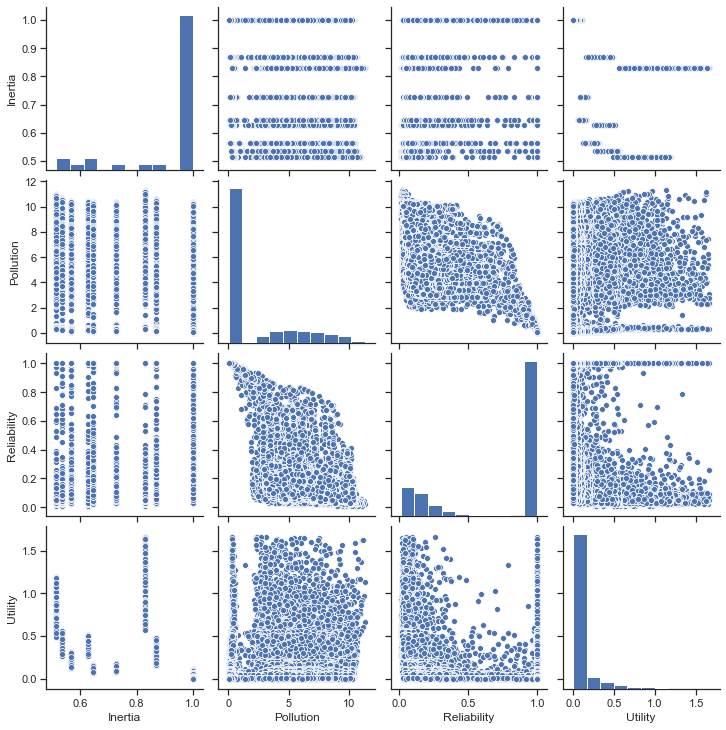

In [59]:
sns.set(style="ticks")
sns.pairplot(df[['Inertia','Pollution', 'Reliability','Utility']]) 

In [29]:
#nn=37
uutt = np.zeros((1,nn))
for j in range(nn):
    uutt[0,j] = df.loc[j*1000+4,'Utility']
uutt.max()

1.7248631179577676

In [30]:
ppoo = np.zeros((1,nn))
for j in range(nn):
    ppoo[0,j] = df.loc[j*1000+4,'Pollution']
ppoo.min()

0.055403497947466115

## Robustness

### A) Robustness comparison 

#### A.1) Mean/standard deviation (signal-to-noise ratio)

  \begin{equation}
             R_{ij} = \{\begin{array}{ll}
             \frac{\mu(f_{ijs}^* + 1}{\sigma(f_{ijs}^* + 1} ; & \text{if } f_i \text{ is to be maximized}; s=1..N \\
             (\mu(f_{ijs}^* + 1) \times (\sigma(f_{ijs}^* + 1) ; & \text{if } f_i \text{ is to be minimized}; s=1..N\\
             \end{array}
          \end{equation}
          where $\mu(f_{ijs}^*$ is the mean over the set of scenarios for outcome indicator $f_i$ in the case of implementing            the candidate solution $j$, and $\sigma$ is the standard deviation.
    
#### A.2) Max regret
The maximum regret of a candidate solution is the maximal difference across the scenarios between this candidate solution's performance and the zero-regret option's performance in each scenario. The following equation shows the formulation of maximum regret for candidate solution $j$ and outcome indicator $i$. In this formulation, $Z_{is}$ is the zero-regret value of outcome indicator $i$ in scenario $s$, which is assumed to be the best value obtained in this scenario with the optimal policy.

  \begin{equation}
         R_{ij} = \max_{s=1..N} \{ |f_{ijs}^* - Z_{is}| \} 
   \end{equation}

   \begin{equation}
         Z_{is} = \{\begin{array}{ll}
          \max_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be maximized} \\
          \min_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be minimized}\\
         \end{array}
  \end{equation}
    



### B) Domain criterion: In how many (percentage of) scenarios (out of 1000 randomly generated) 

#### B.1) Re > 0.95 ? 
#### B.2) Utility > 0.2 ?
#### B.3) Both a and b.

## A) Robustness comparison

In [5]:
int(np.shape(Lake45re_data)[0]/1000)

34

In [6]:
nn = int(np.shape(Lake45re_data)[0]/1000) #59 #non-dominated solutions
ss=1000 # scenarios

In [7]:
# Mean/std deviation (signal Noise)
df = Lake45re_data
R_mean_std = [nn * [None] for i in range(4)]
Solution = []

for j in range(nn):
    R_mean_std[0][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Utility']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Utility']).std()+1)
    #(np.array(nUtility[j]).mean()+1)/(np.array(nUtility[j]).std()+1)            # Max
    R_mean_std[1][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).mean()+1)*(np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).std()+1)
    #(np.array(nPollution[j]).mean()+1)*(np.array(nPollution[j]).std()+1)        # Min
    R_mean_std[2][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).std()+1)
    #(np.array(nInertia[j]).mean()+1)/(np.array(nInertia[j]).std()+1)            # Max
    R_mean_std[3][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).std()+1)
    #(np.array(nReliability[j]).mean()+1)/(np.array(nReliability[j]).std()+1)    # Max
    Solution.append(j)

In [6]:
# Trade-offs between Utility and Reliability
# Each line represents one solution
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = R_mean_std[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
               dict(range = [1.25,2.1],
                label = 'Robustness of Inertia(↑)', values = R_mean_std[2]),
          
            dict(range = [20,9],
                label = 'Robustness of Pollution(↑)', values = R_mean_std[1]),
         
            dict(range = [.9,1.45],
                label = 'Robustness of Reliability(↑)', values = R_mean_std[3]),
              dict(range = [1,1.5],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↑)', values = R_mean_std[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [8]:
df = Lake45re_data
nnUtility = np.zeros((nn,ss))
nnPollution = np.zeros((nn,ss))
nnInertia = np.zeros((nn,ss))
nnReliability = np.zeros((nn,ss))

for p in range(ss):
    for i in range(nn):
        nnUtility[i][p] = df.loc[i*1000+p,'Utility']
        nnPollution[i][p] = df.loc[i*1000+p,'Pollution']
        nnInertia[i][p] = df.loc[i*1000+p,'Inertia']
        nnReliability[i][p] = df.loc[i*1000+p,'Reliability']
    

In [9]:
# Max Regret
z = [ss * [None] for i in range(4)]
Regret = [nn * [None] for i in range(4)]

for p in range(ss):
    z[0][p] = np.max(nnUtility, axis=0)[p] #nnUtility[solution(nn)][scenario(ss)]
    z[1][p] = np.min(nnPollution, axis=0)[p]
    z[2][p] = np.max(nnInertia, axis=0)[p]
    z[3][p] = np.max(nnReliability, axis=0)[p]

for j in range(nn):
    Regret[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(z[0]) ) )            # Max
    Regret[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(z[1]) ) )         # Min
    Regret[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(z[2]) ) )           # Max
    Regret[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(z[3]) ) )     # Max
 

In [9]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.75],
                label = 'Robustness of Inertia(↓)', values = Regret[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [16]:
print(min(Regret[1]), ',', max(Regret[1]))

0.45367152065123406 , 10.851669635352371


In [24]:
# Max Regret from the ideals

Regret_ideal = [nn * [None] for i in range(4)]

for j in range(nn):
    Regret_ideal[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(dfi.ideal_Utility) ) )            # Max
    Regret_ideal[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(dfi.ideal_Pollution) ) )         # Min
    Regret_ideal[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(dfi.ideal_Inertia) ) )           # Max
    Regret_ideal[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(dfi.ideal_Reliability) ) )     # Max
 

In [25]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret_ideal[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.7],
                label = 'Robustness of Inertia(↓)', values = Regret_ideal[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret_ideal[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret_ideal[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret_ideal[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [26]:
print(min(Regret_ideal[0]), ',', max(Regret_ideal[0]))

0.009897770252725424 , 1.7329766667262434


## B) Robustness analysis

In [37]:
# Calculating Pcrit
#b,q, and x
# for each solution in each scenario we may have different Pcrit
Pcrit = np.zeros((nn,ss))
for j in range(nn):
    for  p in range(ss):
        x = ait[j]
        bb = b[p]
        qq = q[p]
        Pcrit[j][p] = brentq(lambda x: x**qq/(1+x**qq) - bb*x, 0.01, 1.5)
        
#Pcrit

In [38]:
# Write objectives

with open('Pcrit(EkerBarth)_59solutions_random_rfps(15.10.2020)s2.csv', 'w', newline='') as f:
    objectives = ['Pcrit'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for p in range(ss):
            thewriter.writerow({'Pcrit' : Pcrit[j][p]
                               })

In [10]:
Pcritical = pd.read_csv('Pcrit(EkerBarth)_59solutions_random_rfps(15.10.2020)s2.csv')
#Pcritical.describe()

Pcriti = np.zeros((nn,ss))
ind = 0
for j in range(nn):
    for p in range(ss):
        Pcriti[j][p] = Pcritical['Pcrit'][ind]
        ind += 1
    
#Pcriti[49][999]

In [11]:
""" 
Robustness analysis --> B
Calculating how many scenarios has 
    B.1) reliability > 0.8 
    B.2) Utility > 0.2/0.1 ?
    B.3) Both a and b.

"""
n_reliabale_scen = np.zeros((nn,))
n_high_eco_scen = np.zeros((nn,))
n_both_scen = np.zeros((nn,))
n_high_inertia_scen = np.zeros((nn,))
n_low_pollution_scen = np.zeros((nn,))
#critical_scen = []


for i in range(nn): 
    nrs = 0
    nhes = 0
    nboth = 0
    nhi = 0
    nlp = 0
    for p in range(ss):
        if nnReliability[i][p]>.8: #A.1
            nrs += 1
        #else:
        #    critical_scen.append(np.array([p+1, b[p], q[p], mean[p], stdev[p], delta[p]]) )  
        if nnUtility[i][p]>0.2: #A.2
            nhes += 1
        if nnReliability[i][p]>0.8 and nnUtility[i][p]>0.2: #A.3
            nboth += 1
        if nnInertia[i][p]>0.99:
            nhi += 1   
        if nnPollution[i][p]<Pcriti[i][p]: #2.54
            nlp += 1
            
    n_reliabale_scen[i] = nrs   
    n_high_eco_scen[i] = nhes
    n_both_scen[i] = nboth
    n_high_inertia_scen[i] = nhi
    n_low_pollution_scen[i] = nlp
    

print('Number of scenarios with reliability of > 0.8 =', n_reliabale_scen)
print('Number of scenarios with utility of > 0.755 =',n_high_eco_scen)
print('Number of scenarios with reliability of > 0.8 and utility > 0.2 =',n_both_scen)
#print('Number of scenarios with inertia of > 0.99 =',n_high_inertia_scen)
print('Number of scenarios with pollution of < Critical point =',n_low_pollution_scen)
#print(critical_scen)

Number of scenarios with reliability of > 0.8 = [106. 777. 758. 777. 611. 167. 409. 514. 440. 719. 689. 710. 673. 710.
 722. 739. 739. 740. 739. 739. 740. 740. 739. 739. 741. 770. 771. 772.
 775. 769. 769. 775. 766. 769.]
Number of scenarios with utility of > 0.755 = [1000.    0.    0.    0.  400. 1000. 1000.  755. 1000.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.]
Number of scenarios with reliability of > 0.8 and utility > 0.2 = [106.   0.   0.   0. 245. 167. 409. 386. 440.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.]
Number of scenarios with pollution of < Critical point = [106. 764. 746. 765. 604. 166. 404. 510. 437. 709. 681. 706. 670. 706.
 714. 731. 731. 728. 735. 731. 731. 730. 731. 731. 734. 758. 759. 763.
 765. 758. 758. 763. 755. 758.]


In [40]:
rdc_reliability = np.sort(n_reliabale_scen)[::-1]/1000
rdc_reliability

array([0.777, 0.777, 0.777, 0.777, 0.776, 0.776, 0.742, 0.737, 0.735,
       0.733, 0.708, 0.708, 0.683, 0.42 , 0.24 , 0.216, 0.208, 0.182,
       0.181, 0.153, 0.152, 0.151, 0.142, 0.139, 0.133, 0.127, 0.125,
       0.123, 0.121, 0.118, 0.117, 0.113, 0.111, 0.106])

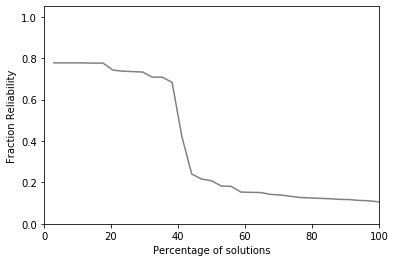

In [41]:
#Reliability robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_reliability, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Reliability") 
plt.show()

In [42]:
import plotly.express as px

fig = px.bar(x = np.arange(1,nn+1), y = rdc_reliability, text=rdc_reliability, color=rdc_reliability,
             range_y=[0,1], #label={x,'ff'}
                         ) 

#fig = px.bar(df, y='Fraction Reliability', x='Percentage of solutions', text='pop')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
#fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

In [43]:
rdc_utility = np.sort(n_high_eco_scen)[::-1]/1000
rdc_utility

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

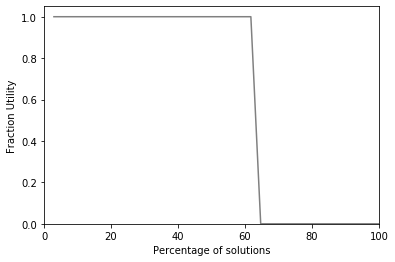

In [44]:
#Utility robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_utility, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Utility") 
plt.show()

In [45]:
rdc_both = np.sort(n_both_scen)[::-1]/1000
rdc_both

array([0.42 , 0.24 , 0.216, 0.208, 0.182, 0.181, 0.153, 0.152, 0.151,
       0.142, 0.139, 0.133, 0.127, 0.125, 0.123, 0.121, 0.118, 0.117,
       0.113, 0.111, 0.106, 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
       0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ])

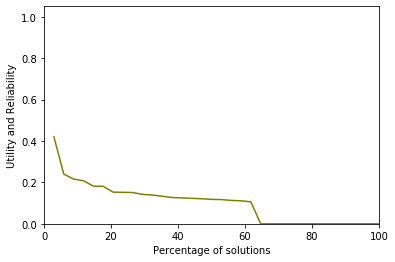

In [46]:
#Both
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_both, color = "olive")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Utility and Reliability") 
plt.show()

In [47]:
rdc_pollution = np.sort(n_low_pollution_scen)[::-1]/1000
rdc_pollution

array([0.767, 0.767, 0.765, 0.765, 0.765, 0.765, 0.734, 0.731, 0.728,
       0.724, 0.701, 0.701, 0.675, 0.413, 0.238, 0.215, 0.205, 0.181,
       0.179, 0.153, 0.151, 0.151, 0.14 , 0.138, 0.13 , 0.125, 0.123,
       0.123, 0.119, 0.116, 0.115, 0.112, 0.111, 0.105])

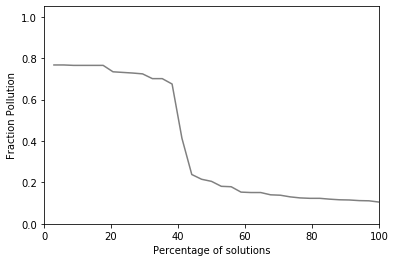

In [48]:
#Pollution
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_pollution, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Pollution") 
plt.show()

In [49]:
rdc_inertia = np.sort(n_high_inertia_scen)[::-1]/1000
rdc_inertia

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

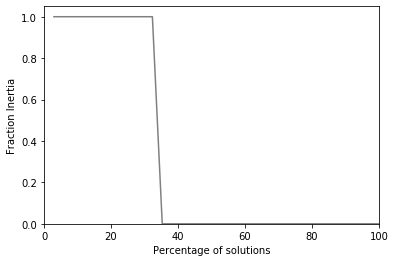

In [50]:
#Inertia
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_inertia, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Inertia") 
plt.show()

In [12]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = n_high_eco_scen,
                   colorscale = [[0.1,'black'],[0.35,'purple'],[0.7,'red'],[.9,'gold']]),
        dimensions = list([
                    
            dict(range = [0,1],
                label = 'Fraction Pollution', values = n_low_pollution_scen/1000),
          
            dict(range = [0,1],
                label = 'Fraction Reliability', values = n_reliabale_scen/1000),
            
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Fraction Utility', values = n_high_eco_scen/1000),
            dict(range = [0,1],
                label = 'Fraction Inertia', values = n_high_inertia_scen/1000),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [44]:
# Write objectives

with open('Domain_59solutions_(28.10.2020)s2.csv', 'w', newline='') as f:
    objectives = ['rdc_u', 'rdc_rel', 'rdc_pol', 'rdc_in'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(59):
        thewriter.writerow({'rdc_u' : rdc_utility[j], 'rdc_rel' : rdc_reliability[j], 'rdc_pol' : rdc_pollution[j], 'rdc_in' : rdc_inertia[j]   
                               })

## Select solutions which are more robust (e.g. n_both_scen > 103)

In [54]:
# Choose the solutions which has the reliability of > 0.8 and utility > 0.2
n_both_scen

array([371., 136.,   0.,   0., 111.,   0., 249., 107., 217., 110., 112.,
       277.,   0.,   0., 100., 100., 384., 381.,   0., 343.,   0., 372.,
       151., 139.,   0., 156.,   0.,   0., 348.,   0.,   0., 112.,   0.,
         0.,   0., 219., 341.,   0., 485.,   0.,   0.,   0., 115., 128.,
       107., 142., 116., 122., 151., 120.,   0., 191., 195., 152., 102.,
       113., 129., 167., 132.])

In [55]:
selected_ait = []
selected_U = []
selected_P = [] 
selected_I = []
selected_R = []

for i in range(nn):
    if n_both_scen[i] > 350:
        selected_ait.append(ait[i])
        selected_U.append(nnUtility[i])
        selected_P.append(nnPollution[i])
        selected_I.append(nnInertia[i])
        selected_R.append(nnReliability[i])
        #print(i, n_both_scen[i])

# The number of selected solutions
print('The number of selected solutions =', np.shape(selected_U)[0])       

The number of selected solutions = 5


In [56]:
# Write objectives

with open('obective_values_4obj_s2(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(np.shape(selected_ait)[0]):
        for i in range(ss):
            thewriter.writerow({'Utility' : selected_U[j][i], 'Pollution' : selected_P[j][i], 'Inertia' : selected_I[j][i], 'Reliability' : selected_R[j][i], 'group' : j
                               })

In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

Lake4550selected_data = pd.read_csv('obective_values_4obj_s2(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv')
Lake4550selected_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.313509,3.181609,0.640404,0.531902,2.000000
std,0.099963,3.123646,0.119460,0.440772,1.414355
min,0.162509,0.089710,0.505051,0.010000,0.000000
25%,0.236093,0.277847,0.545455,0.090000,1.000000
50%,0.292174,2.795896,0.585859,0.285400,2.000000
75%,0.378755,5.584552,0.767677,1.000000,3.000000
max,0.597797,10.628926,0.797980,1.000000,4.000000


In [58]:
# The performances of the 6 selected solutions in all 1000 scenarios
df = Lake4550selected_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,11],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),
            dict(range = [0,4],
                label = 'Solution', values = df['group']),
            
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

## Calculating the ideal points for all 1000 generated scenarios 

In [22]:
Lake45_1000ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_5scen(EkerBart)_1000_ideal_points(12.10.2020).csv')
Lake45_1000ideals.describe()

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
count,1000.000000,1000.000000,1000.0,1000.000000,1000.000000
mean,0.964190,1.602561,1.0,0.827922,499.500000
std,0.318529,2.899479,0.0,0.326612,288.819436
min,0.571224,0.016309,1.0,0.030000,0.000000
25%,0.693488,0.076118,1.0,1.000000,249.750000
50%,0.879524,0.123542,1.0,1.000000,499.500000
75%,1.183153,0.250321,1.0,1.000000,749.250000
max,1.734761,10.321020,1.0,1.000000,999.000000


In [23]:
dfi = Lake45_1000ideals

## As seen above, the ideal points for reliability in some scenarios are very close to 0 (min = 0.04).
## It means that, in those scenarios, there is no feasible solution with the reliability of higher than 0.8. 

## As seen above, in 208 scenarios (out of 1000), the ideal value for utility is > Critical pollution level. It means that there exists no feasible solution with a lower pollution in these 208 scenarios.

## Therefore, we can remove these scenarios and solve a model with all 4 objective functions in the remaining 802 scenarios. The solutions for that model would have less conservatism (similar reliability values but with equal or better performances in other objectives).